# Economic Analysis of CatSalut Pharmaceutical Expenditure

This notebook analyzes:
1. Mean fraction paid by the government for each ATC level 1 and 2
2. Total amount paid comparison across different groups:
   - Sex (male/female)
   - Age intervals
   - Sanitary regions
   - By ATC level 1 groups

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Configure display and plotting
pd.set_option("display.max_columns", 50)
pd.set_option("display.width", 140)
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("colorblind")

# Set figure size defaults
plt.rcParams['figure.figsize'] = (14, 8)
plt.rcParams['font.size'] = 10

print("Libraries loaded successfully!")

Libraries loaded successfully!


In [2]:
# Load the cleaned data
df = pd.read_csv(r"cleaned_economic_data.csv")

# Ensure numeric columns are properly typed
numeric_cols = ['any', 'mes', 'codi de la regió sanitària', 'nombre de receptes', 
                "nombre d'envasos", 'import íntegre', 'import aportació CatSalut', 'fracció_govern']

for col in numeric_cols:
    if col in df.columns:
        df[col] = pd.to_numeric(df[col], errors='coerce')

# Remove any rows that failed conversion
df = df.dropna(subset=numeric_cols)

# Translate Catalan sex labels to English
df['sexe'] = df['sexe'].replace({'Dona': 'Women', 'Home': 'Men'})

# Translate Spanish ATC Level 1 labels to English
atc1_translations = {
    'TRACTO ALIMENTARIO Y METABOLISMO': 'ALIMENTARY TRACT AND METABOLISM',
    'SANGRE Y ORGANOS HEMATOPOYETICOS': 'BLOOD AND BLOOD FORMING ORGANS',
    'SISTEMA CARDIOVASCULAR': 'CARDIOVASCULAR SYSTEM',
    'DERMATOLOGICOS': 'DERMATOLOGICALS',
    'SISTEMA GENITOURINARIO Y HORMONAS SEXUALES': 'GENITO-URINARY SYSTEM AND SEX HORMONES',
    'PREPARADOS HORMONALES SISTEMICOS, EXCLUYENDO HORMONAS SEXUALES E INSULINAS': 'SYSTEMIC HORMONAL PREPARATIONS, EXCL. SEX HORMONES AND INSULINS',
    'ANTIINFECCIOSOS PARA USO SISTEMICO': 'ANTIINFECTIVES FOR SYSTEMIC USE',
    'AGENTES ANTINEOPLASICOS E INMUNOMODULADORES': 'ANTINEOPLASTIC AND IMMUNOMODULATING AGENTS',
    'SISTEMA MUSCULOESQUELETICO': 'MUSCULO-SKELETAL SYSTEM',
    'SISTEMA NERVIOSO': 'NERVOUS SYSTEM',
    'PRODUCTOS ANTIPARASITARIOS, INSECTICIDAS Y REPELENTES': 'ANTIPARASITIC PRODUCTS, INSECTICIDES AND REPELLENTS',
    'SISTEMA RESPIRATORIO': 'RESPIRATORY SYSTEM',
    'ORGANOS DE LOS SENTIDOS': 'SENSORY ORGANS' 
}
df['grup ATC nivell 1'] = df['grup ATC nivell 1'].replace(atc1_translations)

# Translate common Spanish terms in ATC Level 2, 3, and 4 (comprehensive dictionary)
atc2_translations = {
    # A - ALIMENTARY TRACT AND METABOLISM
    'PREPARADOS ESTOMATOLOGICOS': 'STOMATOLOGICAL PREPARATIONS',
    'AGENTES PARA EL TRATAMIENTO DE ALTERACIONES CAUSADAS POR ACIDOS': 'DRUGS FOR ACID RELATED DISORDERS',
    'AGENTES CONTRA LA ULCERA PEPTICA Y EL REFLUJO GASTROESOFAGICO (RGE/GORD)': 'DRUGS FOR PEPTIC ULCER AND GASTRO-OESOPHAGEAL REFLUX DISEASE (GORD)',
    'Inhibidores de la bomba de protones': 'PROTON PUMP INHIBITORS',
    'AGENTES CONTRA PADECIMIENTOS FUNCIONALES DEL ESTOMAGO E INTESTINO': 'DRUGS FOR FUNCTIONAL GASTROINTESTINAL DISORDERS',
    'FARMACOS PARA DESORDENES FUNCIONALES GASTROINTESTINALES': 'DRUGS FOR FUNCTIONAL GASTROINTESTINAL DISORDERS',
    'ANTIEMETICOS Y FARMACOS PARA LAS NAUSEAS': 'ANTIEMETICS AND ANTINAUSEANTS',
    'ANTIEMETICOS Y ANTINAUSEANTES': 'ANTIEMETICS AND ANTINAUSEANTS',
    'TERAPIA DE LA BILIS Y EL HIGADO': 'BILE AND LIVER THERAPY',
    'BILIS Y TERAPIA DEL HIGADO': 'BILE AND LIVER THERAPY',
    'FARMACOS PARA EL ESTREÑIMIENTO': 'DRUGS FOR CONSTIPATION',
    'LAXANTES': 'LAXATIVES',
    'ANTIDIARREICOS, AGENTES ANTIINFLAMATORIOS/ANTIINFECCIOSOS INTESTINALES': 'ANTIDIARRHEALS, INTESTINAL ANTIINFLAMMATORY/ANTIINFECTIVE AGENTS',
    'PREPARADOS ANTIOBESIDAD, EXCL. PRODUCTOS DIETETICOS': 'ANTIOBESITY PREPARATIONS, EXCL. DIET PRODUCTS',
    'PREPARACIONES PARA LA OBESIDAD, EXCLUYENDO PRODUCTOS DIETETICOS': 'ANTIOBESITY PREPARATIONS, EXCL. DIET PRODUCTS',
    'DIGESTIVOS, INCL. ENZIMAS': 'DIGESTIVES, INCL. ENZYMES',
    'DIGESTIVOS, INCLUYENDO ENZIMAS': 'DIGESTIVES, INCL. ENZYMES',
    'FARMACOS USADOS EN DIABETES': 'DRUGS USED IN DIABETES',
    'VITAMINAS': 'VITAMINS',
    'SUPLEMENTOS MINERALES': 'MINERAL SUPPLEMENTS',
    'TONICOS': 'TONICS',
    'AGENTES ANABOLICOS PARA USO SISTEMICO': 'ANABOLIC AGENTS FOR SYSTEMIC USE',
    'ESTIMULANTES DEL APETITO': 'APPETITE STIMULANTS',
    'OTROS PRODUCTOS PARA EL TRACTO ALIMENTARIO Y METABOLISMO': 'OTHER ALIMENTARY TRACT AND METABOLISM PRODUCTS',
    'Antiinfecciosos y antisepticos para el tratamiento oral-local': 'ANTIINFECTIVES AND ANTISEPTICS FOR LOCAL ORAL TREATMENT',
    
    # B - BLOOD AND BLOOD FORMING ORGANS
    'AGENTES ANTITROMBÓTICOS': 'ANTITHROMBOTIC AGENTS',
    'AGENTES ANTITROMBOTICOS': 'ANTITHROMBOTIC AGENTS',
    'ANTIHEMORRAGICOS': 'ANTIHEMORRHAGICS',
    'SUSTITUTOS DE LA SANGRE Y SOLUCIONES DE PERFUSIÓN': 'BLOOD SUBSTITUTES AND PERFUSION SOLUTIONS',
    'SUSTITUTOS DE LA SANGRE Y SOLUCIONES PARA PERFUSION': 'BLOOD SUBSTITUTES AND PERFUSION SOLUTIONS',
    'PREPARADOS ANTIANEMICOS': 'ANTIANEMIC PREPARATIONS',
    'OTROS AGENTES HEMATOLOGICOS': 'OTHER HEMATOLOGICAL AGENTS',
    
    # C - CARDIOVASCULAR SYSTEM
    'TERAPIA CARDIACA': 'CARDIAC THERAPY',
    'ANTIHIPERTENSIVOS': 'ANTIHYPERTENSIVES',
    'DIURÉTICOS': 'DIURETICS',
    'DIURETICOS': 'DIURETICS',
    'VASODILATADORES PERIFÉRICOS': 'PERIPHERAL VASODILATORS',
    'VASODILATADORES PERIFERICOS': 'PERIPHERAL VASODILATORS',
    'VASOPROTECTORES': 'VASOPROTECTIVES',
    'AGENTES BETA BLOQUEANTES': 'BETA BLOCKING AGENTS',
    'AGENTES BETA-BLOQUEANTES': 'BETA BLOCKING AGENTS',
    'BLOQUEADORES DE LOS CANALES DE CALCIO': 'CALCIUM CHANNEL BLOCKERS',
    'AGENTES QUE ACTÚAN SOBRE EL SISTEMA RENINA-ANGIOTENSINA': 'AGENTS ACTING ON THE RENIN-ANGIOTENSIN SYSTEM',
    'AGENTES QUE ACTUAN SOBRE EL SISTEMA RENINA-ANGIOTENSINA': 'AGENTS ACTING ON THE RENIN-ANGIOTENSIN SYSTEM',
    'AGENTES MODIFICADORES DE LÍPIDOS': 'LIPID MODIFYING AGENTS',
    'AGENTES MODIFICADORES DE LOS LIPIDOS': 'LIPID MODIFYING AGENTS',
    
    # D - DERMATOLOGICALS
    'ANTIFÚNGICOS PARA USO DERMATOLÓGICO': 'ANTIFUNGALS FOR DERMATOLOGICAL USE',
    'ANTIFUNGICOS PARA USO DERMATOLOGICO': 'ANTIFUNGALS FOR DERMATOLOGICAL USE',
    'EMOLIENTES Y PROTECTORES': 'EMOLLIENTS AND PROTECTIVES',
    'PREPARADOS PARA EL TRATAMIENTO DE HERIDAS Y ULCERAS': 'PREPARATIONS FOR TREATMENT OF WOUNDS AND ULCERS',
    'ANTIPRURITICOS, INCL. ANTIHISTAMINICOS, ANESTESICOS, ETC.': 'ANTIPRURITICS, INCL. ANTIHISTAMINES, ANESTHETICS, ETC.',
    'PREPARADOS ANTIPSORIASTICOS': 'ANTIPSORIATICS',
    'PREPARADOS ANTIPSORIÁSICOS': 'ANTIPSORIATICS',
    'ANTIBIÓTICOS Y QUIMIOTERÁPICOS PARA USO DERMATOLÓGICO': 'ANTIBIOTICS AND CHEMOTHERAPEUTICS FOR DERMATOLOGICAL USE',
    'ANTIBIOTICOS Y QUIMIOTERAPICOS PARA USO DERMATOLOGICO': 'ANTIBIOTICS AND CHEMOTHERAPEUTICS FOR DERMATOLOGICAL USE',
    'CORTICOSTEROIDES, DERMATOLÓGICOS': 'CORTICOSTEROIDS, DERMATOLOGICAL PREPARATIONS',
    'PREPARADOS DERMATOLOGICOS CON CORTICOSTEROIDES': 'CORTICOSTEROIDS, DERMATOLOGICAL PREPARATIONS',
    'ANTISEPTICOS Y DESINFECTANTES': 'ANTISEPTICS AND DISINFECTANTS',
    'APOSITOS MEDICADOS': 'MEDICATED DRESSINGS',
    'PREPARADOS ANTIACNÉ': 'ANTI-ACNE PREPARATIONS',
    'PREPARADOS ANTI-ACNE': 'ANTI-ACNE PREPARATIONS',
    'OTROS PREPARADOS DERMATOLOGICOS': 'OTHER DERMATOLOGICAL PREPARATIONS',
    
    # G - GENITO URINARY SYSTEM AND SEX HORMONES
    'ANTIINFECCIOSOS Y ANTISÉPTICOS GINECOLÓGICOS': 'GYNECOLOGICAL ANTIINFECTIVES AND ANTISEPTICS',
    'ANTIINFECCIOSOS Y ANTISEPTICOS GINECOLOGICOS': 'GYNECOLOGICAL ANTIINFECTIVES AND ANTISEPTICS',
    'OTROS GINECOLOGICOS': 'OTHER GYNECOLOGICALS',
    'HORMONAS SEXUALES Y MODULADORES DEL SISTEMA GENITAL': 'SEX HORMONES AND MODULATORS OF THE GENITAL SYSTEM',
    'UROLÓGICOS': 'UROLOGICALS',
    'UROLOGICOS': 'UROLOGICALS',
    
    # H - SYSTEMIC HORMONAL PREPARATIONS, EXCL. SEX HORMONES AND INSULINS
    'HORMONAS PITUITARIAS E HIPOTALÁMICAS Y ANÁLOGOS': 'PITUITARY AND HYPOTHALAMIC HORMONES AND ANALOGUES',
    'HORMONAS PITUITARIAS E HIPOTALAMICAS Y ANALOGOS': 'PITUITARY AND HYPOTHALAMIC HORMONES AND ANALOGUES',
    'CORTICOSTEROIDES PARA USO SISTÉMICO': 'CORTICOSTEROIDS FOR SYSTEMIC USE',
    'CORTICOSTEROIDES PARA USO SISTEMICO': 'CORTICOSTEROIDS FOR SYSTEMIC USE',
    'TERAPIA TIROIDEA': 'THYROID THERAPY',
    'HORMONAS PANCREATICAS': 'PANCREATIC HORMONES',
    'HOMEOSTASIS DEL CALCIO': 'CALCIUM HOMEOSTASIS',
    
    # J - ANTIINFECTIVES FOR SYSTEMIC USE
    'ANTIBACTERIANOS PARA USO SISTÉMICO': 'ANTIBACTERIALS FOR SYSTEMIC USE',
    'ANTIBACTERIANOS PARA USO SISTEMICO': 'ANTIBACTERIALS FOR SYSTEMIC USE',
    'ANTIMICÓTICOS PARA USO SISTÉMICO': 'ANTIMYCOTICS FOR SYSTEMIC USE',
    'ANTIMICOTICOS PARA USO SISTEMICO': 'ANTIMYCOTICS FOR SYSTEMIC USE',
    'ANTIMICOBACTERIANOS': 'ANTIMYCOBACTERIALS',
    'ANTIVIRALES PARA USO SISTÉMICO': 'ANTIVIRALS FOR SYSTEMIC USE',
    'ANTIVIRALES PARA USO SISTEMICO': 'ANTIVIRALS FOR SYSTEMIC USE',
    'SUEROS INMUNES E INMUNOGLOBULINAS': 'IMMUNE SERA AND IMMUNOGLOBULINS',
    'VACUNAS': 'VACCINES',
    
    # L - ANTINEOPLASTIC AND IMMUNOMODULATING AGENTS
    'AGENTES ANTINEOPLÁSICOS': 'ANTINEOPLASTIC AGENTS',
    'AGENTES ANTINEOPLASICOS': 'ANTINEOPLASTIC AGENTS',
    'TERAPIA ENDOCRINA': 'ENDOCRINE THERAPY',
    'INMUNOESTIMULANTES': 'IMMUNOSTIMULANTS',
    'INMUNOSUPRESORES': 'IMMUNOSUPPRESSANTS',
    
    # M - MUSCULO-SKELETAL SYSTEM
    'PRODUCTOS ANTIINFLAMATORIOS Y ANTIRREUMÁTICOS': 'ANTIINFLAMMATORY AND ANTIRHEUMATIC PRODUCTS',
    'PRODUCTOS ANTIINFLAMATORIOS Y ANTIRREUMATICOS': 'ANTIINFLAMMATORY AND ANTIRHEUMATIC PRODUCTS',
    'PRODUCTOS TOPICOS PARA EL DOLOR ARTICULAR Y MUSCULAR': 'TOPICAL PRODUCTS FOR JOINT AND MUSCULAR PAIN',
    'RELAJANTES MUSCULARES': 'MUSCLE RELAXANTS',
    'AGENTES ANTIGOTOSOS': 'ANTIGOUT PREPARATIONS',
    'PREPARADOS ANTIGOTOSOS': 'ANTIGOUT PREPARATIONS',
    'FARMACOS PARA EL TRATAMIENTO DE ENFERMEDADES ÓSEAS': 'DRUGS FOR TREATMENT OF BONE DISEASES',
    'FARMACOS PARA EL TRATAMIENTO DE ENFERMEDADES OSEAS': 'DRUGS FOR TREATMENT OF BONE DISEASES',
    'OTROS FARMACOS PARA TRASTORNOS DEL SISTEMA MUSCULOESQUELETICO': 'OTHER DRUGS FOR DISORDERS OF THE MUSCULO-SKELETAL SYSTEM',
    
    # N - NERVOUS SYSTEM
    'ANESTESICOS': 'ANESTHETICS',
    'ANALGÉSICOS': 'ANALGESICS',
    'ANALGESICOS': 'ANALGESICS',
    'ANTIEPILÉPTICOS': 'ANTIEPILEPTICS',
    'ANTIEPILEPTICOS': 'ANTIEPILEPTICS',
    'ANTIPARKINSONIANOS': 'ANTI-PARKINSON',
    'FARMACOS ANTIPARKINSONIANOS': 'ANTI-PARKINSON',
    'PSICOLÉPTICOS': 'PSYCHOLEPTICS',
    'PSICOLEPTICOS': 'PSYCHOLEPTICS',
    'PSICOANALÉPTICOS': 'PSYCHOANALEPTICS',
    'PSICOANALEPTICOS': 'PSYCHOANALEPTICS',
    'OTROS FÁRMACOS DEL SISTEMA NERVIOSO': 'OTHERS',
    'OTROS FARMACOS QUE ACTUAN SOBRE EL SISTEMA NERVIOSO': 'OTHERS',
    'OTROS FARMACOS DEL SISTEMA NERVIOSO': 'OTHERS',
    'ANTIPSICÓTICOS': 'ANTIPSYCHOTICS',
    'ANTIPSICÓTICOS': 'ANTIPSYCHOTICS',
    'ANSIOLÍTICOS': 'ANXIOLYTICS',
    'ANSIOLITICOS': 'ANXIOLYTICS',
    'HIPNÓTICOS Y SEDANTES': 'HYPNOTICS AND SEDATIVES',
    'HIPNOTICOS Y SEDANTES': 'HYPNOTICS AND SEDANTES',
    'ANTIDEPRESIVOS': 'ANTIDEPRESSANTS',
    'PSICOESTIMULANTES, AGENTES UTILIZADOS EN TDAH Y NOOTRÓPICOS': 'PSYCHOSTIMULANTS, AGENTS USED FOR ADHD AND NOOTROPICS',
    'AGENTES ANTI-DEMENCIA': 'ANTI-DEMENTIA DRUGS',
    
    # P - ANTIPARASITIC PRODUCTS, INSECTICIDES AND REPELLENTS
    'ANTIPROTOZOARIOS': 'ANTIPROTOZOALS',
    'ANTIHELMÍNTICOS': 'ANTHELMINTICS',
    'ANTIHELMINTICOS': 'ANTHELMINTICS',
    'ECTOPARASITICIDAS, INCL. ESCABICIDAS, INSECTICIDAS Y REPELENTES': 'ECTOPARASITICIDES, INCL. SCABICIDES, INSECTICIDES AND REPELLENTS',
    'ECTOPARASITICIDAS, INCLUYENDO ESCABICIDAS, INSECTICIDAS Y REPELENTES': 'ECTOPARASITICIDES, INCL. SCABICIDES, INSECTICIDES AND REPELLENTS',
    
    # R - RESPIRATORY SYSTEM
    'PREPARADOS NASALES': 'NASAL PREPARATIONS',
    'PREPARADOS DE USO NASAL': 'NASAL PREPARATIONS',
    'PREPARADOS PARA LA GARGANTA': 'THROAT PREPARATIONS',
    'FARMACOS PARA ENFERMEDADES OBSTRUCTIVAS DE LAS VÍAS RESPIRATORIAS': 'DRUGS FOR OBSTRUCTIVE AIRWAY DISEASES',
    'AGENTES CONTRA PADECIMIENTOS OBSTRUCTIVOS DE LAS VIAS RESPIRATORIAS': 'DRUGS FOR OBSTRUCTIVE AIRWAY DISEASES',
    'FARMACOS PARA ENFERMEDADES OBSTRUCTIVAS DE LAS VIAS RESPIRATORIAS': 'DRUGS FOR OBSTRUCTIVE AIRWAY DISEASES',
    'PREPARADOS PARA LA TOS Y EL RESFRIADO': 'COUGH AND COLD PREPARATIONS',
    'ANTIHISTAMÍNICOS PARA USO SISTÉMICO': 'ANTIHISTAMINES FOR SYSTEMIC USE',
    'ANTIHISTAMINICOS PARA USO SISTEMICO': 'ANTIHISTAMINES FOR SYSTEMIC USE',
    'OTROS PRODUCTOS DEL SISTEMA RESPIRATORIO': 'OTHER RESPIRATORY SYSTEM PRODUCTS',
    
    # S - SENSORY ORGANS
    'OFTALMOLÓGICOS': 'OPHTHALMOLOGICALS',
    'OFTALMOLOGICOS': 'OPHTHALMOLOGICALS',
    'OTOLÓGICOS': 'OTOLOGICALS',
    'OTOLOGICOS': 'OTOLOGICALS',
    'PREPARADOS OFTALMOLOGICOS Y OTOLOGICOS': 'OPHTHALMOLOGICAL AND OTOLOGICAL PREPARATIONS',
}
df['grup ATC nivell 2'] = df['grup ATC nivell 2'].replace(atc2_translations)

print(f"Dataset loaded: {df.shape}")
print(f"\nColumns: {df.columns.tolist()}")
print(f"\nData types:")
print(df.dtypes)
print(f"\nFirst few rows:")
df.head()

Dataset loaded: (7536094, 19)

Columns: ['any', 'mes', 'codi de la regió sanitària', 'regió sanitària', "grup d'edat", 'sexe', 'codi del grup ATC nivell 1', 'grup ATC nivell 1', 'codi del grup ATC nivell 2', 'grup ATC nivell 2', 'codi del grup ATC nivell 3', 'grup ATC nivell 3', 'codi del grup ATC nivell 4', 'grup ATC nivell 4', 'nombre de receptes', "nombre d'envasos", 'import íntegre', 'import aportació CatSalut', 'fracció_govern']

Data types:
any                             int64
mes                             int64
codi de la regió sanitària      int64
regió sanitària                object
grup d'edat                    object
sexe                           object
codi del grup ATC nivell 1     object
grup ATC nivell 1              object
codi del grup ATC nivell 2     object
grup ATC nivell 2              object
codi del grup ATC nivell 3     object
grup ATC nivell 3              object
codi del grup ATC nivell 4     object
grup ATC nivell 4              object
nombre de recepte

,any,mes,codi de la regió sanitària,regió sanitària,grup d'edat,sexe,codi del grup ATC nivell 1,grup ATC nivell 1,codi del grup ATC nivell 2,grup ATC nivell 2,codi del grup ATC nivell 3,grup ATC nivell 3,codi del grup ATC nivell 4,grup ATC nivell 4,nombre de receptes,nombre d'envasos,import íntegre,import aportació CatSalut,fracció_govern
0,2025,9,61,LLEIDA,0-1,Women,A,ALIMENTARY TRACT AND METABOLISM,A01,STOMATOLOGICAL PREPARATIONS,A01A,PREPARADOS ESTOMATOLOGICOS,A01AB,Antiinfecciosos y antisepticos para el tratami...,3,3,8.49,7.36,0.866902
1,2025,9,61,LLEIDA,0-1,Women,A,ALIMENTARY TRACT AND METABOLISM,A02,DRUGS FOR ACID RELATED DISORDERS,A02B,AGENTES CONTRA LA ULCERA PEPTICA Y EL REFLUJO ...,A02BC,Inhibidores de la bomba de protones,1,1,17.75,10.65,0.600000
2,2025,9,61,LLEIDA,0-1,Women,A,ALIMENTARY TRACT AND METABOLISM,A07,"ANTIDIARRHEALS, INTESTINAL ANTIINFLAMMATORY/AN...",A07A,ANTIINFECCIOSOS INTESTINALES,A07AA,Antibioticos,17,17,79.56,53.84,0.676722
3,2025,9,61,LLEIDA,0-1,Women,A,ALIMENTARY TRACT AND METABOLISM,A07,"ANTIDIARRHEALS, INTESTINAL ANTIINFLAMMATORY/AN...",A07C,ELECTROLITOS CON CARBOHIDRATOS,A07CA,Formulaciones de sales de rehidratacion oral,27,27,95.62,56.26,0.588371
4,2025,9,61,LLEIDA,0-1,Women,A,ALIMENTARY TRACT AND METABOLISM,A11,VITAMINS,A11C,"VITAMINAS A Y D, INCLUYENDO COMBINACIONES DE L...",A11CC,Vitamina D y analogos,307,307,1708.00,1036.48,0.606838


TEMPORAL EVOLUTION PIE CHARTS - STARTING
✓ Using existing dataframe 'df'

✓ Years in data: [2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023, 2024, 2025]
✓ ATC Level 1 categories: 13

VISUALIZATION 1: GRID OF PIE CHARTS (2 rows x 10 columns)


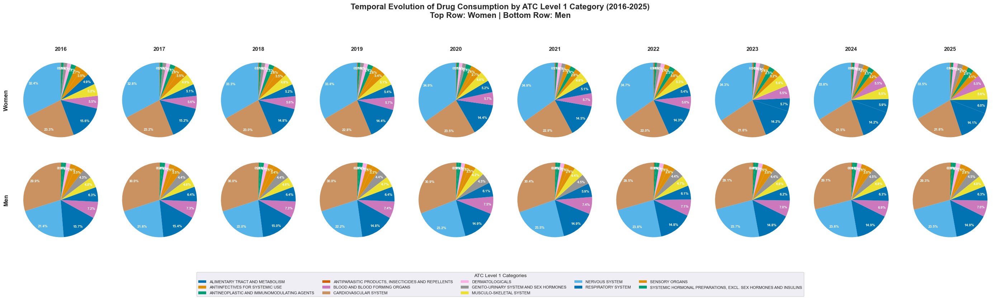


✓ Grid visualization created!
✓ Saved as 'temporal_evolution_pie_charts_by_sex.png'

VISUALIZATION 2: CONCENTRIC RINGS (Inner=2016 → Outer=2025)


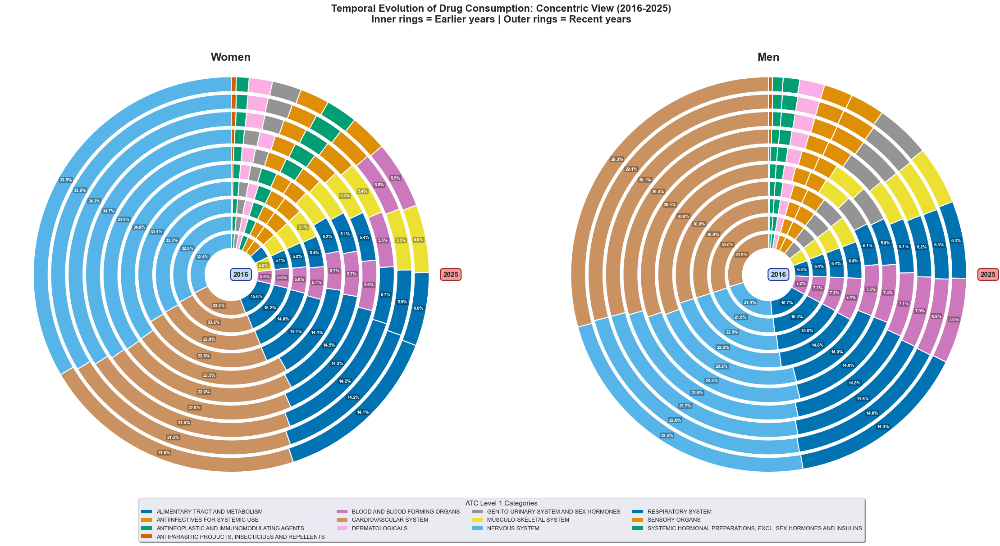


✓ Concentric visualization created!
✓ Saved as 'temporal_evolution_concentric_by_sex.png'

TEMPORAL EVOLUTION SUMMARY: ATC LEVEL 1 CONSUMPTION BY SEX (2016-2025)

1. TOTAL PRESCRIPTION VOLUMES BY YEAR:
------------------------------------------------------------

Women:
  2016:      74,081,734 prescriptions
  2017:      74,076,682 prescriptions
  2018:      74,148,540 prescriptions
  2019:      75,225,541 prescriptions
  2020:      73,982,453 prescriptions
  2021:      77,476,091 prescriptions
  2022:      82,136,924 prescriptions
  2023:      84,968,782 prescriptions
  2024:      87,319,562 prescriptions
  2025:      66,056,213 prescriptions
  → Overall growth (2016-2025): -10.83%

Men:
  2016:      56,837,660 prescriptions
  2017:      57,066,222 prescriptions
  2018:      57,356,757 prescriptions
  2019:      58,252,895 prescriptions
  2020:      57,214,896 prescriptions
  2021:      58,990,446 prescriptions
  2022:      62,202,484 prescriptions
  2023:      64,522,552 prescription

In [3]:
# Temporal Evolution Pie Charts: ATC Level 1 Proportions by Sex (2016-2025)
import matplotlib.patches as mpatches

print("="*80)
print("TEMPORAL EVOLUTION PIE CHARTS - STARTING")
print("="*80)

# Load data if not already loaded
try:
    df.head()
    print("✓ Using existing dataframe 'df'")
except NameError:
    print("Loading data from cleaned_economic_data.csv...")
    df = pd.read_csv(r"cleaned_economic_data.csv")
    # Translate sex labels
    df['sexe'] = df['sexe'].replace({'Dona': 'Women', 'Home': 'Men'})
    print("✓ Data loaded successfully")

# Calculate prescription totals by year, sex, and ATC Level 1
temporal_sex_atc1 = df.groupby(['any', 'sexe', 'grup ATC nivell 1']).agg({
    'nombre de receptes': 'sum'
}).reset_index()

# Get unique years and sort
years = sorted(temporal_sex_atc1['any'].unique())
print(f"\n✓ Years in data: {years}")

# Get unique ATC Level 1 categories and create consistent color scheme
atc1_categories = sorted(temporal_sex_atc1['grup ATC nivell 1'].unique())
print(f"✓ ATC Level 1 categories: {len(atc1_categories)}")

# Create colormap - use a colorblind-friendly palette
colors = sns.color_palette("colorblind", n_colors=len(atc1_categories))
color_map = {cat: colors[i] for i, cat in enumerate(atc1_categories)}

print(f"\n{'='*80}")
print(f"VISUALIZATION 1: GRID OF PIE CHARTS (2 rows x {len(years)} columns)")
print(f"{'='*80}")

# Create figure with subplots: 2 rows (Men/Women) x 9 columns (years)
fig, axes = plt.subplots(2, len(years), figsize=(28, 8))
fig.suptitle('Temporal Evolution of Drug Consumption by ATC Level 1 Category (2016-2025)\n' + 
             'Top Row: Women | Bottom Row: Men', 
             fontsize=16, fontweight='bold', y=0.98)

# Process each year and sex
for year_idx, year in enumerate(years):
    year_data = temporal_sex_atc1[temporal_sex_atc1['any'] == year]
    
    # Women (top row)
    women_data = year_data[year_data['sexe'] == 'Women'].copy()
    women_data = women_data.sort_values('nombre de receptes', ascending=False)
    
    # Men (bottom row)
    men_data = year_data[year_data['sexe'] == 'Men'].copy()
    men_data = men_data.sort_values('nombre de receptes', ascending=False)
    
    # Plot Women pie chart
    ax_women = axes[0, year_idx]
    if not women_data.empty:
        wedges_w, texts_w, autotexts_w = ax_women.pie(
            women_data['nombre de receptes'],
            labels=None,  # No labels to keep it clean
            colors=[color_map[cat] for cat in women_data['grup ATC nivell 1']],
            autopct='%1.1f%%',
            startangle=90,
            textprops={'fontsize': 7, 'weight': 'bold'},
            pctdistance=0.85
        )
        # Make percentage text white for readability
        for autotext in autotexts_w:
            autotext.set_color('white')
    
    ax_women.set_title(f'{int(year)}', fontsize=11, fontweight='bold', pad=5)
    
    # Plot Men pie chart
    ax_men = axes[1, year_idx]
    if not men_data.empty:
        wedges_m, texts_m, autotexts_m = ax_men.pie(
            men_data['nombre de receptes'],
            labels=None,
            colors=[color_map[cat] for cat in men_data['grup ATC nivell 1']],
            autopct='%1.1f%%',
            startangle=90,
            textprops={'fontsize': 7, 'weight': 'bold'},
            pctdistance=0.85
        )
        for autotext in autotexts_m:
            autotext.set_color('white')
    
    if year_idx == 0:
        ax_women.set_ylabel('Women', fontsize=12, fontweight='bold', labelpad=10)
        ax_men.set_ylabel('Men', fontsize=12, fontweight='bold', labelpad=10)

# Create legend outside the plots
legend_elements = [plt.Rectangle((0, 0), 1, 1, fc=color_map[cat], label=cat) 
                   for cat in atc1_categories]

fig.legend(handles=legend_elements, 
          loc='lower center', 
          ncol=5, 
          fontsize=8,
          bbox_to_anchor=(0.5, -0.05),
          frameon=True,
          title='ATC Level 1 Categories',
          title_fontsize=10)

plt.tight_layout(rect=[0, 0.05, 1, 0.96])
#plt.savefig('temporal_evolution_pie_charts_by_sex.png', dpi=300, bbox_inches='tight')
plt.show()

print("\n✓ Grid visualization created!")
print(f"✓ Saved as 'temporal_evolution_pie_charts_by_sex.png'")

# ============================================================================
# VISUALIZATION 2: CONCENTRIC RINGS
# ============================================================================

print(f"\n{'='*80}")
print("VISUALIZATION 2: CONCENTRIC RINGS (Inner=2016 → Outer=2025)")
print(f"{'='*80}")

# Create figure with two subplots (Women left, Men right)
fig, (ax_women, ax_men) = plt.subplots(1, 2, figsize=(24, 12))

# Function to create concentric pie arrangement
def create_concentric_pies(ax, sex_label, temporal_data, color_map, years):
    ax.set_xlim(-13, 13)
    ax.set_ylim(-12, 13)
    ax.set_aspect('equal')
    ax.axis('off')
    
    # Radius for each year (expanding outward)
    base_radius = 1.5
    radius_increment = 1.0
    
    # Calculate the outermost radius to position title above it
    outermost_radius = base_radius + (len(years) - 1) * radius_increment + radius_increment * 0.85
    
    # Title - positioned just above the rings
    ax.text(0, outermost_radius + 0.8, f'{sex_label}', 
            ha='center', va='bottom', fontsize=18, fontweight='bold')
    
    for year_idx, year in enumerate(years):
        year_data = temporal_data[(temporal_data['any'] == year) & 
                                   (temporal_data['sexe'] == sex_label)]
        
        if year_data.empty:
            continue
        
        year_data = year_data.sort_values('nombre de receptes', ascending=False)
        
        # Calculate radius for this year
        inner_radius = base_radius + (year_idx * radius_increment)
        outer_radius = inner_radius + radius_increment * 0.85
        
        # Calculate proportions
        total = year_data['nombre de receptes'].sum()
        proportions = year_data['nombre de receptes'] / total
        
        # Starting angle
        start_angle = 90
        
        # Draw each wedge as an annular sector
        for _, row in year_data.iterrows():
            category = row['grup ATC nivell 1']
            proportion = row['nombre de receptes'] / total
            angle_extent = proportion * 360
            
            # Create wedge
            theta1 = start_angle
            theta2 = start_angle + angle_extent
            
            # Draw the wedge using patches
            wedge = mpatches.Wedge(
                center=(0, 0),
                r=outer_radius,
                theta1=theta1,
                theta2=theta2,
                width=outer_radius - inner_radius,
                facecolor=color_map[category],
                edgecolor='white',
                linewidth=1.5
            )
            ax.add_patch(wedge)
            
            # Add percentage label if segment is large enough (>5%)
            if proportion > 0.05:
                mid_angle = np.radians((theta1 + theta2) / 2)
                mid_radius = (inner_radius + outer_radius) / 2
                label_x = mid_radius * np.cos(mid_angle)
                label_y = mid_radius * np.sin(mid_angle)
                
                ax.text(label_x, label_y, f'{proportion*100:.1f}%',
                       ha='center', va='center',
                       fontsize=7, fontweight='bold', color='white',
                       bbox=dict(boxstyle='round,pad=0.2', 
                                facecolor='black', alpha=0.3, edgecolor='none'))
            
            start_angle += angle_extent
        
        # Add year labels only for first (2016) and last (2025) years - positioned outside rings
        if year_idx == 0:  # First year (2016)
            label_radius = (inner_radius + outer_radius) / 2
            ax.text(label_radius - 1.8, 0, str(int(year)),
                   ha='left', va='center', fontsize=11, fontweight='bold',
                   bbox=dict(boxstyle='round,pad=0.4', 
                            facecolor='lightblue', alpha=0.8, edgecolor='darkblue', linewidth=1.5))
        elif year_idx == len(years) - 1:  # Last year (2025)
            label_radius = outer_radius
            ax.text(label_radius + 0.8, 0, str(int(year)),
                   ha='left', va='center', fontsize=11, fontweight='bold',
                   bbox=dict(boxstyle='round,pad=0.4', 
                            facecolor='lightcoral', alpha=0.8, edgecolor='darkred', linewidth=1.5))

# Create both visualizations
create_concentric_pies(ax_women, 'Women', temporal_sex_atc1, color_map, years)
create_concentric_pies(ax_men, 'Men', temporal_sex_atc1, color_map, years)

# Add central legend
legend_elements = [mpatches.Rectangle((0, 0), 1, 1, fc=color_map[cat], 
                                      ec='white', linewidth=0.5, label=cat) 
                   for cat in atc1_categories]

fig.legend(handles=legend_elements, 
          loc='lower center', 
          ncol=4, 
          fontsize=9,
          bbox_to_anchor=(0.5, -0.02),
          frameon=True,
          title='ATC Level 1 Categories',
          title_fontsize=11,
          fancybox=True,
          shadow=True)

# Add overall title
fig.suptitle('Temporal Evolution of Drug Consumption: Concentric View (2016-2025)\n' +
             'Inner rings = Earlier years | Outer rings = Recent years',
             fontsize=16, fontweight='bold', y=0.98)

plt.tight_layout(rect=[0, 0.08, 1, 0.96])
#plt.savefig('temporal_evolution_concentric_by_sex.png', dpi=300, bbox_inches='tight')
plt.show()

print("\n✓ Concentric visualization created!")
print(f"✓ Saved as 'temporal_evolution_concentric_by_sex.png'")

# ============================================================================
# SUMMARY STATISTICS
# ============================================================================

print(f"\n{'='*80}")
print("TEMPORAL EVOLUTION SUMMARY: ATC LEVEL 1 CONSUMPTION BY SEX (2016-2025)")
print(f"{'='*80}")

# Calculate total prescriptions by year and sex
yearly_totals = df.groupby(['any', 'sexe'])['nombre de receptes'].sum().reset_index()

print("\n1. TOTAL PRESCRIPTION VOLUMES BY YEAR:")
print("-" * 60)
for sex in ['Women', 'Men']:
    print(f"\n{sex}:")
    sex_data = yearly_totals[yearly_totals['sexe'] == sex]
    for _, row in sex_data.iterrows():
        year, total = int(row['any']), row['nombre de receptes']
        print(f"  {year}: {total:>15,} prescriptions")
    
    # Calculate growth rate
    if len(sex_data) > 1:
        first_year = sex_data.iloc[0]['nombre de receptes']
        last_year = sex_data.iloc[-1]['nombre de receptes']
        growth = ((last_year - first_year) / first_year) * 100
        print(f"  → Overall growth (2016-2025): {growth:+.2f}%")

# Calculate proportional changes by ATC Level 1
print("\n\n2. TOP 5 ATC LEVEL 1 CATEGORIES BY PROPORTION:")
print("-" * 60)

for sex in ['Women', 'Men']:
    print(f"\n{sex} - 2025:")
    sex_2025 = temporal_sex_atc1[(temporal_sex_atc1['any'] == 2025) & 
                                  (temporal_sex_atc1['sexe'] == sex)].copy()
    
    if not sex_2025.empty:
        sex_2025['proportion'] = (sex_2025['nombre de receptes'] / 
                                  sex_2025['nombre de receptes'].sum()) * 100
        sex_2025 = sex_2025.sort_values('proportion', ascending=False).head(5)
        
        for rank, (_, row) in enumerate(sex_2025.iterrows(), 1):
            print(f"  {rank}. {row['grup ATC nivell 1'][:50]:<50} {row['proportion']:>6.2f}%")

# Identify categories with biggest proportional changes
print("\n\n3. CATEGORIES WITH LARGEST PROPORTIONAL CHANGES (2016 → 2025):")
print("-" * 60)

for sex in ['Women', 'Men']:
    print(f"\n{sex}:")
    
    # Get 2016 and 2025 proportions
    sex_2016 = temporal_sex_atc1[(temporal_sex_atc1['any'] == 2016) & 
                                  (temporal_sex_atc1['sexe'] == sex)].copy()
    sex_2025 = temporal_sex_atc1[(temporal_sex_atc1['any'] == 2025) & 
                                  (temporal_sex_atc1['sexe'] == sex)].copy()
    
    if not sex_2016.empty and not sex_2025.empty:
        total_2016 = sex_2016['nombre de receptes'].sum()
        total_2025 = sex_2025['nombre de receptes'].sum()
        
        sex_2016['prop_2016'] = (sex_2016['nombre de receptes'] / total_2016) * 100
        sex_2025['prop_2025'] = (sex_2025['nombre de receptes'] / total_2025) * 100
        
        # Merge and calculate change
        comparison = sex_2016[['grup ATC nivell 1', 'prop_2016']].merge(
            sex_2025[['grup ATC nivell 1', 'prop_2025']],
            on='grup ATC nivell 1',
            how='outer'
        ).fillna(0)
        
        comparison['change'] = comparison['prop_2025'] - comparison['prop_2016']
        comparison = comparison.sort_values('change', key=abs, ascending=False).head(5)
        
        for _, row in comparison.iterrows():
            cat = row['grup ATC nivell 1']
            change = row['change']
            arrow = "↑" if change > 0 else "↓"
            print(f"  {arrow} {cat[:45]:<45} {change:+.2f} percentage points")

print("\n" + "="*80)
print("✓ Analysis complete!")
print("="*80)
print("\nGenerated files:")
print("  1. temporal_evolution_pie_charts_by_sex.png")
print("  2. temporal_evolution_concentric_by_sex.png")
print("="*80)


HEATMAP: NERVOUS SYSTEM DRUGS (ATC LEVEL 2) - TEMPORAL EVOLUTION BY SEX

Loading data...
✓ Data loaded: 7,536,094 records
✓ ATC Level 2 labels translated to English

✓ Total records for Nervous System drugs: 1,366,830
✓ Years available: [2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023, 2024, 2025]
✓ ATC Level 2 categories in Nervous System: 7

✓ Aggregated data shape: (140, 4)

📊 Creating heatmap for Women...
⚠️  No data found for Women. Checking available sex values:
   Available sex values: ['Dona' 'Home']
   Women pivot shape: (7, 10)
   Years in pivot: [2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023, 2024, 2025]
📊 Creating heatmap for Men...
⚠️  No data found for Men. Trying alternative label...
   Men pivot shape: (7, 10)


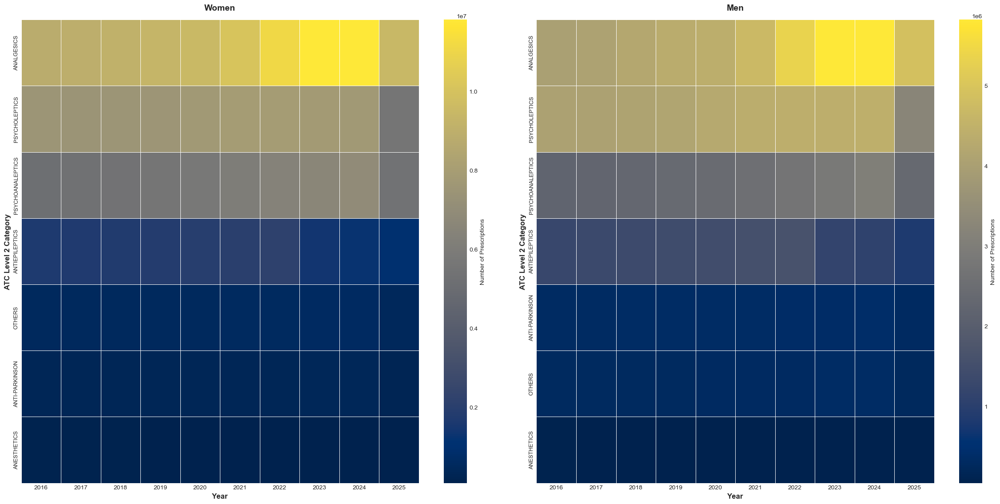


✓ Heatmap visualization created!
✓ Saved as 'nervous_system_heatmap_temporal_by_sex.png'

SUMMARY STATISTICS: NERVOUS SYSTEM DRUGS (ATC LEVEL 2)

Women:

  Total Prescriptions by Year:
    2016:   24,027,239
    2017:   24,312,048
    2018:   24,673,345
    2019:   25,146,992
    2020:   25,799,370
    2021:   27,067,221
    2022:   28,524,796
    2023:   29,139,367
    2024:   29,509,758
    2025:   22,097,583
  → Overall growth (2016-2025): -8.03%

  Top 5 ATC Level 2 Categories in 2025:
    1. ANALGESICS                                                      9,457,286
    2. PSYCHOLEPTICS                                                   5,567,800
    3. PSYCHOANALEPTICS                                                5,319,975
    4. ANTIEPILEPTICS                                                    956,905
    5. OTHERS                                                            452,532

Men:

  Total Prescriptions by Year:
    2016:   12,183,522
    2017:   12,349,425
    2018:   12,

In [4]:
# Heatmap: Temporal Evolution of Nervous System Drugs (ATC Level 2) by Sex (2016-2025)

print("="*80)
print("HEATMAP: NERVOUS SYSTEM DRUGS (ATC LEVEL 2) - TEMPORAL EVOLUTION BY SEX")
print("="*80)

# Load data
print("\nLoading data...")
df = pd.read_csv(r"cleaned_economic_data.csv")
print(f"✓ Data loaded: {len(df):,} records")

df['grup ATC nivell 2'] = df['grup ATC nivell 2'].replace(atc2_translations)
print(f"✓ ATC Level 2 labels translated to English")

# Filter for Nervous System drugs (ATC code starts with 'N')
df_nervous = df[df['codi del grup ATC nivell 1'].str.startswith('N', na=False)].copy()

print(f"\n✓ Total records for Nervous System drugs: {len(df_nervous):,}")
print(f"✓ Years available: {sorted(df_nervous['any'].unique())}")

# Get unique ATC Level 2 categories for Nervous System
nervous_atc2_categories = sorted(df_nervous['grup ATC nivell 2'].unique())
print(f"✓ ATC Level 2 categories in Nervous System: {len(nervous_atc2_categories)}")

# Aggregate data: Year x ATC Level 2 x Sex
temporal_nervous_atc2 = df_nervous.groupby(['any', 'sexe', 'grup ATC nivell 2']).agg({
    'nombre de receptes': 'sum'
}).reset_index()

print(f"\n✓ Aggregated data shape: {temporal_nervous_atc2.shape}")

# Create separate heatmaps for Women and Men
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 12))

# Women heatmap
print("\n📊 Creating heatmap for Women...")
women_data = temporal_nervous_atc2[temporal_nervous_atc2['sexe'] == 'Women']

if women_data.empty:
    print("⚠️  No data found for Women. Checking available sex values:")
    print(f"   Available sex values: {temporal_nervous_atc2['sexe'].unique()}")
    # Try alternative sex labels
    women_data = temporal_nervous_atc2[temporal_nervous_atc2['sexe'] == 'Dona']

if women_data.empty:
    print("❌ Still no Women data found. Skipping Women heatmap.")
    ax1.text(0.5, 0.5, 'No data available for Women', 
             ha='center', va='center', transform=ax1.transAxes, fontsize=16)
    ax1.set_title('Women: Nervous System Drugs (ATC Level 2)\nTemporal Evolution 2016-2025', 
                  fontsize=14, fontweight='bold', pad=15)
else:
    women_pivot = women_data.pivot_table(
        index='grup ATC nivell 2',
        columns='any',
        values='nombre de receptes',
        fill_value=0
    )
    
    # Sort by total prescriptions across all years
    women_pivot['total'] = women_pivot.sum(axis=1)
    women_pivot = women_pivot.sort_values('total', ascending=False).drop('total', axis=1)
    
    print(f"   Women pivot shape: {women_pivot.shape}")
    print(f"   Years in pivot: {list(women_pivot.columns)}")
    
    # Create heatmap with linear scale (logarithmic causes issues with zeros)
    # Use robust=True to handle outliers better
    sns.heatmap(women_pivot, 
                annot=False, 
                cmap='cividis',
                cbar_kws={'label': 'Number of Prescriptions'},
                linewidths=0.5,
                linecolor='white',
                ax=ax1,
                robust=True)
    
    ax1.set_title('Women', 
                  fontsize=14, fontweight='bold', pad=15)
    ax1.set_xlabel('Year', fontsize=12, fontweight='bold')
    ax1.set_ylabel('ATC Level 2 Category', fontsize=12, fontweight='bold')
    ax1.tick_params(axis='y', labelsize=9)
    ax1.tick_params(axis='x', labelsize=10)

# Men heatmap
print("📊 Creating heatmap for Men...")
men_data = temporal_nervous_atc2[temporal_nervous_atc2['sexe'] == 'Men']

if men_data.empty:
    print("⚠️  No data found for Men. Trying alternative label...")
    men_data = temporal_nervous_atc2[temporal_nervous_atc2['sexe'] == 'Home']

if men_data.empty:
    print("❌ Still no Men data found. Skipping Men heatmap.")
    ax2.text(0.5, 0.5, 'No data available for Men', 
             ha='center', va='center', transform=ax2.transAxes, fontsize=16)
    ax2.set_title('Men: Nervous System Drugs (ATC Level 2)\nTemporal Evolution 2016-2025', 
                  fontsize=14, fontweight='bold', pad=15)
else:
    men_pivot = men_data.pivot_table(
        index='grup ATC nivell 2',
        columns='any',
        values='nombre de receptes',
        fill_value=0
    )
    
    # Sort by total prescriptions across all years
    men_pivot['total'] = men_pivot.sum(axis=1)
    men_pivot = men_pivot.sort_values('total', ascending=False).drop('total', axis=1)
    
    print(f"   Men pivot shape: {men_pivot.shape}")
    
    # Create heatmap with linear scale
    sns.heatmap(men_pivot, 
                annot=False, 
                cmap='cividis',
                cbar_kws={'label': 'Number of Prescriptions'},
                linewidths=0.5,
                linecolor='white',
                ax=ax2,
                robust=True)
    
    ax2.set_title('Men', 
                  fontsize=14, fontweight='bold', pad=15)
    ax2.set_xlabel('Year', fontsize=12, fontweight='bold')
    ax2.set_ylabel('ATC Level 2 Category', fontsize=12, fontweight='bold')
    ax2.tick_params(axis='y', labelsize=9)
    ax2.tick_params(axis='x', labelsize=10)

plt.tight_layout(pad=3.0)
#plt.savefig('nervous_system_heatmap_temporal_by_sex.png', dpi=300, bbox_inches='tight')
plt.show()

print("\n✓ Heatmap visualization created!")
print(f"✓ Saved as 'nervous_system_heatmap_temporal_by_sex.png'")

# Print summary statistics
print(f"\n{'='*80}")
print("SUMMARY STATISTICS: NERVOUS SYSTEM DRUGS (ATC LEVEL 2)")
print(f"{'='*80}")

for sex in ['Women', 'Men']:
    # Use alternative labels if needed
    sex_label = 'Dona' if sex == 'Women' else 'Home'
    print(f"\n{sex}:")
    sex_data = temporal_nervous_atc2[temporal_nervous_atc2['sexe'] == sex_label]
    
    if sex_data.empty:
        print(f"  ⚠️ No data available for {sex}")
        continue
    
    # Total by year
    yearly_totals = sex_data.groupby('any')['nombre de receptes'].sum()
    print(f"\n  Total Prescriptions by Year:")
    for year, total in yearly_totals.items():
        print(f"    {year}: {int(total):>12,}")
    
    # Growth rate
    if len(yearly_totals) > 1:
        first_year_total = yearly_totals.iloc[0]
        last_year_total = yearly_totals.iloc[-1]
        growth = ((last_year_total - first_year_total) / first_year_total) * 100
        print(f"  → Overall growth ({int(yearly_totals.index[0])}-{int(yearly_totals.index[-1])}): {growth:+.2f}%")
    
    # Top 5 categories in 2025
    print(f"\n  Top 5 ATC Level 2 Categories in 2025:")
    sex_2025 = sex_data[sex_data['any'] == 2025].sort_values('nombre de receptes', ascending=False).head(5)
    if not sex_2025.empty:
        for rank, (_, row) in enumerate(sex_2025.iterrows(), 1):
            print(f"    {rank}. {row['grup ATC nivell 2'][:60]:<60} {int(row['nombre de receptes']):>12,}")
    else:
        print(f"    No data available for 2025")

print(f"\n{'='*80}")
print("✓ Analysis complete!")
print(f"{'='*80}")


PACKED BUBBLE CHARTS: MENTAL HEALTH DRUGS BY AGE & SEX

Loading data...
✓ Data loaded: 7,536,094 records
✓ Filtered for mental health drugs: 593,970 records
✓ Drug codes: ['N05A', 'N05B', 'N05C', 'N06A', 'N06B', 'N06C', 'N06D']
✓ Aggregated data shape: (2607, 5)
✓ Years: [2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023, 2024, 2025]

📊 Creating packed bubble chart for 2016...


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\4161339839.py:131: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle = plt.Circle(


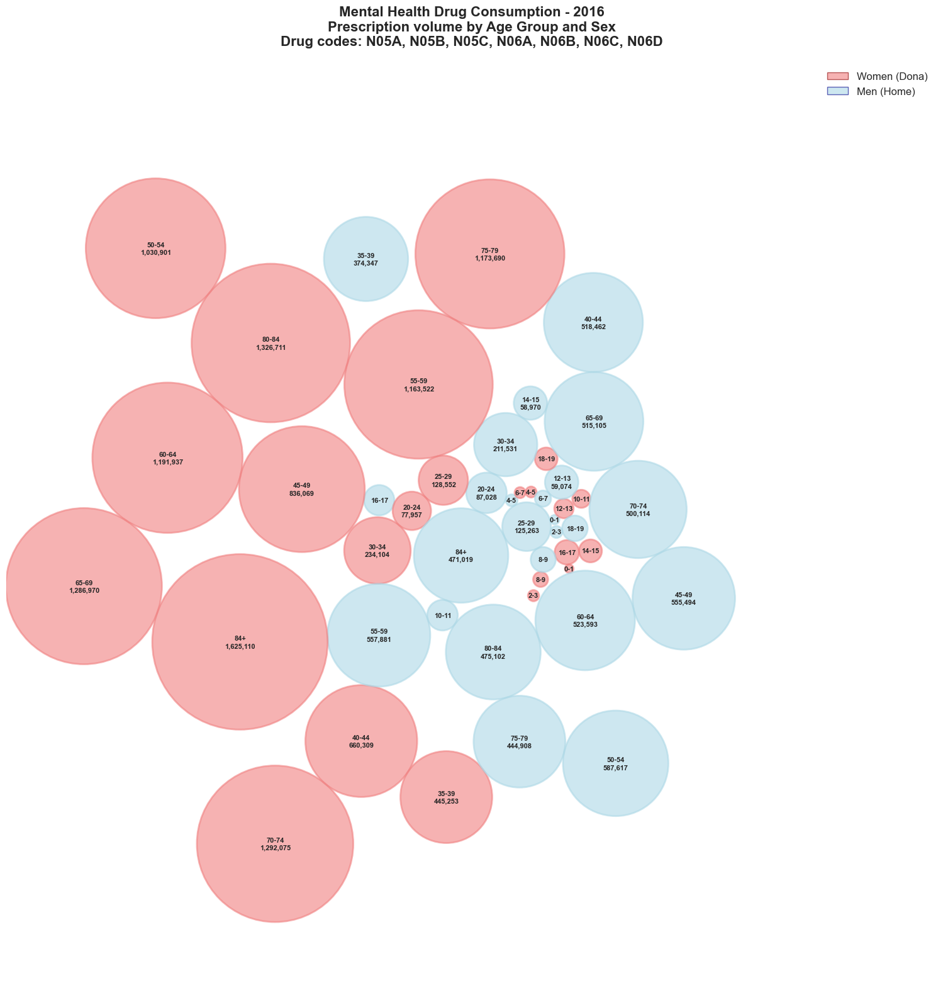

   ✓ Saved packed_bubbles_2016.png

📊 Creating packed bubble chart for 2017...


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\4161339839.py:131: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle = plt.Circle(


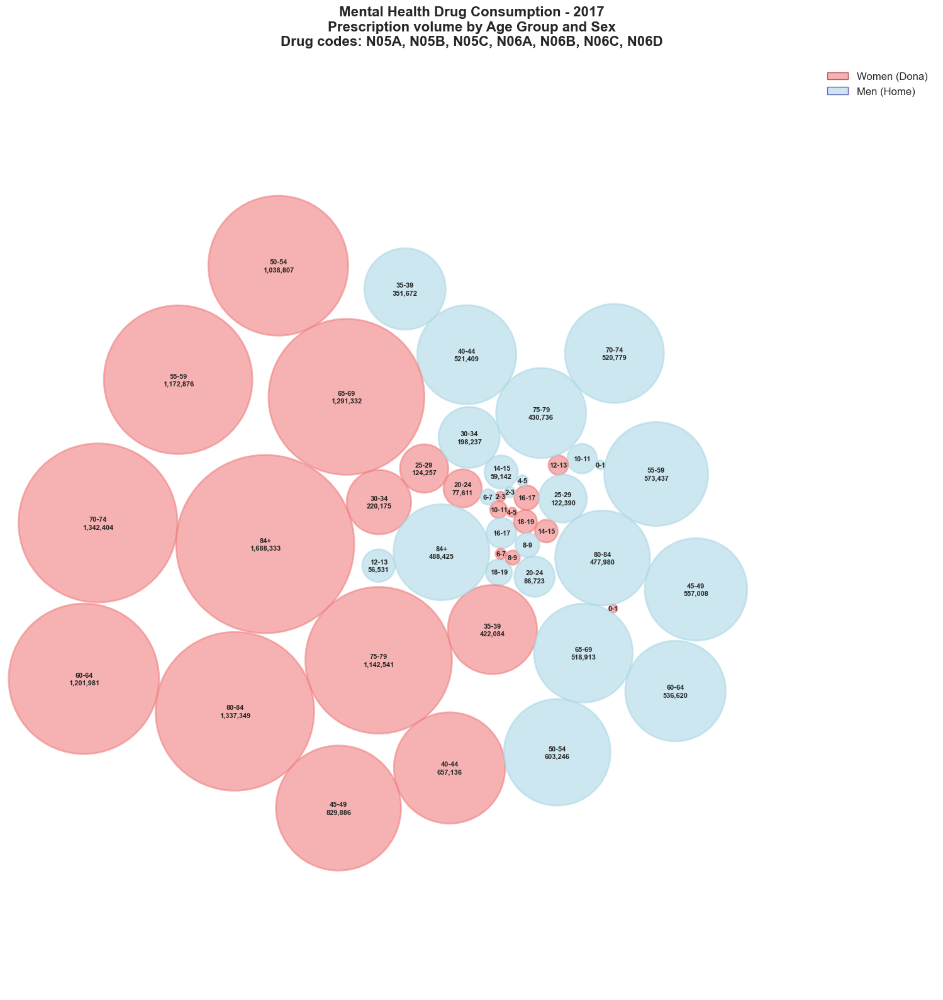

   ✓ Saved packed_bubbles_2017.png

📊 Creating packed bubble chart for 2018...


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\4161339839.py:131: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle = plt.Circle(


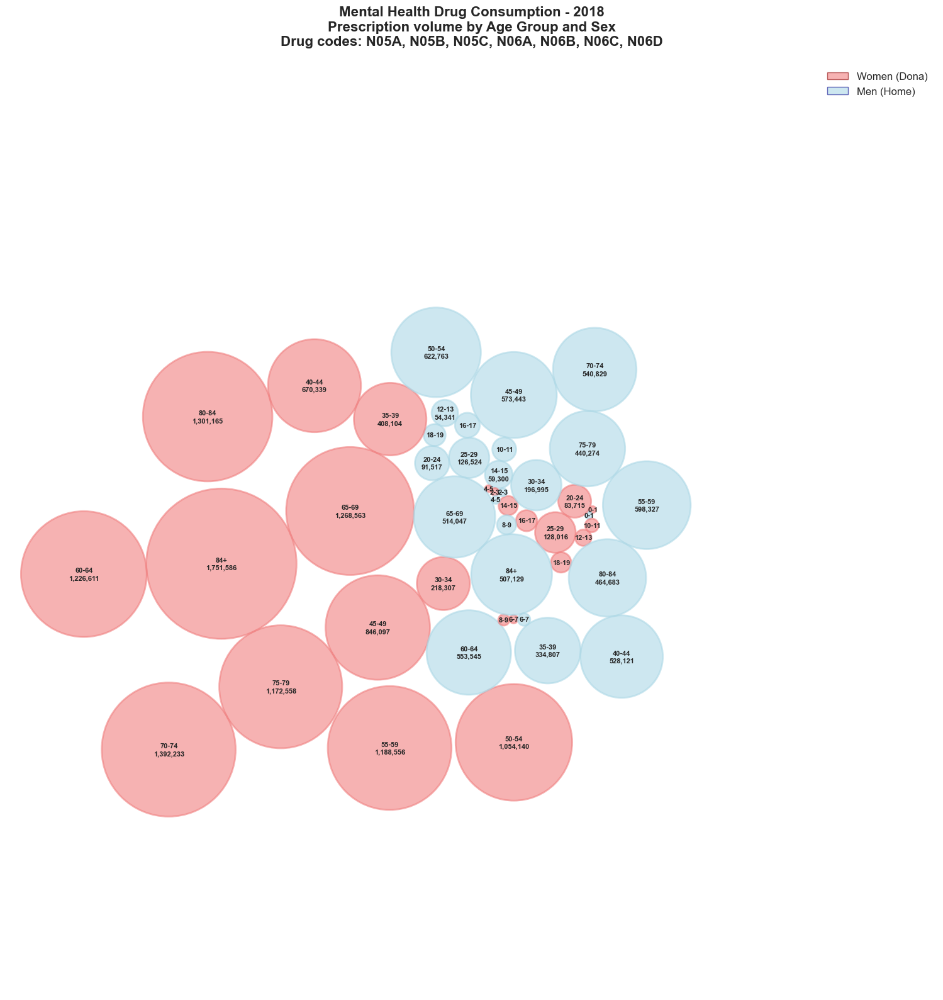

   ✓ Saved packed_bubbles_2018.png

📊 Creating packed bubble chart for 2019...


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\4161339839.py:131: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle = plt.Circle(


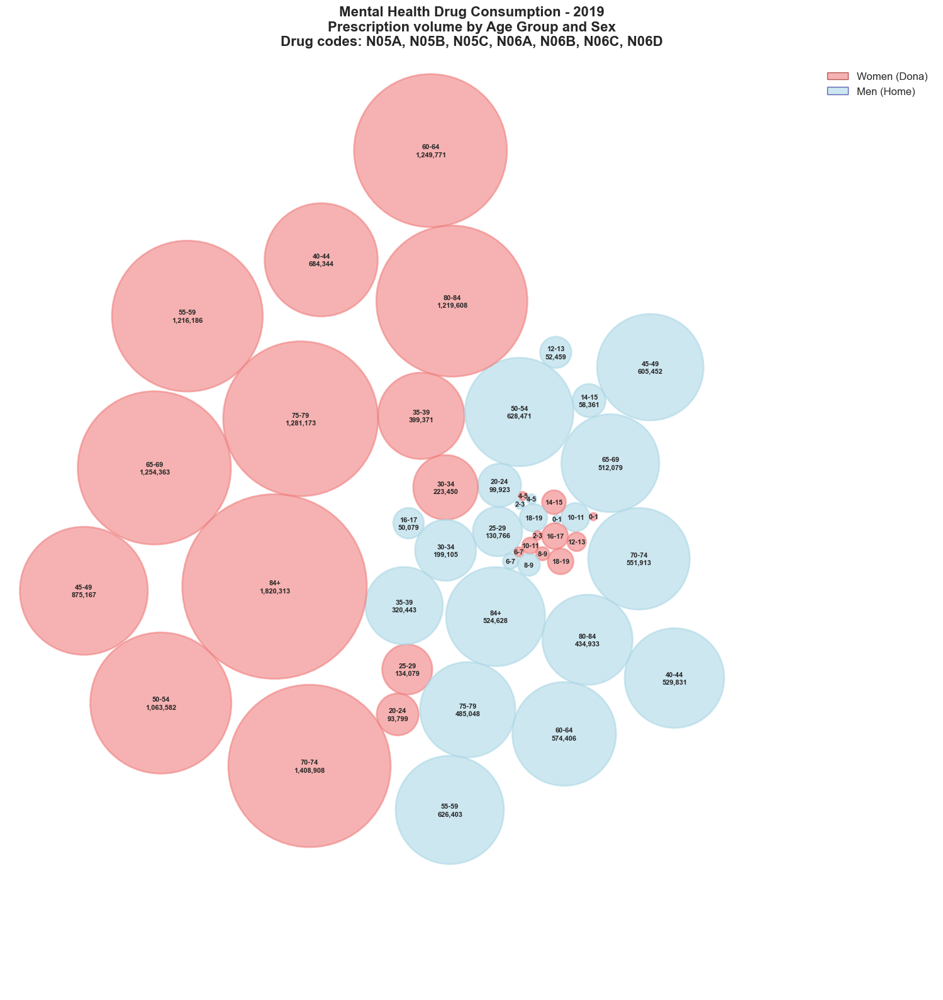

   ✓ Saved packed_bubbles_2019.png

📊 Creating packed bubble chart for 2020...


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\4161339839.py:131: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle = plt.Circle(


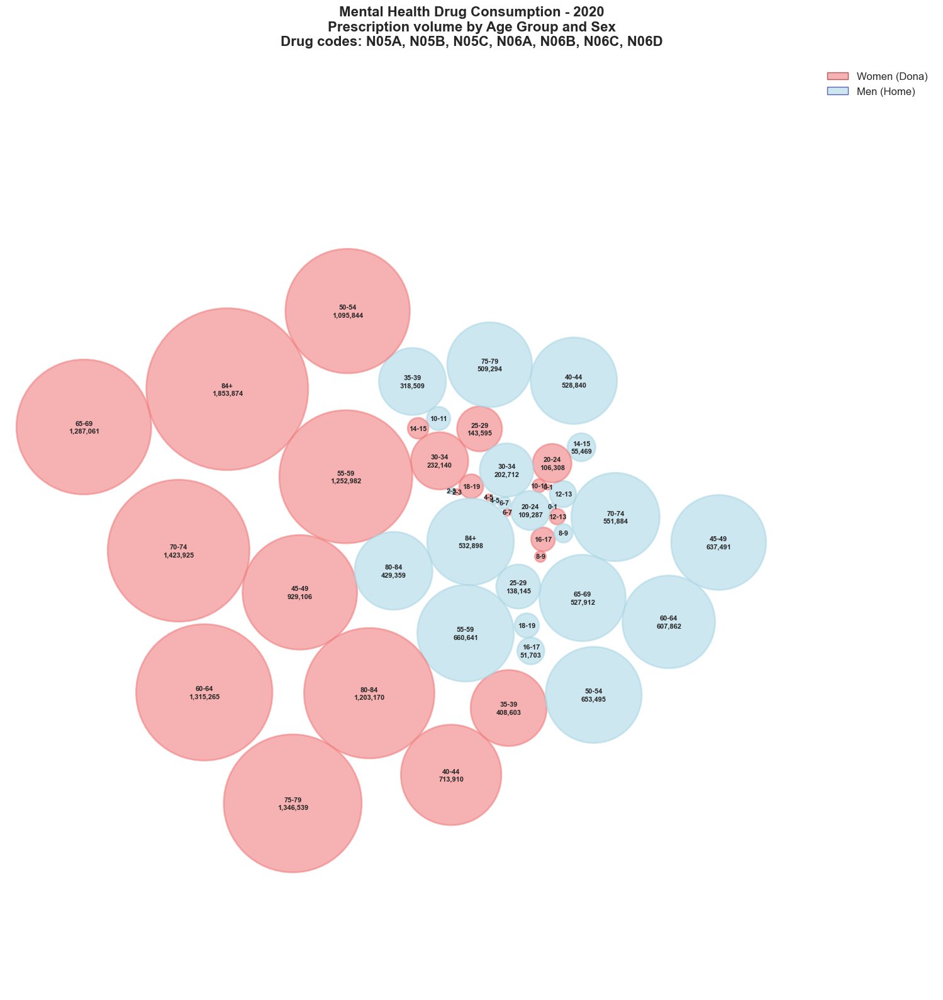

   ✓ Saved packed_bubbles_2020.png

📊 Creating packed bubble chart for 2021...


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\4161339839.py:131: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle = plt.Circle(


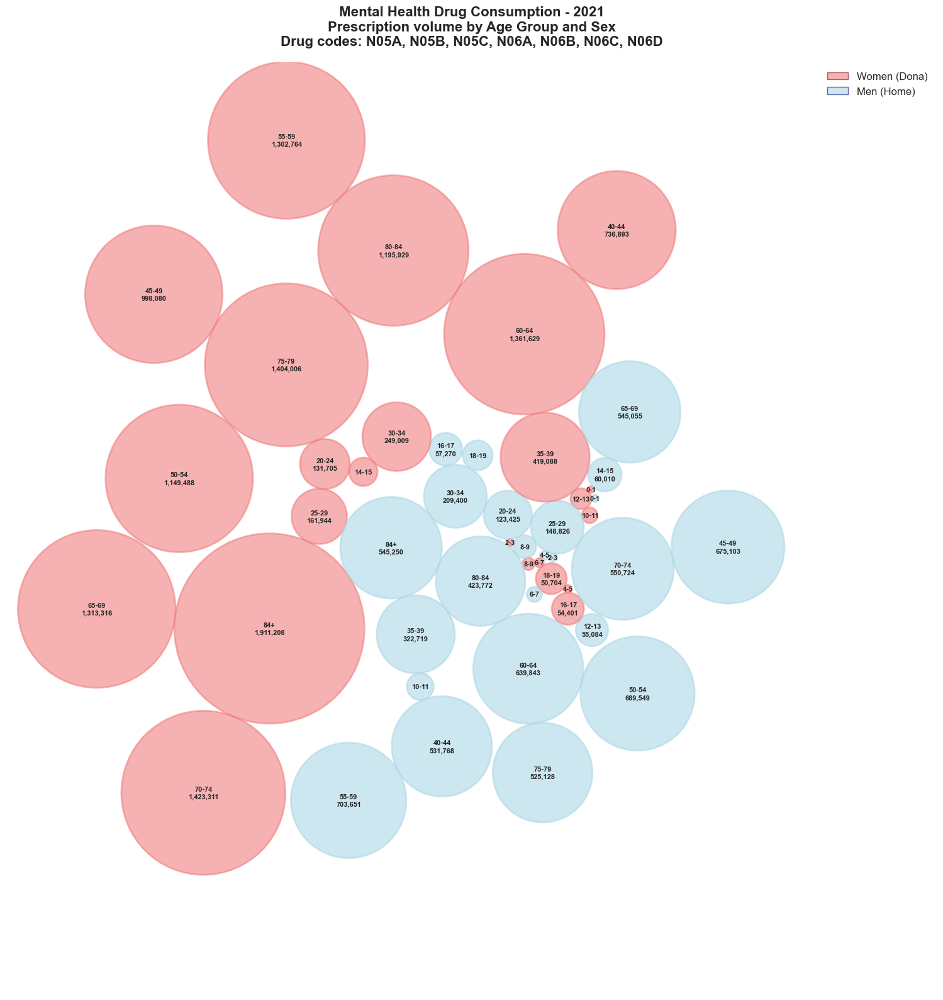

   ✓ Saved packed_bubbles_2021.png

📊 Creating packed bubble chart for 2022...


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\4161339839.py:131: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle = plt.Circle(


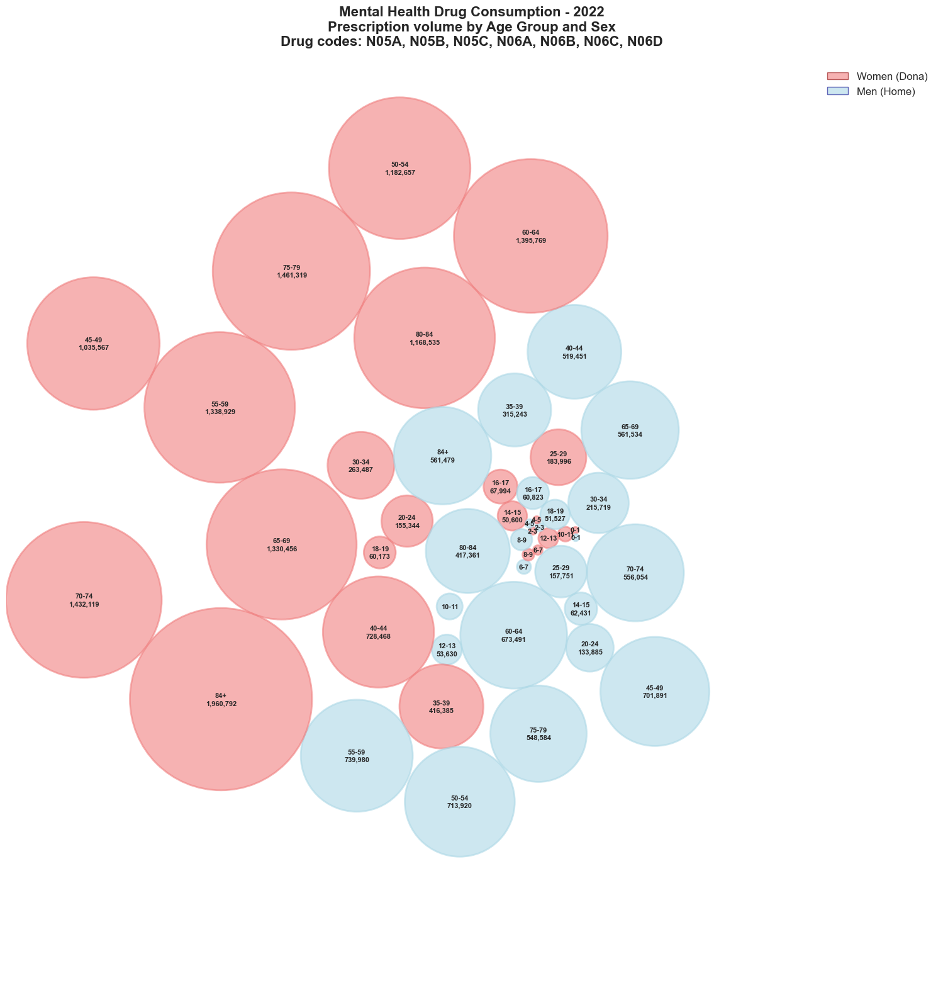

   ✓ Saved packed_bubbles_2022.png

📊 Creating packed bubble chart for 2023...


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\4161339839.py:131: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle = plt.Circle(


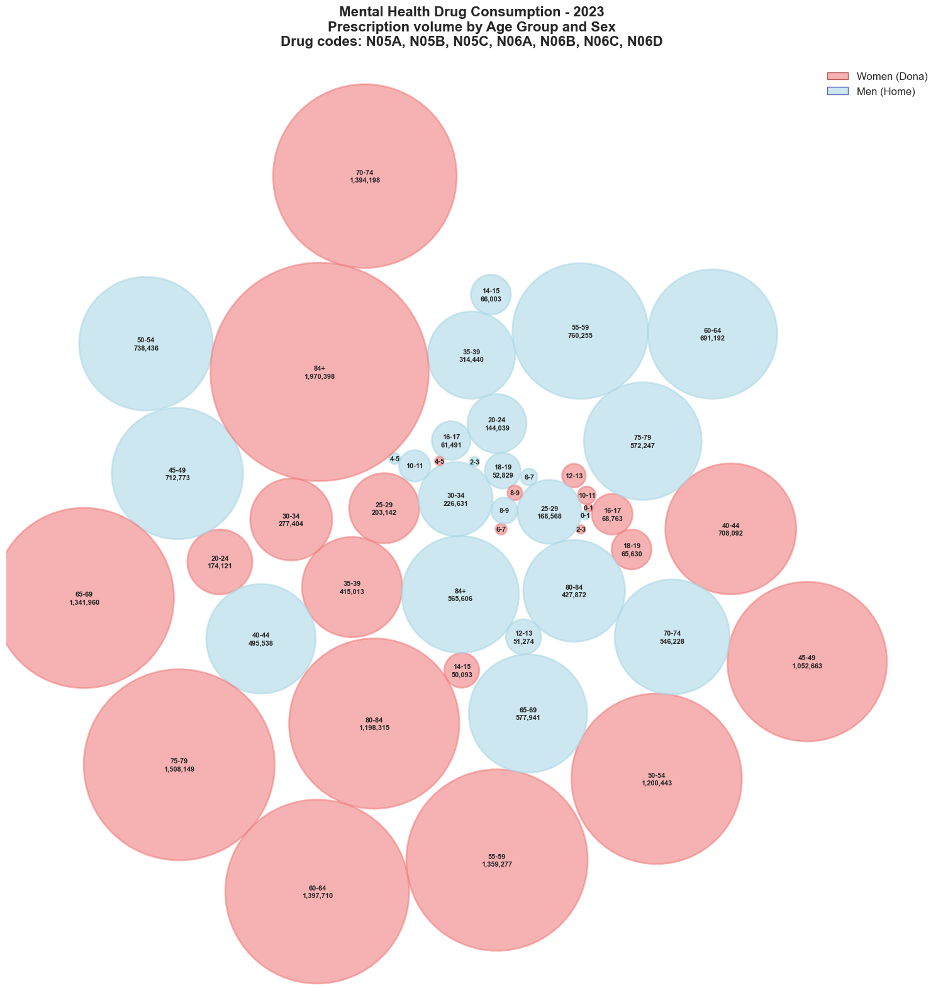

   ✓ Saved packed_bubbles_2023.png

📊 Creating packed bubble chart for 2024...


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\4161339839.py:131: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle = plt.Circle(


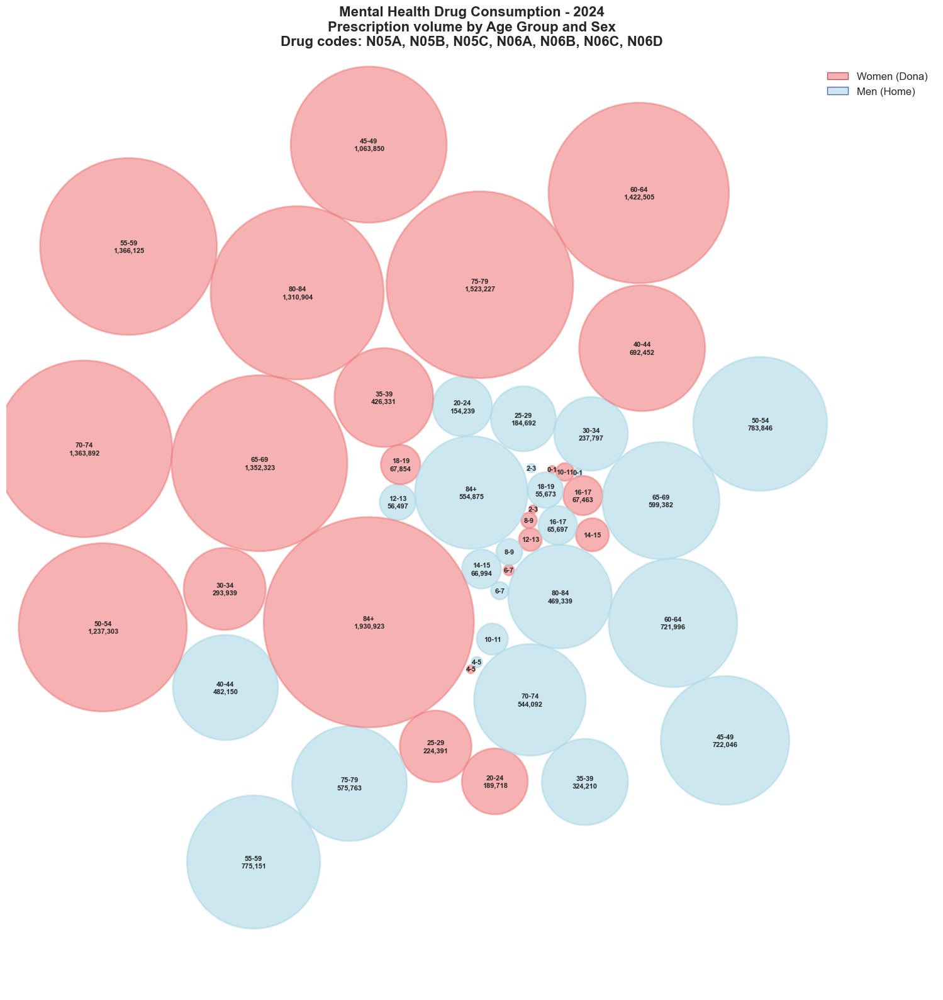

   ✓ Saved packed_bubbles_2024.png

📊 Creating packed bubble chart for 2025...


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\4161339839.py:131: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  circle = plt.Circle(


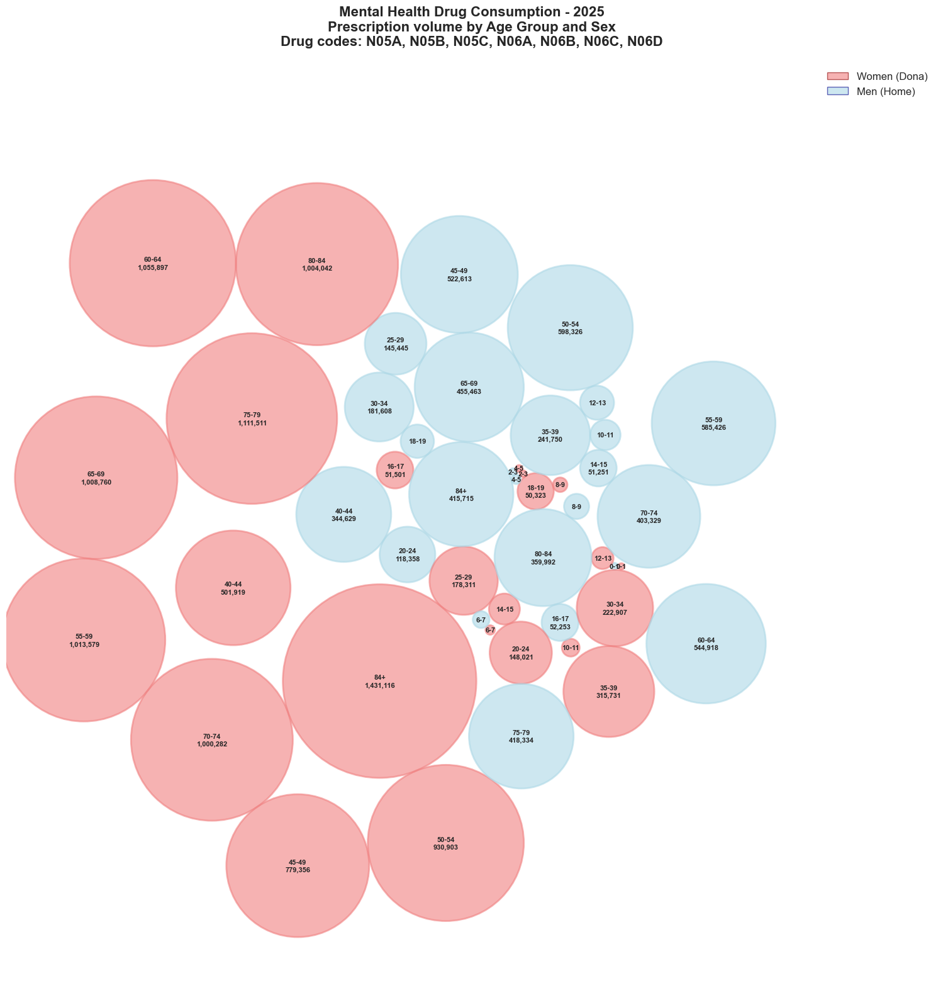

   ✓ Saved packed_bubbles_2025.png

✓ All packed bubble charts created!

SUMMARY: MENTAL HEALTH DRUG CONSUMPTION BY AGE & SEX

2016:
  Women:   12,631,681 prescriptions
  Men:      6,265,036 prescriptions

  Top 3 Age Groups:
    84+                     2,096,129
    65-69                   1,802,075
    80-84                   1,801,813

2017:
  Women:   12,700,712 prescriptions
  Men:      6,294,435 prescriptions

  Top 3 Age Groups:
    84+                     2,176,758
    70-74                   1,863,183
    80-84                   1,815,329

2018:
  Women:   12,866,572 prescriptions
  Men:      6,391,569 prescriptions

  Top 3 Age Groups:
    84+                     2,258,715
    70-74                   1,933,062
    55-59                   1,786,883

2019:
  Women:   13,084,222 prescriptions
  Men:      6,520,126 prescriptions

  Top 3 Age Groups:
    84+                     2,344,941
    70-74                   1,960,821
    55-59                   1,842,589

2020:
  Women:   

In [5]:
# Packed Bubble Charts: Mental Health Drug Consumption by Age and Sex (2016-2025)
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import patches
import seaborn as sns

print("="*80)
print("PACKED BUBBLE CHARTS: MENTAL HEALTH DRUGS BY AGE & SEX")
print("="*80)

# Load data
print("\nLoading data...")
df = pd.read_csv(r"cleaned_economic_data.csv")
print(f"✓ Data loaded: {len(df):,} records")

# Define mental health drug codes (ATC Level 3)
mental_health_codes = ['N05A', 'N05B', 'N05C', 'N06A', 'N06B', 'N06C', 'N06D']

# Filter for these specific codes
df_mental = df[df['codi del grup ATC nivell 3'].isin(mental_health_codes)].copy()
print(f"✓ Filtered for mental health drugs: {len(df_mental):,} records")
print(f"✓ Drug codes: {mental_health_codes}")

# Aggregate by year, age group, sex, and drug code
bubble_data = df_mental.groupby(['any', "grup d'edat", 'sexe', 'codi del grup ATC nivell 3']).agg({
    'nombre de receptes': 'sum'
}).reset_index()

print(f"✓ Aggregated data shape: {bubble_data.shape}")

# Get unique years
years = sorted(bubble_data['any'].unique())
print(f"✓ Years: {years}")

# Create color mapping for drug codes
colors = sns.color_palette("colorblind", n_colors=len(mental_health_codes))
color_map = {code: colors[i] for i, code in enumerate(mental_health_codes)}

# Helper function to pack circles using simple physics simulation
def pack_circles(sizes, max_iterations=1000):
    """
    Pack circles using a simple physics-based approach.
    Returns x, y coordinates for each circle.
    """
    n = len(sizes)
    if n == 0:
        return [], []
    
    # Initialize positions randomly in a circle
    angles = np.linspace(0, 2*np.pi, n, endpoint=False)
    radii_init = np.sqrt(np.random.uniform(0, 1, n))
    x = radii_init * np.cos(angles)
    y = radii_init * np.sin(angles)
    
    # Iteratively adjust positions to avoid overlaps
    for iteration in range(max_iterations):
        moved = False
        for i in range(n):
            for j in range(i+1, n):
                dx = x[j] - x[i]
                dy = y[j] - y[i]
                dist = np.sqrt(dx**2 + dy**2)
                min_dist = sizes[i] + sizes[j]
                
                if dist < min_dist and dist > 0:
                    # Move circles apart
                    overlap = min_dist - dist
                    angle = np.arctan2(dy, dx)
                    move_x = overlap * np.cos(angle) / 2
                    move_y = overlap * np.sin(angle) / 2
                    
                    x[i] -= move_x
                    y[i] -= move_y
                    x[j] += move_x
                    y[j] += move_y
                    moved = True
        
        if not moved:
            break
    
    return x, y

# Create bubble charts for each year
for year in years:
    print(f"\n📊 Creating packed bubble chart for {int(year)}...")
    
    year_data = bubble_data[bubble_data['any'] == year].copy()
    
    # Calculate total for normalization
    total_prescriptions = year_data['nombre de receptes'].sum()
    
    # Create figure
    fig, ax = plt.subplots(figsize=(16, 16))
    
    # Group by age and sex to create bubbles
    age_sex_groups = year_data.groupby(["grup d'edat", 'sexe']).agg({
        'nombre de receptes': 'sum'
    }).reset_index()
    
    # Calculate bubble sizes (proportional to prescriptions)
    # Use square root for better visual scaling
    age_sex_groups['bubble_size'] = np.sqrt(age_sex_groups['nombre de receptes'] / total_prescriptions) * 10
    
    # Pack the bubbles
    sizes = age_sex_groups['bubble_size'].values
    if len(sizes) > 0:
        x_positions, y_positions = pack_circles(sizes)
    else:
        x_positions, y_positions = [], []
    
    # Draw bubbles
    for idx, (_, row) in enumerate(age_sex_groups.iterrows()):
        age_group = row["grup d'edat"]
        sex = row['sexe']
        prescriptions = row['nombre de receptes']
        bubble_size = row['bubble_size']
        
        # Get drug composition for this age-sex group
        group_drugs = year_data[
            (year_data["grup d'edat"] == age_group) & 
            (year_data['sexe'] == sex)
        ]
        
        # Color based on sex
        bubble_color = 'lightcoral' if sex == 'Dona' else 'lightblue'
        edge_color = 'darkred' if sex == 'Dona' else 'darkblue'
        
        # Draw main bubble
        if idx < len(x_positions):
            circle = plt.Circle(
                (x_positions[idx], y_positions[idx]),
                bubble_size,
                color=bubble_color,
                alpha=0.6,
                edgecolor=edge_color,
                linewidth=2
            )
            ax.add_patch(circle)
            
            # Add label (without sex) - only if prescriptions >= 50000
            if prescriptions >= 50000:
                label = f"{age_group}\n{int(prescriptions):,}"
            else:
                label = f"{age_group}"
            ax.text(
                x_positions[idx], y_positions[idx],
                label,
                ha='center', va='center',
                fontsize=8, fontweight='bold',
                #bbox=dict(boxstyle='round,pad=0.5', facecolor='none', alpha=0.7, edgecolor='black')
            )
    
    # Set equal aspect ratio and limits
    ax.set_aspect('equal')
    max_extent = max(np.abs(x_positions).max() if len(x_positions) > 0 else 1,
                     np.abs(y_positions).max() if len(y_positions) > 0 else 1)
    margin = max_extent * 0.2
    ax.set_xlim(-max_extent - margin, max_extent + margin)
    ax.set_ylim(-max_extent - margin, max_extent + margin)
    
    ax.axis('off')
    
    # Title
    ax.set_title(
        f'Mental Health Drug Consumption - {int(year)}\n' +
        f'Prescription volume by Age Group and Sex\n' +
        f'Drug codes: {", ".join(mental_health_codes)}',
        fontsize=16, fontweight='bold', pad=20
    )
    
    # Legend
    from matplotlib.patches import Patch
    legend_elements = [
        Patch(facecolor='lightcoral', edgecolor='darkred', label='Women (Dona)', alpha=0.6),
        Patch(facecolor='lightblue', edgecolor='darkblue', label='Men (Home)', alpha=0.6)
    ]
    ax.legend(handles=legend_elements, loc='upper right', fontsize=12, framealpha=0.9)
    
    plt.tight_layout()
    #plt.savefig(f'packed_bubbles_{int(year)}.png', dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()
    
    print(f"   ✓ Saved packed_bubbles_{int(year)}.png")

print("\n" + "="*80)
print("✓ All packed bubble charts created!")
print("="*80)

# Print summary statistics
print(f"\n{'='*80}")
print("SUMMARY: MENTAL HEALTH DRUG CONSUMPTION BY AGE & SEX")
print(f"{'='*80}")

for year in years:
    print(f"\n{int(year)}:")
    year_data = bubble_data[bubble_data['any'] == year]
    
    # By sex
    by_sex = year_data.groupby('sexe')['nombre de receptes'].sum()
    print(f"  Women: {int(by_sex.get('Dona', 0)):>12,} prescriptions")
    print(f"  Men:   {int(by_sex.get('Home', 0)):>12,} prescriptions")
    
    # Top 3 age groups
    by_age = year_data.groupby("grup d'edat")['nombre de receptes'].sum().sort_values(ascending=False).head(3)
    print(f"\n  Top 3 Age Groups:")
    for age, count in by_age.items():
        print(f"    {age:<20} {int(count):>12,}")

print(f"\n{'='*80}")
print("✓ Analysis complete!")
print(f"{'='*80}")

PACKED BUBBLE CHARTS: MENTAL HEALTH DRUGS - DETAILED BY AGE & SEX

Loading data...
✓ Data loaded: 7,536,094 records
✓ Filtered for mental health drugs: 593,970 records
✓ Aggregated data shape: (2607, 5)
✓ Years: [2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023, 2024, 2025]
✓ Age groups: 24

📊 Creating detailed packed bubble chart for 2016...


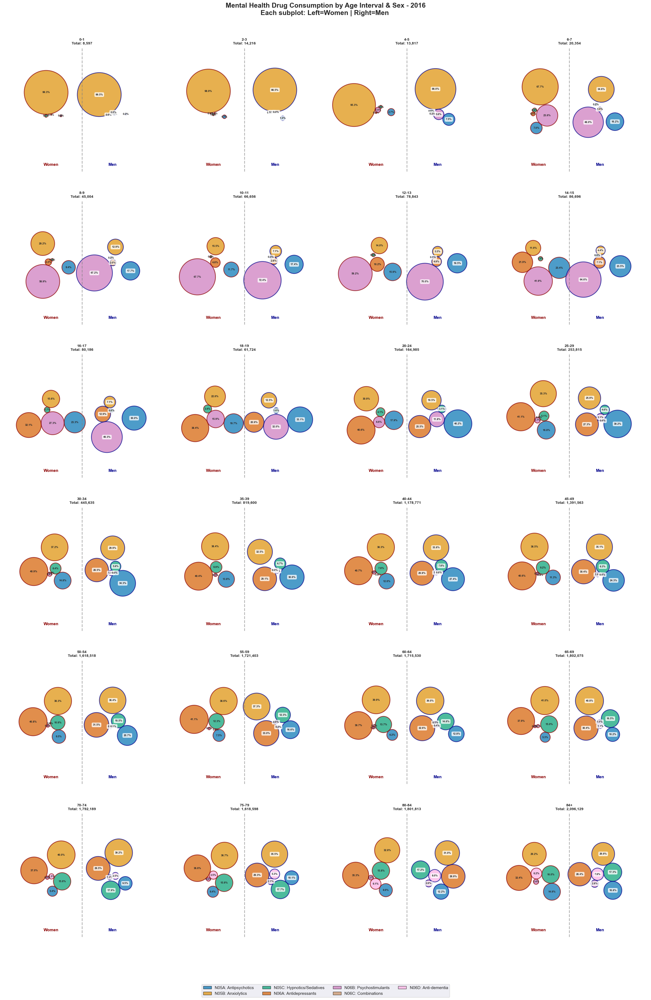

   ✓ Saved packed_bubbles_detailed_2016.png

📊 Creating detailed packed bubble chart for 2017...


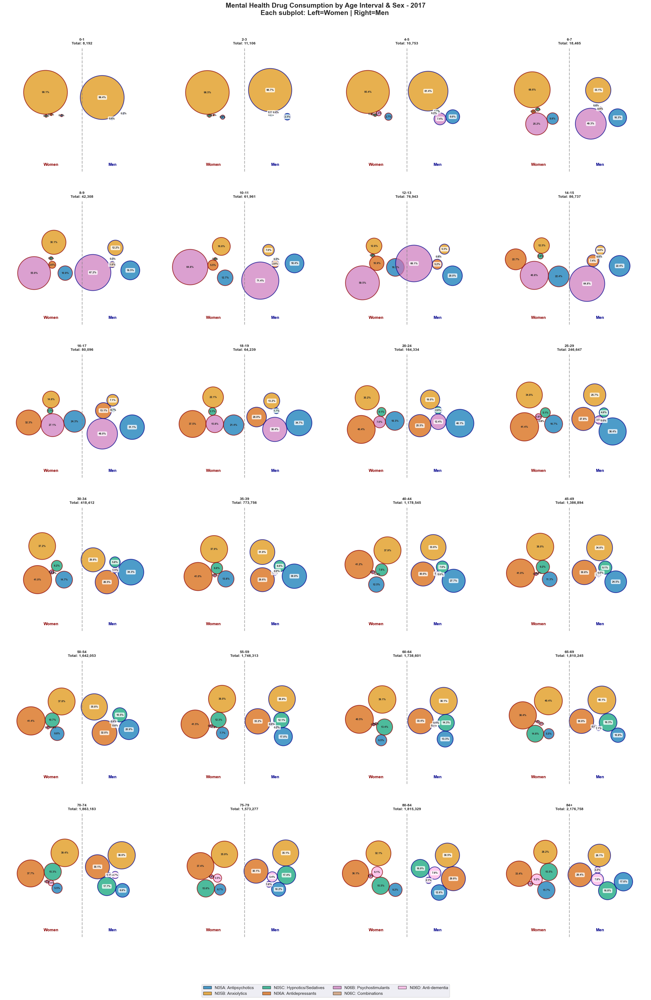

   ✓ Saved packed_bubbles_detailed_2017.png

📊 Creating detailed packed bubble chart for 2018...


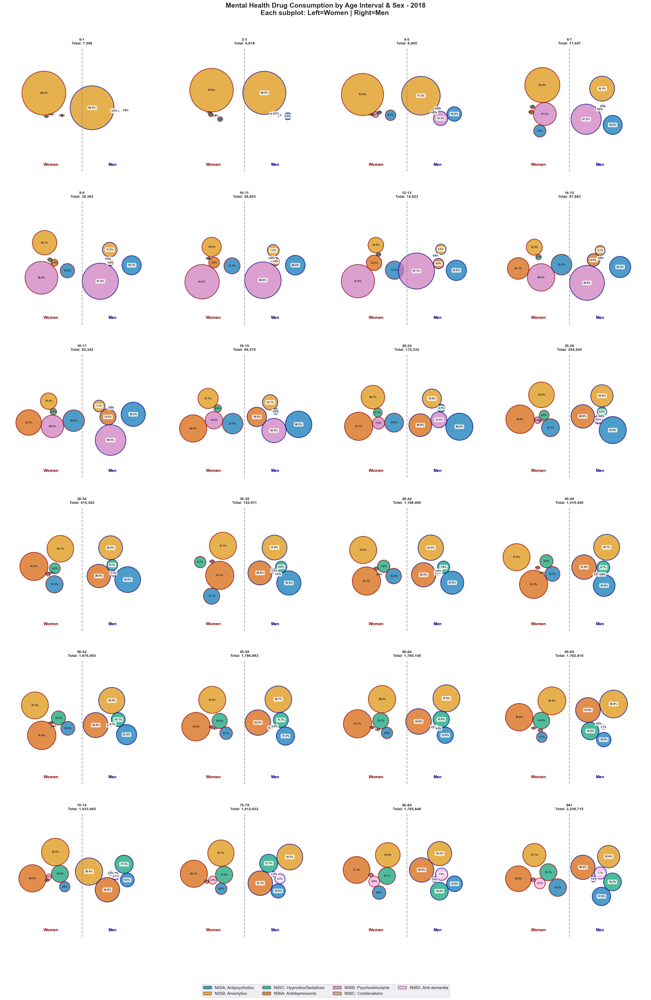

   ✓ Saved packed_bubbles_detailed_2018.png

📊 Creating detailed packed bubble chart for 2019...


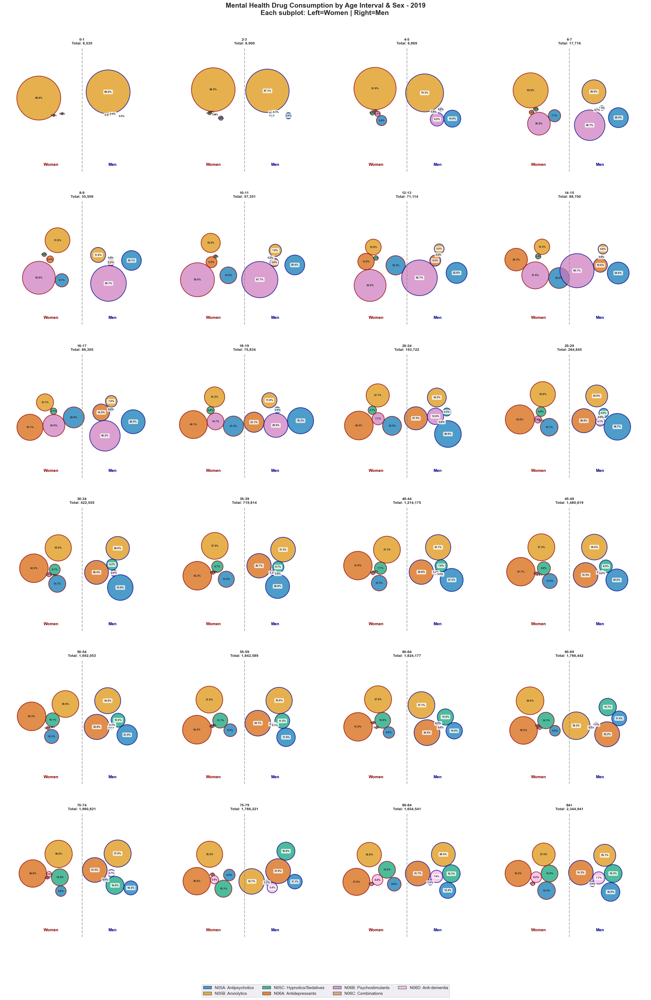

   ✓ Saved packed_bubbles_detailed_2019.png

📊 Creating detailed packed bubble chart for 2020...


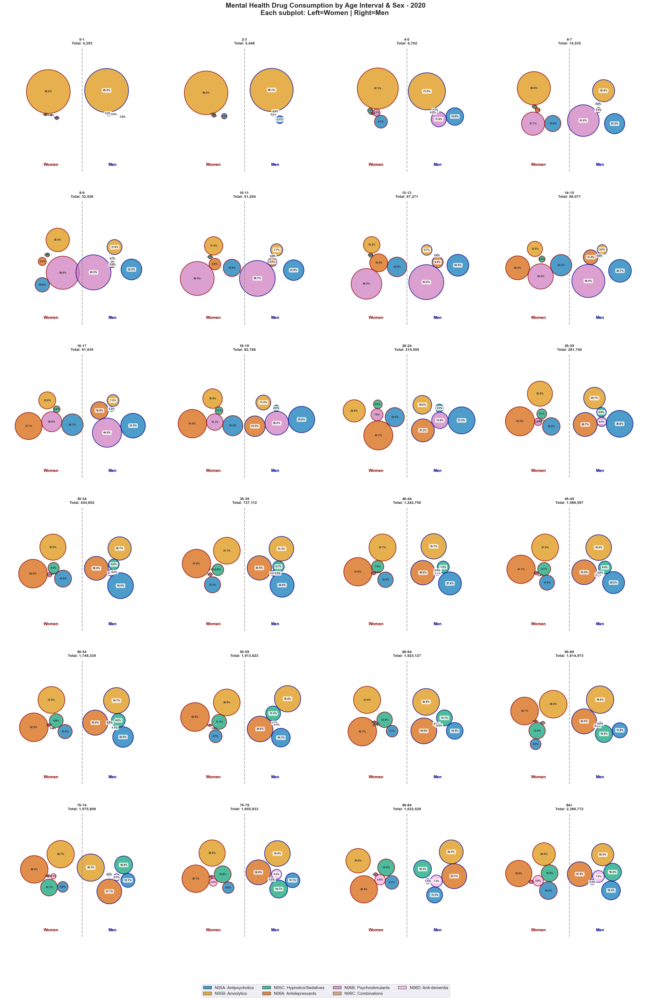

   ✓ Saved packed_bubbles_detailed_2020.png

📊 Creating detailed packed bubble chart for 2021...


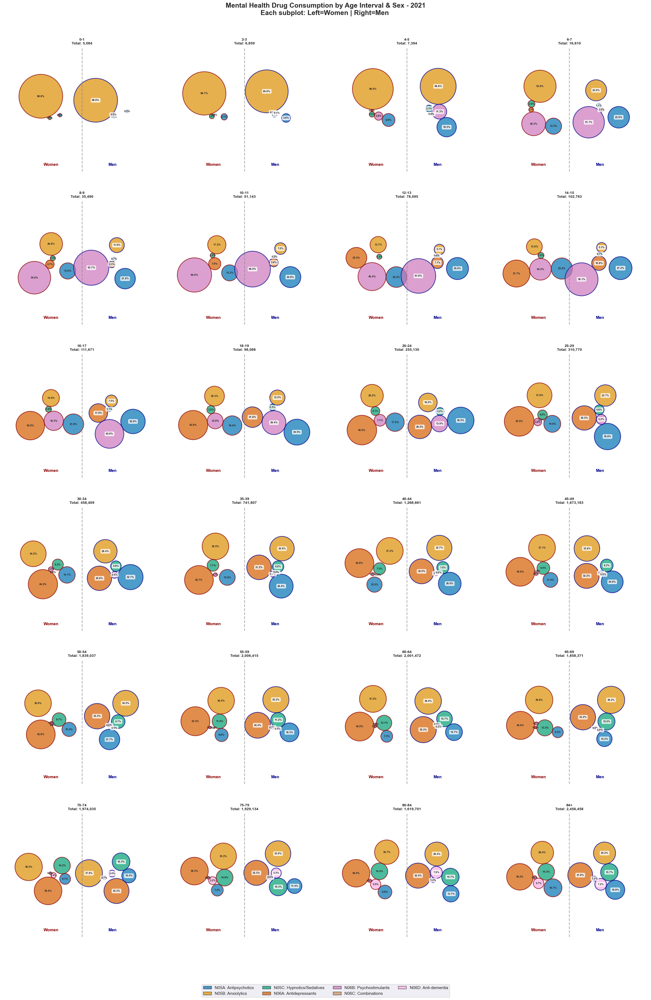

   ✓ Saved packed_bubbles_detailed_2021.png

📊 Creating detailed packed bubble chart for 2022...


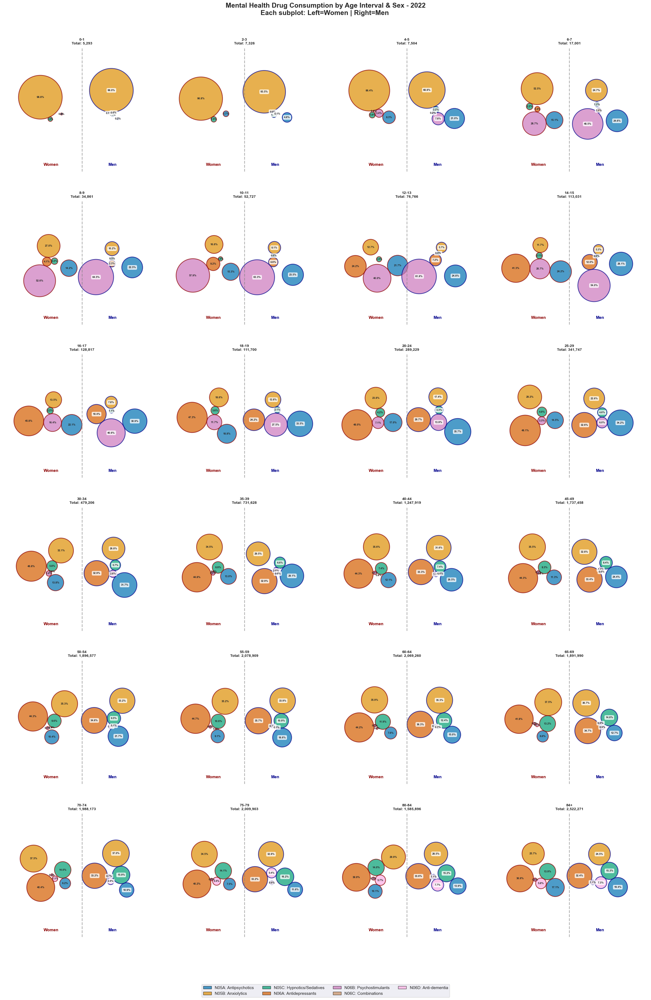

   ✓ Saved packed_bubbles_detailed_2022.png

📊 Creating detailed packed bubble chart for 2023...


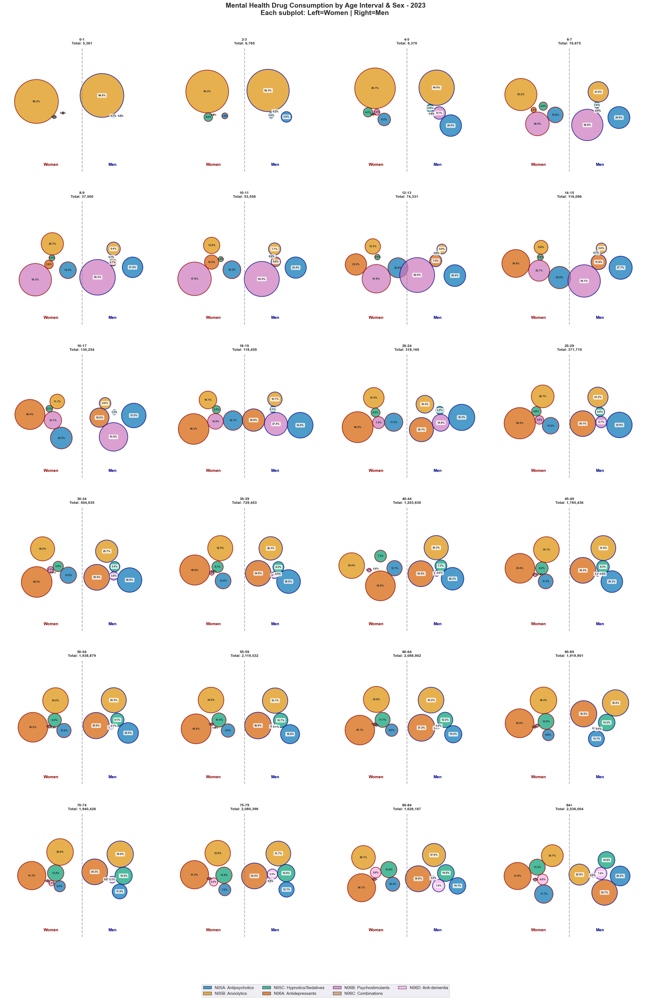

   ✓ Saved packed_bubbles_detailed_2023.png

📊 Creating detailed packed bubble chart for 2024...


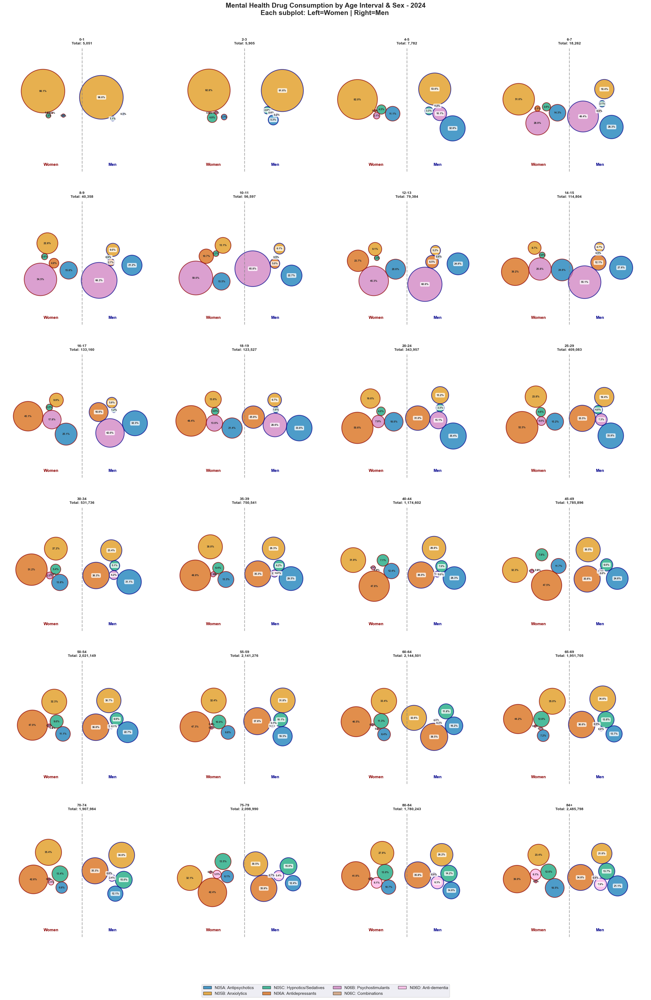

   ✓ Saved packed_bubbles_detailed_2024.png

📊 Creating detailed packed bubble chart for 2025...


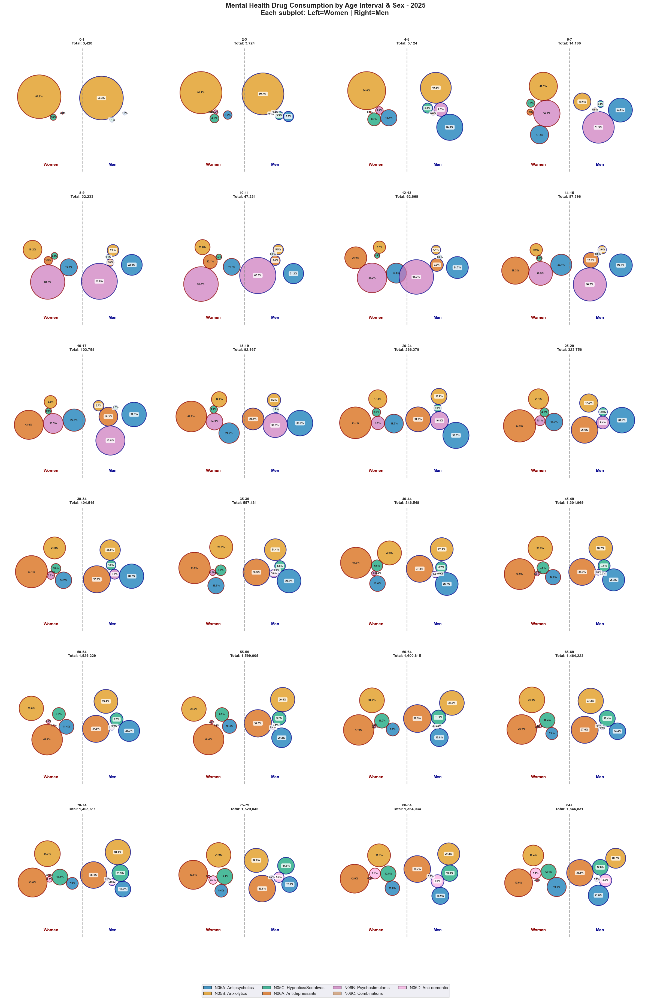

   ✓ Saved packed_bubbles_detailed_2025.png

✓ All detailed packed bubble charts created!

Generated files:
  - packed_bubbles_detailed_2016.png
  - packed_bubbles_detailed_2017.png
  - packed_bubbles_detailed_2018.png
  - packed_bubbles_detailed_2019.png
  - packed_bubbles_detailed_2020.png
  - packed_bubbles_detailed_2021.png
  - packed_bubbles_detailed_2022.png
  - packed_bubbles_detailed_2023.png
  - packed_bubbles_detailed_2024.png
  - packed_bubbles_detailed_2025.png


In [6]:
# Packed Bubble Charts: Mental Health Drugs by Age Interval & Sex (Detailed Version)
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import patches
import seaborn as sns

print("="*80)
print("PACKED BUBBLE CHARTS: MENTAL HEALTH DRUGS - DETAILED BY AGE & SEX")
print("="*80)

# Load data
print("\nLoading data...")
df = pd.read_csv(r"cleaned_economic_data.csv")
print(f"✓ Data loaded: {len(df):,} records")

# Define mental health drug codes (ATC Level 3)
mental_health_codes = ['N05A', 'N05B', 'N05C', 'N06A', 'N06B', 'N06C', 'N06D']

# Drug code labels for better readability
drug_labels = {
    'N05A': 'Antipsychotics',
    'N05B': 'Anxiolytics',
    'N05C': 'Hypnotics/Sedatives',
    'N06A': 'Antidepressants',
    'N06B': 'Psychostimulants',
    'N06C': 'Combinations',
    'N06D': 'Anti-dementia'
}

# Filter for these specific codes
df_mental = df[df['codi del grup ATC nivell 3'].isin(mental_health_codes)].copy()
print(f"✓ Filtered for mental health drugs: {len(df_mental):,} records")

# Aggregate by year, age group, sex, and drug code
bubble_data = df_mental.groupby(['any', "grup d'edat", 'sexe', 'codi del grup ATC nivell 3']).agg({
    'nombre de receptes': 'sum'
}).reset_index()

print(f"✓ Aggregated data shape: {bubble_data.shape}")

# Get unique years and age groups
years = sorted(bubble_data['any'].unique())

# Define age group order (youngest to oldest)
age_order = ['0-1', '1-2', '2-3', '3-4', '4-5', '5-6', '6-7', '7-8', '8-9', '9-10', '10-11', '11-12', '12-13', '13-14', '14-15', 
             '15-16', '16-17', '17-18', '18-19', '19-20', '20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', 
             '60-64', '65-69', '70-74', '75-79', '80-84', '84+']

# Get age groups that exist in data, maintaining order
all_age_groups = bubble_data["grup d'edat"].unique()
age_groups = [age for age in age_order if age in all_age_groups]

print(f"✓ Years: {years}")
print(f"✓ Age groups: {len(age_groups)}")

# Create color mapping for drug codes
colors = sns.color_palette("colorblind", n_colors=len(mental_health_codes))
color_map = {code: colors[i] for i, code in enumerate(mental_health_codes)}

# Helper function to pack circles using simple physics simulation
def pack_circles(sizes, max_iterations=500):
    """Pack circles using a simple physics-based approach."""
    n = len(sizes)
    if n == 0:
        return [], []
    
    # Initialize positions
    angles = np.linspace(0, 2*np.pi, n, endpoint=False)
    radii_init = np.sqrt(np.random.uniform(0, 0.5, n))
    x = radii_init * np.cos(angles)
    y = radii_init * np.sin(angles)
    
    # Iteratively adjust positions to avoid overlaps
    for iteration in range(max_iterations):
        moved = False
        for i in range(n):
            for j in range(i+1, n):
                dx = x[j] - x[i]
                dy = y[j] - y[i]
                dist = np.sqrt(dx**2 + dy**2)
                min_dist = sizes[i] + sizes[j]
                
                if dist < min_dist and dist > 0:
                    overlap = min_dist - dist
                    angle = np.arctan2(dy, dx)
                    move_x = overlap * np.cos(angle) / 2
                    move_y = overlap * np.sin(angle) / 2
                    
                    x[i] -= move_x
                    y[i] -= move_y
                    x[j] += move_x
                    y[j] += move_y
                    moved = True
        
        if not moved:
            break
    
    return x, y

# Create detailed bubble charts for each year
for year in years:
    print(f"\n📊 Creating detailed packed bubble chart for {int(year)}...")
    
    year_data = bubble_data[bubble_data['any'] == year].copy()
    
    # Determine grid layout based on number of age groups
    n_age_groups = len(age_groups)
    n_cols = 4  # 4 columns for better layout
    n_rows = int(np.ceil(n_age_groups / n_cols))
    
    # Create figure with subplots
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(24, 6*n_rows))
    fig.suptitle(
        f'Mental Health Drug Consumption by Age Interval & Sex - {int(year)}\n' +
        f'Each subplot: Left=Women | Right=Men ',
        fontsize=18, fontweight='bold', y=0.995
    )
    
    # Flatten axes array for easier indexing
    axes_flat = axes.flatten() if n_age_groups > 1 else [axes]
    
    for idx, age_group in enumerate(age_groups):
        ax = axes_flat[idx]
        
        # Get data for this age group
        age_data = year_data[year_data["grup d'edat"] == age_group]
        
        if age_data.empty:
            ax.text(0.5, 0.5, f'No data\n{age_group}', 
                   ha='center', va='center', transform=ax.transAxes, fontsize=12)
            ax.axis('off')
            continue
        
        # Separate data for women and men
        women_data = age_data[age_data['sexe'] == 'Dona']
        men_data = age_data[age_data['sexe'] == 'Home']
        
        # Calculate total for this age group
        total_age = age_data['nombre de receptes'].sum()
        
        # Process women's data (left side)
        women_drugs = women_data.groupby('codi del grup ATC nivell 3')['nombre de receptes'].sum()
        if len(women_drugs) > 0:
            women_total = women_drugs.sum()
            women_sizes = np.sqrt(women_drugs.values / women_total) * 2.5
            x_women, y_women = pack_circles(women_sizes)
            # Shift to left side (more space from center)
            x_women = [x - 3.5 for x in x_women]
            
            # Draw women's bubbles
            for i, (drug_code, prescriptions) in enumerate(women_drugs.items()):
                if i < len(x_women):
                    pct = (prescriptions / women_total) * 100
                    # Skip if percentage is 0.0
                    if pct == 0.0:
                        continue
                    
                    circle = patches.Circle(
                        (x_women[i], y_women[i]),
                        women_sizes[i],
                        facecolor=color_map[drug_code],
                        alpha=0.7,
                        edgecolor='darkred',
                        linewidth=2
                    )
                    ax.add_patch(circle)
                    
                    # Add label (percentage only, with white background)
                    label = f"{pct:.1f}%"
                    ax.text(
                        x_women[i], y_women[i],
                        label,
                        ha='center', va='center',
                        fontsize=7, fontweight='bold',
                        bbox=dict(boxstyle='round,pad=0.4', facecolor='none', alpha=0.8, edgecolor='none')
                    )
        
        # Process men's data (right side)
        men_drugs = men_data.groupby('codi del grup ATC nivell 3')['nombre de receptes'].sum()
        if len(men_drugs) > 0:
            men_total = men_drugs.sum()
            men_sizes = np.sqrt(men_drugs.values / men_total) * 2.5
            x_men, y_men = pack_circles(men_sizes)
            # Shift to right side (more space from center)
            x_men = [x + 3.5 for x in x_men]
            
            # Draw men's bubbles
            for i, (drug_code, prescriptions) in enumerate(men_drugs.items()):
                if i < len(x_men):
                    pct = (prescriptions / men_total) * 100
                    # Skip if percentage is 0.0
                    if pct == 0.0:
                        continue
                    
                    circle = patches.Circle(
                        (x_men[i], y_men[i]),
                        men_sizes[i],
                        facecolor=color_map[drug_code],
                        alpha=0.7,
                        edgecolor='darkblue',
                        linewidth=2
                    )
                    ax.add_patch(circle)
                    
                    # Add label (percentage only, with white background)
                    label = f"{pct:.1f}%"
                    ax.text(
                        x_men[i], y_men[i],
                        label,
                        ha='center', va='center',
                        fontsize=7, fontweight='bold',
                        bbox=dict(boxstyle='round,pad=0.4', facecolor='white', alpha=0.8, edgecolor='none')
                    )
        
        # Add dividing line (with more visible spacing)
        ax.axvline(x=0, color='gray', linestyle='--', linewidth=2, alpha=0.6)
        
        # Add side labels (adjusted for new spacing)
        ax.text(-3.5, -6, 'Women', ha='center', va='top', 
               fontsize=11, fontweight='bold', color='darkred')
        ax.text(3.5, -6, 'Men', ha='center', va='top',
               fontsize=11, fontweight='bold', color='darkblue')
        
        # Set limits and styling (adjusted for wider spacing)
        ax.set_xlim(-9, 9)
        ax.set_ylim(-7, 7)
        ax.set_aspect('equal')
        ax.axis('off')
        
        # Title with age group and total
        ax.set_title(
            f'{age_group}\nTotal: {int(total_age):,}',
            fontsize=10, fontweight='bold', pad=10
        )
    
    # Hide unused subplots
    for idx in range(n_age_groups, len(axes_flat)):
        axes_flat[idx].axis('off')
    
    # Add legend at the bottom
    legend_elements = []
    for code in mental_health_codes:
        legend_elements.append(
            patches.Patch(facecolor=color_map[code], edgecolor='black', 
                         label=f'{code}: {drug_labels[code]}', alpha=0.7)
        )
    
    fig.legend(handles=legend_elements, loc='lower center', ncol=4, 
              fontsize=11, frameon=True, bbox_to_anchor=(0.5, -0.02))
    
    plt.tight_layout(rect=[0, 0.02, 1, 0.99])
    #plt.savefig(f'packed_bubbles_detailed_{int(year)}.png', dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()
    
    print(f"   ✓ Saved packed_bubbles_detailed_{int(year)}.png")

print("\n" + "="*80)
print("✓ All detailed packed bubble charts created!")
print("="*80)
print("\nGenerated files:")
for year in years:
    print(f"  - packed_bubbles_detailed_{int(year)}.png")
print("="*80)

In [7]:
# Prepare data for chord diagram: Age intervals vs Mental Health Drugs
# Filter for the 7 mental health drug codes
mental_health_codes = ['N05A', 'N05B', 'N05C', 'N06A', 'N06B', 'N06C', 'N06D']

# Drug labels for readability
drug_labels = {
    'N05A': 'Antipsychotics',
    'N05B': 'Anxiolytics', 
    'N05C': 'Hypnotics/Sedatives',
    'N06A': 'Antidepressants',
    'N06B': 'Psychostimulants',
    'N06C': 'Psycholeptics+Psychoanaleptics',
    'N06D': 'Anti-dementia'
}

# Filter data for mental health drugs
mental_health_df = df[df['codi del grup ATC nivell 3'].isin(mental_health_codes)].copy()

print(f"Total mental health prescriptions: {len(mental_health_df):,}")
print(f"Years covered: {sorted(mental_health_df['any'].unique())}")
print(f"Age groups: {sorted(mental_health_df['grup d\'edat'].unique())}")

# Aggregate by age interval and drug code (averaged across all years)
chord_data = mental_health_df.groupby(["grup d'edat", 'codi del grup ATC nivell 3'])['nombre de receptes'].sum().reset_index()
chord_data.columns = ['age_group', 'drug_code', 'prescriptions']

# Apply drug labels
chord_data['drug_name'] = chord_data['drug_code'].map(drug_labels)

# Sort age groups naturally
age_order = ['0-1', '1-2', '2-3', '3-4', '4-5', '5-6', '6-7', '7-8', '8-9', '9-10', '10-11', '11-12', '12-13', '13-14', '14-15', 
             '15-16', '16-17', '17-18', '18-19', '19-20', '20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', 
             '60-64', '65-69', '70-74', '75-79', '80-84', '84+']
chord_data['age_group'] = pd.Categorical(chord_data['age_group'], categories=age_order, ordered=True)
# Remove NaN age groups
chord_data = chord_data[chord_data['age_group'].notna()]
chord_data = chord_data.sort_values('age_group')

print(f"\nChord data shape: {chord_data.shape}")
print(chord_data.head(10))

Total mental health prescriptions: 593,970
Years covered: [2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023, 2024, 2025]
Age groups: ['0-1', '10-11', '12-13', '14-15', '16-17', '18-19', '2-3', '20-24', '25-29', '30-34', '35-39', '4-5', '40-44', '45-49', '50-54', '55-59', '6-7', '60-64', '65-69', '70-74', '75-79', '8-9', '80-84', '84+']

Chord data shape: (135, 4)
   age_group drug_code  prescriptions            drug_name
0        0-1      N05A            178       Antipsychotics
1        0-1      N05B          58898          Anxiolytics
2        0-1      N05C            312  Hypnotics/Sedatives
3        0-1      N06A             37      Antidepressants
4        0-1      N06B              7     Psychostimulants
32       2-3      N05C           1010  Hypnotics/Sedatives
33       2-3      N06A             64      Antidepressants
34       2-3      N06B            108     Psychostimulants
31       2-3      N05B          77010          Anxiolytics
30       2-3      N05A           1875       An

Total nodes: 31 (24 age groups + 7 drugs)

Top 5 nodes by total prescriptions:
  Antidepressants: 75,948,072
  Anxiolytics: 65,943,993
  Antipsychotics: 26,763,794
  Hypnotics/Sedatives: 23,295,822
  84+: 23,110,677


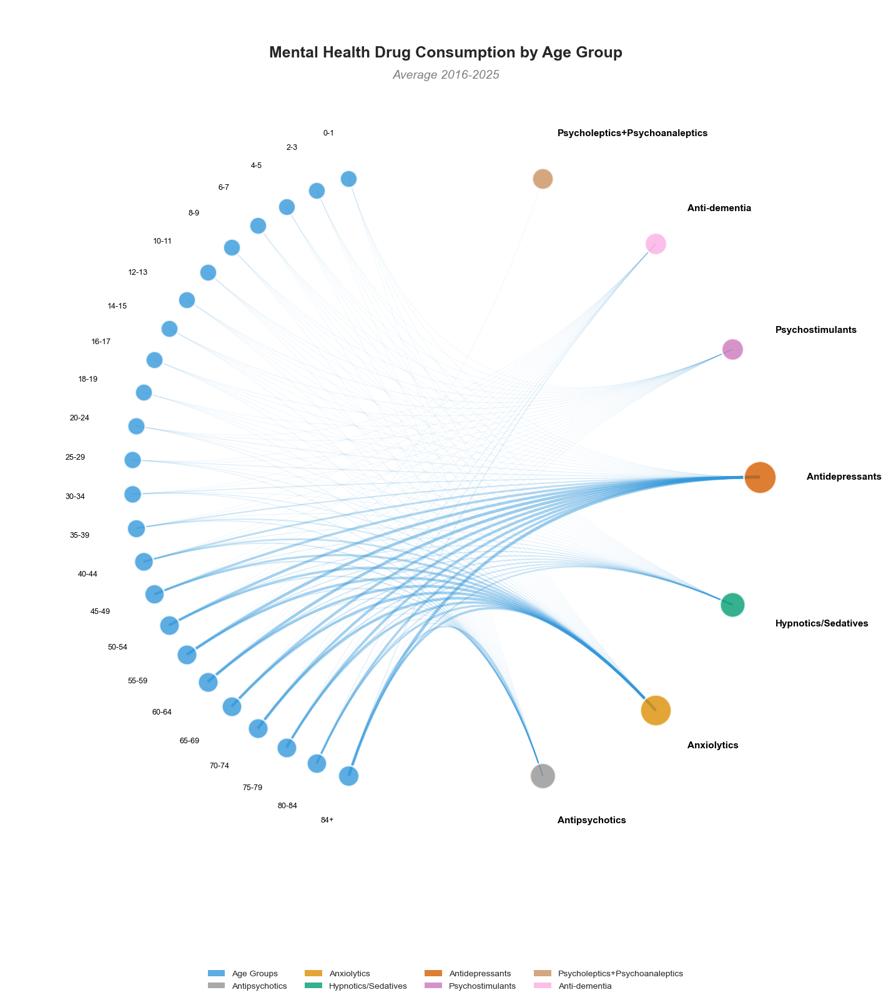


✓ Chord diagram saved as 'chord_diagram_age_drugs.png'


In [8]:
# Create chord diagram using matplotlib with custom circular layout
from matplotlib.path import Path

# Prepare connection data
links = chord_data[['age_group', 'drug_name', 'prescriptions']].copy()
links.columns = ['source', 'target', 'value']
links['source'] = links['source'].astype(str)
links['target'] = links['target'].astype(str)

# Get unique nodes
age_groups_unique = [str(ag) for ag in chord_data['age_group'].unique()]
drugs_unique = chord_data['drug_name'].unique().tolist()
all_nodes = age_groups_unique + drugs_unique

n_nodes = len(all_nodes)
print(f"Total nodes: {n_nodes} ({len(age_groups_unique)} age groups + {len(drugs_unique)} drugs)")

# Create connection dictionary
connections = {}
for _, row in links.iterrows():
    key = (row['source'], row['target'])
    connections[key] = row['value']

# Calculate node sizes based on total flow
node_totals = {}
for node in all_nodes:
    total = 0
    for (src, tgt), val in connections.items():
        if src == node or tgt == node:
            total += val
    node_totals[node] = total

# Normalize for visualization
max_total = max(node_totals.values())
node_sizes = {node: (total / max_total) for node, total in node_totals.items()}

print(f"\nTop 5 nodes by total prescriptions:")
for node, total in sorted(node_totals.items(), key=lambda x: x[1], reverse=True)[:5]:
    print(f"  {node}: {total:,.0f}")

# Create figure
fig, ax = plt.subplots(figsize=(16, 16))
ax.set_aspect('equal')
ax.axis('off')

# Calculate positions on circle
radius = 10

# Position nodes: age groups on left half, drugs on right half
node_positions = {}
age_angles = np.linspace(np.pi * 0.6, np.pi * 1.4, len(age_groups_unique))
drug_angles = np.linspace(-np.pi * 0.4, np.pi * 0.4, len(drugs_unique))

for i, age in enumerate(age_groups_unique):
    angle = age_angles[i]
    node_positions[age] = (radius * np.cos(angle), radius * np.sin(angle), angle)

for i, drug in enumerate(drugs_unique):
    angle = drug_angles[i]
    node_positions[drug] = (radius * np.cos(angle), radius * np.sin(angle), angle)

# Color mapping
age_color = '#3498db'  # Blue for ages
cb_palette = sns.color_palette("colorblind", n_colors=8)
drug_colors = {
    'Antipsychotics': cb_palette[7],
    'Anxiolytics': cb_palette[1],
    'Hypnotics/Sedatives': cb_palette[2],
    'Antidepressants': cb_palette[3],
    'Psychostimulants': cb_palette[4],
    'Psycholeptics+Psychoanaleptics': cb_palette[5],
    'Anti-dementia': cb_palette[6]
}

# Draw connections (chords)
max_connection = max(connections.values())
for (src, tgt), value in connections.items():
    if src in node_positions and tgt in node_positions:
        x1, y1, angle1 = node_positions[src]
        x2, y2, angle2 = node_positions[tgt]
        
        # Control point for bezier curve (towards center)
        cx, cy = 0, 0
        
        # Create curved path
        verts = [
            (x1, y1),
            (cx, cy),
            (x2, y2)
        ]
        codes = [Path.MOVETO, Path.CURVE3, Path.CURVE3]
        path = Path(verts, codes)
        
        # Color based on source (age group)
        color = age_color if src in age_groups_unique else drug_colors.get(src, '#95a5a6')
        alpha = 0.1 + 0.4 * (value / max_connection)
        linewidth = 0.5 + 3 * (value / max_connection)
        
        patch = mpatches.PathPatch(path, facecolor='none', edgecolor=color, 
                                   alpha=alpha, linewidth=linewidth)
        ax.add_patch(patch)

# Draw nodes
for node, (x, y, angle) in node_positions.items():
    if node in age_groups_unique:
        color = age_color
        size = 400 + 600 * node_sizes[node]
    else:
        color = drug_colors.get(node, '#95a5a6')
        size = 600 + 800 * node_sizes[node]
    
    ax.scatter(x, y, s=size, color=color, alpha=0.8, edgecolors='white', linewidths=2, zorder=10)
    
    # Add labels
    label_radius = radius + 1.5
    label_x = label_radius * np.cos(angle)
    label_y = label_radius * np.sin(angle)
    
    ha = 'right' if x < 0 else 'left'
    va = 'center'
    fontsize = 9 if node in age_groups_unique else 11
    fontweight = 'normal' if node in age_groups_unique else 'bold'
    
    ax.text(label_x, label_y, node, ha=ha, va=va, fontsize=fontsize, 
            fontweight=fontweight, color='black')

# Add title
ax.text(0, radius + 3.5, 'Mental Health Drug Consumption by Age Group', 
        ha='center', va='center', fontsize=18, fontweight='bold')
ax.text(0, radius + 2.8, 'Average 2016-2025', 
        ha='center', va='center', fontsize=14, style='italic', color='gray')

# Add legend (horizontal, closer to diagram)
legend_elements = [mpatches.Patch(facecolor=age_color, label='Age Groups', alpha=0.8)]
for drug, color in drug_colors.items():
    legend_elements.append(mpatches.Patch(facecolor=color, label=drug, alpha=0.8))

ax.legend(handles=legend_elements, loc='upper center', bbox_to_anchor=(0.5, -0.05), 
         fontsize=10, framealpha=0.9, ncol=4)

ax.set_xlim(-14, 14)
ax.set_ylim(-14, 15)

plt.tight_layout()
#plt.savefig('chord_diagram_age_drugs.png', dpi=300, bbox_inches='tight')
plt.show()

print("\n✓ Chord diagram saved as 'chord_diagram_age_drugs.png'")

## 1. Mean Fraction Paid by Government by ATC Levels

In [9]:
# Load the cleaned data
df = pd.read_csv(r"cleaned_economic_data.csv")

# Ensure numeric columns are properly typed
numeric_cols = ['any', 'mes', 'codi de la regió sanitària', 'nombre de receptes', 
                "nombre d'envasos", 'import íntegre', 'import aportació CatSalut', 'fracció_govern']

for col in numeric_cols:
    if col in df.columns:
        df[col] = pd.to_numeric(df[col], errors='coerce')

# Remove any rows that failed conversion
df = df.dropna(subset=numeric_cols)

# Translate Catalan sex labels to English
df['sexe'] = df['sexe'].replace({'Dona': 'Women', 'Home': 'Men'})

# Translate Spanish ATC Level 1 labels to English
atc1_translations = {
    'TRACTO ALIMENTARIO Y METABOLISMO': 'ALIMENTARY TRACT AND METABOLISM',
    'SANGRE Y ORGANOS HEMATOPOYETICOS': 'BLOOD AND BLOOD FORMING ORGANS',
    'SISTEMA CARDIOVASCULAR': 'CARDIOVASCULAR SYSTEM',
    'DERMATOLOGICOS': 'DERMATOLOGICALS',
    'SISTEMA GENITOURINARIO Y HORMONAS SEXUALES': 'GENITO-URINARY SYSTEM AND SEX HORMONES',
    'PREPARADOS HORMONALES SISTEMICOS, EXCLUYENDO HORMONAS SEXUALES E INSULINAS': 'SYSTEMIC HORMONAL PREPARATIONS, EXCL. SEX HORMONES AND INSULINS',
    'ANTIINFECCIOSOS PARA USO SISTEMICO': 'ANTIINFECTIVES FOR SYSTEMIC USE',
    'AGENTES ANTINEOPLASICOS E INMUNOMODULADORES': 'ANTINEOPLASTIC AND IMMUNOMODULATING AGENTS',
    'SISTEMA MUSCULOESQUELETICO': 'MUSCULO-SKELETAL SYSTEM',
    'SISTEMA NERVIOSO': 'NERVOUS SYSTEM',
    'PRODUCTOS ANTIPARASITARIOS, INSECTICIDAS Y REPELENTES': 'ANTIPARASITIC PRODUCTS, INSECTICIDES AND REPELLENTS',
    'SISTEMA RESPIRATORIO': 'RESPIRATORY SYSTEM',
    'ORGANOS DE LOS SENTIDOS': 'SENSORY ORGANS' 
}
df['grup ATC nivell 1'] = df['grup ATC nivell 1'].replace(atc1_translations)

# Translate common Spanish terms in ATC Level 2, 3, and 4 (comprehensive dictionary)
atc2_translations = {
    # A - ALIMENTARY TRACT AND METABOLISM
    'PREPARADOS ESTOMATOLOGICOS': 'STOMATOLOGICAL PREPARATIONS',
    'AGENTES PARA EL TRATAMIENTO DE ALTERACIONES CAUSADAS POR ACIDOS': 'DRUGS FOR ACID RELATED DISORDERS',
    'AGENTES CONTRA LA ULCERA PEPTICA Y EL REFLUJO GASTROESOFAGICO (RGE/GORD)': 'DRUGS FOR PEPTIC ULCER AND GASTRO-OESOPHAGEAL REFLUX DISEASE (GORD)',
    'Inhibidores de la bomba de protones': 'PROTON PUMP INHIBITORS',
    'AGENTES CONTRA PADECIMIENTOS FUNCIONALES DEL ESTOMAGO E INTESTINO': 'DRUGS FOR FUNCTIONAL GASTROINTESTINAL DISORDERS',
    'FARMACOS PARA DESORDENES FUNCIONALES GASTROINTESTINALES': 'DRUGS FOR FUNCTIONAL GASTROINTESTINAL DISORDERS',
    'ANTIEMETICOS Y FARMACOS PARA LAS NAUSEAS': 'ANTIEMETICS AND ANTINAUSEANTS',
    'ANTIEMETICOS Y ANTINAUSEANTES': 'ANTIEMETICS AND ANTINAUSEANTS',
    'TERAPIA DE LA BILIS Y EL HIGADO': 'BILE AND LIVER THERAPY',
    'BILIS Y TERAPIA DEL HIGADO': 'BILE AND LIVER THERAPY',
    'FARMACOS PARA EL ESTREÑIMIENTO': 'DRUGS FOR CONSTIPATION',
    'LAXANTES': 'LAXATIVES',
    'ANTIDIARREICOS, AGENTES ANTIINFLAMATORIOS/ANTIINFECCIOSOS INTESTINALES': 'ANTIDIARRHEALS, INTESTINAL ANTIINFLAMMATORY/ANTIINFECTIVE AGENTS',
    'PREPARADOS ANTIOBESIDAD, EXCL. PRODUCTOS DIETETICOS': 'ANTIOBESITY PREPARATIONS, EXCL. DIET PRODUCTS',
    'PREPARACIONES PARA LA OBESIDAD, EXCLUYENDO PRODUCTOS DIETETICOS': 'ANTIOBESITY PREPARATIONS, EXCL. DIET PRODUCTS',
    'DIGESTIVOS, INCL. ENZIMAS': 'DIGESTIVES, INCL. ENZYMES',
    'DIGESTIVOS, INCLUYENDO ENZIMAS': 'DIGESTIVES, INCL. ENZYMES',
    'FARMACOS USADOS EN DIABETES': 'DRUGS USED IN DIABETES',
    'VITAMINAS': 'VITAMINS',
    'SUPLEMENTOS MINERALES': 'MINERAL SUPPLEMENTS',
    'TONICOS': 'TONICS',
    'AGENTES ANABOLICOS PARA USO SISTEMICO': 'ANABOLIC AGENTS FOR SYSTEMIC USE',
    'ESTIMULANTES DEL APETITO': 'APPETITE STIMULANTS',
    'OTROS PRODUCTOS PARA EL TRACTO ALIMENTARIO Y METABOLISMO': 'OTHER ALIMENTARY TRACT AND METABOLISM PRODUCTS',
    'Antiinfecciosos y antisepticos para el tratamiento oral-local': 'ANTIINFECTIVES AND ANTISEPTICS FOR LOCAL ORAL TREATMENT',
    
    # B - BLOOD AND BLOOD FORMING ORGANS
    'AGENTES ANTITROMBÓTICOS': 'ANTITHROMBOTIC AGENTS',
    'AGENTES ANTITROMBOTICOS': 'ANTITHROMBOTIC AGENTS',
    'ANTIHEMORRAGICOS': 'ANTIHEMORRHAGICS',
    'SUSTITUTOS DE LA SANGRE Y SOLUCIONES DE PERFUSIÓN': 'BLOOD SUBSTITUTES AND PERFUSION SOLUTIONS',
    'SUSTITUTOS DE LA SANGRE Y SOLUCIONES PARA PERFUSION': 'BLOOD SUBSTITUTES AND PERFUSION SOLUTIONS',
    'PREPARADOS ANTIANEMICOS': 'ANTIANEMIC PREPARATIONS',
    'OTROS AGENTES HEMATOLOGICOS': 'OTHER HEMATOLOGICAL AGENTS',
    
    # C - CARDIOVASCULAR SYSTEM
    'TERAPIA CARDIACA': 'CARDIAC THERAPY',
    'ANTIHIPERTENSIVOS': 'ANTIHYPERTENSIVES',
    'DIURÉTICOS': 'DIURETICS',
    'DIURETICOS': 'DIURETICS',
    'VASODILATADORES PERIFÉRICOS': 'PERIPHERAL VASODILATORS',
    'VASODILATADORES PERIFERICOS': 'PERIPHERAL VASODILATORS',
    'VASOPROTECTORES': 'VASOPROTECTIVES',
    'AGENTES BETA BLOQUEANTES': 'BETA BLOCKING AGENTS',
    'AGENTES BETA-BLOQUEANTES': 'BETA BLOCKING AGENTS',
    'BLOQUEADORES DE LOS CANALES DE CALCIO': 'CALCIUM CHANNEL BLOCKERS',
    'AGENTES QUE ACTÚAN SOBRE EL SISTEMA RENINA-ANGIOTENSINA': 'AGENTS ACTING ON THE RENIN-ANGIOTENSIN SYSTEM',
    'AGENTES QUE ACTUAN SOBRE EL SISTEMA RENINA-ANGIOTENSINA': 'AGENTS ACTING ON THE RENIN-ANGIOTENSIN SYSTEM',
    'AGENTES MODIFICADORES DE LÍPIDOS': 'LIPID MODIFYING AGENTS',
    'AGENTES MODIFICADORES DE LOS LIPIDOS': 'LIPID MODIFYING AGENTS',
    
    # D - DERMATOLOGICALS
    'ANTIFÚNGICOS PARA USO DERMATOLÓGICO': 'ANTIFUNGALS FOR DERMATOLOGICAL USE',
    'ANTIFUNGICOS PARA USO DERMATOLOGICO': 'ANTIFUNGALS FOR DERMATOLOGICAL USE',
    'EMOLIENTES Y PROTECTORES': 'EMOLLIENTS AND PROTECTIVES',
    'PREPARADOS PARA EL TRATAMIENTO DE HERIDAS Y ULCERAS': 'PREPARATIONS FOR TREATMENT OF WOUNDS AND ULCERS',
    'ANTIPRURITICOS, INCL. ANTIHISTAMINICOS, ANESTESICOS, ETC.': 'ANTIPRURITICS, INCL. ANTIHISTAMINES, ANESTHETICS, ETC.',
    'PREPARADOS ANTIPSORIASTICOS': 'ANTIPSORIATICS',
    'PREPARADOS ANTIPSORIÁSICOS': 'ANTIPSORIATICS',
    'ANTIBIÓTICOS Y QUIMIOTERÁPICOS PARA USO DERMATOLÓGICO': 'ANTIBIOTICS AND CHEMOTHERAPEUTICS FOR DERMATOLOGICAL USE',
    'ANTIBIOTICOS Y QUIMIOTERAPICOS PARA USO DERMATOLOGICO': 'ANTIBIOTICS AND CHEMOTHERAPEUTICS FOR DERMATOLOGICAL USE',
    'CORTICOSTEROIDES, DERMATOLÓGICOS': 'CORTICOSTEROIDS, DERMATOLOGICAL PREPARATIONS',
    'PREPARADOS DERMATOLOGICOS CON CORTICOSTEROIDES': 'CORTICOSTEROIDS, DERMATOLOGICAL PREPARATIONS',
    'ANTISEPTICOS Y DESINFECTANTES': 'ANTISEPTICS AND DISINFECTANTS',
    'APOSITOS MEDICADOS': 'MEDICATED DRESSINGS',
    'PREPARADOS ANTIACNÉ': 'ANTI-ACNE PREPARATIONS',
    'PREPARADOS ANTI-ACNE': 'ANTI-ACNE PREPARATIONS',
    'OTROS PREPARADOS DERMATOLOGICOS': 'OTHER DERMATOLOGICAL PREPARATIONS',
    
    # G - GENITO URINARY SYSTEM AND SEX HORMONES
    'ANTIINFECCIOSOS Y ANTISÉPTICOS GINECOLÓGICOS': 'GYNECOLOGICAL ANTIINFECTIVES AND ANTISEPTICS',
    'ANTIINFECCIOSOS Y ANTISEPTICOS GINECOLOGICOS': 'GYNECOLOGICAL ANTIINFECTIVES AND ANTISEPTICS',
    'OTROS GINECOLOGICOS': 'OTHER GYNECOLOGICALS',
    'HORMONAS SEXUALES Y MODULADORES DEL SISTEMA GENITAL': 'SEX HORMONES AND MODULATORS OF THE GENITAL SYSTEM',
    'UROLÓGICOS': 'UROLOGICALS',
    'UROLOGICOS': 'UROLOGICALS',
    
    # H - SYSTEMIC HORMONAL PREPARATIONS, EXCL. SEX HORMONES AND INSULINS
    'HORMONAS PITUITARIAS E HIPOTALÁMICAS Y ANÁLOGOS': 'PITUITARY AND HYPOTHALAMIC HORMONES AND ANALOGUES',
    'HORMONAS PITUITARIAS E HIPOTALAMICAS Y ANALOGOS': 'PITUITARY AND HYPOTHALAMIC HORMONES AND ANALOGUES',
    'CORTICOSTEROIDES PARA USO SISTÉMICO': 'CORTICOSTEROIDS FOR SYSTEMIC USE',
    'CORTICOSTEROIDES PARA USO SISTEMICO': 'CORTICOSTEROIDS FOR SYSTEMIC USE',
    'TERAPIA TIROIDEA': 'THYROID THERAPY',
    'HORMONAS PANCREATICAS': 'PANCREATIC HORMONES',
    'HOMEOSTASIS DEL CALCIO': 'CALCIUM HOMEOSTASIS',
    
    # J - ANTIINFECTIVES FOR SYSTEMIC USE
    'ANTIBACTERIANOS PARA USO SISTÉMICO': 'ANTIBACTERIALS FOR SYSTEMIC USE',
    'ANTIBACTERIANOS PARA USO SISTEMICO': 'ANTIBACTERIALS FOR SYSTEMIC USE',
    'ANTIMICÓTICOS PARA USO SISTÉMICO': 'ANTIMYCOTICS FOR SYSTEMIC USE',
    'ANTIMICOTICOS PARA USO SISTEMICO': 'ANTIMYCOTICS FOR SYSTEMIC USE',
    'ANTIMICOBACTERIANOS': 'ANTIMYCOBACTERIALS',
    'ANTIVIRALES PARA USO SISTÉMICO': 'ANTIVIRALS FOR SYSTEMIC USE',
    'ANTIVIRALES PARA USO SISTEMICO': 'ANTIVIRALS FOR SYSTEMIC USE',
    'SUEROS INMUNES E INMUNOGLOBULINAS': 'IMMUNE SERA AND IMMUNOGLOBULINS',
    'VACUNAS': 'VACCINES',
    
    # L - ANTINEOPLASTIC AND IMMUNOMODULATING AGENTS
    'AGENTES ANTINEOPLÁSICOS': 'ANTINEOPLASTIC AGENTS',
    'AGENTES ANTINEOPLASICOS': 'ANTINEOPLASTIC AGENTS',
    'TERAPIA ENDOCRINA': 'ENDOCRINE THERAPY',
    'INMUNOESTIMULANTES': 'IMMUNOSTIMULANTS',
    'INMUNOSUPRESORES': 'IMMUNOSUPPRESSANTS',
    
    # M - MUSCULO-SKELETAL SYSTEM
    'PRODUCTOS ANTIINFLAMATORIOS Y ANTIRREUMÁTICOS': 'ANTIINFLAMMATORY AND ANTIRHEUMATIC PRODUCTS',
    'PRODUCTOS ANTIINFLAMATORIOS Y ANTIRREUMATICOS': 'ANTIINFLAMMATORY AND ANTIRHEUMATIC PRODUCTS',
    'PRODUCTOS TOPICOS PARA EL DOLOR ARTICULAR Y MUSCULAR': 'TOPICAL PRODUCTS FOR JOINT AND MUSCULAR PAIN',
    'RELAJANTES MUSCULARES': 'MUSCLE RELAXANTS',
    'AGENTES ANTIGOTOSOS': 'ANTIGOUT PREPARATIONS',
    'PREPARADOS ANTIGOTOSOS': 'ANTIGOUT PREPARATIONS',
    'FARMACOS PARA EL TRATAMIENTO DE ENFERMEDADES ÓSEAS': 'DRUGS FOR TREATMENT OF BONE DISEASES',
    'FARMACOS PARA EL TRATAMIENTO DE ENFERMEDADES OSEAS': 'DRUGS FOR TREATMENT OF BONE DISEASES',
    'OTROS FARMACOS PARA TRASTORNOS DEL SISTEMA MUSCULOESQUELETICO': 'OTHER DRUGS FOR DISORDERS OF THE MUSCULO-SKELETAL SYSTEM',
    
    # N - NERVOUS SYSTEM
    'ANESTESICOS': 'ANESTHETICS',
    'ANALGÉSICOS': 'ANALGESICS',
    'ANALGESICOS': 'ANALGESICS',
    'ANTIEPILÉPTICOS': 'ANTIEPILEPTICS',
    'ANTIEPILEPTICOS': 'ANTIEPILEPTICS',
    'ANTIPARKINSONIANOS': 'ANTI-PARKINSON',
    'FARMACOS ANTIPARKINSONIANOS': 'ANTI-PARKINSON',
    'PSICOLÉPTICOS': 'PSYCHOLEPTICS',
    'PSICOLEPTICOS': 'PSYCHOLEPTICS',
    'PSICOANALÉPTICOS': 'PSYCHOANALEPTICS',
    'PSICOANALEPTICOS': 'PSYCHOANALEPTICS',
    'OTROS FÁRMACOS DEL SISTEMA NERVIOSO': 'OTHERS',
    'OTROS FARMACOS QUE ACTUAN SOBRE EL SISTEMA NERVIOSO': 'OTHERS',
    'OTROS FARMACOS DEL SISTEMA NERVIOSO': 'OTHERS',
    'ANTIPSICÓTICOS': 'ANTIPSYCHOTICS',
    'ANTIPSICÓTICOS': 'ANTIPSYCHOTICS',
    'ANSIOLÍTICOS': 'ANXIOLYTICS',
    'ANSIOLITICOS': 'ANXIOLYTICS',
    'HIPNÓTICOS Y SEDANTES': 'HYPNOTICS AND SEDATIVES',
    'HIPNOTICOS Y SEDANTES': 'HYPNOTICS AND SEDANTES',
    'ANTIDEPRESIVOS': 'ANTIDEPRESSANTS',
    'PSICOESTIMULANTES, AGENTES UTILIZADOS EN TDAH Y NOOTRÓPICOS': 'PSYCHOSTIMULANTS, AGENTS USED FOR ADHD AND NOOTROPICS',
    'AGENTES ANTI-DEMENCIA': 'ANTI-DEMENTIA DRUGS',
    
    # P - ANTIPARASITIC PRODUCTS, INSECTICIDES AND REPELLENTS
    'ANTIPROTOZOARIOS': 'ANTIPROTOZOALS',
    'ANTIHELMÍNTICOS': 'ANTHELMINTICS',
    'ANTIHELMINTICOS': 'ANTHELMINTICS',
    'ECTOPARASITICIDAS, INCL. ESCABICIDAS, INSECTICIDAS Y REPELENTES': 'ECTOPARASITICIDES, INCL. SCABICIDES, INSECTICIDES AND REPELLENTS',
    'ECTOPARASITICIDAS, INCLUYENDO ESCABICIDAS, INSECTICIDAS Y REPELENTES': 'ECTOPARASITICIDES, INCL. SCABICIDES, INSECTICIDES AND REPELLENTS',
    
    # R - RESPIRATORY SYSTEM
    'PREPARADOS NASALES': 'NASAL PREPARATIONS',
    'PREPARADOS DE USO NASAL': 'NASAL PREPARATIONS',
    'PREPARADOS PARA LA GARGANTA': 'THROAT PREPARATIONS',
    'FARMACOS PARA ENFERMEDADES OBSTRUCTIVAS DE LAS VÍAS RESPIRATORIAS': 'DRUGS FOR OBSTRUCTIVE AIRWAY DISEASES',
    'AGENTES CONTRA PADECIMIENTOS OBSTRUCTIVOS DE LAS VIAS RESPIRATORIAS': 'DRUGS FOR OBSTRUCTIVE AIRWAY DISEASES',
    'FARMACOS PARA ENFERMEDADES OBSTRUCTIVAS DE LAS VIAS RESPIRATORIAS': 'DRUGS FOR OBSTRUCTIVE AIRWAY DISEASES',
    'PREPARADOS PARA LA TOS Y EL RESFRIADO': 'COUGH AND COLD PREPARATIONS',
    'ANTIHISTAMÍNICOS PARA USO SISTÉMICO': 'ANTIHISTAMINES FOR SYSTEMIC USE',
    'ANTIHISTAMINICOS PARA USO SISTEMICO': 'ANTIHISTAMINES FOR SYSTEMIC USE',
    'OTROS PRODUCTOS DEL SISTEMA RESPIRATORIO': 'OTHER RESPIRATORY SYSTEM PRODUCTS',
    
    # S - SENSORY ORGANS
    'OFTALMOLÓGICOS': 'OPHTHALMOLOGICALS',
    'OFTALMOLOGICOS': 'OPHTHALMOLOGICALS',
    'OTOLÓGICOS': 'OTOLOGICALS',
    'OTOLOGICOS': 'OTOLOGICALS',
    'PREPARADOS OFTALMOLOGICOS Y OTOLOGICOS': 'OPHTHALMOLOGICAL AND OTOLOGICAL PREPARATIONS',
}
df['grup ATC nivell 2'] = df['grup ATC nivell 2'].replace(atc2_translations)

print(f"Dataset loaded: {df.shape}")
print(f"\nColumns: {df.columns.tolist()}")
print(f"\nData types:")
print(df.dtypes)
print(f"\nFirst few rows:")
df.head()

Dataset loaded: (7536094, 19)

Columns: ['any', 'mes', 'codi de la regió sanitària', 'regió sanitària', "grup d'edat", 'sexe', 'codi del grup ATC nivell 1', 'grup ATC nivell 1', 'codi del grup ATC nivell 2', 'grup ATC nivell 2', 'codi del grup ATC nivell 3', 'grup ATC nivell 3', 'codi del grup ATC nivell 4', 'grup ATC nivell 4', 'nombre de receptes', "nombre d'envasos", 'import íntegre', 'import aportació CatSalut', 'fracció_govern']

Data types:
any                             int64
mes                             int64
codi de la regió sanitària      int64
regió sanitària                object
grup d'edat                    object
sexe                           object
codi del grup ATC nivell 1     object
grup ATC nivell 1              object
codi del grup ATC nivell 2     object
grup ATC nivell 2              object
codi del grup ATC nivell 3     object
grup ATC nivell 3              object
codi del grup ATC nivell 4     object
grup ATC nivell 4              object
nombre de recepte

,any,mes,codi de la regió sanitària,regió sanitària,grup d'edat,sexe,codi del grup ATC nivell 1,grup ATC nivell 1,codi del grup ATC nivell 2,grup ATC nivell 2,codi del grup ATC nivell 3,grup ATC nivell 3,codi del grup ATC nivell 4,grup ATC nivell 4,nombre de receptes,nombre d'envasos,import íntegre,import aportació CatSalut,fracció_govern
0,2025,9,61,LLEIDA,0-1,Women,A,ALIMENTARY TRACT AND METABOLISM,A01,STOMATOLOGICAL PREPARATIONS,A01A,PREPARADOS ESTOMATOLOGICOS,A01AB,Antiinfecciosos y antisepticos para el tratami...,3,3,8.49,7.36,0.866902
1,2025,9,61,LLEIDA,0-1,Women,A,ALIMENTARY TRACT AND METABOLISM,A02,DRUGS FOR ACID RELATED DISORDERS,A02B,AGENTES CONTRA LA ULCERA PEPTICA Y EL REFLUJO ...,A02BC,Inhibidores de la bomba de protones,1,1,17.75,10.65,0.600000
2,2025,9,61,LLEIDA,0-1,Women,A,ALIMENTARY TRACT AND METABOLISM,A07,"ANTIDIARRHEALS, INTESTINAL ANTIINFLAMMATORY/AN...",A07A,ANTIINFECCIOSOS INTESTINALES,A07AA,Antibioticos,17,17,79.56,53.84,0.676722
3,2025,9,61,LLEIDA,0-1,Women,A,ALIMENTARY TRACT AND METABOLISM,A07,"ANTIDIARRHEALS, INTESTINAL ANTIINFLAMMATORY/AN...",A07C,ELECTROLITOS CON CARBOHIDRATOS,A07CA,Formulaciones de sales de rehidratacion oral,27,27,95.62,56.26,0.588371
4,2025,9,61,LLEIDA,0-1,Women,A,ALIMENTARY TRACT AND METABOLISM,A11,VITAMINS,A11C,"VITAMINAS A Y D, INCLUYENDO COMBINACIONES DE L...",A11CC,Vitamina D y analogos,307,307,1708.00,1036.48,0.606838


Mean Fraction Paid by Government - ATC Level 1:
                                                    Mean Fraction Gov    Total Cost  Total Gov Payment  Percentage
grup ATC nivell 1                                                                                                 
ANTINEOPLASTIC AND IMMUNOMODULATING AGENTS                   0.953754  9.423170e+08       9.144324e+08   95.375368
NERVOUS SYSTEM                                               0.874671  4.602316e+09       4.261278e+09   87.467080
CARDIOVASCULAR SYSTEM                                        0.873858  2.580588e+09       2.283014e+09   87.385834
SYSTEMIC HORMONAL PREPARATIONS, EXCL. SEX HORMO...           0.873392  3.735436e+08       3.461475e+08   87.339246
BLOOD AND BLOOD FORMING ORGANS                               0.839768  1.385317e+09       1.300033e+09   83.976773
ALIMENTARY TRACT AND METABOLISM                              0.835191  3.127342e+09       2.892654e+09   83.519103
RESPIRATORY SYSTEM              

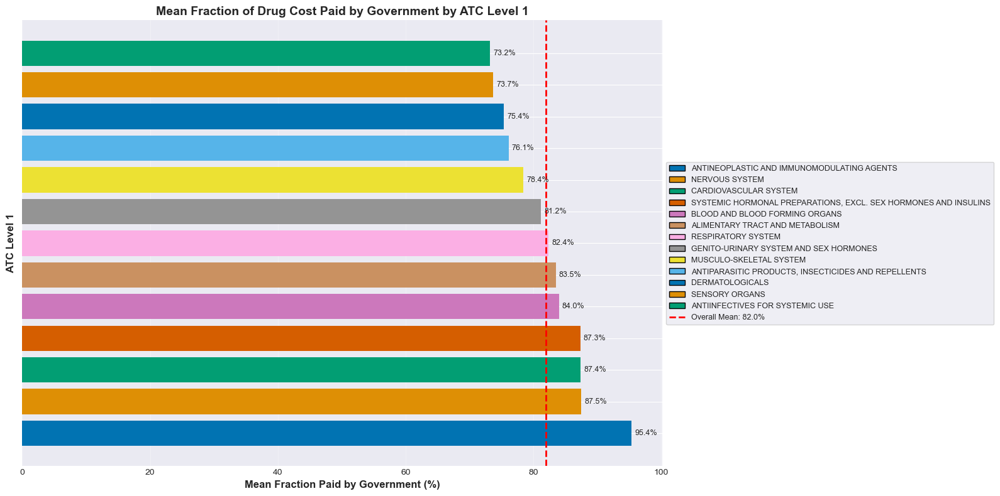

In [10]:
# Calculate mean fraction paid by government for ATC Level 1
atc1_fraction = df.groupby('grup ATC nivell 1').agg({
    'fracció_govern': 'mean',
    'import íntegre': 'sum',
    'import aportació CatSalut': 'sum'
}).sort_values('fracció_govern', ascending=False)

atc1_fraction.columns = ['Mean Fraction Gov', 'Total Cost', 'Total Gov Payment']
atc1_fraction['Percentage'] = atc1_fraction['Mean Fraction Gov'] * 100

print("Mean Fraction Paid by Government - ATC Level 1:")
print(atc1_fraction)

# Plot
fig, ax = plt.subplots(figsize=(16, 8))
# Use colorblind-friendly palette
colors = sns.color_palette("colorblind", n_colors=len(atc1_fraction))
bars = ax.barh(range(len(atc1_fraction)), atc1_fraction['Percentage'], color=colors)
ax.set_xlabel('Mean Fraction Paid by Government (%)', fontsize=12, fontweight='bold')
ax.set_ylabel('ATC Level 1', fontsize=12, fontweight='bold')
ax.set_title('Mean Fraction of Drug Cost Paid by Government by ATC Level 1', fontsize=14, fontweight='bold')
ax.axvline(x=atc1_fraction['Percentage'].mean(), color='red', linestyle='--', linewidth=2, label=f'Overall Mean: {atc1_fraction["Percentage"].mean():.1f}%')
ax.set_yticks(range(len(atc1_fraction)))
ax.set_yticklabels([])  # Remove y-axis labels
ax.grid(axis='x', alpha=0.3)

# Add percentage labels
for i, (idx, row) in enumerate(atc1_fraction.iterrows()):
    ax.text(row['Percentage'] + 0.5, i, f"{row['Percentage']:.1f}%", va='center', fontsize=9)

# Create legend with drug names
from matplotlib.lines import Line2D
from matplotlib.patches import Patch

legend_elements = []
for i, idx in enumerate(atc1_fraction.index):
    legend_elements.append(Patch(facecolor=colors[i], edgecolor='k', label=idx))
# Add mean reference line to legend
legend_elements.append(Line2D([0], [0], color='red', linestyle='--', linewidth=2, label=f'Overall Mean: {atc1_fraction["Percentage"].mean():.1f}%'))
ax.legend(handles=legend_elements, loc='center left', bbox_to_anchor=(1, 0.5), fontsize=9, frameon=True)

plt.tight_layout()
plt.show()


Mean Fraction Paid by Government - Top 30 ATC Level 2 (by total cost):
                                                    Mean Fraction Gov    Total Cost  Total Gov Payment  Percentage
grup ATC nivell 2                                                                                                 
HORMONAS HIPOFISARIAS E HIPOTALAMICAS Y SUS ANA...           0.962294  1.263993e+08       1.247278e+08   96.229372
IMMUNOSUPPRESSANTS                                           0.958615  4.956821e+08       4.798375e+08   95.861514
ANTI-PARKINSON                                               0.958388  2.714858e+08       2.628871e+08   95.838845
ENDOCRINE THERAPY                                            0.956362  4.057911e+08       3.950299e+08   95.636240
ANTIEPILEPTICS                                               0.944187  7.067409e+08       6.751236e+08   94.418673
DRUGS USED IN DIABETES                                       0.939609  2.196283e+09       2.089179e+09   93.960857
CALCIUM 

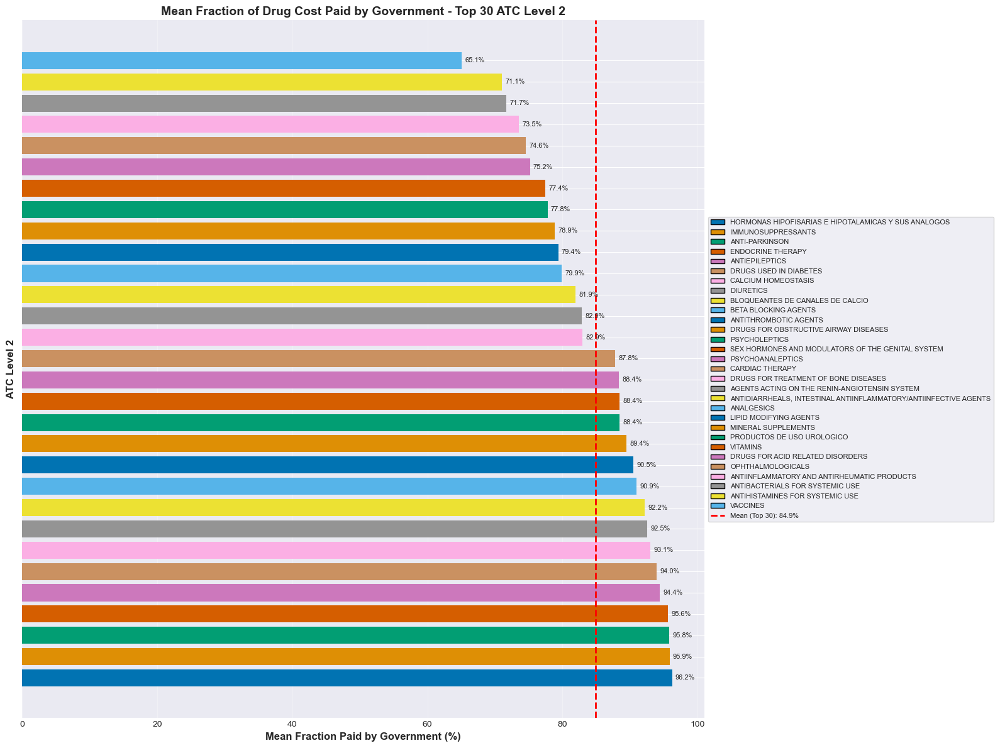

In [11]:
# Calculate mean fraction paid by government for ATC Level 2 (top 30)
atc2_fraction = df.groupby('grup ATC nivell 2').agg({
    'fracció_govern': 'mean',
    'import íntegre': 'sum',
    'import aportació CatSalut': 'sum'
}).sort_values('import íntegre', ascending=False).head(30)

atc2_fraction = atc2_fraction.sort_values('fracció_govern', ascending=False)
atc2_fraction.columns = ['Mean Fraction Gov', 'Total Cost', 'Total Gov Payment']
atc2_fraction['Percentage'] = atc2_fraction['Mean Fraction Gov'] * 100

print("\nMean Fraction Paid by Government - Top 30 ATC Level 2 (by total cost):")
print(atc2_fraction)

# Plot
fig, ax = plt.subplots(figsize=(16, 12))
# Use colorblind-friendly palette
colors = sns.color_palette("colorblind", n_colors=10)  # Base palette
extended_colors = (colors * 3)[:len(atc2_fraction)]  # Extend for 30 items
bars = ax.barh(range(len(atc2_fraction)), atc2_fraction['Percentage'], color=extended_colors)
ax.set_xlabel('Mean Fraction Paid by Government (%)', fontsize=12, fontweight='bold')
ax.set_ylabel('ATC Level 2', fontsize=12, fontweight='bold')
ax.set_title('Mean Fraction of Drug Cost Paid by Government - Top 30 ATC Level 2', fontsize=14, fontweight='bold')
ax.axvline(x=atc2_fraction['Percentage'].mean(), color='red', linestyle='--', linewidth=2, label=f'Mean (Top 30): {atc2_fraction["Percentage"].mean():.1f}%')
ax.set_yticks(range(len(atc2_fraction)))
ax.set_yticklabels([])  # Remove y-axis labels
ax.grid(axis='x', alpha=0.3)

# Add percentage labels
for i, (idx, row) in enumerate(atc2_fraction.iterrows()):
    ax.text(row['Percentage'] + 0.5, i, f"{row['Percentage']:.1f}%", va='center', fontsize=8)

# Create legend with drug names
legend_elements = [Patch(facecolor=extended_colors[i], edgecolor='k', label=idx) for i, idx in enumerate(atc2_fraction.index)]
legend_elements.append(plt.Line2D([0], [0], color='red', linestyle='--', linewidth=2, label=f'Mean (Top 30): {atc2_fraction["Percentage"].mean():.1f}%'))
ax.legend(handles=legend_elements, loc='center left', bbox_to_anchor=(1, 0.5), fontsize=8, frameon=True)

plt.tight_layout()
plt.show()


Mean Fraction Paid by Government - Bottom 30 ATC Level 2 (by total cost):
                                                    Mean Fraction Gov   Total Cost  Total Gov Payment  Percentage
grup ATC nivell 2                                                                                                
IMMUNOSTIMULANTS                                             0.979451    952578.23          935791.49   97.945126
PANCREATIC HORMONES                                          0.936843   7299918.89         6909777.71   93.684275
OTHER ALIMENTARY TRACT AND METABOLISM PRODUCTS               0.936467   1816071.24         1704999.37   93.646709
ANTIHEMORRHAGICS                                             0.925743   2721654.57         2515884.73   92.574290
IMMUNE SERA AND IMMUNOGLOBULINS                              0.894361   4332757.96         4000598.34   89.436148
VASOPROTECTIVES                                              0.887765  16410279.96        15399401.87   88.776542
DRUGS FOR CON

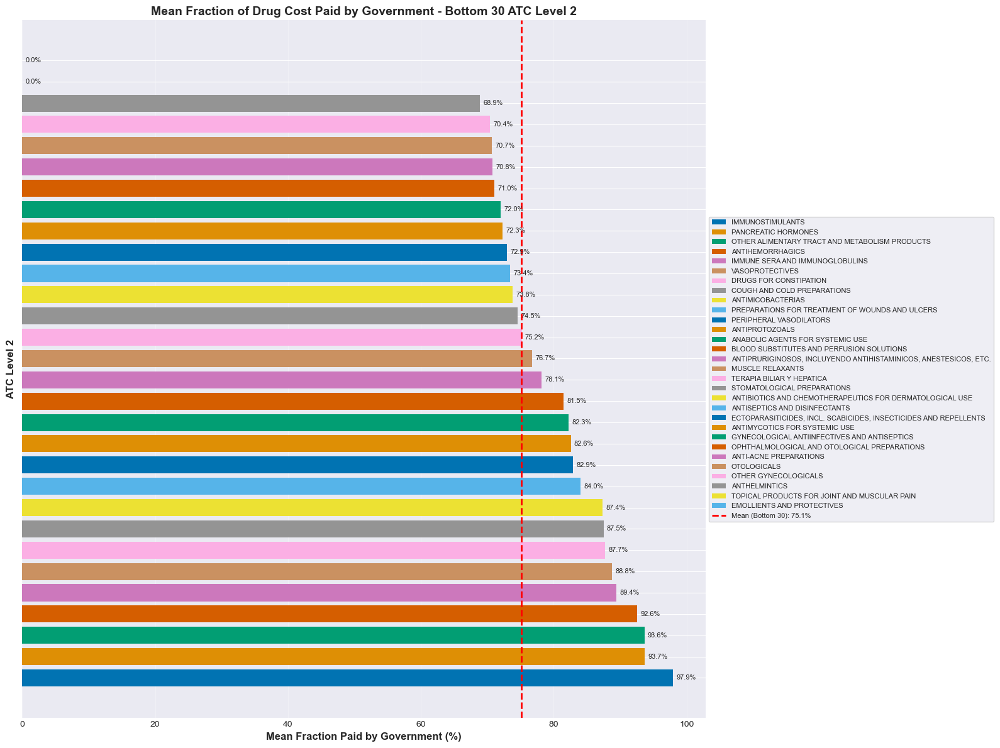

In [12]:
# Calculate mean fraction paid by government for ATC Level 2 (bottom 30)
atc2_fraction_bottom = df.groupby('grup ATC nivell 2').agg({
    'fracció_govern': 'mean',
    'import íntegre': 'sum',
    'import aportació CatSalut': 'sum'
}).sort_values('import íntegre', ascending=True).head(30)

atc2_fraction_bottom = atc2_fraction_bottom.sort_values('fracció_govern', ascending=False)
atc2_fraction_bottom.columns = ['Mean Fraction Gov', 'Total Cost', 'Total Gov Payment']
atc2_fraction_bottom['Percentage'] = atc2_fraction_bottom['Mean Fraction Gov'] * 100

print("\nMean Fraction Paid by Government - Bottom 30 ATC Level 2 (by total cost):")
print(atc2_fraction_bottom)

# Plot
fig, ax = plt.subplots(figsize=(16, 12))
# Use colorblind-friendly palette
colors = sns.color_palette("colorblind", n_colors=10)  # Base palette
extended_colors = (colors * 3)[:len(atc2_fraction_bottom)]  # Extend for 30 items
bars = ax.barh(range(len(atc2_fraction_bottom)), atc2_fraction_bottom['Percentage'], color=extended_colors)
ax.set_xlabel('Mean Fraction Paid by Government (%)', fontsize=12, fontweight='bold')
ax.set_ylabel('ATC Level 2', fontsize=12, fontweight='bold')
ax.set_title('Mean Fraction of Drug Cost Paid by Government - Bottom 30 ATC Level 2', fontsize=14, fontweight='bold')
ax.axvline(x=atc2_fraction_bottom['Percentage'].mean(), color='red', linestyle='--', linewidth=2, label=f'Mean (Bottom 30): {atc2_fraction_bottom["Percentage"].mean():.1f}%')
ax.set_yticks(range(len(atc2_fraction_bottom)))
ax.set_yticklabels([])  # Remove y-axis labels
ax.grid(axis='x', alpha=0.3)

# Add percentage labels
for i, (idx, row) in enumerate(atc2_fraction_bottom.iterrows()):
    ax.text(row['Percentage'] + 0.5, i, f"{row['Percentage']:.1f}%", va='center', fontsize=8)

# Create legend with drug names
legend_elements = [plt.Rectangle((0,0),1,1, fc=extended_colors[i], label=idx) for i, idx in enumerate(atc2_fraction_bottom.index)]
legend_elements.append(plt.Line2D([0], [0], color='red', linestyle='--', linewidth=2, label=f'Mean (Bottom 30): {atc2_fraction_bottom["Percentage"].mean():.1f}%'))
ax.legend(handles=legend_elements, loc='center left', bbox_to_anchor=(1, 0.5), fontsize=8, frameon=True)

plt.tight_layout()
plt.show()

### Interactive Plot: All ATC Level 2 Drugs

The plot below shows **all** ATC Level 2 drug categories (not just top/bottom 30). 

**How to interact:**
- **Zoom:** Click and drag to select an area
- **Pan:** Hold Shift and drag
- **Reset view:** Double-click anywhere on the plot
- **Hover:** Move your mouse over bars to see detailed information

In [13]:
# Interactive plot showing ALL ATC Level 2 categories
# Install plotly if needed
%pip install plotly -q

import plotly.graph_objects as go

# Calculate for ALL ATC Level 2 categories
atc2_all = df.groupby('grup ATC nivell 2').agg({
    'fracció_govern': 'mean',
    'import íntegre': 'sum',
    'import aportació CatSalut': 'sum'
}).reset_index()

atc2_all.columns = ['ATC Level 2', 'Mean Fraction Gov', 'Total Cost', 'Total Gov Payment']
atc2_all['Patient Payment'] = atc2_all['Total Cost'] - atc2_all['Total Gov Payment']
atc2_all['Percentage'] = atc2_all['Mean Fraction Gov'] * 100

# Sort by total cost
atc2_all = atc2_all.sort_values('Total Cost', ascending=True)

print(f"\nTotal number of ATC Level 2 categories: {len(atc2_all)}")

# Create interactive plotly bar chart
fig = go.Figure()

fig.add_trace(go.Bar(
    y=atc2_all['ATC Level 2'],
    x=atc2_all['Total Cost'] / 1_000_000,
    orientation='h',
    marker=dict(
        color=atc2_all['Total Cost'],
        colorscale='Viridis',
        colorbar=dict(title="Total Cost (€)"),
        showscale=True
    ),
    text=[f"{pct:.1f}%" for pct in atc2_all['Percentage']],
    textposition='auto',
    hovertemplate='<b>%{y}</b><br>' +
                  'Total Cost: €%{x:.2f}M<br>' +
                  'Gov Fraction: %{text}<br>' +
                  'Gov Payment: €%{customdata[0]:.2f}M<br>' +
                  'Patient Payment: €%{customdata[1]:.2f}M<br>' +
                  '<extra></extra>',
    customdata=np.column_stack((
        atc2_all['Total Gov Payment'] / 1_000_000,
        atc2_all['Patient Payment'] / 1_000_000
    ))
))

# Add mean reference line
mean_cost = atc2_all['Total Cost'].mean() / 1_000_000
fig.add_vline(x=mean_cost, line_dash="dash", line_color="red",
              annotation_text=f"Mean: €{mean_cost:.1f}M",
              annotation_position="top right")

fig.update_layout(
    title='Mean Fraction of Drug Cost Paid by Government - All ATC Level 2 Categories',
    xaxis_title='Total Cost (million €)',
    yaxis_title='ATC Level 2',
    height=max(800, len(atc2_all) * 15),  # Dynamic height based on number of categories
    showlegend=False,
    hovermode='closest',
    template='plotly_white'
)

fig.show()

Note: you may need to restart the kernel to use updated packages.

Total number of ATC Level 2 categories: 77


## 2. Total Amount Paid - Overall and by ATC Level 1

Total Expenditure by Sex (in millions €):
     Sex  Total Cost  Government Payment  Patient Payment
0    Men  8196.00961         7427.661357       768.348253
1  Women  8657.27656         7870.243496       787.033064


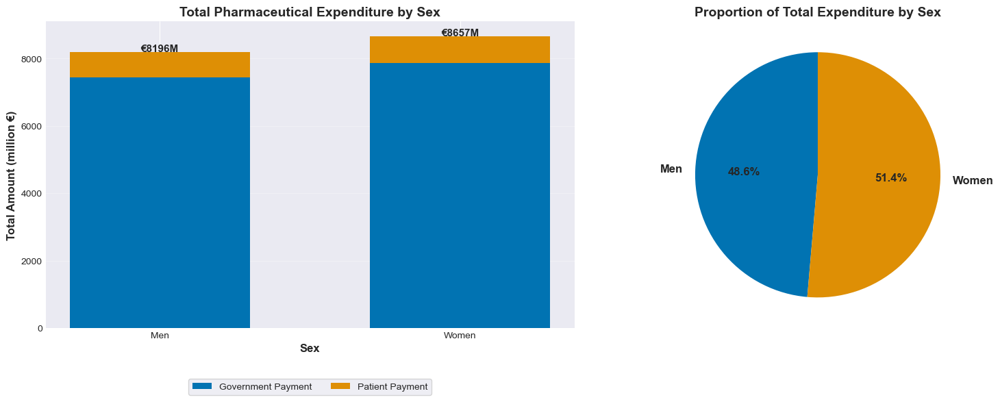

In [14]:
# Total expenditure by Sex
sex_totals = df.groupby('sexe').agg({
    'import íntegre': 'sum',
    'import aportació CatSalut': 'sum'
}).reset_index()

sex_totals.columns = ['Sex', 'Total Cost', 'Government Payment']
sex_totals['Patient Payment'] = sex_totals['Total Cost'] - sex_totals['Government Payment']

print("Total Expenditure by Sex (in millions €):")
print(sex_totals[['Sex', 'Total Cost', 'Government Payment', 'Patient Payment']].assign(
    **{col: sex_totals[col] / 1_000_000 for col in ['Total Cost', 'Government Payment', 'Patient Payment']}
))

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

# Stacked bar chart
x = np.arange(len(sex_totals))
width = 0.6
cb_colors = sns.color_palette("colorblind")
p1 = ax1.bar(x, sex_totals['Government Payment'] / 1_000_000, width, label='Government Payment', color=cb_colors[0])
p2 = ax1.bar(x, sex_totals['Patient Payment'] / 1_000_000, width, bottom=sex_totals['Government Payment'] / 1_000_000, label='Patient Payment', color=cb_colors[1])

ax1.set_ylabel('Total Amount (million €)', fontsize=12, fontweight='bold')
ax1.set_xlabel('Sex', fontsize=12, fontweight='bold')
ax1.set_title('Total Pharmaceutical Expenditure by Sex', fontsize=14, fontweight='bold')
ax1.set_xticks(x)
ax1.set_xticklabels(sex_totals['Sex'])
ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=2, frameon=True)
ax1.grid(axis='y', alpha=0.3)

# Add total labels
for i, row in sex_totals.iterrows():
    total = row['Total Cost'] / 1_000_000
    ax1.text(i, total + 10, f'€{total:.0f}M', ha='center', fontweight='bold', fontsize=11)

# Pie chart showing proportion
ax2.pie(sex_totals['Total Cost'], labels=sex_totals['Sex'], autopct='%1.1f%%', 
        startangle=90, colors=[cb_colors[0], cb_colors[1]], textprops={'fontsize': 12, 'fontweight': 'bold'})
ax2.set_title('Proportion of Total Expenditure by Sex', fontsize=14, fontweight='bold')


plt.tight_layout()
plt.show()


Total Expenditure by Age Group (in millions €):
   Age Group   Total Cost  Government Payment  Patient Payment
0        0-1    26.931490           18.495232         8.436258
6        2-3    26.281001           19.065242         7.215759
11       4-5    30.996346           22.875037         8.121309
16       6-7    39.650703           29.657382         9.993320
21       8-9    57.595094           44.248746        13.346348
1      10-11    64.913459           49.289403        15.624057
2      12-13    73.039315           56.204316        16.834999
3      14-15    82.221309           64.348614        17.872695
4      16-17    85.446950           68.149116        17.297834
5      18-19    79.494729           64.035976        15.458753
7      20-24   204.428374          169.194389        35.233985
8      25-29   237.259236          198.152834        39.106402
9      30-34   320.704654          272.872575        47.832079
10     35-39   461.243754          398.639520        62.604234
12    

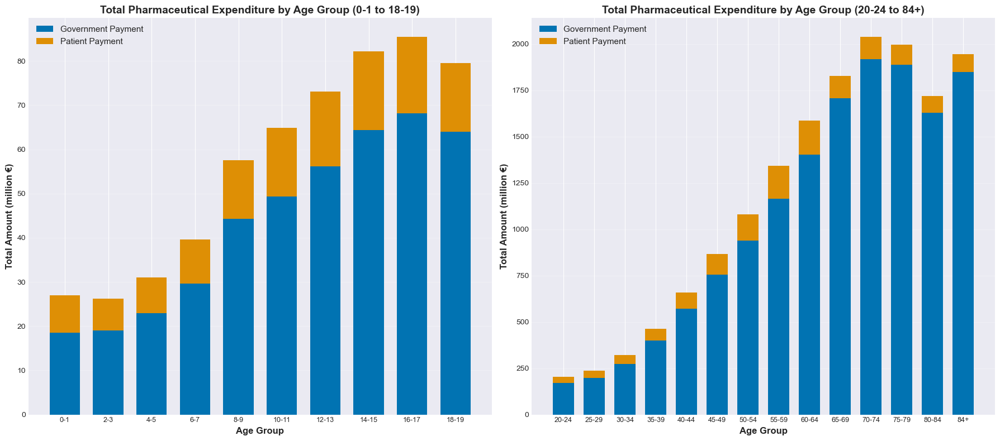

In [15]:
# Total expenditure by Age Group
age_order = ['0-1', '2-3', '4-5', '6-7', '8-9', '10-11', '12-13', '14-15', '16-17', '18-19', 
             '20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', 
             '60-64', '65-69', '70-74', '75-79', '80-84', '84+']

age_totals = df.groupby("grup d'edat").agg({
    'import íntegre': 'sum',
    'import aportació CatSalut': 'sum'
}).reset_index()

age_totals.columns = ['Age Group', 'Total Cost', 'Government Payment']
age_totals['Patient Payment'] = age_totals['Total Cost'] - age_totals['Government Payment']

# Reorder by age
age_totals['Age Group'] = pd.Categorical(age_totals['Age Group'], categories=age_order, ordered=True)
age_totals = age_totals.sort_values('Age Group')

print("\nTotal Expenditure by Age Group (in millions €):")
print(age_totals[['Age Group', 'Total Cost', 'Government Payment', 'Patient Payment']].assign(
    **{col: age_totals[col] / 1_000_000 for col in ['Total Cost', 'Government Payment', 'Patient Payment']}
))

# Split into youth and adult age groups for better readability
youth_ages = ['0-1', '2-3', '4-5', '6-7', '8-9', '10-11', '12-13', '14-15', '16-17', '18-19']
adult_ages = ['20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', 
              '60-64', '65-69', '70-74', '75-79', '80-84', '84+']

age_totals_youth = age_totals[age_totals['Age Group'].isin(youth_ages)]
age_totals_adult = age_totals[age_totals['Age Group'].isin(adult_ages)]

# Plot with two subplots side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 8))
cb_colors = sns.color_palette("colorblind")

# Youth subplot (0-1 to 18-19)
x_youth = np.arange(len(age_totals_youth))
width = 0.7
ax1.bar(x_youth, age_totals_youth['Government Payment'] / 1_000_000, width, 
        label='Government Payment', color=cb_colors[0])
ax1.bar(x_youth, age_totals_youth['Patient Payment'] / 1_000_000, width, 
        bottom=age_totals_youth['Government Payment'] / 1_000_000, 
        label='Patient Payment', color=cb_colors[1])
ax1.set_ylabel('Total Amount (million €)', fontsize=12, fontweight='bold')
ax1.set_xlabel('Age Group', fontsize=12, fontweight='bold')
ax1.set_title('Total Pharmaceutical Expenditure by Age Group (0-1 to 18-19)', fontsize=14, fontweight='bold')
ax1.set_xticks(x_youth)
ax1.set_xticklabels(age_totals_youth['Age Group'], rotation=0, ha='center', fontsize=9)
ax1.legend(fontsize=11)
ax1.grid(axis='y', alpha=0.3)

# Adult subplot (20-24 to 84+)
x_adult = np.arange(len(age_totals_adult))
ax2.bar(x_adult, age_totals_adult['Government Payment'] / 1_000_000, width, 
        label='Government Payment', color=cb_colors[0])
ax2.bar(x_adult, age_totals_adult['Patient Payment'] / 1_000_000, width, 
        bottom=age_totals_adult['Government Payment'] / 1_000_000, 
        label='Patient Payment', color=cb_colors[1])
ax2.set_ylabel('Total Amount (million €)', fontsize=12, fontweight='bold')
ax2.set_xlabel('Age Group', fontsize=12, fontweight='bold')
ax2.set_title('Total Pharmaceutical Expenditure by Age Group (20-24 to 84+)', fontsize=14, fontweight='bold')
ax2.set_xticks(x_adult)
ax2.set_xticklabels(age_totals_adult['Age Group'], rotation=0, ha='center', fontsize=9)
ax2.legend(fontsize=11)
ax2.grid(axis='y', alpha=0.3)

plt.tight_layout()
plt.show()


Total Expenditure by Sanitary Region (in millions €):
                 Sanitary Region   Total Cost  Government Payment  Patient Payment
1                      BARCELONA  8887.587668         8057.841927       829.745741
7                         GIRONA  1672.420406         1513.037512       159.382895
5              CAMP DE TARRAGONA  1301.768549         1183.190008       118.578541
6              CATALUNYA CENTRAL  1130.466835         1030.883072        99.583763
3   BARCELONA METROPOLITANA NORD   960.344337          872.147657        88.196680
8                         LLEIDA   804.764128          734.842593        69.921535
2               BARCELONA CIUTAT   760.616456          689.466000        71.150457
4    BARCELONA METROPOLITANA SUD   535.323339          486.562129        48.761210
10              TERRES DE L'EBRE   440.971633          404.143789        36.827844
9                        PENEDÈS   220.396572          200.816513        19.580059
0             ALT PIRINEU i ARAN

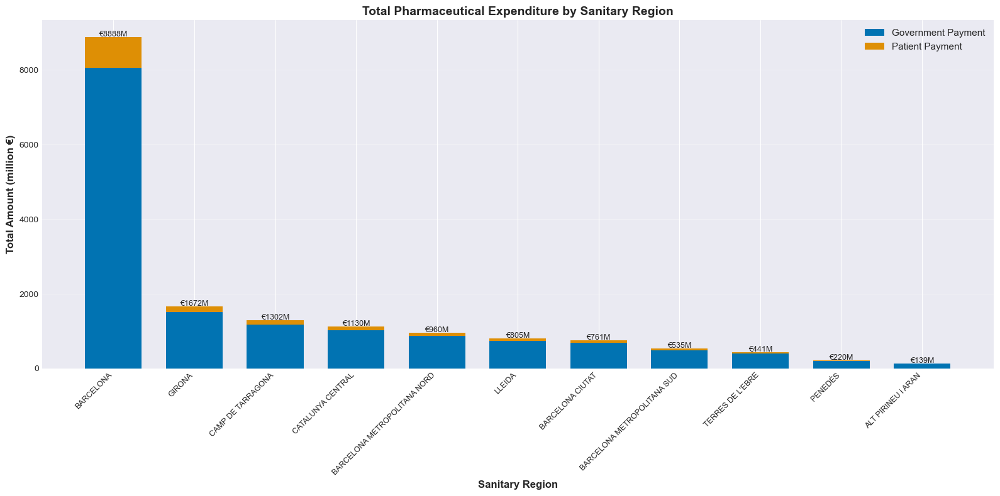

In [16]:
# Total expenditure by Sanitary Region
region_totals = df.groupby('regió sanitària').agg({
    'import íntegre': 'sum',
    'import aportació CatSalut': 'sum'
}).reset_index()

region_totals.columns = ['Sanitary Region', 'Total Cost', 'Government Payment']
region_totals['Patient Payment'] = region_totals['Total Cost'] - region_totals['Government Payment']
region_totals = region_totals.sort_values('Total Cost', ascending=False)

print("\nTotal Expenditure by Sanitary Region (in millions €):")
print(region_totals[['Sanitary Region', 'Total Cost', 'Government Payment', 'Patient Payment']].assign(
    **{col: region_totals[col] / 1_000_000 for col in ['Total Cost', 'Government Payment', 'Patient Payment']}
))

# Plot
fig, ax = plt.subplots(figsize=(16, 8))
x = np.arange(len(region_totals))
width = 0.7
cb_colors = sns.color_palette("colorblind")

p1 = ax.bar(x, region_totals['Government Payment'] / 1_000_000, width, label='Government Payment', color=cb_colors[0])
p2 = ax.bar(x, region_totals['Patient Payment'] / 1_000_000, width, bottom=region_totals['Government Payment'] / 1_000_000, label='Patient Payment', color=cb_colors[1])

ax.set_ylabel('Total Amount (million €)', fontsize=12, fontweight='bold')
ax.set_xlabel('Sanitary Region', fontsize=12, fontweight='bold')
ax.set_title('Total Pharmaceutical Expenditure by Sanitary Region', fontsize=14, fontweight='bold')
ax.set_xticks(x)
ax.set_xticklabels(region_totals['Sanitary Region'], rotation=45, ha='right', fontsize=9)
ax.legend(fontsize=11)
ax.grid(axis='y', alpha=0.3)

# Add total labels on top
for i, row in region_totals.iterrows():
    total = row['Total Cost'] / 1_000_000
    ax.text(x[region_totals.index.get_loc(i)], total + 10, f'€{total:.0f}M', ha='center', fontsize=9)


plt.tight_layout()
plt.show()


Total Expenditure by Sanitary Region (excluding Barcelona, in millions €):
                 Sanitary Region   Total Cost  Government Payment  Patient Payment
7                         GIRONA  1672.420406         1513.037512       159.382895
5              CAMP DE TARRAGONA  1301.768549         1183.190008       118.578541
6              CATALUNYA CENTRAL  1130.466835         1030.883072        99.583763
3   BARCELONA METROPOLITANA NORD   960.344337          872.147657        88.196680
8                         LLEIDA   804.764128          734.842593        69.921535
2               BARCELONA CIUTAT   760.616456          689.466000        71.150457
4    BARCELONA METROPOLITANA SUD   535.323339          486.562129        48.761210
10              TERRES DE L'EBRE   440.971633          404.143789        36.827844
9                        PENEDÈS   220.396572          200.816513        19.580059
0             ALT PIRINEU i ARAN   138.626245          124.973654        13.652592


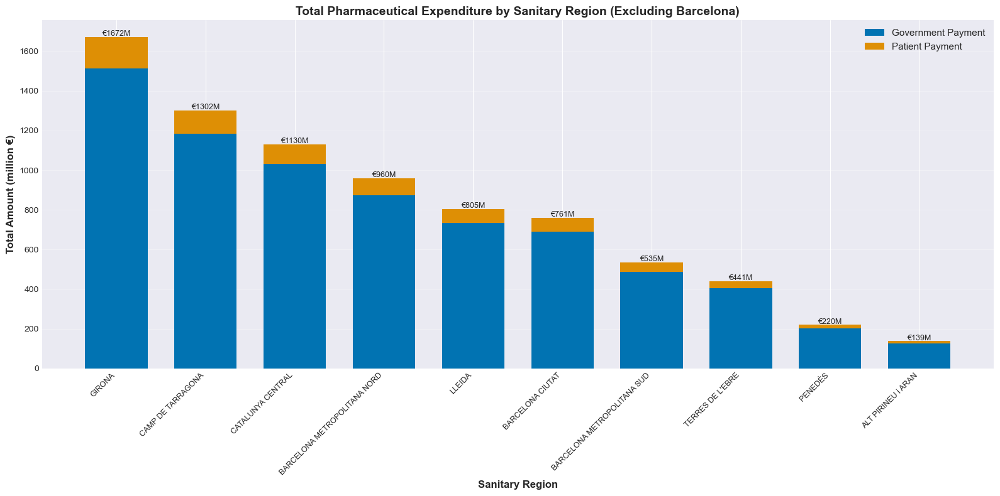

In [17]:
# Total expenditure by Sanitary Region (excluding Barcelona)
region_totals_no_bcn = region_totals[region_totals['Sanitary Region'] != 'BARCELONA']

print("\nTotal Expenditure by Sanitary Region (excluding Barcelona, in millions €):")
print(region_totals_no_bcn[['Sanitary Region', 'Total Cost', 'Government Payment', 'Patient Payment']].assign(
    **{col: region_totals_no_bcn[col] / 1_000_000 for col in ['Total Cost', 'Government Payment', 'Patient Payment']}
))

# Plot
fig, ax = plt.subplots(figsize=(16, 8))
x = np.arange(len(region_totals_no_bcn))
width = 0.7
cb_colors = sns.color_palette("colorblind")

p1 = ax.bar(x, region_totals_no_bcn['Government Payment'] / 1_000_000, width, label='Government Payment', color=cb_colors[0])
p2 = ax.bar(x, region_totals_no_bcn['Patient Payment'] / 1_000_000, width, bottom=region_totals_no_bcn['Government Payment'] / 1_000_000, label='Patient Payment', color=cb_colors[1])

ax.set_ylabel('Total Amount (million €)', fontsize=12, fontweight='bold')
ax.set_xlabel('Sanitary Region', fontsize=12, fontweight='bold')
ax.set_title('Total Pharmaceutical Expenditure by Sanitary Region (Excluding Barcelona)', fontsize=14, fontweight='bold')
ax.set_xticks(x)
ax.set_xticklabels(region_totals_no_bcn['Sanitary Region'], rotation=45, ha='right', fontsize=9)
ax.legend(fontsize=11)
ax.grid(axis='y', alpha=0.3)

# Add total labels on top
for i, (idx, row) in enumerate(region_totals_no_bcn.iterrows()):
    total = row['Total Cost'] / 1_000_000
    ax.text(i, total + 5, f'€{total:.0f}M', ha='center', fontsize=9)


plt.tight_layout()
plt.show()


Total Expenditure by ATC Level 1 (in millions €):
                                          ATC Level 1   Total Cost  Government Payment  Patient Payment
9                                      NERVOUS SYSTEM  4602.315790         4261.277866       341.037924
0                     ALIMENTARY TRACT AND METABOLISM  3127.342353         2892.653867       234.688486
5                               CARDIOVASCULAR SYSTEM  2580.587721         2283.013699       297.574022
10                                 RESPIRATORY SYSTEM  1529.169735         1399.935987       129.233748
4                      BLOOD AND BLOOD FORMING ORGANS  1385.316834         1300.033410        85.283424
2          ANTINEOPLASTIC AND IMMUNOMODULATING AGENTS   942.317004          914.432443        27.884561
7              GENITO-URINARY SYSTEM AND SEX HORMONES   721.746404          625.484937        96.261467
1                     ANTIINFECTIVES FOR SYSTEMIC USE   474.838272          340.157266       134.681007
8            

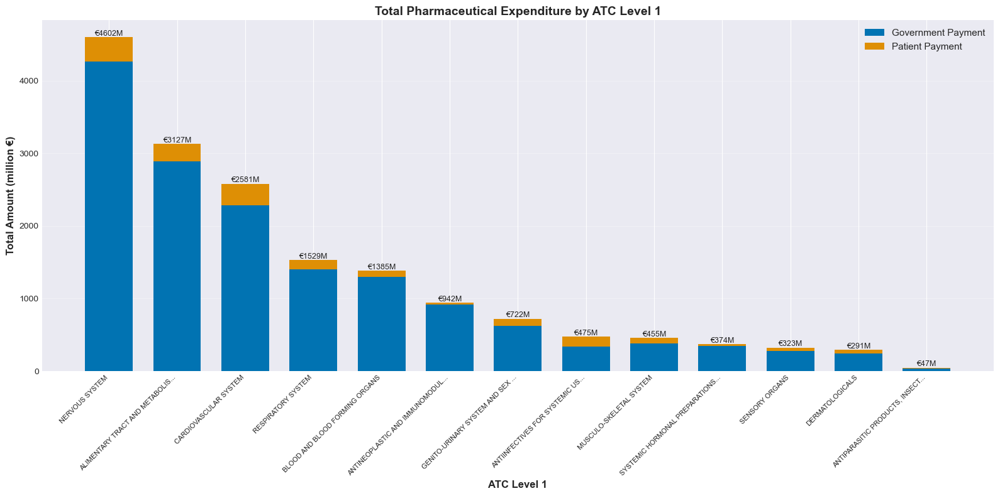

In [18]:
# Total expenditure by ATC Level 1
atc1_totals = df.groupby('grup ATC nivell 1').agg({
    'import íntegre': 'sum',
    'import aportació CatSalut': 'sum'
}).reset_index()

atc1_totals.columns = ['ATC Level 1', 'Total Cost', 'Government Payment']
atc1_totals['Patient Payment'] = atc1_totals['Total Cost'] - atc1_totals['Government Payment']
atc1_totals = atc1_totals.sort_values('Total Cost', ascending=False)

print("\nTotal Expenditure by ATC Level 1 (in millions €):")
print(atc1_totals[['ATC Level 1', 'Total Cost', 'Government Payment', 'Patient Payment']].assign(
    **{col: atc1_totals[col] / 1_000_000 for col in ['Total Cost', 'Government Payment', 'Patient Payment']}
))

# Plot
fig, ax = plt.subplots(figsize=(16, 8))
x = np.arange(len(atc1_totals))
width = 0.7
cb_colors = sns.color_palette("colorblind")

p1 = ax.bar(x, atc1_totals['Government Payment'] / 1_000_000, width, label='Government Payment', color=cb_colors[0])
p2 = ax.bar(x, atc1_totals['Patient Payment'] / 1_000_000, width, bottom=atc1_totals['Government Payment'] / 1_000_000, label='Patient Payment', color=cb_colors[1])

ax.set_ylabel('Total Amount (million €)', fontsize=12, fontweight='bold')
ax.set_xlabel('ATC Level 1', fontsize=12, fontweight='bold')
ax.set_title('Total Pharmaceutical Expenditure by ATC Level 1', fontsize=14, fontweight='bold')
ax.set_xticks(x)
# Use abbreviated labels that fit with rotation
abbreviated_labels = [label[:30] + '...' if len(label) > 30 else label for label in atc1_totals['ATC Level 1']]
ax.set_xticklabels(abbreviated_labels, rotation=45, ha='right', fontsize=8)
ax.legend(fontsize=11)
ax.grid(axis='y', alpha=0.3)

# Add total labels on top
for i, row in atc1_totals.iterrows():
    total = row['Total Cost'] / 1_000_000
    ax.text(x[atc1_totals.index.get_loc(i)], total + 20, f'€{total:.0f}M', ha='center', fontsize=9)



plt.tight_layout()
plt.show()

## 3. Comparative Analysis: Sex x ATC Level 1

Total Expenditure by Sex and ATC Level 1 (in millions €):
sexe                                                        Men        Women
grup ATC nivell 1                                                           
NERVOUS SYSTEM                                      1961.226057  2641.089732
ALIMENTARY TRACT AND METABOLISM                     1585.623199  1541.719153
CARDIOVASCULAR SYSTEM                               1486.130672  1094.457049
RESPIRATORY SYSTEM                                   815.379626   713.790109
BLOOD AND BLOOD FORMING ORGANS                       688.748719   696.568115
GENITO-URINARY SYSTEM AND SEX HORMONES               471.129895   250.616510
ANTINEOPLASTIC AND IMMUNOMODULATING AGENTS           416.185556   526.131448
ANTIINFECTIVES FOR SYSTEMIC USE                      216.847674   257.990599
DERMATOLOGICALS                                      145.686292   145.021507
SENSORY ORGANS                                       142.298598   180.502707
MUSCULO-SKELETAL S

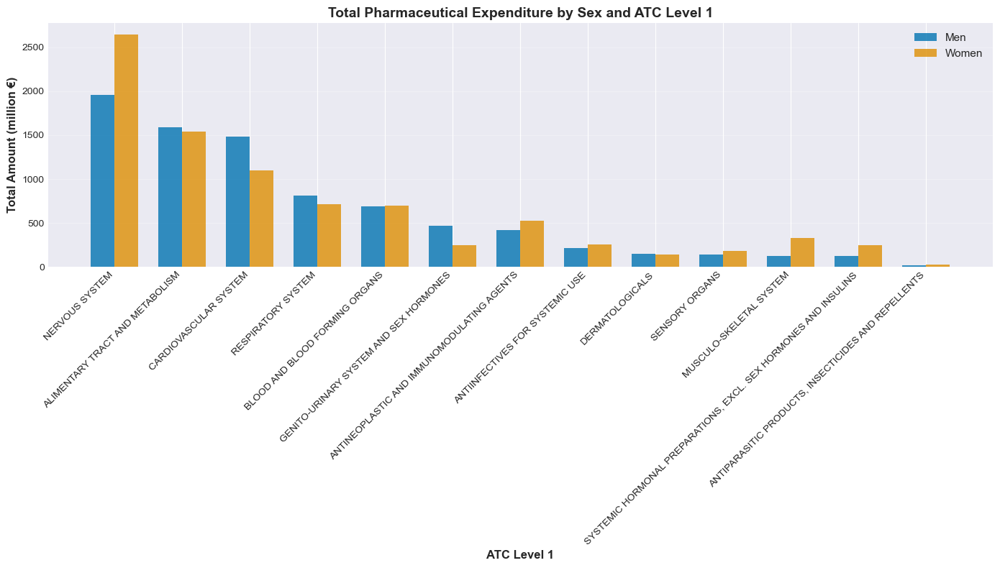

In [19]:
# Sex comparison for each ATC Level 1
sex_atc1 = df.groupby(['grup ATC nivell 1', 'sexe']).agg({
    'import íntegre': 'sum',
    'import aportació CatSalut': 'sum'
}).reset_index()

sex_atc1_pivot = sex_atc1.pivot(index='grup ATC nivell 1', columns='sexe', values='import íntegre')
sex_atc1_pivot = sex_atc1_pivot.sort_values(by=sex_atc1_pivot.columns[0], ascending=False)

print("Total Expenditure by Sex and ATC Level 1 (in millions €):")
print(sex_atc1_pivot / 1_000_000)

# Plot
fig, ax = plt.subplots(figsize=(14, 8))
sex_atc1_pivot_plot = sex_atc1_pivot / 1_000_000
x = np.arange(len(sex_atc1_pivot_plot))
width = 0.35
cb_colors = sns.color_palette("colorblind")

sexes = sex_atc1_pivot_plot.columns
for i, sex in enumerate(sexes):
    ax.bar(x + i*width, sex_atc1_pivot_plot[sex], width, label=sex, color=cb_colors[i], alpha=0.8)

ax.set_ylabel('Total Amount (million €)', fontsize=12, fontweight='bold')
ax.set_xlabel('ATC Level 1', fontsize=12, fontweight='bold')
ax.set_title('Total Pharmaceutical Expenditure by Sex and ATC Level 1', fontsize=14, fontweight='bold')
ax.set_xticks(x + width / 2)
ax.set_xticklabels(sex_atc1_pivot_plot.index, rotation=45, ha='right')
ax.legend(fontsize=11)
ax.grid(axis='y', alpha=0.3)

plt.tight_layout()
plt.show()

## 4. Comparative Analysis: Age Groups x ATC Level 1

Total Expenditure by Age Group for All ATC Level 1 (in millions €):
grup ATC nivell 1  NERVOUS SYSTEM  ALIMENTARY TRACT AND METABOLISM  CARDIOVASCULAR SYSTEM  RESPIRATORY SYSTEM  \
grup d'edat                                                                                                     
0-1                      3.038692                         6.905816               2.889981            3.768258   
2-3                      2.712835                         1.125500               1.161916            7.611300   
4-5                      3.254059                         1.348194               1.203823            8.713283   
6-7                      5.394430                         1.710870               1.766041            8.423809   
8-9                     11.123141                         2.387454               3.009003            8.695763   
10-11                   17.788466                         3.410817               4.307102            9.183293   
12-13                   25.0

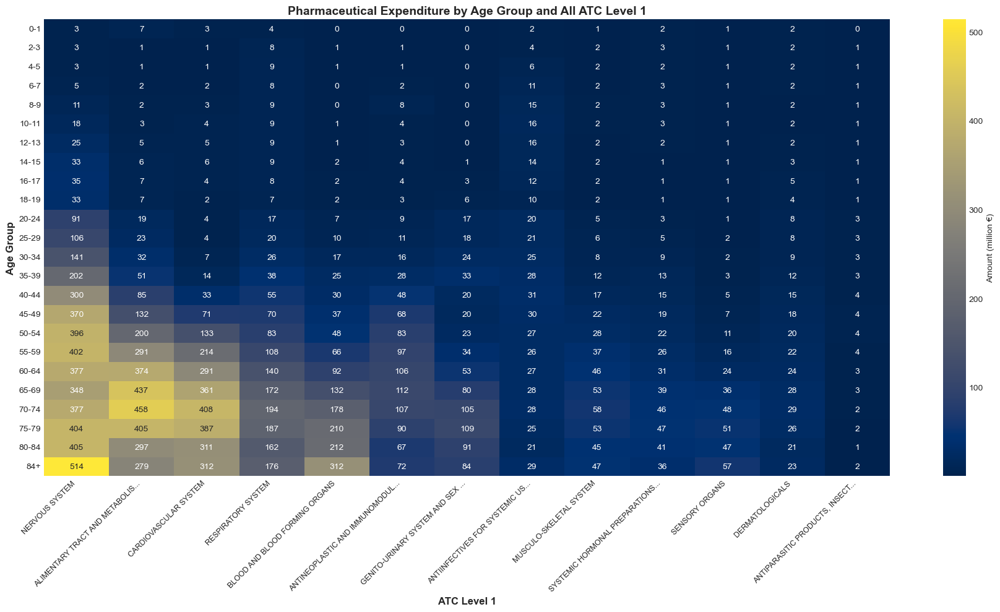

In [20]:
# Age Group comparison for all ATC Level 1 categories
age_atc1_all = df.groupby(["grup d'edat", 'grup ATC nivell 1']).agg({
    'import íntegre': 'sum'
}).reset_index()

# Order age groups
age_atc1_all["grup d'edat"] = pd.Categorical(age_atc1_all["grup d'edat"], categories=age_order, ordered=True)
age_atc1_all = age_atc1_all.sort_values("grup d'edat")

print("Total Expenditure by Age Group for All ATC Level 1 (in millions €):")

# Create a heatmap
pivot_data = age_atc1_all.pivot(index="grup d'edat", columns='grup ATC nivell 1', values='import íntegre') / 1_000_000
# Sort columns by total expenditure
column_order = pivot_data.sum().sort_values(ascending=False).index
pivot_data = pivot_data[column_order]
print(pivot_data)

fig, ax = plt.subplots(figsize=(18, 10))
# Use abbreviated column labels for better fit
abbreviated_cols = [col[:30] + '...' if len(col) > 30 else col for col in pivot_data.columns]
sns.heatmap(pivot_data, annot=True, fmt='.0f', cmap='cividis', cbar_kws={'label': 'Amount (million €)'}, ax=ax, xticklabels=abbreviated_cols)
ax.set_title('Pharmaceutical Expenditure by Age Group and All ATC Level 1', fontsize=14, fontweight='bold')
ax.set_xlabel('ATC Level 1', fontsize=12, fontweight='bold')

ax.set_xlabel('ATC Level 1', fontsize=12, fontweight='bold')
ax.set_ylabel('Age Group', fontsize=12, fontweight='bold')
plt.setp(ax.get_xticklabels(), rotation=45, ha='right', fontsize=9)
plt.tight_layout()
plt.show()

## 5. Comparative Analysis: Sanitary Regions x ATC Level 1

Total Expenditure by Sanitary Region for All ATC Level 1 (in millions €):
grup ATC nivell 1             NERVOUS SYSTEM  ALIMENTARY TRACT AND METABOLISM  CARDIOVASCULAR SYSTEM  RESPIRATORY SYSTEM  \
regió sanitària                                                                                                            
BARCELONA                        2431.713067                      1596.608337            1350.457957          825.482849   
GIRONA                            472.024294                       281.264733             265.927874          154.397447   
CAMP DE TARRAGONA                 340.234174                       265.091107             205.328929          110.871642   
CATALUNYA CENTRAL                 346.811918                       198.047667             164.383070          101.942883   
BARCELONA METROPOLITANA NORD      247.203968                       200.687951             144.626771           85.625538   
LLEIDA                            233.553070              

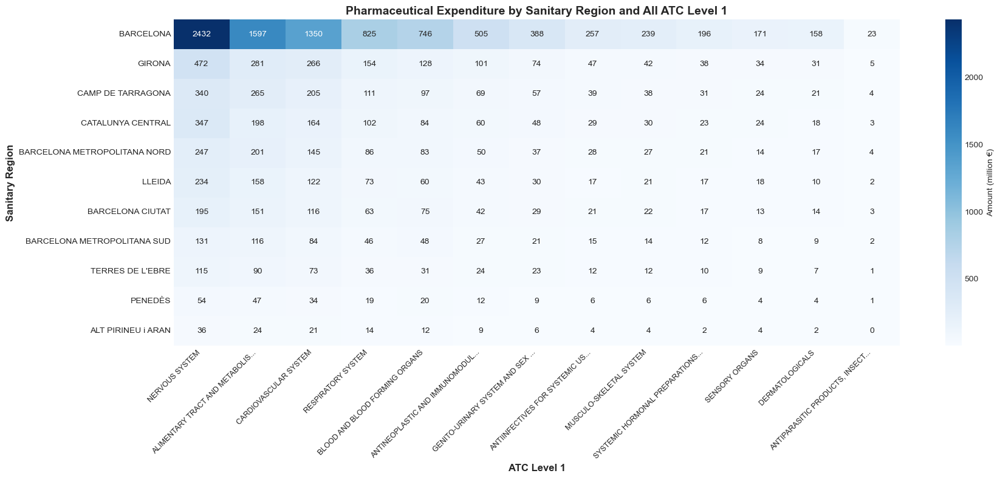

In [21]:
# Sanitary Region comparison for all ATC Level 1 categories
region_atc1_all = df.groupby(['regió sanitària', 'grup ATC nivell 1']).agg({
    'import íntegre': 'sum'
}).reset_index()

print("Total Expenditure by Sanitary Region for All ATC Level 1 (in millions €):")

# Create a heatmap
pivot_data_region = region_atc1_all.pivot(index='regió sanitària', columns='grup ATC nivell 1', values='import íntegre') / 1_000_000
# Sort columns by total expenditure
column_order_region = pivot_data_region.sum().sort_values(ascending=False).index
pivot_data_region = pivot_data_region[column_order_region]
# Sort rows by total
pivot_data_region['Total'] = pivot_data_region.sum(axis=1)
pivot_data_region = pivot_data_region.sort_values('Total', ascending=False).drop('Total', axis=1)

print(pivot_data_region)

fig, ax = plt.subplots(figsize=(18, 8))
# Use abbreviated column labels for better fit
abbreviated_cols_region = [col[:30] + '...' if len(col) > 30 else col for col in pivot_data_region.columns]
sns.heatmap(pivot_data_region, annot=True, fmt='.0f', cmap='Blues', cbar_kws={'label': 'Amount (million €)'}, ax=ax, xticklabels=abbreviated_cols_region)
ax.set_title('Pharmaceutical Expenditure by Sanitary Region and All ATC Level 1', fontsize=14, fontweight='bold')
ax.set_xlabel('ATC Level 1', fontsize=12, fontweight='bold')
ax.set_ylabel('Sanitary Region', fontsize=12, fontweight='bold')
plt.setp(ax.get_xticklabels(), rotation=45, ha='right', fontsize=9)
plt.tight_layout()
plt.show()


Total Expenditure by Sanitary Region for All ATC Level 1 (excluding BARCELONA, in millions €):
grup ATC nivell 1             NERVOUS SYSTEM  ALIMENTARY TRACT AND METABOLISM  CARDIOVASCULAR SYSTEM  RESPIRATORY SYSTEM  \
regió sanitària                                                                                                            
GIRONA                            472.024294                       281.264733             265.927874          154.397447   
CAMP DE TARRAGONA                 340.234174                       265.091107             205.328929          110.871642   
CATALUNYA CENTRAL                 346.811918                       198.047667             164.383070          101.942883   
BARCELONA METROPOLITANA NORD      247.203968                       200.687951             144.626771           85.625538   
LLEIDA                            233.553070                       157.658192             121.995022           73.101067   
BARCELONA CIUTAT                  19

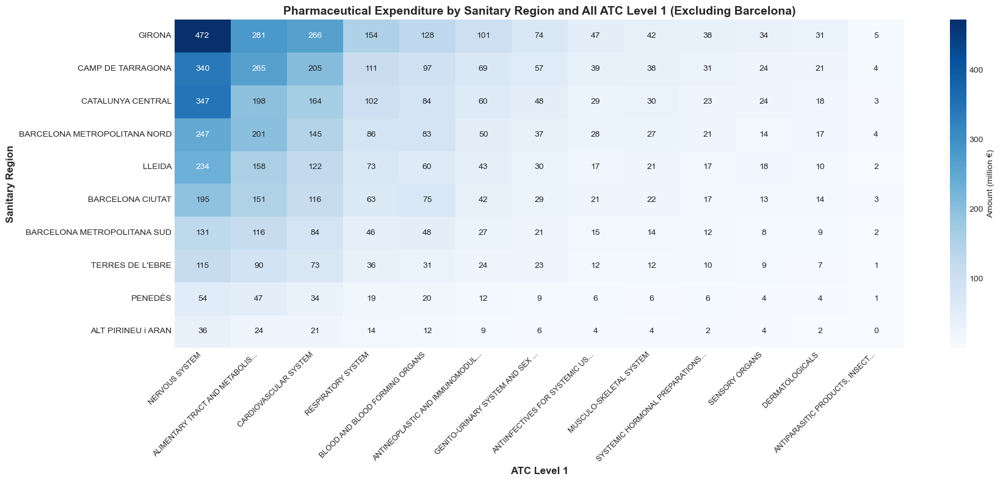

In [22]:
# Sanitary Region comparison for all ATC Level 1 categories (excluding BARCELONA)
region_atc1_no_bcn = df[df['regió sanitària'] != 'BARCELONA'].groupby(['regió sanitària', 'grup ATC nivell 1']).agg({
    'import íntegre': 'sum'
}).reset_index()

print("\nTotal Expenditure by Sanitary Region for All ATC Level 1 (excluding BARCELONA, in millions €):")

# Create a heatmap
pivot_data_region_no_bcn = region_atc1_no_bcn.pivot(index='regió sanitària', columns='grup ATC nivell 1', values='import íntegre') / 1_000_000
# Sort columns by total expenditure
column_order_region_no_bcn = pivot_data_region_no_bcn.sum().sort_values(ascending=False).index
pivot_data_region_no_bcn = pivot_data_region_no_bcn[column_order_region_no_bcn]
# Sort rows by total
pivot_data_region_no_bcn['Total'] = pivot_data_region_no_bcn.sum(axis=1)
pivot_data_region_no_bcn = pivot_data_region_no_bcn.sort_values('Total', ascending=False).drop('Total', axis=1)

print(pivot_data_region_no_bcn)

fig, ax = plt.subplots(figsize=(18, 8))
# Use abbreviated column labels for better fit
abbreviated_cols_region_no_bcn = [col[:30] + '...' if len(col) > 30 else col for col in pivot_data_region_no_bcn.columns]
sns.heatmap(pivot_data_region_no_bcn, annot=True, fmt='.0f', cmap='Blues', cbar_kws={'label': 'Amount (million €)'}, ax=ax, xticklabels=abbreviated_cols_region_no_bcn)
ax.set_title('Pharmaceutical Expenditure by Sanitary Region and All ATC Level 1 (Excluding Barcelona)', fontsize=14, fontweight='bold')
ax.set_xlabel('ATC Level 1', fontsize=12, fontweight='bold')
ax.set_ylabel('Sanitary Region', fontsize=12, fontweight='bold')
plt.setp(ax.get_xticklabels(), rotation=45, ha='right', fontsize=9)
plt.tight_layout()
plt.show()

## 6. Individual Analysis for Each ATC Level 1 Group


ANALYSIS FOR: NERVOUS SYSTEM

Total Cost: €4602.32M
Government Payment: €4261.28M (87.5%)
Patient Payment: €341.04M (12.5%)


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\504635607.py:115: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



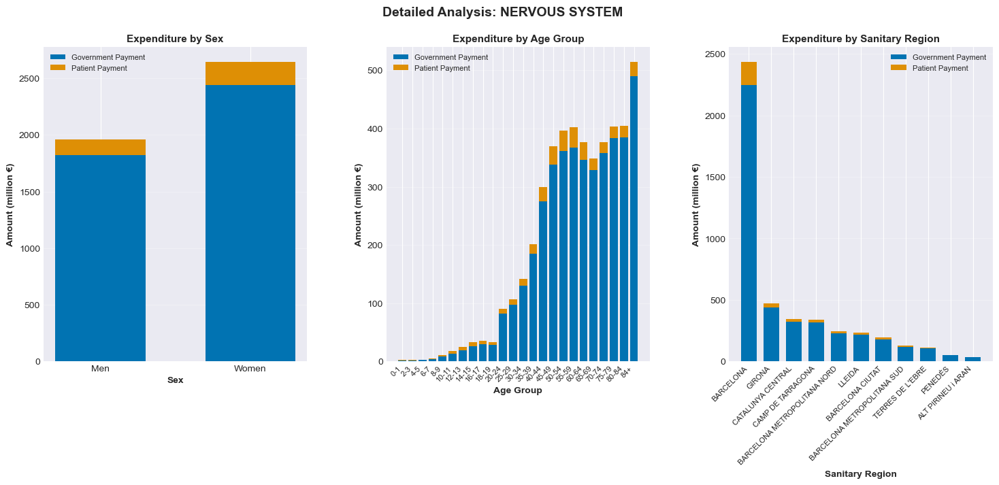


ANALYSIS FOR: ALIMENTARY TRACT AND METABOLISM

Total Cost: €3127.34M
Government Payment: €2892.65M (83.5%)
Patient Payment: €234.69M (16.5%)


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\504635607.py:115: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



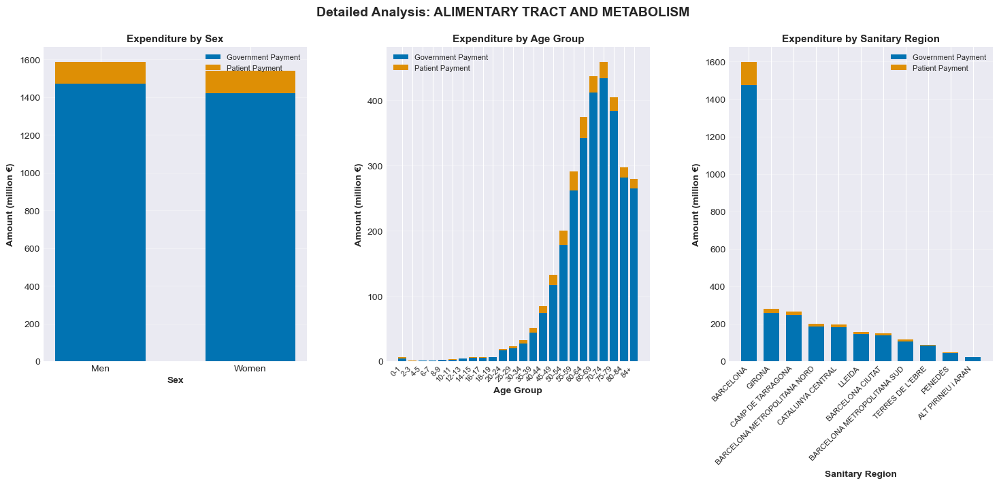


ANALYSIS FOR: CARDIOVASCULAR SYSTEM

Total Cost: €2580.59M
Government Payment: €2283.01M (87.4%)
Patient Payment: €297.57M (12.6%)


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\504635607.py:115: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



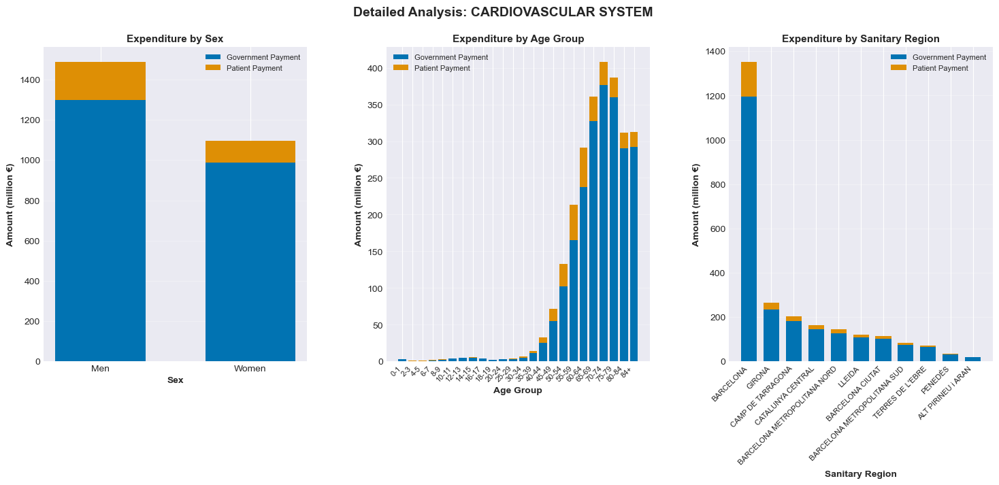


ANALYSIS FOR: RESPIRATORY SYSTEM

Total Cost: €1529.17M
Government Payment: €1399.94M (82.4%)
Patient Payment: €129.23M (17.6%)


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\504635607.py:115: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



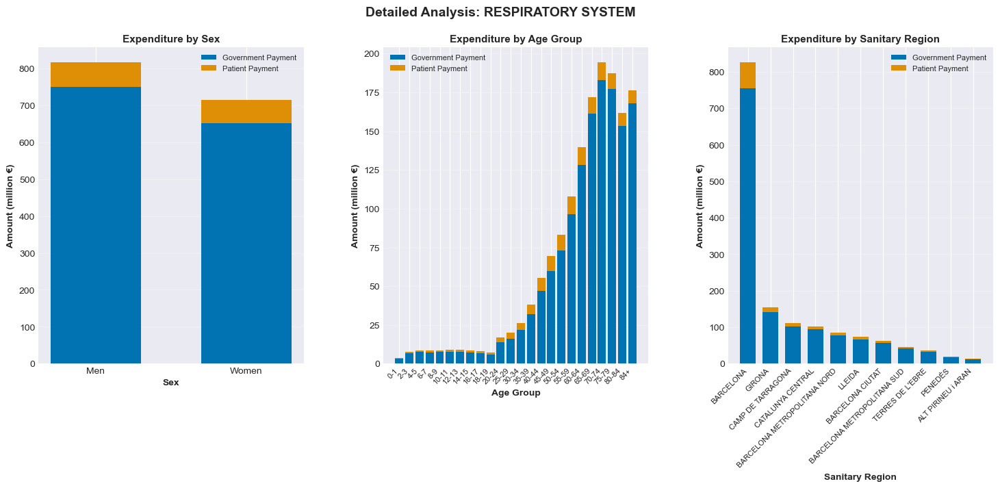


ANALYSIS FOR: BLOOD AND BLOOD FORMING ORGANS

Total Cost: €1385.32M
Government Payment: €1300.03M (84.0%)
Patient Payment: €85.28M (16.0%)


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\504635607.py:115: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



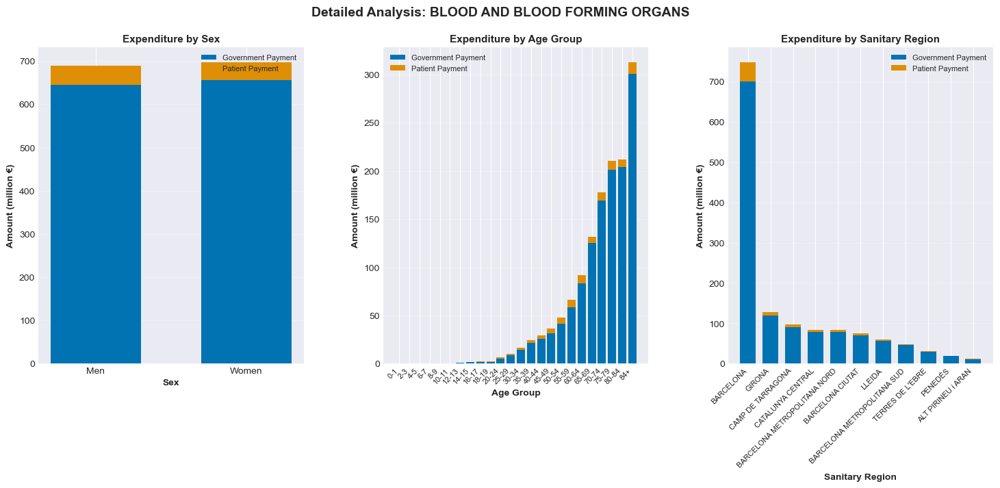


ANALYSIS FOR: ANTINEOPLASTIC AND IMMUNOMODULATING AGENTS

Total Cost: €942.32M
Government Payment: €914.43M (95.4%)
Patient Payment: €27.88M (4.6%)


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\504635607.py:115: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



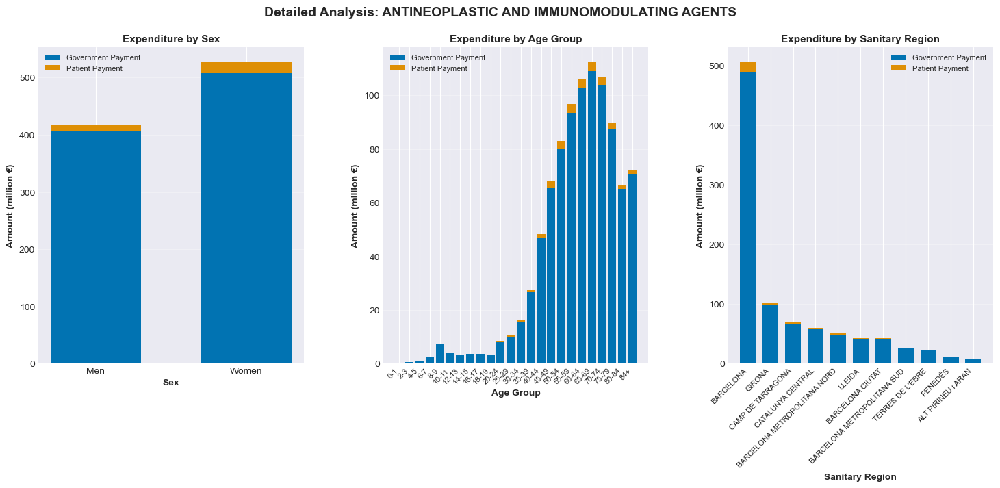


ANALYSIS FOR: GENITO-URINARY SYSTEM AND SEX HORMONES

Total Cost: €721.75M
Government Payment: €625.48M (81.2%)
Patient Payment: €96.26M (18.8%)


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\504635607.py:115: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



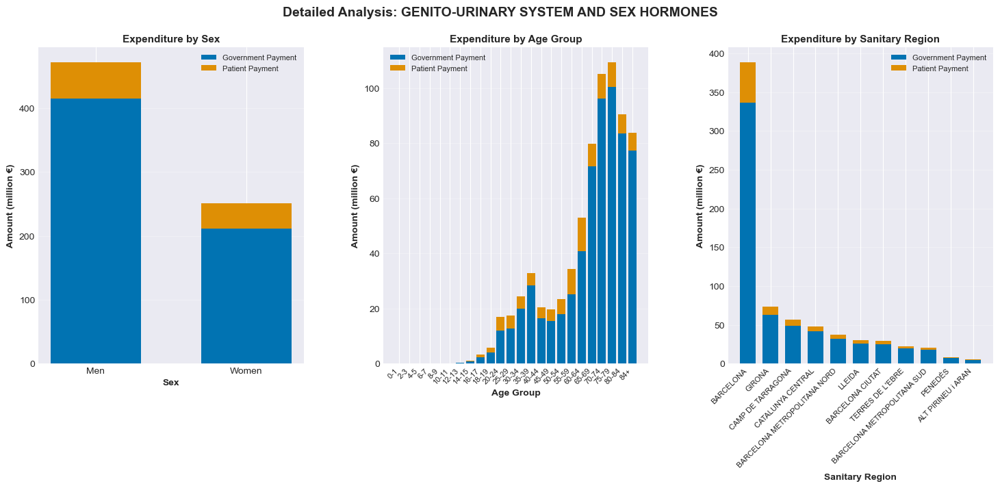


ANALYSIS FOR: ANTIINFECTIVES FOR SYSTEMIC USE

Total Cost: €474.84M
Government Payment: €340.16M (73.2%)
Patient Payment: €134.68M (26.8%)


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\504635607.py:115: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



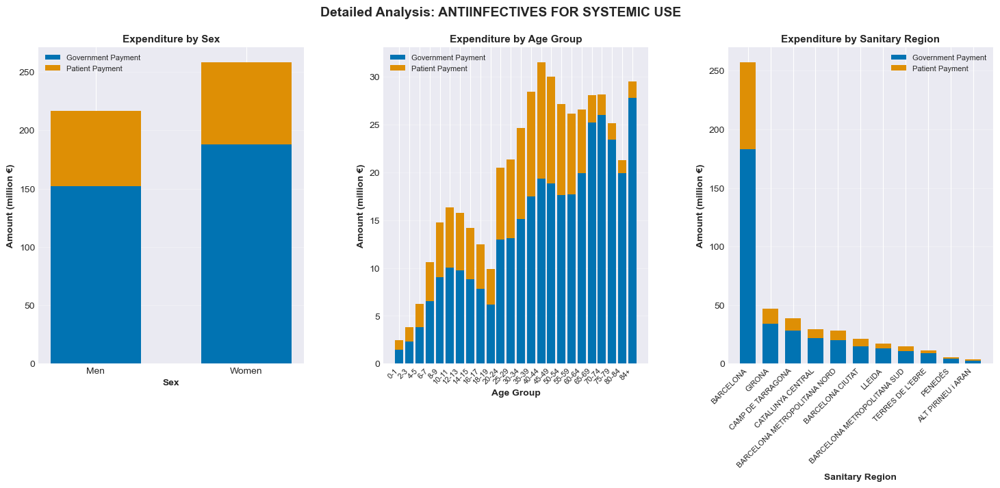


ANALYSIS FOR: MUSCULO-SKELETAL SYSTEM

Total Cost: €455.39M
Government Payment: €377.65M (78.4%)
Patient Payment: €77.74M (21.6%)


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\504635607.py:115: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



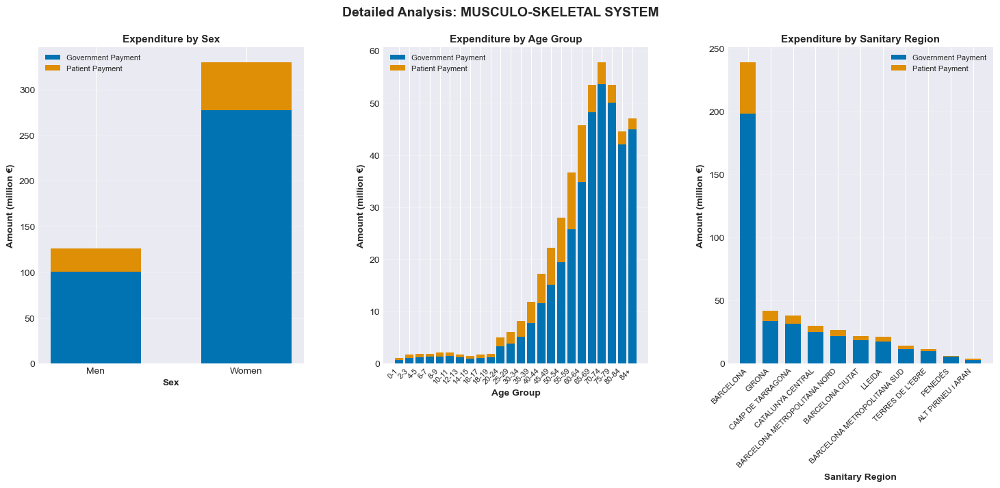


ANALYSIS FOR: SYSTEMIC HORMONAL PREPARATIONS, EXCL. SEX HORMONES AND INSULINS

Total Cost: €373.54M
Government Payment: €346.15M (87.3%)
Patient Payment: €27.40M (12.7%)


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\504635607.py:115: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



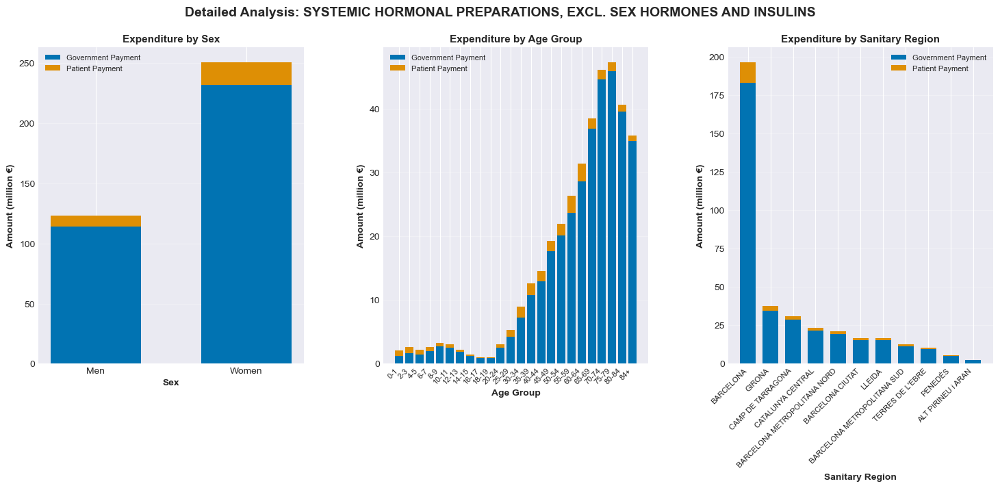


ANALYSIS FOR: SENSORY ORGANS

Total Cost: €322.80M
Government Payment: €276.88M (73.7%)
Patient Payment: €45.92M (26.3%)


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\504635607.py:115: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



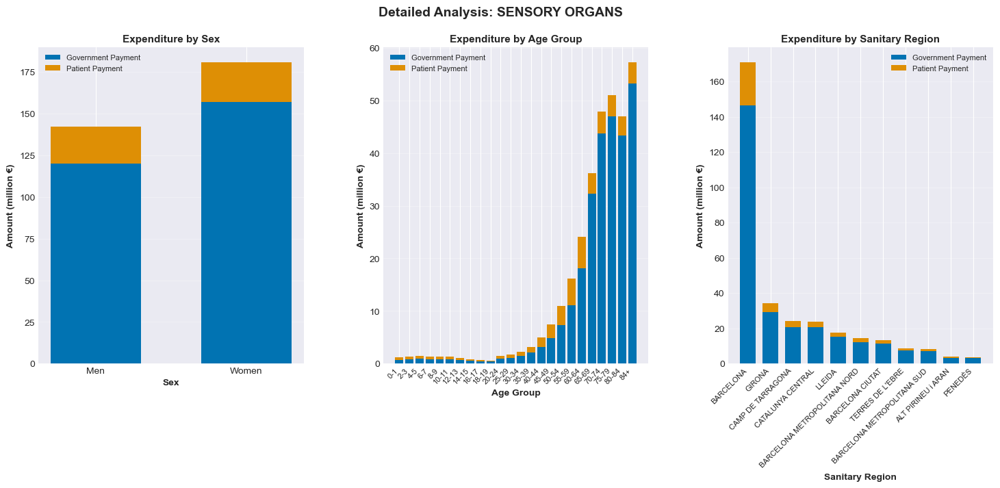


ANALYSIS FOR: DERMATOLOGICALS

Total Cost: €290.71M
Government Payment: €242.07M (75.4%)
Patient Payment: €48.63M (24.6%)


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\504635607.py:115: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



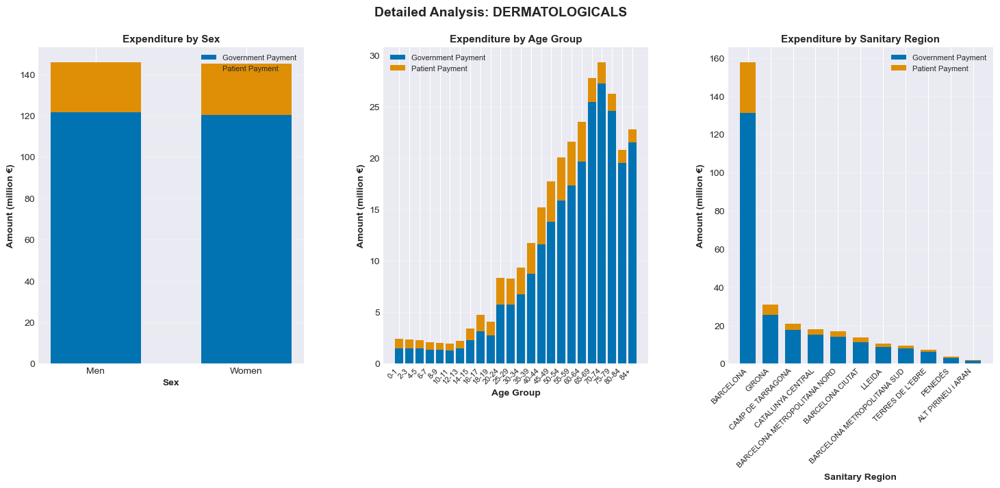


ANALYSIS FOR: ANTIPARASITIC PRODUCTS, INSECTICIDES AND REPELLENTS

Total Cost: €47.21M
Government Payment: €38.17M (76.1%)
Patient Payment: €9.04M (23.9%)


C:\Users\agos1\AppData\Local\Temp\ipykernel_4576\504635607.py:115: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



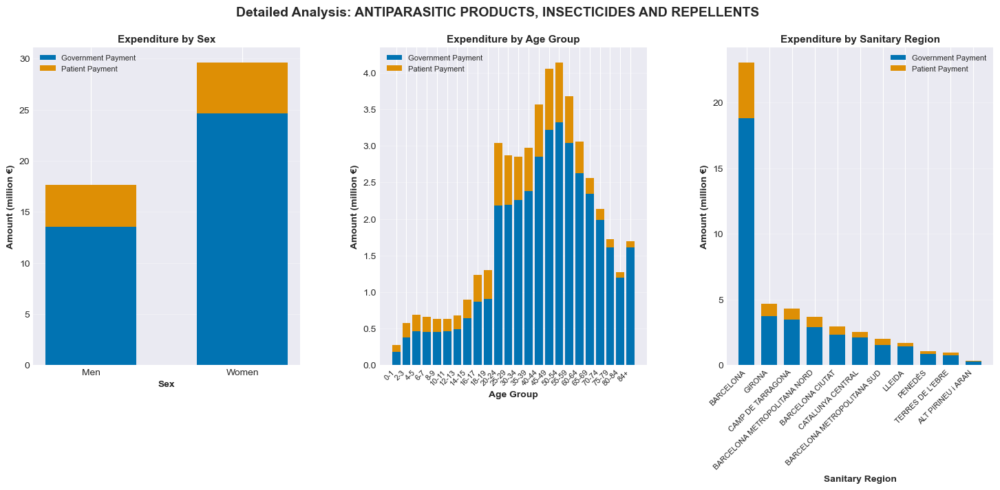


Individual ATC Level 1 analysis complete!


In [23]:
# Get all unique ATC Level 1 groups sorted by total cost
atc1_groups = atc1_totals['ATC Level 1'].tolist()

# Age order for proper sorting
age_order = ['0-1', '2-3', '4-5', '6-7', '8-9', '10-11', '12-13', '14-15', '16-17', '18-19', 
             '20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', 
             '60-64', '65-69', '70-74', '75-79', '80-84', '84+']

# Create individual plots for each ATC Level 1 group
for atc_group in atc1_groups:
    print("\n" + "="*80)
    print(f"ANALYSIS FOR: {atc_group}")
    print("="*80)
    
    # Filter data for this ATC Level 1 group
    df_atc = df[df['grup ATC nivell 1'] == atc_group]
    
    # Calculate totals
    total_cost_atc = df_atc['import íntegre'].sum() / 1_000_000
    total_gov_atc = df_atc['import aportació CatSalut'].sum() / 1_000_000
    total_patient_atc = total_cost_atc - total_gov_atc
    mean_fraction_atc = df_atc['fracció_govern'].mean() * 100
    
    print(f"\nTotal Cost: €{total_cost_atc:.2f}M")
    print(f"Government Payment: €{total_gov_atc:.2f}M ({mean_fraction_atc:.1f}%)")
    print(f"Patient Payment: €{total_patient_atc:.2f}M ({100-mean_fraction_atc:.1f}%)")
    
    # Create figure with 3 subplots
    fig = plt.figure(figsize=(18, 6))
    gs = fig.add_gridspec(1, 3, hspace=0.3, wspace=0.3)
    
    cb_colors = sns.color_palette("colorblind")
    
    # 1. By Sex
    ax1 = fig.add_subplot(gs[0, 0])
    sex_data = df_atc.groupby('sexe').agg({
        'import íntegre': 'sum',
        'import aportació CatSalut': 'sum'
    }).reset_index()
    sex_data.columns = ['Sex', 'Total Cost', 'Government Payment']
    sex_data['Patient Payment'] = sex_data['Total Cost'] - sex_data['Government Payment']
    
    x_sex = np.arange(len(sex_data))
    width = 0.6
    ax1.bar(x_sex, sex_data['Government Payment'] / 1_000_000, width, 
            label='Government Payment', color=cb_colors[0])
    ax1.bar(x_sex, sex_data['Patient Payment'] / 1_000_000, width, 
            bottom=sex_data['Government Payment'] / 1_000_000, 
            label='Patient Payment', color=cb_colors[1])
    
    ax1.set_ylabel('Amount (million €)', fontsize=10, fontweight='bold')
    ax1.set_xlabel('Sex', fontsize=10, fontweight='bold')
    ax1.set_title('Expenditure by Sex', fontsize=11, fontweight='bold')
    ax1.set_xticks(x_sex)
    ax1.set_xticklabels(sex_data['Sex'])
    ax1.legend(fontsize=8)
    ax1.grid(axis='y', alpha=0.3)
    
    # 2. By Age Group
    ax2 = fig.add_subplot(gs[0, 1])
    age_data = df_atc.groupby("grup d'edat").agg({
        'import íntegre': 'sum',
        'import aportació CatSalut': 'sum'
    }).reset_index()
    age_data.columns = ['Age Group', 'Total Cost', 'Government Payment']
    age_data['Patient Payment'] = age_data['Total Cost'] - age_data['Government Payment']
    age_data['Age Group'] = pd.Categorical(age_data['Age Group'], categories=age_order, ordered=True)
    age_data = age_data.sort_values('Age Group')
    
    x_age = np.arange(len(age_data))
    width_age = 0.8
    ax2.bar(x_age, age_data['Government Payment'] / 1_000_000, width_age, 
            label='Government Payment', color=cb_colors[0])
    ax2.bar(x_age, age_data['Patient Payment'] / 1_000_000, width_age, 
            bottom=age_data['Government Payment'] / 1_000_000, 
            label='Patient Payment', color=cb_colors[1])
    
    ax2.set_ylabel('Amount (million €)', fontsize=10, fontweight='bold')
    ax2.set_xlabel('Age Group', fontsize=10, fontweight='bold')
    ax2.set_title('Expenditure by Age Group', fontsize=11, fontweight='bold')
    ax2.set_xticks(x_age)
    ax2.set_xticklabels(age_data['Age Group'], rotation=45, ha='right', fontsize=8)
    ax2.legend(fontsize=8)
    ax2.grid(axis='y', alpha=0.3)
    
    # 3. By Sanitary Region
    ax3 = fig.add_subplot(gs[0, 2])
    region_data = df_atc.groupby('regió sanitària').agg({
        'import íntegre': 'sum',
        'import aportació CatSalut': 'sum'
    }).reset_index()
    region_data.columns = ['Region', 'Total Cost', 'Government Payment']
    region_data['Patient Payment'] = region_data['Total Cost'] - region_data['Government Payment']
    region_data = region_data.sort_values('Total Cost', ascending=False)
    
    x_region = np.arange(len(region_data))
    width_region = 0.7
    ax3.bar(x_region, region_data['Government Payment'] / 1_000_000, width_region, 
            label='Government Payment', color=cb_colors[0])
    ax3.bar(x_region, region_data['Patient Payment'] / 1_000_000, width_region, 
            bottom=region_data['Government Payment'] / 1_000_000, 
            label='Patient Payment', color=cb_colors[1])
    
    ax3.set_ylabel('Amount (million €)', fontsize=10, fontweight='bold')
    ax3.set_xlabel('Sanitary Region', fontsize=10, fontweight='bold')
    ax3.set_title('Expenditure by Sanitary Region', fontsize=11, fontweight='bold')
    ax3.set_xticks(x_region)
    ax3.set_xticklabels(region_data['Region'], rotation=45, ha='right', fontsize=8)
    ax3.legend(fontsize=8)
    ax3.grid(axis='y', alpha=0.3)
    
    # Main title for the entire figure
    fig.suptitle(f'Detailed Analysis: {atc_group}', fontsize=14, fontweight='bold')
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()
    
print("\n" + "="*80)
print("Individual ATC Level 1 analysis complete!")
print("="*80)

## 7. Summary Statistics

In [24]:
# Overall summary
print("="*80)
print("OVERALL ECONOMIC SUMMARY")
print("="*80)

total_cost = df['import íntegre'].sum()
total_gov_payment = df['import aportació CatSalut'].sum()
total_patient_payment = total_cost - total_gov_payment
mean_gov_fraction = df['fracció_govern'].mean()

print(f"\nTotal Pharmaceutical Cost: €{total_cost/1_000_000:,.2f} million")
print(f"Total Government Payment: €{total_gov_payment/1_000_000:,.2f} million")
print(f"Total Patient Payment: €{total_patient_payment/1_000_000:,.2f} million")
print(f"\nMean Fraction Paid by Government: {mean_gov_fraction*100:.2f}%")
print(f"Mean Fraction Paid by Patients: {(1-mean_gov_fraction)*100:.2f}%")

print(f"\n\nTotal Number of Prescriptions: {df['nombre de receptes'].sum():,}")
print(f"Total Number of Packages: {df['nombre d' + chr(39) + 'envasos'].sum():,}")
print(f"Total Number of Records: {len(df):,}")

print(f"\n\nData Coverage:")
print(f"Years: {df['any'].min()} - {df['any'].max()}")
print(f"Number of ATC Level 1 Categories: {df['grup ATC nivell 1'].nunique()}")
print(f"Number of ATC Level 2 Categories: {df['grup ATC nivell 2'].nunique()}")
print(f"Number of Sanitary Regions: {df['regió sanitària'].nunique()}")
print(f"Number of Age Groups: {df['grup d' + chr(39) + 'edat'].nunique()}")

print("\n" + "="*80)

OVERALL ECONOMIC SUMMARY

Total Pharmaceutical Cost: €16,853.29 million
Total Government Payment: €15,297.90 million
Total Patient Payment: €1,555.38 million

Mean Fraction Paid by Government: 82.46%
Mean Fraction Paid by Patients: 17.54%


Total Number of Prescriptions: 1,359,189,843
Total Number of Packages: 1,359,279,229
Total Number of Records: 7,536,094


Data Coverage:
Years: 2016 - 2025
Number of ATC Level 1 Categories: 13
Number of ATC Level 2 Categories: 77
Number of Sanitary Regions: 11
Number of Age Groups: 24



## 8. Average Cost Per Prescription Analysis

This section analyzes the **average cost per prescription** (total expenditure / number of prescriptions) across different categories.

Average Cost per Prescription by ATC Level 1:
                                    grup ATC nivell 1  Avg Cost per Rx  nombre de receptes
2          ANTINEOPLASTIC AND IMMUNOMODULATING AGENTS        69.267769            13603975
10                                 RESPIRATORY SYSTEM        19.543999            78242418
7              GENITO-URINARY SYSTEM AND SEX HORMONES        18.020148            40052190
4                      BLOOD AND BLOOD FORMING ORGANS        16.194671            85541523
0                     ALIMENTARY TRACT AND METABOLISM        15.598952           200484132
12  SYSTEMIC HORMONAL PREPARATIONS, EXCL. SEX HORM...        14.217461            26273580
6                                     DERMATOLOGICALS        11.893743            24442078
3   ANTIPARASITIC PRODUCTS, INSECTICIDES AND REPEL...        11.858373             3981418
9                                      NERVOUS SYSTEM        11.643034           395284931
1                     ANTIINFECTIVES FOR SYS

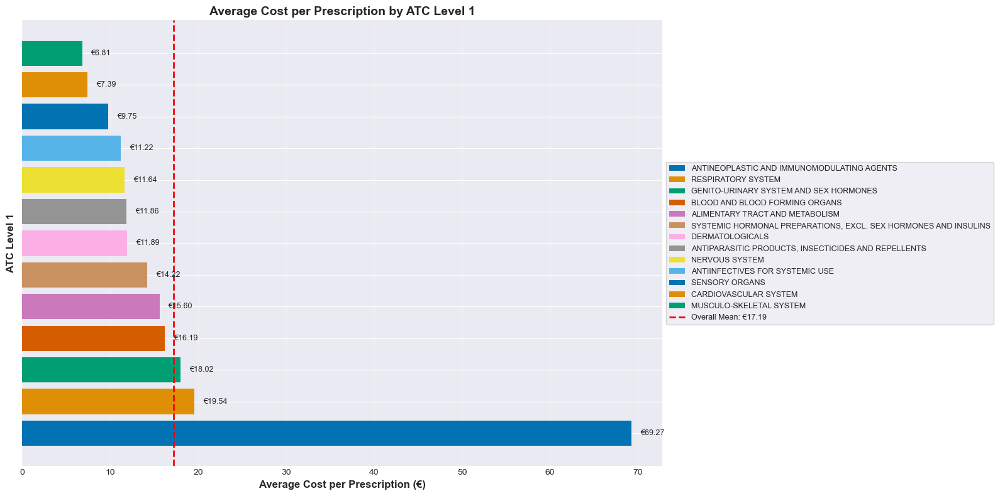

In [25]:
# Average cost per prescription by ATC Level 1
atc1_avg_cost = df.groupby('grup ATC nivell 1').agg({
    'import íntegre': 'sum',
    'nombre de receptes': 'sum'
}).reset_index()

atc1_avg_cost['Avg Cost per Rx'] = atc1_avg_cost['import íntegre'] / atc1_avg_cost['nombre de receptes']
atc1_avg_cost = atc1_avg_cost.sort_values('Avg Cost per Rx', ascending=False)

print("Average Cost per Prescription by ATC Level 1:")
print(atc1_avg_cost[['grup ATC nivell 1', 'Avg Cost per Rx', 'nombre de receptes']])

# Plot
fig, ax = plt.subplots(figsize=(16, 8))
colors = sns.color_palette("colorblind", n_colors=len(atc1_avg_cost))
bars = ax.barh(range(len(atc1_avg_cost)), atc1_avg_cost['Avg Cost per Rx'], color=colors)
ax.set_xlabel('Average Cost per Prescription (€)', fontsize=12, fontweight='bold')
ax.set_ylabel('ATC Level 1', fontsize=12, fontweight='bold')
ax.set_title('Average Cost per Prescription by ATC Level 1', fontsize=14, fontweight='bold')
ax.axvline(x=atc1_avg_cost['Avg Cost per Rx'].mean(), color='red', linestyle='--', linewidth=2, 
           label=f'Overall Mean: €{atc1_avg_cost["Avg Cost per Rx"].mean():.2f}')
ax.set_yticks(range(len(atc1_avg_cost)))
ax.set_yticklabels([])  # Remove y-axis labels
ax.grid(axis='x', alpha=0.3)

# Add cost labels
for i, (idx, row) in enumerate(atc1_avg_cost.iterrows()):
    ax.text(row['Avg Cost per Rx'] + 1, i, f"€{row['Avg Cost per Rx']:.2f}", va='center', fontsize=9)

# Create legend with drug names
legend_elements = [plt.Rectangle((0,0),1,1, fc=colors[i], label=row['grup ATC nivell 1']) 
                   for i, (idx, row) in enumerate(atc1_avg_cost.iterrows())]
legend_elements.append(plt.Line2D([0], [0], color='red', linestyle='--', linewidth=2, 
                                 label=f'Overall Mean: €{atc1_avg_cost["Avg Cost per Rx"].mean():.2f}'))
ax.legend(handles=legend_elements, loc='center left', bbox_to_anchor=(1, 0.5), fontsize=9, frameon=True)

plt.tight_layout()
plt.show()


Average Cost per Prescription - Top 30 ATC Level 2 (by prescription volume):
                                    grup ATC nivell 2  Avg Cost per Rx  nombre de receptes
51                                 IMMUNOSUPPRESSANTS        57.886325             8563026
43                             DRUGS USED IN DIABETES        30.229037            72654753
41              DRUGS FOR OBSTRUCTIVE AIRWAY DISEASES        28.532989            46666651
12                                     ANTIEPILEPTICS        23.820088            29669954
26                              ANTITHROMBOTIC AGENTS        19.666619            64717157
66                         PRODUCTOS DE USO UROLOGICO        19.538883            28497285
69  SEX HORMONES AND MODULATORS OF THE GENITAL SYSTEM        15.969676             9113872
32                                    CARDIAC THERAPY        15.171316            11772677
67                                   PSYCHOANALEPTICS        15.156558            83559531
61          

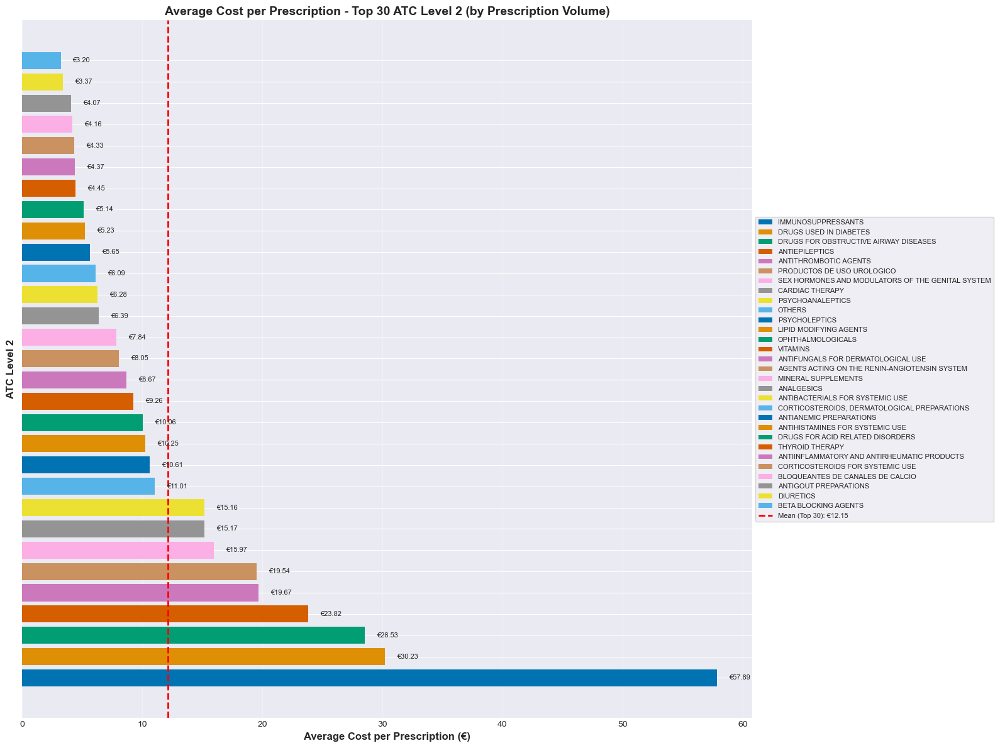

In [26]:
# Average cost per prescription by ATC Level 2 (top 30 by total prescriptions)
atc2_avg_cost = df.groupby('grup ATC nivell 2').agg({
    'import íntegre': 'sum',
    'nombre de receptes': 'sum'
}).reset_index()

atc2_avg_cost['Avg Cost per Rx'] = atc2_avg_cost['import íntegre'] / atc2_avg_cost['nombre de receptes']

# Get top 30 by number of prescriptions
atc2_avg_cost_top = atc2_avg_cost.nlargest(30, 'nombre de receptes').sort_values('Avg Cost per Rx', ascending=False)

print("\nAverage Cost per Prescription - Top 30 ATC Level 2 (by prescription volume):")
print(atc2_avg_cost_top[['grup ATC nivell 2', 'Avg Cost per Rx', 'nombre de receptes']])

# Plot
fig, ax = plt.subplots(figsize=(16, 12))
colors = sns.color_palette("colorblind", n_colors=10)
extended_colors = (colors * 3)[:len(atc2_avg_cost_top)]
bars = ax.barh(range(len(atc2_avg_cost_top)), atc2_avg_cost_top['Avg Cost per Rx'], color=extended_colors)
ax.set_xlabel('Average Cost per Prescription (€)', fontsize=12, fontweight='bold')
ax.set_ylabel('ATC Level 2', fontsize=12, fontweight='bold')
ax.set_title('Average Cost per Prescription - Top 30 ATC Level 2 (by Prescription Volume)', fontsize=14, fontweight='bold')
ax.axvline(x=atc2_avg_cost_top['Avg Cost per Rx'].mean(), color='red', linestyle='--', linewidth=2, 
           label=f'Mean (Top 30): €{atc2_avg_cost_top["Avg Cost per Rx"].mean():.2f}')
ax.set_yticks(range(len(atc2_avg_cost_top)))
ax.set_yticklabels([])
ax.grid(axis='x', alpha=0.3)

# Add cost labels
for i, (idx, row) in enumerate(atc2_avg_cost_top.iterrows()):
    ax.text(row['Avg Cost per Rx'] + 1, i, f"€{row['Avg Cost per Rx']:.2f}", va='center', fontsize=8)

# Create legend
legend_elements = [plt.Rectangle((0,0),1,1, fc=extended_colors[i], label=row['grup ATC nivell 2']) 
                   for i, (idx, row) in enumerate(atc2_avg_cost_top.iterrows())]
legend_elements.append(plt.Line2D([0], [0], color='red', linestyle='--', linewidth=2, 
                                 label=f'Mean (Top 30): €{atc2_avg_cost_top["Avg Cost per Rx"].mean():.2f}'))
ax.legend(handles=legend_elements, loc='center left', bbox_to_anchor=(1, 0.5), fontsize=8, frameon=True)

plt.tight_layout()
plt.show()


Average Cost per Prescription by Sex:
    sexe  Avg Cost per Rx  nombre de receptes
0    Men        13.898201           589717321
1  Women        11.250924           769472522


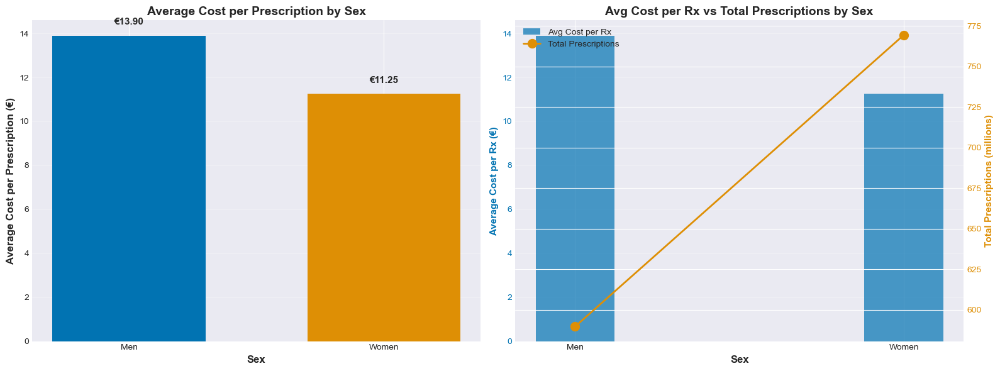

In [27]:
# Average cost per prescription by Sex
sex_avg_cost = df.groupby('sexe').agg({
    'import íntegre': 'sum',
    'nombre de receptes': 'sum'
}).reset_index()

sex_avg_cost['Avg Cost per Rx'] = sex_avg_cost['import íntegre'] / sex_avg_cost['nombre de receptes']

print("\nAverage Cost per Prescription by Sex:")
print(sex_avg_cost[['sexe', 'Avg Cost per Rx', 'nombre de receptes']])

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))
cb_colors = sns.color_palette("colorblind")

# Bar chart
x = np.arange(len(sex_avg_cost))
width = 0.6
bars = ax1.bar(x, sex_avg_cost['Avg Cost per Rx'], width, color=[cb_colors[0], cb_colors[1]])
ax1.set_ylabel('Average Cost per Prescription (€)', fontsize=12, fontweight='bold')
ax1.set_xlabel('Sex', fontsize=12, fontweight='bold')
ax1.set_title('Average Cost per Prescription by Sex', fontsize=14, fontweight='bold')
ax1.set_xticks(x)
ax1.set_xticklabels(sex_avg_cost['sexe'])
ax1.grid(axis='y', alpha=0.3)

# Add value labels
for i, row in sex_avg_cost.iterrows():
    ax1.text(i, row['Avg Cost per Rx'] + 0.5, f'€{row["Avg Cost per Rx"]:.2f}', 
            ha='center', fontweight='bold', fontsize=11)

# Comparison chart with prescription volume
ax2_twin = ax2.twinx()
x2 = np.arange(len(sex_avg_cost))
bars2 = ax2.bar(x2, sex_avg_cost['Avg Cost per Rx'], width*0.4, label='Avg Cost per Rx', color=cb_colors[0], alpha=0.7)
line2 = ax2_twin.plot(x2, sex_avg_cost['nombre de receptes'] / 1_000_000, 'o-', linewidth=2, markersize=10, 
                      label='Total Prescriptions', color=cb_colors[1])
ax2.set_ylabel('Average Cost per Rx (€)', fontsize=11, fontweight='bold', color=cb_colors[0])
ax2_twin.set_ylabel('Total Prescriptions (millions)', fontsize=11, fontweight='bold', color=cb_colors[1])
ax2.set_xlabel('Sex', fontsize=12, fontweight='bold')
ax2.set_title('Avg Cost per Rx vs Total Prescriptions by Sex', fontsize=14, fontweight='bold')
ax2.set_xticks(x2)
ax2.set_xticklabels(sex_avg_cost['sexe'])
ax2.tick_params(axis='y', labelcolor=cb_colors[0])
ax2_twin.tick_params(axis='y', labelcolor=cb_colors[1])
ax2.grid(axis='y', alpha=0.3)

# Combine legends
lines1, labels1 = ax2.get_legend_handles_labels()
lines2, labels2 = ax2_twin.get_legend_handles_labels()
ax2.legend(lines1 + lines2, labels1 + labels2, loc='upper left')

plt.tight_layout()
plt.show()


Average Cost per Prescription by Age Group:
   grup d'edat  Avg Cost per Rx  nombre de receptes
0          0-1         5.103832             5276720
6          2-3         5.329387             4931337
11         4-5         6.696968             4628415
16         6-7         9.381338             4226551
21         8-9        13.394831             4299800
1        10-11        15.018601             4322204
2        12-13        16.838061             4337751
3        14-15        17.452240             4711218
4        16-17        16.028219             5331032
5        18-19        14.705859             5405650
7        20-24        14.235680            14360282
8        25-29        14.086130            16843465
9        30-34        14.308064            22414259
10       35-39        14.289230            32279119
12       40-44        13.845914            47546294
13       45-49        13.448220            64530260
14       50-54        13.012052            82948115
15       55-59     

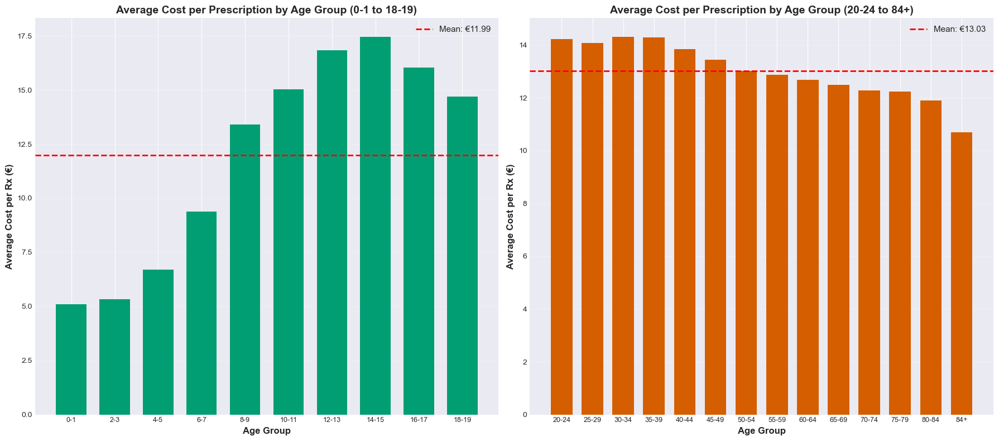

In [28]:
# Average cost per prescription by Age Group
age_avg_cost = df.groupby("grup d'edat").agg({
    'import íntegre': 'sum',
    'nombre de receptes': 'sum'
}).reset_index()

age_avg_cost['Avg Cost per Rx'] = age_avg_cost['import íntegre'] / age_avg_cost['nombre de receptes']
age_avg_cost["grup d'edat"] = pd.Categorical(age_avg_cost["grup d'edat"], categories=age_order, ordered=True)
age_avg_cost = age_avg_cost.sort_values("grup d'edat")

print("\nAverage Cost per Prescription by Age Group:")
print(age_avg_cost[["grup d'edat", 'Avg Cost per Rx', 'nombre de receptes']])

# Split into youth and adult
age_avg_cost_youth = age_avg_cost[age_avg_cost["grup d'edat"].isin(youth_ages)]
age_avg_cost_adult = age_avg_cost[age_avg_cost["grup d'edat"].isin(adult_ages)]

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 8))
cb_colors = sns.color_palette("colorblind")

# Youth subplot
x_youth = np.arange(len(age_avg_cost_youth))
ax1.bar(x_youth, age_avg_cost_youth['Avg Cost per Rx'], 0.7, color=cb_colors[2])
ax1.set_ylabel('Average Cost per Rx (€)', fontsize=12, fontweight='bold')
ax1.set_xlabel('Age Group', fontsize=12, fontweight='bold')
ax1.set_title('Average Cost per Prescription by Age Group (0-1 to 18-19)', fontsize=14, fontweight='bold')
ax1.set_xticks(x_youth)
ax1.set_xticklabels(age_avg_cost_youth["grup d'edat"], rotation=0, ha='center', fontsize=9)
ax1.axhline(y=age_avg_cost_youth['Avg Cost per Rx'].mean(), color='red', linestyle='--', linewidth=2,
           label=f'Mean: €{age_avg_cost_youth["Avg Cost per Rx"].mean():.2f}')
ax1.legend(fontsize=11)
ax1.grid(axis='y', alpha=0.3)

# Adult subplot
x_adult = np.arange(len(age_avg_cost_adult))
ax2.bar(x_adult, age_avg_cost_adult['Avg Cost per Rx'], 0.7, color=cb_colors[3])
ax2.set_ylabel('Average Cost per Rx (€)', fontsize=12, fontweight='bold')
ax2.set_xlabel('Age Group', fontsize=12, fontweight='bold')
ax2.set_title('Average Cost per Prescription by Age Group (20-24 to 84+)', fontsize=14, fontweight='bold')
ax2.set_xticks(x_adult)
ax2.set_xticklabels(age_avg_cost_adult["grup d'edat"], rotation=0, ha='center', fontsize=9)
ax2.axhline(y=age_avg_cost_adult['Avg Cost per Rx'].mean(), color='red', linestyle='--', linewidth=2,
           label=f'Mean: €{age_avg_cost_adult["Avg Cost per Rx"].mean():.2f}')
ax2.legend(fontsize=11)
ax2.grid(axis='y', alpha=0.3)

plt.tight_layout()
plt.show()


Average Cost per Prescription by Sanitary Region:
                 regió sanitària  Avg Cost per Rx  nombre de receptes
2               BARCELONA CIUTAT        13.689081            55563733
4    BARCELONA METROPOLITANA SUD        13.382056            40003072
9                        PENEDÈS        13.228654            16660544
3   BARCELONA METROPOLITANA NORD        12.948769            74164915
5              CAMP DE TARRAGONA        12.661074           102816600
8                         LLEIDA        12.596236            63889256
1                      BARCELONA        12.295760           722817289
6              CATALUNYA CENTRAL        12.112942            93327186
10              TERRES DE L'EBRE        12.096203            36455375
0             ALT PIRINEU i ARAN        11.850238            11698182
7                         GIRONA        11.794745           141793691


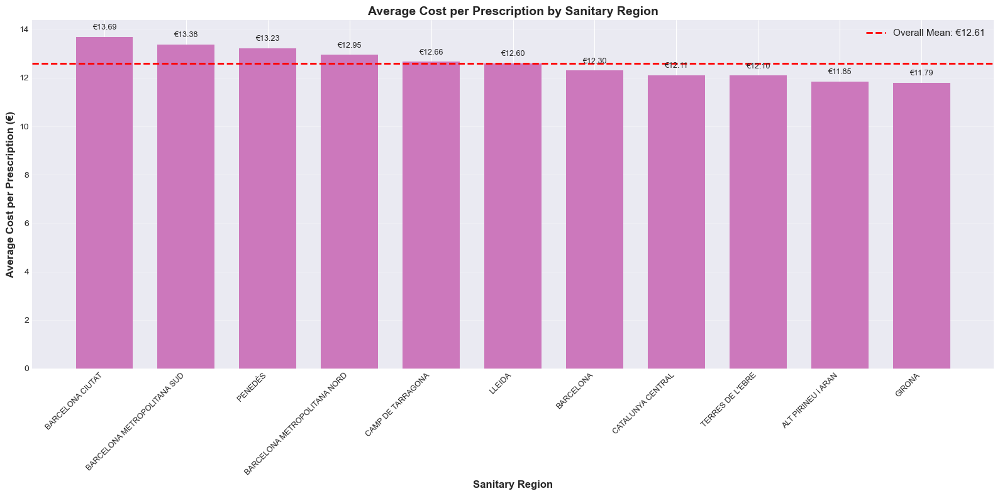

In [29]:
# Average cost per prescription by Sanitary Region
region_avg_cost = df.groupby('regió sanitària').agg({
    'import íntegre': 'sum',
    'nombre de receptes': 'sum'
}).reset_index()

region_avg_cost['Avg Cost per Rx'] = region_avg_cost['import íntegre'] / region_avg_cost['nombre de receptes']
region_avg_cost = region_avg_cost.sort_values('Avg Cost per Rx', ascending=False)

print("\nAverage Cost per Prescription by Sanitary Region:")
print(region_avg_cost[['regió sanitària', 'Avg Cost per Rx', 'nombre de receptes']])

# Plot
fig, ax = plt.subplots(figsize=(16, 8))
x = np.arange(len(region_avg_cost))
cb_colors = sns.color_palette("colorblind")

bars = ax.bar(x, region_avg_cost['Avg Cost per Rx'], 0.7, color=cb_colors[4])
ax.set_ylabel('Average Cost per Prescription (€)', fontsize=12, fontweight='bold')
ax.set_xlabel('Sanitary Region', fontsize=12, fontweight='bold')
ax.set_title('Average Cost per Prescription by Sanitary Region', fontsize=14, fontweight='bold')
ax.set_xticks(x)
ax.set_xticklabels(region_avg_cost['regió sanitària'], rotation=45, ha='right', fontsize=9)
ax.axhline(y=region_avg_cost['Avg Cost per Rx'].mean(), color='red', linestyle='--', linewidth=2,
          label=f'Overall Mean: €{region_avg_cost["Avg Cost per Rx"].mean():.2f}')
ax.legend(fontsize=11)
ax.grid(axis='y', alpha=0.3)

# Add value labels on top
for i, row in region_avg_cost.iterrows():
    ax.text(x[region_avg_cost.index.get_loc(i)], row['Avg Cost per Rx'] + 0.3, 
           f'€{row["Avg Cost per Rx"]:.2f}', ha='center', fontsize=9)

plt.tight_layout()
plt.show()


Average Cost per Prescription by Sanitary Region (excluding Barcelona):
                 regió sanitària  Avg Cost per Rx  nombre de receptes
2               BARCELONA CIUTAT        13.689081            55563733
4    BARCELONA METROPOLITANA SUD        13.382056            40003072
9                        PENEDÈS        13.228654            16660544
3   BARCELONA METROPOLITANA NORD        12.948769            74164915
5              CAMP DE TARRAGONA        12.661074           102816600
8                         LLEIDA        12.596236            63889256
6              CATALUNYA CENTRAL        12.112942            93327186
10              TERRES DE L'EBRE        12.096203            36455375
0             ALT PIRINEU i ARAN        11.850238            11698182
7                         GIRONA        11.794745           141793691


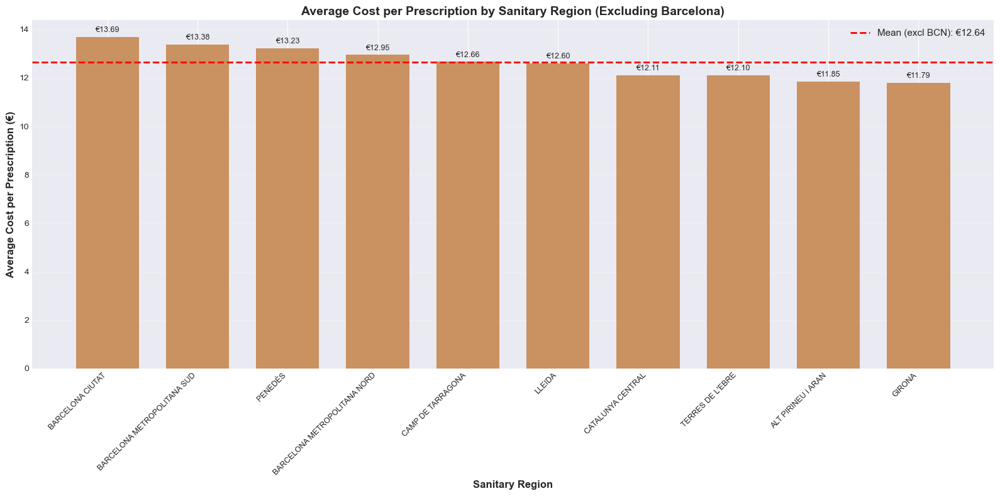

In [30]:
# Average cost per prescription by Sanitary Region (excluding Barcelona)
region_avg_cost_no_bcn = region_avg_cost[region_avg_cost['regió sanitària'] != 'BARCELONA'].copy()

print("\nAverage Cost per Prescription by Sanitary Region (excluding Barcelona):")
print(region_avg_cost_no_bcn[['regió sanitària', 'Avg Cost per Rx', 'nombre de receptes']])

# Plot
fig, ax = plt.subplots(figsize=(16, 8))
x = np.arange(len(region_avg_cost_no_bcn))
cb_colors = sns.color_palette("colorblind")

bars = ax.bar(x, region_avg_cost_no_bcn['Avg Cost per Rx'], 0.7, color=cb_colors[5])
ax.set_ylabel('Average Cost per Prescription (€)', fontsize=12, fontweight='bold')
ax.set_xlabel('Sanitary Region', fontsize=12, fontweight='bold')
ax.set_title('Average Cost per Prescription by Sanitary Region (Excluding Barcelona)', fontsize=14, fontweight='bold')
ax.set_xticks(x)
ax.set_xticklabels(region_avg_cost_no_bcn['regió sanitària'], rotation=45, ha='right', fontsize=9)
ax.axhline(y=region_avg_cost_no_bcn['Avg Cost per Rx'].mean(), color='red', linestyle='--', linewidth=2,
          label=f'Mean (excl BCN): €{region_avg_cost_no_bcn["Avg Cost per Rx"].mean():.2f}')
ax.legend(fontsize=11)
ax.grid(axis='y', alpha=0.3)

# Add value labels
for i, (idx, row) in enumerate(region_avg_cost_no_bcn.iterrows()):
    ax.text(i, row['Avg Cost per Rx'] + 0.2, f'€{row["Avg Cost per Rx"]:.2f}', ha='center', fontsize=9)

plt.tight_layout()
plt.show()

### Comparative Analysis: Average Cost per Prescription by Demographics and ATC Groups

Average Cost per Prescription by Sex and ATC Level 1:
sexe                                                      Men      Women
grup ATC nivell 1                                                       
ANTINEOPLASTIC AND IMMUNOMODULATING AGENTS          76.627541  64.376730
RESPIRATORY SYSTEM                                  22.184927  17.204466
GENITO-URINARY SYSTEM AND SEX HORMONES              18.006754  18.045381
ALIMENTARY TRACT AND METABOLISM                     17.913334  13.769312
BLOOD AND BLOOD FORMING ORGANS                      16.185778  16.203474
SYSTEMIC HORMONAL PREPARATIONS, EXCL. SEX HORMO...  15.871948  13.523554
NERVOUS SYSTEM                                      14.528977  10.146419
DERMATOLOGICALS                                     13.084526  10.897453
ANTIPARASITIC PRODUCTS, INSECTICIDES AND REPELL...  12.404691  11.555441
ANTIINFECTIVES FOR SYSTEMIC USE                     12.151848  10.545662
SENSORY ORGANS                                      10.072894   9.5061

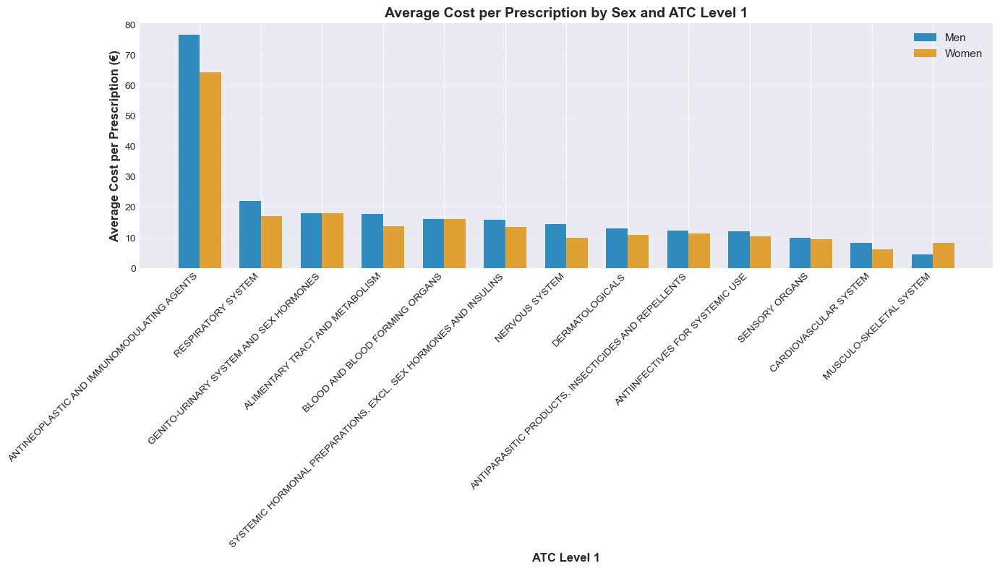

In [31]:
# Average cost per prescription: Sex x ATC Level 1
sex_atc1_avg = df.groupby(['grup ATC nivell 1', 'sexe']).agg({
    'import íntegre': 'sum',
    'nombre de receptes': 'sum'
}).reset_index()

sex_atc1_avg['Avg Cost per Rx'] = sex_atc1_avg['import íntegre'] / sex_atc1_avg['nombre de receptes']
sex_atc1_avg_pivot = sex_atc1_avg.pivot(index='grup ATC nivell 1', columns='sexe', values='Avg Cost per Rx')
sex_atc1_avg_pivot = sex_atc1_avg_pivot.sort_values(by=sex_atc1_avg_pivot.columns[0], ascending=False)

print("Average Cost per Prescription by Sex and ATC Level 1:")
print(sex_atc1_avg_pivot)

# Plot
fig, ax = plt.subplots(figsize=(14, 8))
x = np.arange(len(sex_atc1_avg_pivot))
width = 0.35
cb_colors = sns.color_palette("colorblind")

sexes = sex_atc1_avg_pivot.columns
for i, sex in enumerate(sexes):
    ax.bar(x + i*width, sex_atc1_avg_pivot[sex], width, label=sex, color=cb_colors[i], alpha=0.8)

ax.set_ylabel('Average Cost per Prescription (€)', fontsize=12, fontweight='bold')
ax.set_xlabel('ATC Level 1', fontsize=12, fontweight='bold')
ax.set_title('Average Cost per Prescription by Sex and ATC Level 1', fontsize=14, fontweight='bold')
ax.set_xticks(x + width / 2)
ax.set_xticklabels(sex_atc1_avg_pivot.index, rotation=45, ha='right')
ax.legend(fontsize=11)
ax.grid(axis='y', alpha=0.3)

plt.tight_layout()
plt.show()

Average Cost per Prescription by Age Group and ATC Level 1:
grup ATC nivell 1  ANTINEOPLASTIC AND IMMUNOMODULATING AGENTS  CARDIOVASCULAR SYSTEM  ALIMENTARY TRACT AND METABOLISM  RESPIRATORY SYSTEM  \
grup d'edat                                                                                                                                 
0-1                                                 64.732049              83.593111                         7.877633            5.881259   
2-3                                                 51.234939              43.763324                         6.816379            8.266315   
4-5                                                 53.914891              38.202053                         9.225047           10.176572   
6-7                                                 75.322383              39.769433                        11.644351           11.063172   
8-9                                                109.183951              47.898805          

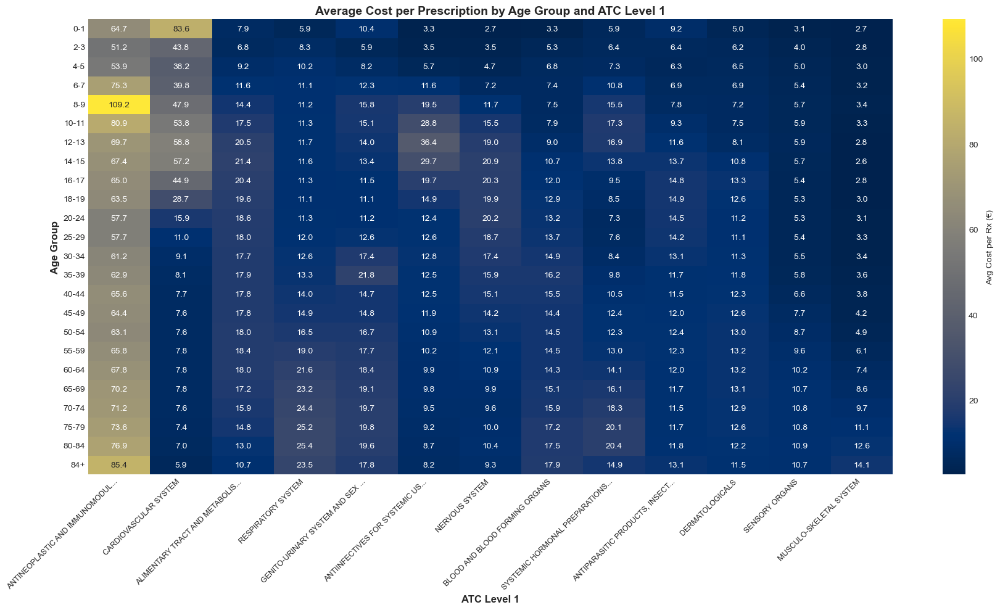

In [32]:
# Average cost per prescription: Age x ATC Level 1 (heatmap)
age_atc1_avg = df.groupby(["grup d'edat", 'grup ATC nivell 1']).agg({
    'import íntegre': 'sum',
    'nombre de receptes': 'sum'
}).reset_index()

age_atc1_avg['Avg Cost per Rx'] = age_atc1_avg['import íntegre'] / age_atc1_avg['nombre de receptes']
age_atc1_avg["grup d'edat"] = pd.Categorical(age_atc1_avg["grup d'edat"], categories=age_order, ordered=True)
age_atc1_avg = age_atc1_avg.sort_values("grup d'edat")

print("Average Cost per Prescription by Age Group and ATC Level 1:")

# Create heatmap
pivot_avg = age_atc1_avg.pivot(index="grup d'edat", columns='grup ATC nivell 1', values='Avg Cost per Rx')
column_order_avg = pivot_avg.mean().sort_values(ascending=False).index
pivot_avg = pivot_avg[column_order_avg]
print(pivot_avg)

fig, ax = plt.subplots(figsize=(18, 10))
abbreviated_cols_avg = [col[:30] + '...' if len(col) > 30 else col for col in pivot_avg.columns]
sns.heatmap(pivot_avg, annot=True, fmt='.1f', cmap='cividis', cbar_kws={'label': 'Avg Cost per Rx (€)'}, 
            ax=ax, xticklabels=abbreviated_cols_avg)
ax.set_title('Average Cost per Prescription by Age Group and ATC Level 1', fontsize=14, fontweight='bold')
ax.set_xlabel('ATC Level 1', fontsize=12, fontweight='bold')
ax.set_ylabel('Age Group', fontsize=12, fontweight='bold')
plt.setp(ax.get_xticklabels(), rotation=45, ha='right', fontsize=9)
plt.tight_layout()
plt.show()

Average Cost per Prescription by Sanitary Region and ATC Level 1:
grup ATC nivell 1             ANTINEOPLASTIC AND IMMUNOMODULATING AGENTS  RESPIRATORY SYSTEM  GENITO-URINARY SYSTEM AND SEX HORMONES  \
regió sanitària                                                                                                                        
BARCELONA CIUTAT                                               75.714842           18.883490                               16.290875   
BARCELONA METROPOLITANA SUD                                    70.643230           18.567703                               16.440909   
PENEDÈS                                                        73.404208           18.338672                               16.034622   
BARCELONA METROPOLITANA NORD                                   70.755140           18.304844                               15.909503   
BARCELONA                                                      68.426683           19.867492                          

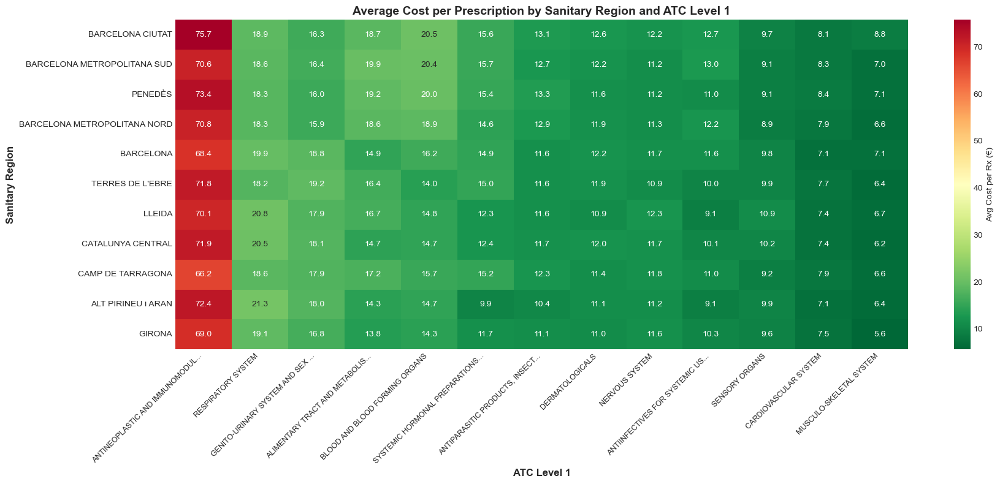

In [33]:
# Average cost per prescription: Region x ATC Level 1 (heatmap)
region_atc1_avg = df.groupby(['regió sanitària', 'grup ATC nivell 1']).agg({
    'import íntegre': 'sum',
    'nombre de receptes': 'sum'
}).reset_index()

region_atc1_avg['Avg Cost per Rx'] = region_atc1_avg['import íntegre'] / region_atc1_avg['nombre de receptes']

print("Average Cost per Prescription by Sanitary Region and ATC Level 1:")

# Create heatmap
pivot_region_avg = region_atc1_avg.pivot(index='regió sanitària', columns='grup ATC nivell 1', values='Avg Cost per Rx')
column_order_region_avg = pivot_region_avg.mean().sort_values(ascending=False).index
pivot_region_avg = pivot_region_avg[column_order_region_avg]

# Sort rows by average
pivot_region_avg['Row_Avg'] = pivot_region_avg.mean(axis=1)
pivot_region_avg = pivot_region_avg.sort_values('Row_Avg', ascending=False).drop('Row_Avg', axis=1)
print(pivot_region_avg)

fig, ax = plt.subplots(figsize=(18, 8))
abbreviated_cols_region_avg = [col[:30] + '...' if len(col) > 30 else col for col in pivot_region_avg.columns]
sns.heatmap(pivot_region_avg, annot=True, fmt='.1f', cmap='RdYlGn_r', cbar_kws={'label': 'Avg Cost per Rx (€)'}, 
            ax=ax, xticklabels=abbreviated_cols_region_avg)
ax.set_title('Average Cost per Prescription by Sanitary Region and ATC Level 1', fontsize=14, fontweight='bold')
ax.set_xlabel('ATC Level 1', fontsize=12, fontweight='bold')
ax.set_ylabel('Sanitary Region', fontsize=12, fontweight='bold')
plt.setp(ax.get_xticklabels(), rotation=45, ha='right', fontsize=9)
plt.tight_layout()
plt.show()

In [34]:
# Summary statistics for average cost per prescription
print("="*80)
print("AVERAGE COST PER PRESCRIPTION SUMMARY")
print("="*80)

overall_avg_cost = df['import íntegre'].sum() / df['nombre de receptes'].sum()
print(f"\nOverall Average Cost per Prescription: €{overall_avg_cost:.2f}")

print(f"\nBy Sex:")
for idx, row in sex_avg_cost.iterrows():
    print(f"  {row['sexe']}: €{row['Avg Cost per Rx']:.2f}")

print(f"\nBy ATC Level 1 (Top 5 Most Expensive):")
for idx, row in atc1_avg_cost.head(5).iterrows():
    print(f"  {row['grup ATC nivell 1'][:50]}: €{row['Avg Cost per Rx']:.2f}")

print(f"\nBy ATC Level 1 (Top 5 Least Expensive):")
for idx, row in atc1_avg_cost.tail(5).iterrows():
    print(f"  {row['grup ATC nivell 1'][:50]}: €{row['Avg Cost per Rx']:.2f}")

print(f"\nBy Age Group:")
print(f"  Youth (0-19): €{age_avg_cost_youth['Avg Cost per Rx'].mean():.2f}")
print(f"  Adult (20+): €{age_avg_cost_adult['Avg Cost per Rx'].mean():.2f}")
print(f"  Highest: {age_avg_cost.loc[age_avg_cost['Avg Cost per Rx'].idxmax(), 'grup d' + chr(39) + 'edat']} " + 
      f"(€{age_avg_cost['Avg Cost per Rx'].max():.2f})")
print(f"  Lowest: {age_avg_cost.loc[age_avg_cost['Avg Cost per Rx'].idxmin(), 'grup d' + chr(39) + 'edat']} " + 
      f"(€{age_avg_cost['Avg Cost per Rx'].min():.2f})")

print(f"\nBy Sanitary Region:")
print(f"  Highest: {region_avg_cost.iloc[0]['regió sanitària']} (€{region_avg_cost.iloc[0]['Avg Cost per Rx']:.2f})")
print(f"  Lowest: {region_avg_cost.iloc[-1]['regió sanitària']} (€{region_avg_cost.iloc[-1]['Avg Cost per Rx']:.2f})")
print(f"  Range: €{region_avg_cost['Avg Cost per Rx'].max() - region_avg_cost['Avg Cost per Rx'].min():.2f}")

print("\n" + "="*80)

AVERAGE COST PER PRESCRIPTION SUMMARY

Overall Average Cost per Prescription: €12.40

By Sex:
  Men: €13.90
  Women: €11.25

By ATC Level 1 (Top 5 Most Expensive):
  ANTINEOPLASTIC AND IMMUNOMODULATING AGENTS: €69.27
  RESPIRATORY SYSTEM: €19.54
  GENITO-URINARY SYSTEM AND SEX HORMONES: €18.02
  BLOOD AND BLOOD FORMING ORGANS: €16.19
  ALIMENTARY TRACT AND METABOLISM: €15.60

By ATC Level 1 (Top 5 Least Expensive):
  NERVOUS SYSTEM: €11.64
  ANTIINFECTIVES FOR SYSTEMIC USE: €11.22
  SENSORY ORGANS: €9.75
  CARDIOVASCULAR SYSTEM: €7.39
  MUSCULO-SKELETAL SYSTEM: €6.81

By Age Group:
  Youth (0-19): €11.99
  Adult (20+): €13.03
  Highest: 14-15 (€17.45)
  Lowest: 0-1 (€5.10)

By Sanitary Region:
  Highest: BARCELONA CIUTAT (€13.69)
  Lowest: GIRONA (€11.79)
  Range: €1.89



## 9. Prescription Volume Analysis

This section analyzes the **number of prescriptions** across different categories to understand prescription patterns.

Number of Prescriptions by ATC Level 1:
                                    grup ATC nivell 1  nombre de receptes  Percentage
9                                      NERVOUS SYSTEM           395284931   29.082393
5                               CARDIOVASCULAR SYSTEM           348982484   25.675772
0                     ALIMENTARY TRACT AND METABOLISM           200484132   14.750267
4                      BLOOD AND BLOOD FORMING ORGANS            85541523    6.293567
10                                 RESPIRATORY SYSTEM            78242418    5.756548
8                             MUSCULO-SKELETAL SYSTEM            66877188    4.920371
1                     ANTIINFECTIVES FOR SYSTEMIC USE            42308975    3.112808
7              GENITO-URINARY SYSTEM AND SEX HORMONES            40052190    2.946769
11                                     SENSORY ORGANS            33114951    2.436374
12  SYSTEMIC HORMONAL PREPARATIONS, EXCL. SEX HORM...            26273580    1.933032
6             

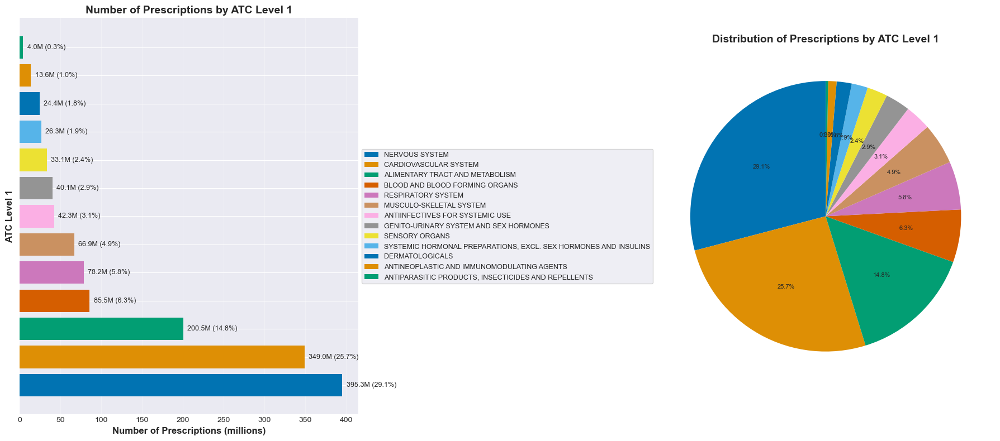

In [35]:
# Number of prescriptions by ATC Level 1
atc1_rx_count = df.groupby('grup ATC nivell 1').agg({
    'nombre de receptes': 'sum',
    'import íntegre': 'sum'
}).reset_index()

atc1_rx_count = atc1_rx_count.sort_values('nombre de receptes', ascending=False)
atc1_rx_count['Percentage'] = (atc1_rx_count['nombre de receptes'] / atc1_rx_count['nombre de receptes'].sum()) * 100

print("Number of Prescriptions by ATC Level 1:")
print(atc1_rx_count[['grup ATC nivell 1', 'nombre de receptes', 'Percentage']])

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 8))
colors = sns.color_palette("colorblind", n_colors=len(atc1_rx_count))

# Bar chart
bars = ax1.barh(range(len(atc1_rx_count)), atc1_rx_count['nombre de receptes'] / 1_000_000, color=colors)
ax1.set_xlabel('Number of Prescriptions (millions)', fontsize=12, fontweight='bold')
ax1.set_ylabel('ATC Level 1', fontsize=12, fontweight='bold')
ax1.set_title('Number of Prescriptions by ATC Level 1', fontsize=14, fontweight='bold')
ax1.set_yticks(range(len(atc1_rx_count)))
ax1.set_yticklabels([])
ax1.grid(axis='x', alpha=0.3)

# Add count labels
for i, (idx, row) in enumerate(atc1_rx_count.iterrows()):
    ax1.text(row['nombre de receptes'] / 1_000_000 + 5, i, 
            f"{row['nombre de receptes']/1_000_000:.1f}M ({row['Percentage']:.1f}%)", 
            va='center', fontsize=9)

# Pie chart
ax2.pie(atc1_rx_count['nombre de receptes'], labels=None, 
        autopct='%1.1f%%', startangle=90, colors=colors, textprops={'fontsize': 8})
ax2.set_title('Distribution of Prescriptions by ATC Level 1', fontsize=14, fontweight='bold')

# Legend for bar chart
legend_elements = [plt.Rectangle((0,0),1,1, fc=colors[i], label=row['grup ATC nivell 1']) 
                   for i, (idx, row) in enumerate(atc1_rx_count.iterrows())]
ax1.legend(handles=legend_elements, loc='center left', bbox_to_anchor=(1, 0.5), fontsize=9, frameon=True)

plt.tight_layout()
plt.show()


Number of Prescriptions - Top 30 ATC Level 2:
                                    grup ATC nivell 2  nombre de receptes  Percentage
2                                          ANALGESICS           149523987   11.000964
0       AGENTS ACTING ON THE RENIN-ANGIOTENSIN SYSTEM           116175357    8.547397
68                                      PSYCHOLEPTICS           116003609    8.534761
52                             LIPID MODIFYING AGENTS            92683465    6.819023
67                                   PSYCHOANALEPTICS            83559531    6.147745
38                   DRUGS FOR ACID RELATED DISORDERS            80656503    5.934160
43                             DRUGS USED IN DIABETES            72654753    5.345446
26                              ANTITHROMBOTIC AGENTS            64717157    4.761451
37                                          DIURETICS            47460288    3.491807
41              DRUGS FOR OBSTRUCTIVE AIRWAY DISEASES            46666651    3.433417
18     

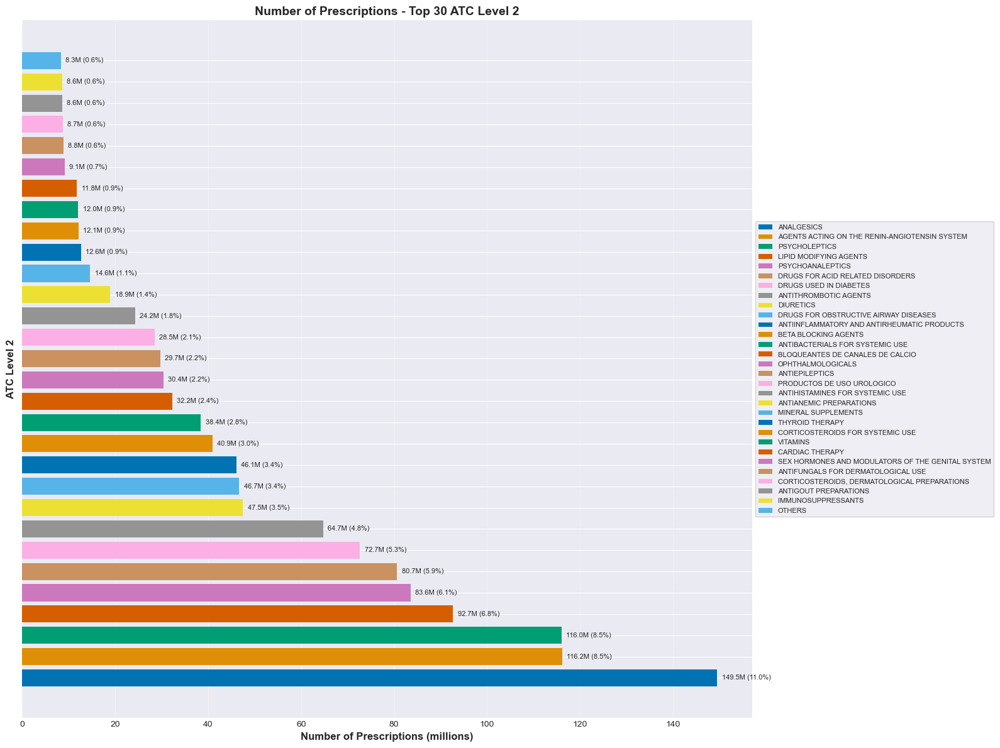

In [36]:
# Number of prescriptions by ATC Level 2 (top 30)
atc2_rx_count = df.groupby('grup ATC nivell 2').agg({
    'nombre de receptes': 'sum',
    'import íntegre': 'sum'
}).reset_index()

atc2_rx_count_top = atc2_rx_count.nlargest(30, 'nombre de receptes')
atc2_rx_count_top['Percentage'] = (atc2_rx_count_top['nombre de receptes'] / df['nombre de receptes'].sum()) * 100

print("\nNumber of Prescriptions - Top 30 ATC Level 2:")
print(atc2_rx_count_top[['grup ATC nivell 2', 'nombre de receptes', 'Percentage']])

# Plot
fig, ax = plt.subplots(figsize=(16, 12))
colors = sns.color_palette("colorblind", n_colors=10)
extended_colors = (colors * 3)[:len(atc2_rx_count_top)]

bars = ax.barh(range(len(atc2_rx_count_top)), atc2_rx_count_top['nombre de receptes'] / 1_000_000, 
               color=extended_colors)
ax.set_xlabel('Number of Prescriptions (millions)', fontsize=12, fontweight='bold')
ax.set_ylabel('ATC Level 2', fontsize=12, fontweight='bold')
ax.set_title('Number of Prescriptions - Top 30 ATC Level 2', fontsize=14, fontweight='bold')
ax.set_yticks(range(len(atc2_rx_count_top)))
ax.set_yticklabels([])
ax.grid(axis='x', alpha=0.3)

# Add count labels
for i, (idx, row) in enumerate(atc2_rx_count_top.iterrows()):
    ax.text(row['nombre de receptes'] / 1_000_000 + 1, i, 
            f"{row['nombre de receptes']/1_000_000:.1f}M ({row['Percentage']:.1f}%)", 
            va='center', fontsize=8)

# Legend
legend_elements = [plt.Rectangle((0,0),1,1, fc=extended_colors[i], label=row['grup ATC nivell 2']) 
                   for i, (idx, row) in enumerate(atc2_rx_count_top.iterrows())]
ax.legend(handles=legend_elements, loc='center left', bbox_to_anchor=(1, 0.5), fontsize=8, frameon=True)

plt.tight_layout()
plt.show()


Number of Prescriptions by Sex:
    sexe  nombre de receptes  Percentage
0    Men           589717321   43.387414
1  Women           769472522   56.612586


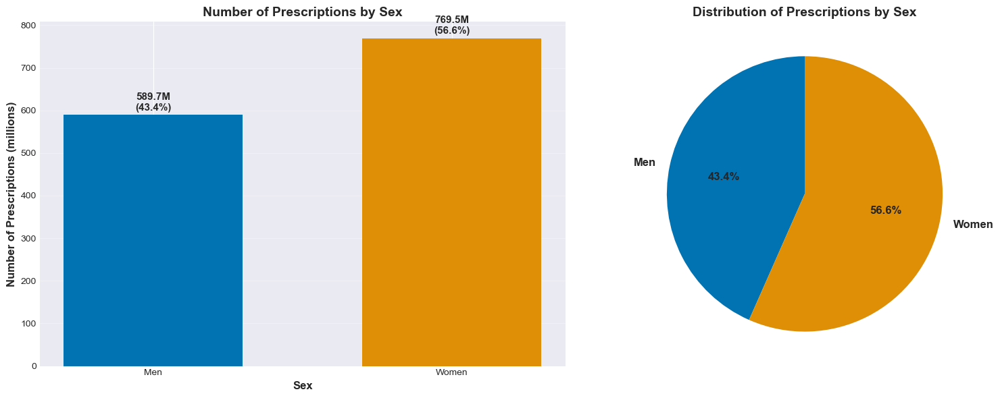

In [37]:
# Number of prescriptions by Sex
sex_rx_count = df.groupby('sexe').agg({
    'nombre de receptes': 'sum',
    'import íntegre': 'sum'
}).reset_index()

sex_rx_count['Percentage'] = (sex_rx_count['nombre de receptes'] / sex_rx_count['nombre de receptes'].sum()) * 100

print("\nNumber of Prescriptions by Sex:")
print(sex_rx_count[['sexe', 'nombre de receptes', 'Percentage']])

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))
cb_colors = sns.color_palette("colorblind")

# Bar chart
x = np.arange(len(sex_rx_count))
width = 0.6
bars = ax1.bar(x, sex_rx_count['nombre de receptes'] / 1_000_000, width, 
              color=[cb_colors[0], cb_colors[1]])
ax1.set_ylabel('Number of Prescriptions (millions)', fontsize=12, fontweight='bold')
ax1.set_xlabel('Sex', fontsize=12, fontweight='bold')
ax1.set_title('Number of Prescriptions by Sex', fontsize=14, fontweight='bold')
ax1.set_xticks(x)
ax1.set_xticklabels(sex_rx_count['sexe'])
ax1.grid(axis='y', alpha=0.3)

# Add value labels
for i, row in sex_rx_count.iterrows():
    ax1.text(i, row['nombre de receptes'] / 1_000_000 + 10, 
            f"{row['nombre de receptes']/1_000_000:.1f}M\n({row['Percentage']:.1f}%)", 
            ha='center', fontweight='bold', fontsize=11)

# Pie chart
ax2.pie(sex_rx_count['nombre de receptes'], labels=sex_rx_count['sexe'], autopct='%1.1f%%', 
        startangle=90, colors=[cb_colors[0], cb_colors[1]], 
        textprops={'fontsize': 12, 'fontweight': 'bold'})
ax2.set_title('Distribution of Prescriptions by Sex', fontsize=14, fontweight='bold')

plt.tight_layout()
plt.show()


Number of Prescriptions by Age Group:
   grup d'edat  nombre de receptes  Percentage
0          0-1             5276720    0.388225
6          2-3             4931337    0.362814
11         4-5             4628415    0.340527
16         6-7             4226551    0.310961
21         8-9             4299800    0.316350
1        10-11             4322204    0.317999
2        12-13             4337751    0.319142
3        14-15             4711218    0.346620
4        16-17             5331032    0.392221
5        18-19             5405650    0.397711
7        20-24            14360282    1.056532
8        25-29            16843465    1.239228
9        30-34            22414259    1.649090
10       35-39            32279119    2.374879
12       40-44            47546294    3.498135
13       45-49            64530260    4.747700
14       50-54            82948115    6.102762
15       55-59           104294973    7.673319
17       60-64           125065184    9.201451
18       65-69       

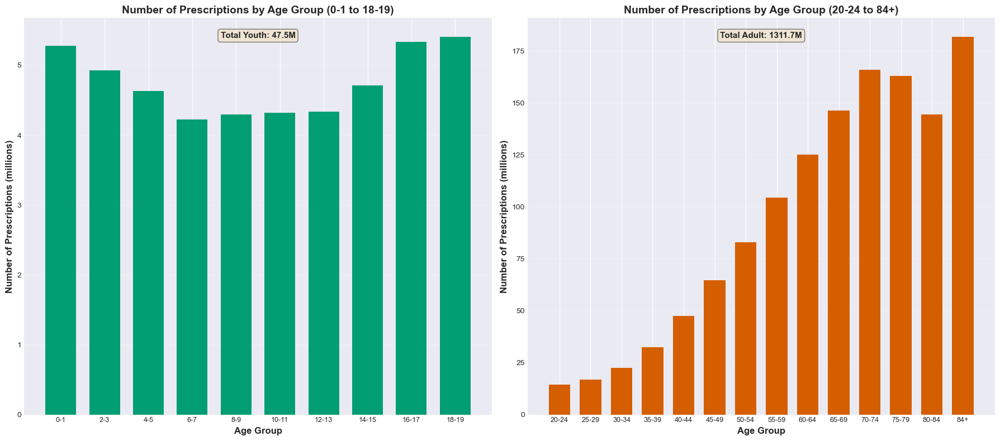

In [38]:
# Number of prescriptions by Age Group
age_rx_count = df.groupby("grup d'edat").agg({
    'nombre de receptes': 'sum',
    'import íntegre': 'sum'
}).reset_index()

age_rx_count["grup d'edat"] = pd.Categorical(age_rx_count["grup d'edat"], categories=age_order, ordered=True)
age_rx_count = age_rx_count.sort_values("grup d'edat")
age_rx_count['Percentage'] = (age_rx_count['nombre de receptes'] / age_rx_count['nombre de receptes'].sum()) * 100

print("\nNumber of Prescriptions by Age Group:")
print(age_rx_count[["grup d'edat", 'nombre de receptes', 'Percentage']])

# Split into youth and adult
age_rx_count_youth = age_rx_count[age_rx_count["grup d'edat"].isin(youth_ages)]
age_rx_count_adult = age_rx_count[age_rx_count["grup d'edat"].isin(adult_ages)]

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 8))
cb_colors = sns.color_palette("colorblind")

# Youth subplot
x_youth = np.arange(len(age_rx_count_youth))
ax1.bar(x_youth, age_rx_count_youth['nombre de receptes'] / 1_000_000, 0.7, color=cb_colors[2])
ax1.set_ylabel('Number of Prescriptions (millions)', fontsize=12, fontweight='bold')
ax1.set_xlabel('Age Group', fontsize=12, fontweight='bold')
ax1.set_title('Number of Prescriptions by Age Group (0-1 to 18-19)', fontsize=14, fontweight='bold')
ax1.set_xticks(x_youth)
ax1.set_xticklabels(age_rx_count_youth["grup d'edat"], rotation=0, ha='center', fontsize=9)
ax1.grid(axis='y', alpha=0.3)

# Add total
total_youth = age_rx_count_youth['nombre de receptes'].sum()
ax1.text(0.5, 0.95, f'Total Youth: {total_youth/1_000_000:.1f}M', 
        transform=ax1.transAxes, ha='center', fontsize=11, fontweight='bold',
        bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

# Adult subplot
x_adult = np.arange(len(age_rx_count_adult))
ax2.bar(x_adult, age_rx_count_adult['nombre de receptes'] / 1_000_000, 0.7, color=cb_colors[3])
ax2.set_ylabel('Number of Prescriptions (millions)', fontsize=12, fontweight='bold')
ax2.set_xlabel('Age Group', fontsize=12, fontweight='bold')
ax2.set_title('Number of Prescriptions by Age Group (20-24 to 84+)', fontsize=14, fontweight='bold')
ax2.set_xticks(x_adult)
ax2.set_xticklabels(age_rx_count_adult["grup d'edat"], rotation=0, ha='center', fontsize=9)
ax2.grid(axis='y', alpha=0.3)

# Add total
total_adult = age_rx_count_adult['nombre de receptes'].sum()
ax2.text(0.5, 0.95, f'Total Adult: {total_adult/1_000_000:.1f}M', 
        transform=ax2.transAxes, ha='center', fontsize=11, fontweight='bold',
        bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

plt.tight_layout()
plt.show()


Number of Prescriptions by Sanitary Region:
                 regió sanitària  nombre de receptes  Percentage
1                      BARCELONA           722817289   53.180010
7                         GIRONA           141793691   10.432221
5              CAMP DE TARRAGONA           102816600    7.564550
6              CATALUNYA CENTRAL            93327186    6.866383
3   BARCELONA METROPOLITANA NORD            74164915    5.456553
8                         LLEIDA            63889256    4.700540
2               BARCELONA CIUTAT            55563733    4.088004
4    BARCELONA METROPOLITANA SUD            40003072    2.943156
10              TERRES DE L'EBRE            36455375    2.682140
9                        PENEDÈS            16660544    1.225770
0             ALT PIRINEU i ARAN            11698182    0.860673


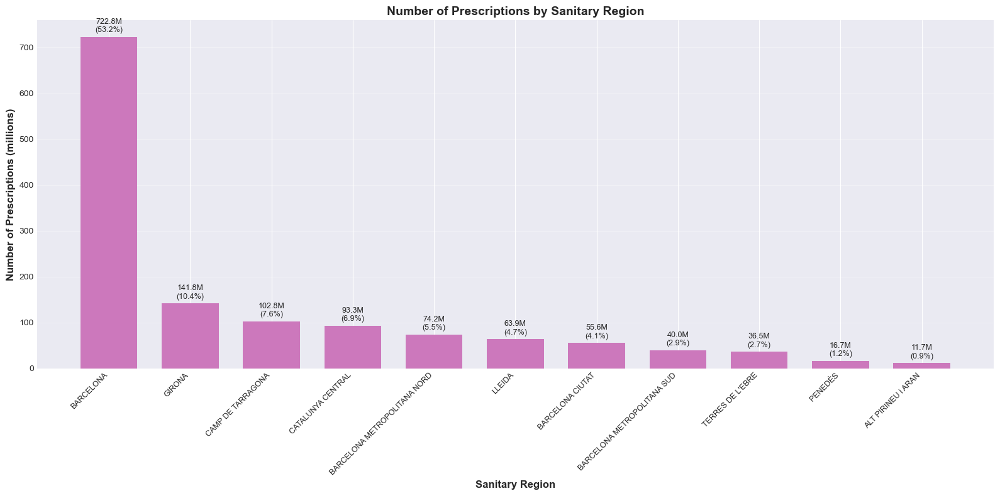

In [39]:
# Number of prescriptions by Sanitary Region
region_rx_count = df.groupby('regió sanitària').agg({
    'nombre de receptes': 'sum',
    'import íntegre': 'sum'
}).reset_index()

region_rx_count = region_rx_count.sort_values('nombre de receptes', ascending=False)
region_rx_count['Percentage'] = (region_rx_count['nombre de receptes'] / region_rx_count['nombre de receptes'].sum()) * 100

print("\nNumber of Prescriptions by Sanitary Region:")
print(region_rx_count[['regió sanitària', 'nombre de receptes', 'Percentage']])

# Plot
fig, ax = plt.subplots(figsize=(16, 8))
x = np.arange(len(region_rx_count))
cb_colors = sns.color_palette("colorblind")

bars = ax.bar(x, region_rx_count['nombre de receptes'] / 1_000_000, 0.7, color=cb_colors[4])
ax.set_ylabel('Number of Prescriptions (millions)', fontsize=12, fontweight='bold')
ax.set_xlabel('Sanitary Region', fontsize=12, fontweight='bold')
ax.set_title('Number of Prescriptions by Sanitary Region', fontsize=14, fontweight='bold')
ax.set_xticks(x)
ax.set_xticklabels(region_rx_count['regió sanitària'], rotation=45, ha='right', fontsize=9)
ax.grid(axis='y', alpha=0.3)

# Add value labels
for i, row in region_rx_count.iterrows():
    ax.text(x[region_rx_count.index.get_loc(i)], row['nombre de receptes'] / 1_000_000 + 10, 
           f"{row['nombre de receptes']/1_000_000:.1f}M\n({row['Percentage']:.1f}%)", 
           ha='center', fontsize=9)

plt.tight_layout()
plt.show()


Number of Prescriptions by Sanitary Region (excluding Barcelona):
                 regió sanitària  nombre de receptes  Percentage
7                         GIRONA           141793691   10.432221
5              CAMP DE TARRAGONA           102816600    7.564550
6              CATALUNYA CENTRAL            93327186    6.866383
3   BARCELONA METROPOLITANA NORD            74164915    5.456553
8                         LLEIDA            63889256    4.700540
2               BARCELONA CIUTAT            55563733    4.088004
4    BARCELONA METROPOLITANA SUD            40003072    2.943156
10              TERRES DE L'EBRE            36455375    2.682140
9                        PENEDÈS            16660544    1.225770
0             ALT PIRINEU i ARAN            11698182    0.860673


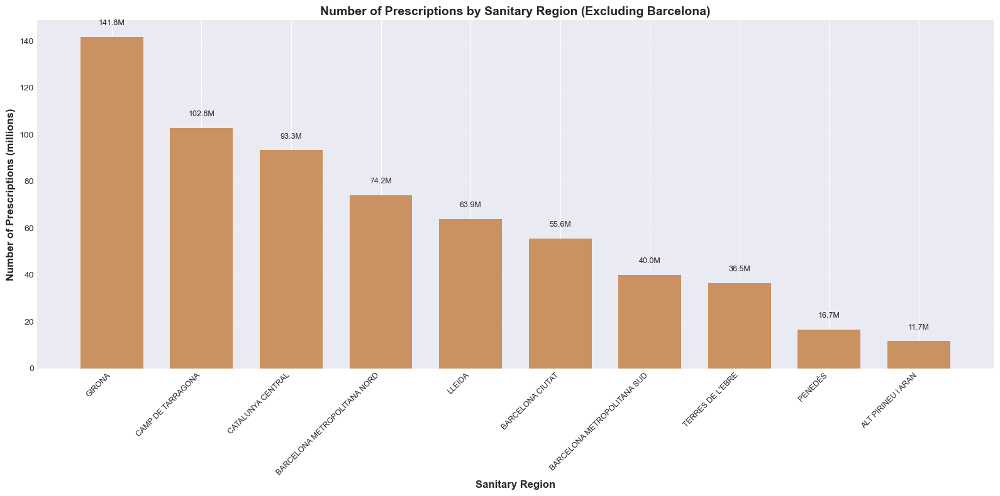

In [40]:
# Number of prescriptions by Sanitary Region (excluding Barcelona)
region_rx_count_no_bcn = region_rx_count[region_rx_count['regió sanitària'] != 'BARCELONA']

print("\nNumber of Prescriptions by Sanitary Region (excluding Barcelona):")
print(region_rx_count_no_bcn[['regió sanitària', 'nombre de receptes', 'Percentage']])

# Plot
fig, ax = plt.subplots(figsize=(16, 8))
x = np.arange(len(region_rx_count_no_bcn))
cb_colors = sns.color_palette("colorblind")

bars = ax.bar(x, region_rx_count_no_bcn['nombre de receptes'] / 1_000_000, 0.7, color=cb_colors[5])
ax.set_ylabel('Number of Prescriptions (millions)', fontsize=12, fontweight='bold')
ax.set_xlabel('Sanitary Region', fontsize=12, fontweight='bold')
ax.set_title('Number of Prescriptions by Sanitary Region (Excluding Barcelona)', fontsize=14, fontweight='bold')
ax.set_xticks(x)
ax.set_xticklabels(region_rx_count_no_bcn['regió sanitària'], rotation=45, ha='right', fontsize=9)
ax.grid(axis='y', alpha=0.3)

# Add value labels
for i, (idx, row) in enumerate(region_rx_count_no_bcn.iterrows()):
    ax.text(i, row['nombre de receptes'] / 1_000_000 + 5, 
           f"{row['nombre de receptes']/1_000_000:.1f}M", ha='center', fontsize=9)

plt.tight_layout()
plt.show()

### Comparative Analysis: Prescription Volume by Demographics and ATC Groups

Number of Prescriptions by Sex and ATC Level 1 (in millions):
sexe                                                       Men       Women
grup ATC nivell 1                                                         
CARDIOVASCULAR SYSTEM                               175.776733  173.205751
NERVOUS SYSTEM                                      134.987212  260.297719
ALIMENTARY TRACT AND METABOLISM                      88.516366  111.967766
BLOOD AND BLOOD FORMING ORGANS                       42.552710   42.988813
RESPIRATORY SYSTEM                                   36.753766   41.488652
MUSCULO-SKELETAL SYSTEM                              27.245682   39.631506
GENITO-URINARY SYSTEM AND SEX HORMONES               26.164065   13.888125
ANTIINFECTIVES FOR SYSTEMIC USE                      17.844831   24.464144
SENSORY ORGANS                                       14.126883   18.988068
DERMATOLOGICALS                                      11.134243   13.307835
SYSTEMIC HORMONAL PREPARATIONS, EXCL. 

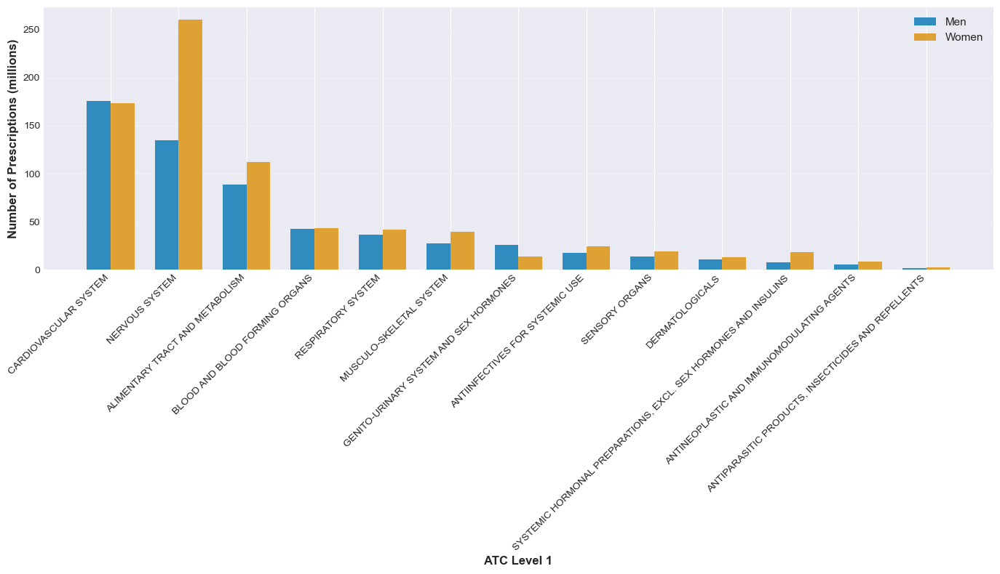

In [41]:
# Number of prescriptions: Sex x ATC Level 1
sex_atc1_rx = df.groupby(['grup ATC nivell 1', 'sexe']).agg({
    'nombre de receptes': 'sum'
}).reset_index()

sex_atc1_rx_pivot = sex_atc1_rx.pivot(index='grup ATC nivell 1', columns='sexe', values='nombre de receptes')
sex_atc1_rx_pivot = sex_atc1_rx_pivot.sort_values(by=sex_atc1_rx_pivot.columns[0], ascending=False)

print("Number of Prescriptions by Sex and ATC Level 1 (in millions):")
print(sex_atc1_rx_pivot / 1_000_000)

# Plot
fig, ax = plt.subplots(figsize=(14, 8))
x = np.arange(len(sex_atc1_rx_pivot))
width = 0.35
cb_colors = sns.color_palette("colorblind")

sexes = sex_atc1_rx_pivot.columns
for i, sex in enumerate(sexes):
    ax.bar(x + i*width, sex_atc1_rx_pivot[sex] / 1_000_000, width, label=sex, 
          color=cb_colors[i], alpha=0.8)

ax.set_ylabel('Number of Prescriptions (millions)', fontsize=12, fontweight='bold')
ax.set_xlabel('ATC Level 1', fontsize=12, fontweight='bold')
#ax.set_title('Number of Prescriptions by Sex and ATC Level 1', fontsize=14, fontweight='bold')
ax.set_xticks(x + width / 2)
ax.set_xticklabels(sex_atc1_rx_pivot.index, rotation=45, ha='right')
ax.legend(fontsize=11)
ax.grid(axis='y', alpha=0.3)

plt.tight_layout()
plt.show()

Number of Prescriptions by Age Group and ATC Level 1 (in millions):
grup ATC nivell 1  NERVOUS SYSTEM  CARDIOVASCULAR SYSTEM  ALIMENTARY TRACT AND METABOLISM  BLOOD AND BLOOD FORMING ORGANS  \
grup d'edat                                                                                                                 
0-1                      1.129969               0.034572                         0.876636                        0.143947   
2-3                      0.772879               0.026550                         0.165117                        0.100000   
4-5                      0.689202               0.031512                         0.146145                        0.081171   
6-7                      0.749084               0.044407                         0.146927                        0.065133   
8-9                      0.951717               0.062820                         0.165298                        0.060648   
10-11                    1.144879               0.080011 

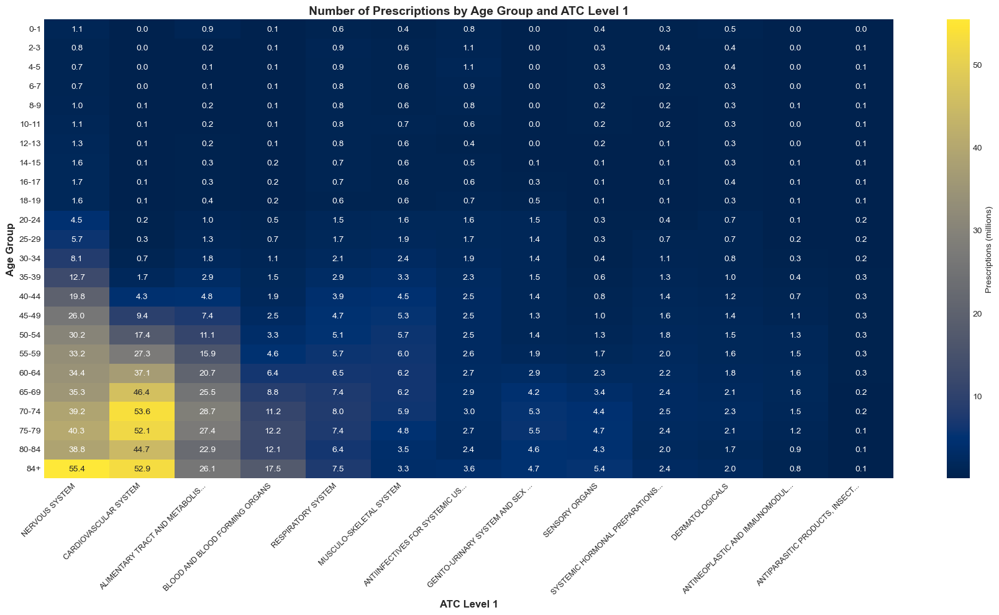

In [42]:
# Number of prescriptions: Age x ATC Level 1 (heatmap)
age_atc1_rx = df.groupby(["grup d'edat", 'grup ATC nivell 1']).agg({
    'nombre de receptes': 'sum'
}).reset_index()

age_atc1_rx["grup d'edat"] = pd.Categorical(age_atc1_rx["grup d'edat"], categories=age_order, ordered=True)
age_atc1_rx = age_atc1_rx.sort_values("grup d'edat")

print("Number of Prescriptions by Age Group and ATC Level 1 (in millions):")

# Create heatmap
pivot_rx = age_atc1_rx.pivot(index="grup d'edat", columns='grup ATC nivell 1', values='nombre de receptes')
column_order_rx = pivot_rx.sum().sort_values(ascending=False).index
pivot_rx = pivot_rx[column_order_rx] / 1_000_000  # Convert to millions
print(pivot_rx)

fig, ax = plt.subplots(figsize=(18, 10))
abbreviated_cols_rx = [col[:30] + '...' if len(col) > 30 else col for col in pivot_rx.columns]
sns.heatmap(pivot_rx, annot=True, fmt='.1f', cmap='cividis', cbar_kws={'label': 'Prescriptions (millions)'}, 
            ax=ax, xticklabels=abbreviated_cols_rx)
ax.set_title('Number of Prescriptions by Age Group and ATC Level 1', fontsize=14, fontweight='bold')
ax.set_xlabel('ATC Level 1', fontsize=12, fontweight='bold')
ax.set_ylabel('Age Group', fontsize=12, fontweight='bold')
plt.setp(ax.get_xticklabels(), rotation=45, ha='right', fontsize=9)
plt.tight_layout()
plt.show()

Number of Prescriptions by Region and ATC Level 1 (in millions):
grup ATC nivell 1             NERVOUS SYSTEM  CARDIOVASCULAR SYSTEM  ALIMENTARY TRACT AND METABOLISM  BLOOD AND BLOOD FORMING ORGANS  \
regió sanitària                                                                                                                        
ALT PIRINEU i ARAN                  3.265479               2.952208                         1.696329                        0.833456   
BARCELONA                         208.627432             189.438321                       107.496459                       46.174154   
BARCELONA CIUTAT                   15.981065              14.222181                         8.059030                        3.655061   
BARCELONA METROPOLITANA NORD       21.914393              18.206859                        10.787321                        4.417077   
BARCELONA METROPOLITANA SUD        11.694810              10.126962                         5.818178                   

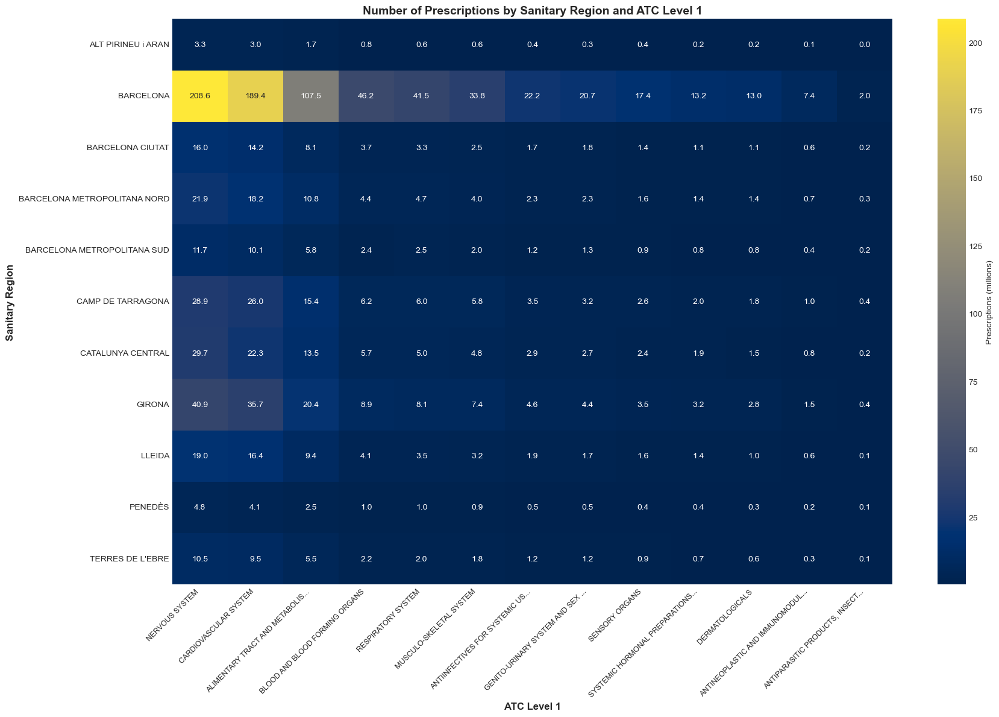

In [43]:
# Number of prescriptions: Sanitary Region x ATC Level 1 (heatmap)
region_atc1_rx = df.groupby(['regió sanitària', 'grup ATC nivell 1']).agg({
    'nombre de receptes': 'sum'
}).reset_index()

print("Number of Prescriptions by Region and ATC Level 1 (in millions):")

# Create heatmap
pivot_region_rx = region_atc1_rx.pivot(index='regió sanitària', columns='grup ATC nivell 1', values='nombre de receptes')
column_order_region_rx = pivot_region_rx.sum().sort_values(ascending=False).index
pivot_region_rx = pivot_region_rx[column_order_region_rx] / 1_000_000  # Convert to millions
print(pivot_region_rx)

fig, ax = plt.subplots(figsize=(18, 12))
abbreviated_cols_region_rx = [col[:30] + '...' if len(col) > 30 else col for col in pivot_region_rx.columns]
sns.heatmap(pivot_region_rx, annot=True, fmt='.1f', cmap='cividis', cbar_kws={'label': 'Prescriptions (millions)'}, 
            ax=ax, xticklabels=abbreviated_cols_region_rx)
ax.set_title('Number of Prescriptions by Sanitary Region and ATC Level 1', fontsize=14, fontweight='bold')
ax.set_xlabel('ATC Level 1', fontsize=12, fontweight='bold')
ax.set_ylabel('Sanitary Region', fontsize=12, fontweight='bold')
plt.setp(ax.get_xticklabels(), rotation=45, ha='right', fontsize=9)
plt.tight_layout()
plt.show()

In [44]:
# Summary statistics for prescription volumes
print("=" * 80)
print("PRESCRIPTION VOLUME SUMMARY STATISTICS")
print("=" * 80)

# Overall prescription statistics
total_prescriptions = df['nombre de receptes'].sum()
mean_prescriptions_per_record = df['nombre de receptes'].mean()
median_prescriptions_per_record = df['nombre de receptes'].median()
std_prescriptions_per_record = df['nombre de receptes'].std()

print(f"\nOverall Prescription Statistics:")
print(f"  Total number of prescriptions: {total_prescriptions:,.0f}")
print(f"  Mean prescriptions per record: {mean_prescriptions_per_record:.2f}")
print(f"  Median prescriptions per record: {median_prescriptions_per_record:.2f}")
print(f"  Std dev of prescriptions per record: {std_prescriptions_per_record:.2f}")

# Prescriptions by ATC Level 1
print(f"\n{'ATC Level 1 - Prescription Volume Statistics':-^80}")
atc1_rx_stats = df.groupby('grup ATC nivell 1')['nombre de receptes'].agg(['sum', 'mean', 'std']).sort_values('sum', ascending=False)
atc1_rx_stats['pct_of_total'] = 100 * atc1_rx_stats['sum'] / total_prescriptions
print(f"{'Category':<50} {'Total (M)':<12} {'Mean':<10} {'Std':<10} {'% Total':<10}")
print("-" * 80)
for idx, row in atc1_rx_stats.head(10).iterrows():
    print(f"{idx[:48]:<50} {row['sum']/1e6:>10.2f}  {row['mean']:>8.2f}  {row['std']:>8.2f}  {row['pct_of_total']:>8.2f}%")

# Prescriptions by Sex
print(f"\n{'Prescription Volume by Sex':-^80}")
sex_rx = df.groupby('sexe')['nombre de receptes'].sum().sort_values(ascending=False)
for sex, rx_count in sex_rx.items():
    pct = 100 * rx_count / total_prescriptions
    print(f"  {sex:<15}: {rx_count:>12,.0f} prescriptions ({pct:>5.2f}%)")

# Prescriptions by Age Group
print(f"\n{'Prescription Volume by Age Group':-^80}")
age_rx = df.groupby("grup d'edat")['nombre de receptes'].sum()
age_rx = age_rx.reindex(age_order)
for age, rx_count in age_rx.items():
    pct = 100 * rx_count / total_prescriptions
    print(f"  {age:<20}: {rx_count:>12,.0f} prescriptions ({pct:>5.2f}%)")

# Prescriptions by Region (top 10)
print(f"\n{'Top 10 Regions by Prescription Volume':-^80}")
region_rx = df.groupby('regió sanitària')['nombre de receptes'].sum().sort_values(ascending=False)
for region, rx_count in region_rx.head(10).items():
    pct = 100 * rx_count / total_prescriptions
    region_name = region[:40] + '...' if len(region) > 43 else region
    print(f"  {region_name:<45}: {rx_count:>12,.0f} ({pct:>5.2f}%)")

print("\n" + "=" * 80)

PRESCRIPTION VOLUME SUMMARY STATISTICS

Overall Prescription Statistics:
  Total number of prescriptions: 1,359,189,843
  Mean prescriptions per record: 180.36
  Median prescriptions per record: 13.00
  Std dev of prescriptions per record: 1072.27

------------------ATC Level 1 - Prescription Volume Statistics------------------
Category                                           Total (M)    Mean       Std        % Total   
--------------------------------------------------------------------------------
NERVOUS SYSTEM                                         395.28    289.20   1470.39     29.08%
CARDIOVASCULAR SYSTEM                                  348.98    356.89   1719.16     25.68%
ALIMENTARY TRACT AND METABOLISM                        200.48    183.39   1219.11     14.75%
BLOOD AND BLOOD FORMING ORGANS                          85.54    226.03   1184.38      6.29%
RESPIRATORY SYSTEM                                      78.24    154.55    465.90      5.76%
MUSCULO-SKELETAL SYSTEM    

## Mental Health Drug Analysis

Radar charts showing monthly mean prescriptions for mental health drug categories (ATC Level 3: N05 and N06) for women and men from 2016-2025.

In [45]:
# Define mental health drug categories (ATC Level 3 codes)
mental_health_codes = {
    'N05A': 'Antipsychotics',
    'N05B': 'Anxiolytics',
    'N05C': 'Hypnotics and Sedatives',
    'N06A': 'Antidepressants',
    'N06B': 'Psychostimulants/ADHD/Nootropics',
    'N06C': 'Psycholeptics+Psychoanaleptics Combined',
    'N06D': 'Anti-Dementia Drugs'
}

# Filter for women, extract ATC code, and filter for mental health drugs
df_women = df[df['sexe'] == 'Women'].copy()
df_women['ATC_Level3'] = df_women['codi del grup ATC nivell 3'].str[:4]
df_women_mh = df_women[df_women['ATC_Level3'].isin(mental_health_codes.keys())].copy()
df_women_mh['MH_Category'] = df_women_mh['ATC_Level3'].map(mental_health_codes)

# Filter for men, extract ATC code, and filter for mental health drugs
df_men = df[df['sexe'] == 'Men'].copy()
df_men['ATC_Level3'] = df_men['codi del grup ATC nivell 3'].str[:4]
df_men_mh = df_men[df_men['ATC_Level3'].isin(mental_health_codes.keys())].copy()
df_men_mh['MH_Category'] = df_men_mh['ATC_Level3'].map(mental_health_codes)

print(f"Total mental health drug records for women: {len(df_women_mh):,}")
print(f"Total mental health drug records for men: {len(df_men_mh):,}")
if len(df_women_mh) > 0 and len(df_men_mh) > 0:
    all_years = sorted(set(df_women_mh['any'].unique()) | set(df_men_mh['any'].unique()))
    print(f"Years covered: {all_years}")
print(f"\nBreakdown by category:")
for code, name in mental_health_codes.items():
    count_women = len(df_women_mh[df_women_mh['ATC_Level3'] == code])
    count_men = len(df_men_mh[df_men_mh['ATC_Level3'] == code])
    pct_women = 100 * count_women / len(df_women_mh) if len(df_women_mh) > 0 else 0
    pct_men = 100 * count_men / len(df_men_mh) if len(df_men_mh) > 0 else 0
    print(f"  {code} - {name:<45}: Women: {count_women:>8,} ({pct_women:>5.2f}%), Men: {count_men:>8,} ({pct_men:>5.2f}%)")

Total mental health drug records for women: 293,194
Total mental health drug records for men: 300,776
Years covered: [2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023, 2024, 2025]

Breakdown by category:
  N05A - Antipsychotics                               : Women:  123,929 (42.27%), Men:  131,482 (43.71%)
  N05B - Anxiolytics                                  : Women:   39,654 (13.52%), Men:   39,182 (13.03%)
  N05C - Hypnotics and Sedatives                      : Women:   40,873 (13.94%), Men:   41,503 (13.80%)
  N06A - Antidepressants                              : Women:   50,597 (17.26%), Men:   50,187 (16.69%)
  N06B - Psychostimulants/ADHD/Nootropics             : Women:   24,876 ( 8.48%), Men:   25,279 ( 8.40%)
  N06C - Psycholeptics+Psychoanaleptics Combined      : Women:        1 ( 0.00%), Men:        0 ( 0.00%)
  N06D - Anti-Dementia Drugs                          : Women:   13,264 ( 4.52%), Men:   13,143 ( 4.37%)


In [46]:
# Calculate monthly mean prescriptions for each mental health drug category - separately for women and men
# Group by ATC code and month to get mean prescriptions across all years
monthly_data_women = df_women_mh.groupby(['ATC_Level3', 'MH_Category', 'mes']).agg({
    'nombre de receptes': 'mean'
}).reset_index()
monthly_data_women = monthly_data_women.sort_values(['ATC_Level3', 'mes'])
monthly_data_women['sex'] = 'Women'

monthly_data_men = df_men_mh.groupby(['ATC_Level3', 'MH_Category', 'mes']).agg({
    'nombre de receptes': 'mean'
}).reset_index()
monthly_data_men = monthly_data_men.sort_values(['ATC_Level3', 'mes'])
monthly_data_men['sex'] = 'Men'

print("\nMonthly mean prescription data prepared")
print(f"Women shape: {monthly_data_women.shape}")
print(f"Men shape: {monthly_data_men.shape}")
print("\nSample data (Women):")
print(monthly_data_women.head(15))
print("\nSample data (Men):")
print(monthly_data_men.head(15))


Monthly mean prescription data prepared
Women shape: (73, 5)
Men shape: (72, 5)

Sample data (Women):
   ATC_Level3     MH_Category  mes  nombre de receptes    sex
0        N05A  Antipsychotics    1          110.061514  Women
1        N05A  Antipsychotics    2          102.492818  Women
2        N05A  Antipsychotics    3          112.131397  Women
3        N05A  Antipsychotics    4          107.610435  Women
4        N05A  Antipsychotics    5          111.676657  Women
5        N05A  Antipsychotics    6          107.999158  Women
6        N05A  Antipsychotics    7          113.382066  Women
7        N05A  Antipsychotics    8          105.487656  Women
8        N05A  Antipsychotics    9          108.500515  Women
9        N05A  Antipsychotics   10          115.027993  Women
10       N05A  Antipsychotics   11          113.191065  Women
11       N05A  Antipsychotics   12          113.149022  Women
12       N05B     Anxiolytics    1         1152.348667  Women
13       N05B     Anxiolytics

Found 6 categories with data for both women and men: ['N05A', 'N05B', 'N05C', 'N06A', 'N06B', 'N06D']


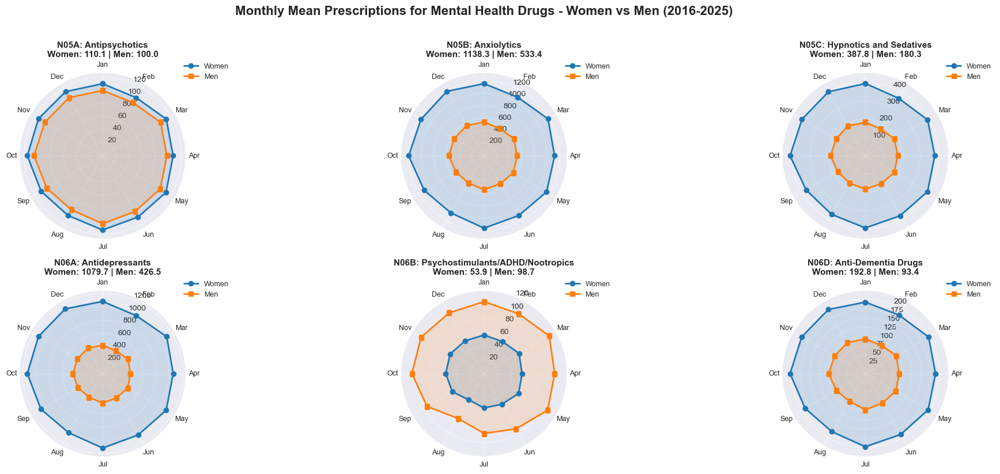


Radar charts created for 6 mental health drug categories!


In [47]:
# Create radar charts for each mental health drug category - comparing Women and Men
from math import pi

# Get unique categories
categories = monthly_data_women['ATC_Level3'].unique()
month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

# Filter categories that exist in both women and men datasets
valid_categories = []
for atc_code in categories:
    if atc_code in monthly_data_men['ATC_Level3'].values:
        valid_categories.append(atc_code)

print(f"Found {len(valid_categories)} categories with data for both women and men: {valid_categories}")

# Create a figure with subplots for all valid drug categories
fig = plt.figure(figsize=(20, 12))

for idx, atc_code in enumerate(sorted(valid_categories)):
    # Filter data for this category - both women and men
    cat_data_women = monthly_data_women[monthly_data_women['ATC_Level3'] == atc_code].copy()
    cat_data_men = monthly_data_men[monthly_data_men['ATC_Level3'] == atc_code].copy()
    cat_name = cat_data_women['MH_Category'].iloc[0]
    
    # Prepare data for radar chart - Women
    months_women = cat_data_women['mes'].values
    values_women = cat_data_women['nombre de receptes'].values
    
    # Prepare data for radar chart - Men
    months_men = cat_data_men['mes'].values
    values_men = cat_data_men['nombre de receptes'].values
    
    # Number of variables (use women's data for structure, should match)
    num_vars = len(months_women)
    
    # Compute angle for each axis
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    values_women_list = list(values_women)
    values_men_list = list(values_men)
    angles += angles[:1]
    values_women_list += values_women_list[:1]
    values_men_list += values_men_list[:1]
    
    # Create subplot
    ax = plt.subplot(3, 3, idx + 1, projection='polar')
    
    # Draw the plots - Women in blue, Men in orange
    ax.plot(angles, values_women_list, 'o-', linewidth=2, color='#1f77b4', label='Women')
    ax.fill(angles, values_women_list, alpha=0.15, color='#1f77b4')
    
    ax.plot(angles, values_men_list, 's-', linewidth=2, color='#ff7f0e', label='Men')
    ax.fill(angles, values_men_list, alpha=0.15, color='#ff7f0e')
    
    # Fix axis to go in the right order and start at 12 o'clock
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)
    
    # Draw axis labels - only use month names for months that have data
    ax.set_xticks(angles[:-1])
    month_labels = [month_names[m-1] for m in months_women]
    ax.set_xticklabels(month_labels, fontsize=9)
    
    # Add title with both means
    mean_women = np.mean(values_women)
    mean_men = np.mean(values_men)
    ax.set_title(f'{atc_code}: {cat_name}\nWomen: {mean_women:.1f} | Men: {mean_men:.1f}', 
                 fontsize=11, fontweight='bold', pad=20)
    
    # Add grid
    ax.grid(True, linestyle='--', alpha=0.7)
    
    # Set y-axis label
    max_val = max(max(values_women_list), max(values_men_list))
    ax.set_ylim(0, max_val * 1.1)
    
    # Add legend
    ax.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1), fontsize=9)

plt.suptitle(f'Monthly Mean Prescriptions for Mental Health Drugs - Women vs Men (2016-2025)', 
             fontsize=16, fontweight='bold', y=0.98)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()

print(f"\nRadar charts created for {len(valid_categories)} mental health drug categories!")

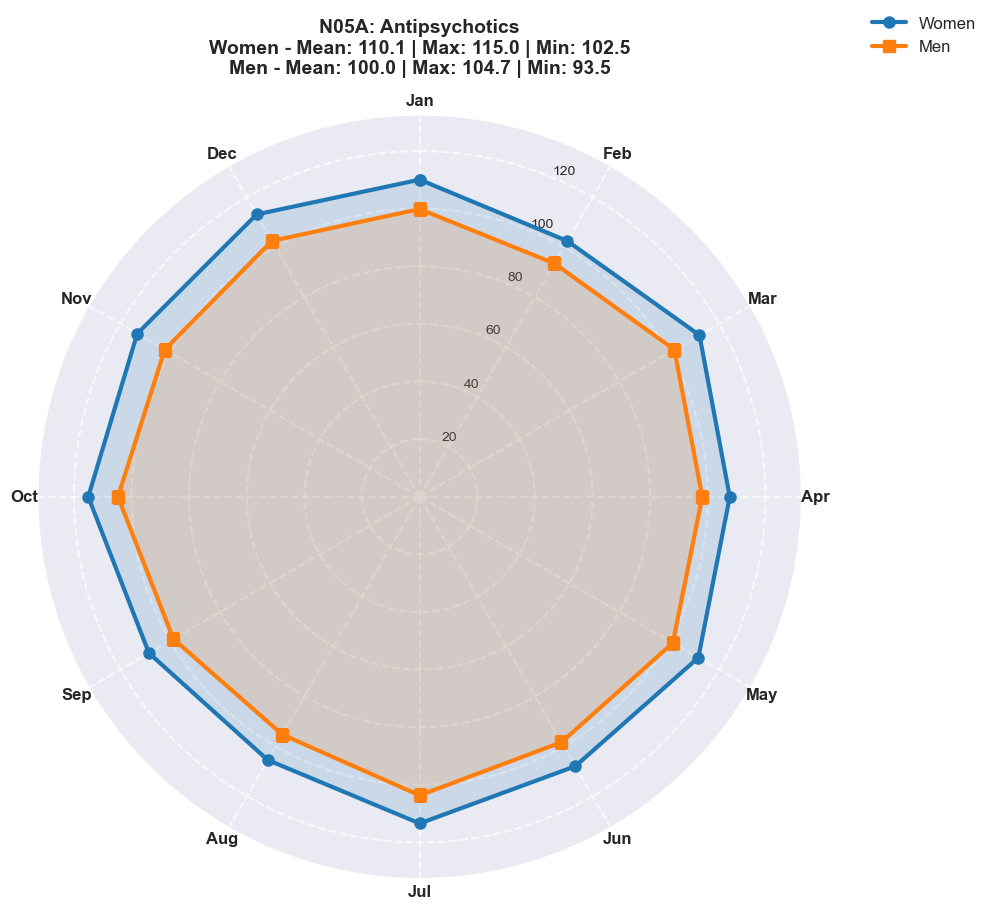


N05A - Antipsychotics:
  WOMEN:
    Mean monthly prescriptions: 110.06
    Max: 115.0 (Month 10)
    Min: 102.5 (Month 2)
    Range: 12.5
    Coefficient of variation: 3.24%
  MEN:
    Mean monthly prescriptions: 100.03
    Max: 104.7 (Month 10)
    Min: 93.5 (Month 2)
    Range: 11.2
    Coefficient of variation: 3.23%
  COMPARISON:
    Women/Men mean ratio: 1.10


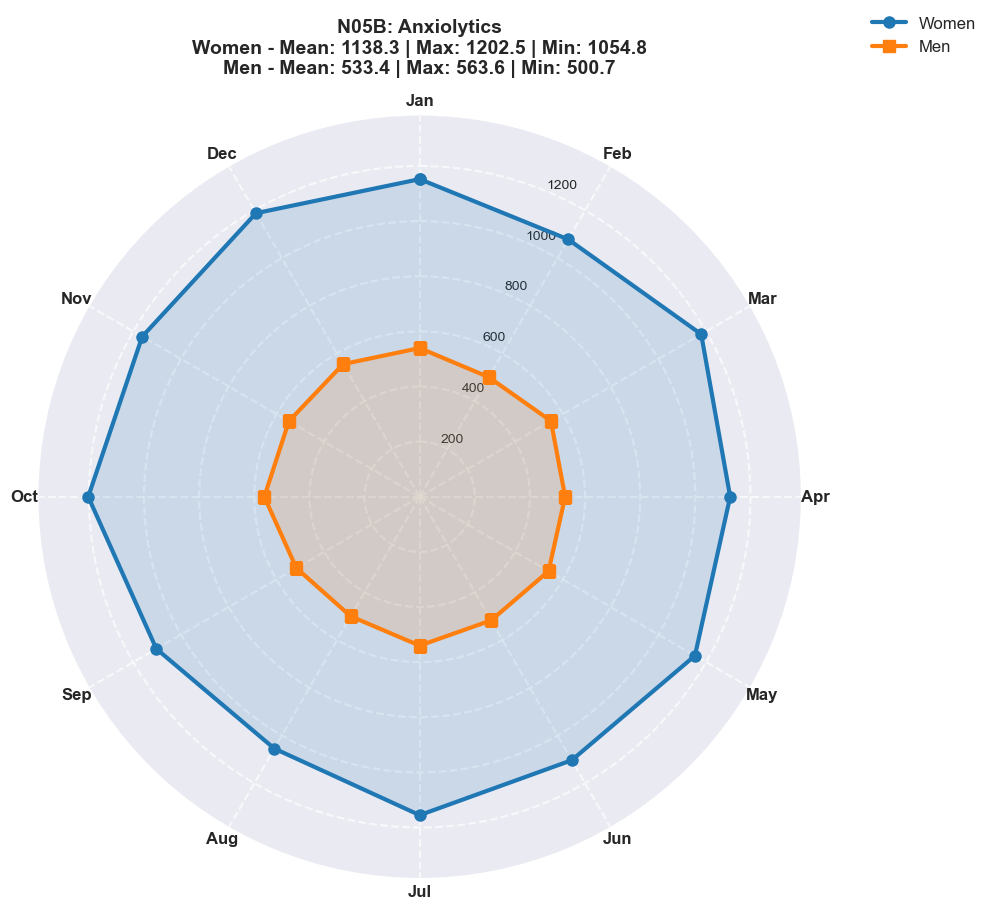


N05B - Anxiolytics:
  WOMEN:
    Mean monthly prescriptions: 1138.27
    Max: 1202.5 (Month 10)
    Min: 1054.8 (Month 8)
    Range: 147.7
    Coefficient of variation: 3.82%
  MEN:
    Mean monthly prescriptions: 533.41
    Max: 563.6 (Month 10)
    Min: 500.7 (Month 8)
    Range: 63.0
    Coefficient of variation: 3.70%
  COMPARISON:
    Women/Men mean ratio: 2.13


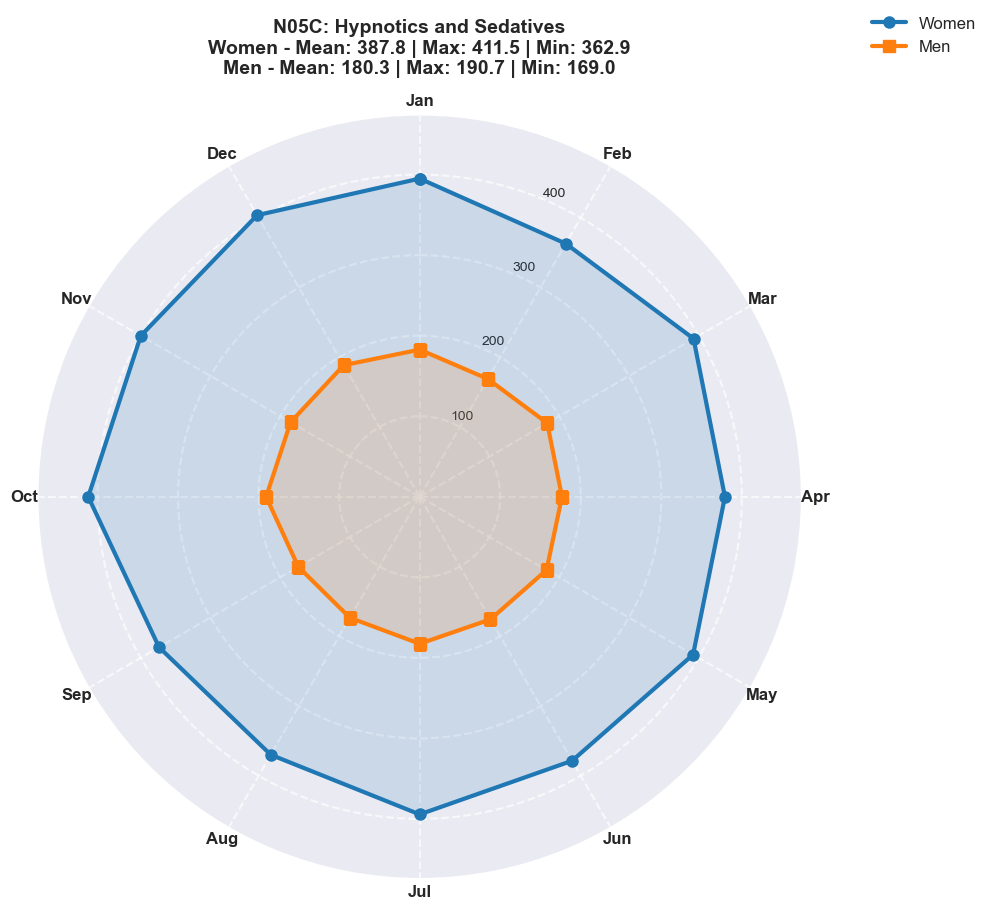


N05C - Hypnotics and Sedatives:
  WOMEN:
    Mean monthly prescriptions: 387.78
    Max: 411.5 (Month 10)
    Min: 362.9 (Month 2)
    Range: 48.6
    Coefficient of variation: 3.65%
  MEN:
    Mean monthly prescriptions: 180.29
    Max: 190.7 (Month 10)
    Min: 169.0 (Month 2)
    Range: 21.6
    Coefficient of variation: 3.46%
  COMPARISON:
    Women/Men mean ratio: 2.15


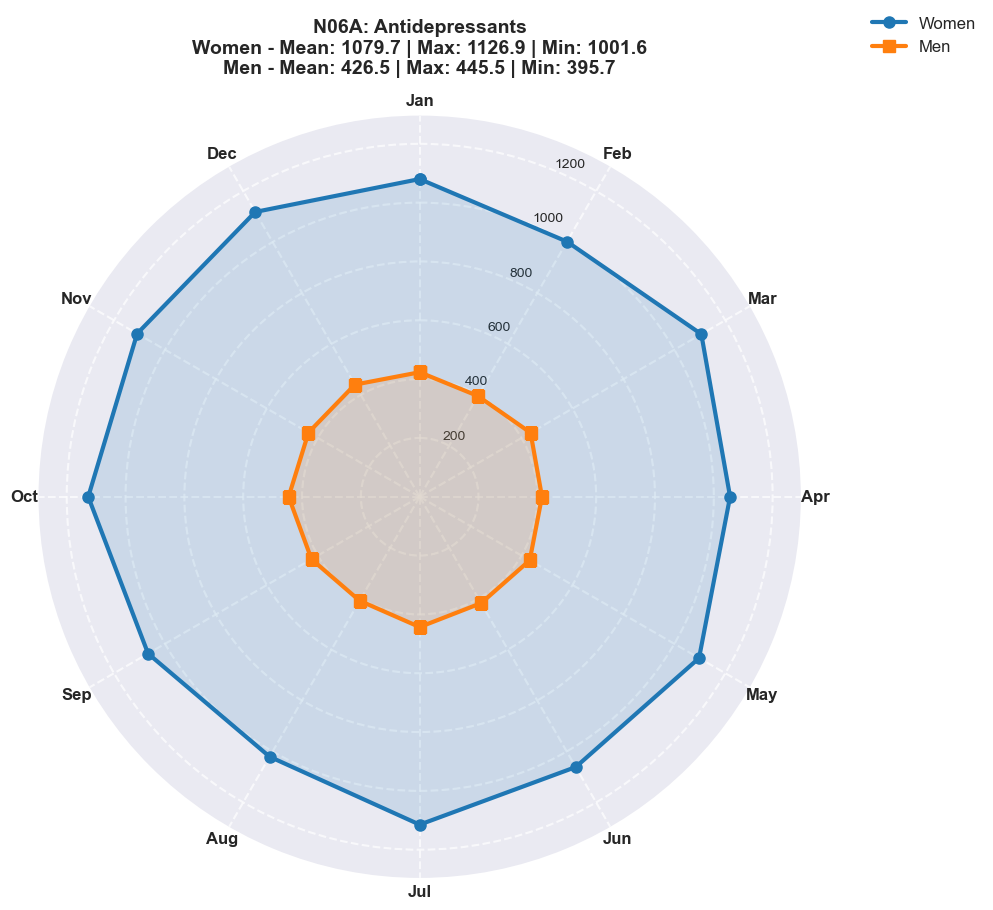


N06A - Antidepressants:
  WOMEN:
    Mean monthly prescriptions: 1079.73
    Max: 1126.9 (Month 10)
    Min: 1001.6 (Month 2)
    Range: 125.2
    Coefficient of variation: 3.54%
  MEN:
    Mean monthly prescriptions: 426.53
    Max: 445.5 (Month 10)
    Min: 395.7 (Month 2)
    Range: 49.9
    Coefficient of variation: 3.40%
  COMPARISON:
    Women/Men mean ratio: 2.53


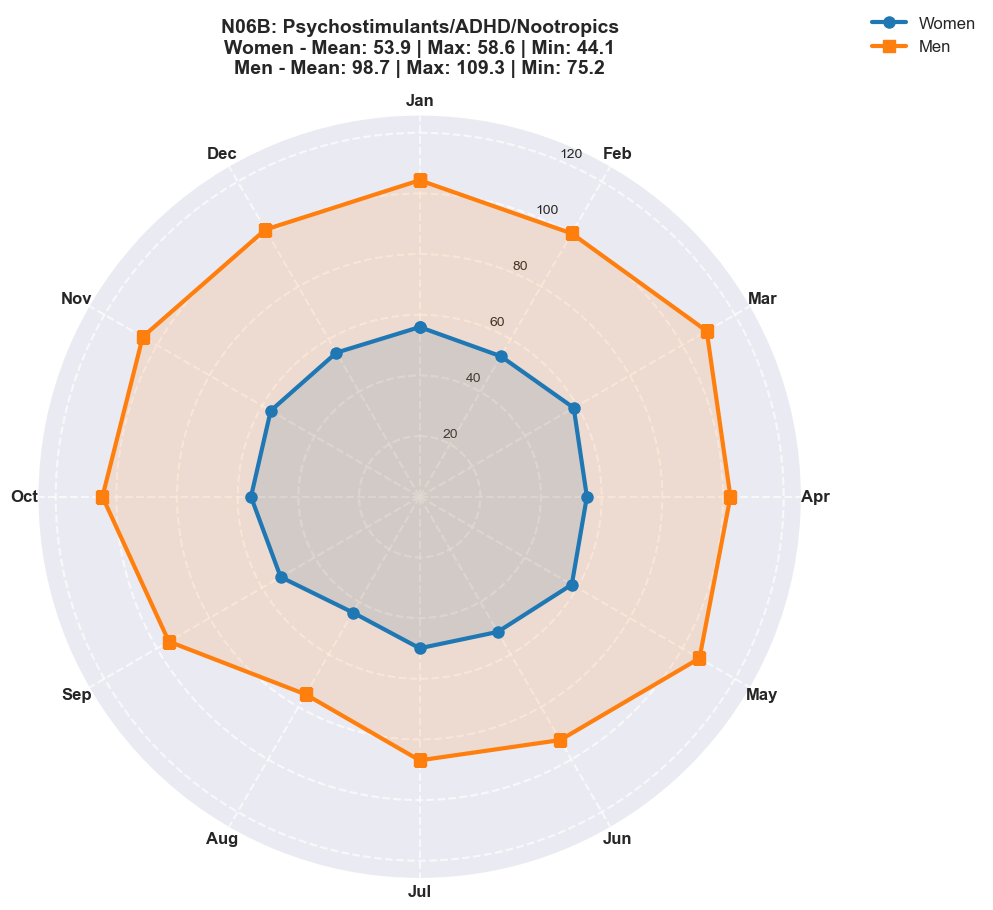


N06B - Psychostimulants/ADHD/Nootropics:
  WOMEN:
    Mean monthly prescriptions: 53.89
    Max: 58.6 (Month 3)
    Min: 44.1 (Month 8)
    Range: 14.6
    Coefficient of variation: 7.09%
  MEN:
    Mean monthly prescriptions: 98.74
    Max: 109.3 (Month 3)
    Min: 75.2 (Month 8)
    Range: 34.0
    Coefficient of variation: 9.46%
  COMPARISON:
    Women/Men mean ratio: 0.55


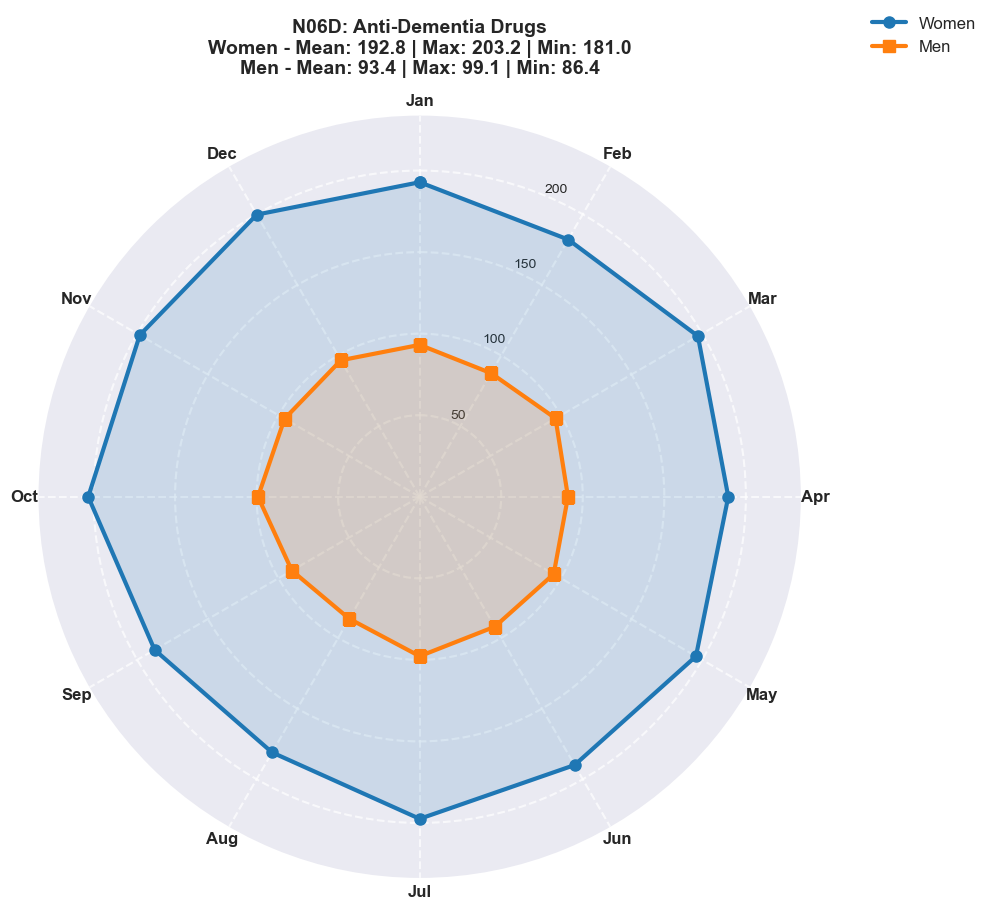


N06D - Anti-Dementia Drugs:
  WOMEN:
    Mean monthly prescriptions: 192.85
    Max: 203.2 (Month 10)
    Min: 181.0 (Month 8)
    Range: 22.2
    Coefficient of variation: 3.46%
  MEN:
    Mean monthly prescriptions: 93.40
    Max: 99.1 (Month 10)
    Min: 86.4 (Month 8)
    Range: 12.8
    Coefficient of variation: 4.12%
  COMPARISON:
    Women/Men mean ratio: 2.06


In [48]:
# Create individual larger radar charts for each drug category - Women vs Men
for atc_code in sorted(valid_categories):
    # Filter data for this category - both women and men
    cat_data_women = monthly_data_women[monthly_data_women['ATC_Level3'] == atc_code].copy()
    cat_data_men = monthly_data_men[monthly_data_men['ATC_Level3'] == atc_code].copy()
    cat_name = cat_data_women['MH_Category'].iloc[0]
    
    # Prepare data for radar chart - Women
    months_women = cat_data_women['mes'].values
    values_women = cat_data_women['nombre de receptes'].values
    
    # Prepare data for radar chart - Men
    months_men = cat_data_men['mes'].values
    values_men = cat_data_men['nombre de receptes'].values
    
    # Number of variables
    num_vars = len(months_women)
    
    # Compute angle for each axis
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    values_women_plot = list(values_women)
    values_men_plot = list(values_men)
    angles += angles[:1]
    values_women_plot += values_women_plot[:1]
    values_men_plot += values_men_plot[:1]
    
    # Create figure
    fig, ax = plt.subplots(figsize=(10, 10), subplot_kw=dict(projection='polar'))
    
    # Draw the plots - Women in blue, Men in orange
    ax.plot(angles, values_women_plot, 'o-', linewidth=3, color='#1f77b4', markersize=8, label='Women')
    ax.fill(angles, values_women_plot, alpha=0.15, color='#1f77b4')
    
    ax.plot(angles, values_men_plot, 's-', linewidth=3, color='#ff7f0e', markersize=8, label='Men')
    ax.fill(angles, values_men_plot, alpha=0.15, color='#ff7f0e')
    
    # Fix axis to go in the right order and start at 12 o'clock
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)
    
    # Draw axis labels - only use month names for months that have data
    ax.set_xticks(angles[:-1])
    month_labels = [month_names[m-1] for m in months_women]
    ax.set_xticklabels(month_labels, fontsize=12, fontweight='bold')
    
    # Calculate statistics
    mean_women = np.mean(values_women)
    max_women = np.max(values_women)
    min_women = np.min(values_women)
    mean_men = np.mean(values_men)
    max_men = np.max(values_men)
    min_men = np.min(values_men)
    
    # Add title
    ax.set_title(f'{atc_code}: {cat_name}\n' + 
                 f'Women - Mean: {mean_women:.1f} | Max: {max_women:.1f} | Min: {min_women:.1f}\n' +
                 f'Men - Mean: {mean_men:.1f} | Max: {max_men:.1f} | Min: {min_men:.1f}', 
                 fontsize=14, fontweight='bold', pad=30)
    
    # Add grid
    ax.grid(True, linestyle='--', alpha=0.7, linewidth=1.5)
    
    # Set y-axis label and limits
    max_val = max(max_women, max_men)
    ax.set_ylim(0, max_val * 1.15)
    
    # Add legend
    ax.legend(loc='upper right', bbox_to_anchor=(1.25, 1.15), fontsize=12, framealpha=0.9)
    
    plt.tight_layout()
    plt.show()
    
    # Print statistics for this category
    print(f"\n{atc_code} - {cat_name}:")
    print(f"  WOMEN:")
    print(f"    Mean monthly prescriptions: {mean_women:.2f}")
    print(f"    Max: {max_women:.1f} (Month {months_women[np.argmax(values_women)]})")
    print(f"    Min: {min_women:.1f} (Month {months_women[np.argmin(values_women)]})")
    print(f"    Range: {max_women - min_women:.1f}")
    print(f"    Coefficient of variation: {(np.std(values_women) / mean_women * 100):.2f}%")
    print(f"  MEN:")
    print(f"    Mean monthly prescriptions: {mean_men:.2f}")
    print(f"    Max: {max_men:.1f} (Month {months_men[np.argmax(values_men)]})")
    print(f"    Min: {min_men:.1f} (Month {months_men[np.argmin(values_men)]})")
    print(f"    Range: {max_men - min_men:.1f}")
    print(f"    Coefficient of variation: {(np.std(values_men) / mean_men * 100):.2f}%")
    print(f"  COMPARISON:")
    print(f"    Women/Men mean ratio: {mean_women/mean_men:.2f}")

### Yearly Evolution Radar Charts (2016-2025)

Radar charts showing the evolution of mean prescriptions across years for each mental health drug category.

In [49]:
# Calculate yearly mean prescriptions for each mental health drug category - separately for women and men
# Group by ATC code and year to get mean prescriptions
yearly_data_women = df_women_mh.groupby(['ATC_Level3', 'MH_Category', 'any']).agg({
    'nombre de receptes': 'mean'
}).reset_index()
yearly_data_women['sex'] = 'Women'

yearly_data_men = df_men_mh.groupby(['ATC_Level3', 'MH_Category', 'any']).agg({
    'nombre de receptes': 'mean'
}).reset_index()
yearly_data_men['sex'] = 'Men'

# Filter for years 2016-2025
yearly_data_women = yearly_data_women[(yearly_data_women['any'] >= 2016) & (yearly_data_women['any'] <= 2025)]
yearly_data_women = yearly_data_women.sort_values(['ATC_Level3', 'any'])

yearly_data_men = yearly_data_men[(yearly_data_men['any'] >= 2016) & (yearly_data_men['any'] <= 2025)]
yearly_data_men = yearly_data_men.sort_values(['ATC_Level3', 'any'])

print("\nYearly mean prescription data prepared (2016-2025)")
print(f"Women shape: {yearly_data_women.shape}")
print(f"Men shape: {yearly_data_men.shape}")
print("\nSample data (Women):")
print(yearly_data_women.head(20))
print("\nSample data (Men):")
print(yearly_data_men.head(20))


Yearly mean prescription data prepared (2016-2025)
Women shape: (61, 5)
Men shape: (60, 5)

Sample data (Women):
   ATC_Level3     MH_Category   any  nombre de receptes    sex
0        N05A  Antipsychotics  2016           99.609750  Women
1        N05A  Antipsychotics  2017          102.997018  Women
2        N05A  Antipsychotics  2018          105.897752  Women
3        N05A  Antipsychotics  2019          111.212313  Women
4        N05A  Antipsychotics  2020          116.781725  Women
5        N05A  Antipsychotics  2021          122.117455  Women
6        N05A  Antipsychotics  2022          126.841607  Women
7        N05A  Antipsychotics  2023          131.408221  Women
8        N05A  Antipsychotics  2024           94.469529  Women
9        N05A  Antipsychotics  2025           96.910779  Women
10       N05B     Anxiolytics  2016         1239.371634  Women
11       N05B     Anxiolytics  2017         1221.328009  Women
12       N05B     Anxiolytics  2018         1230.282696  Women
13  

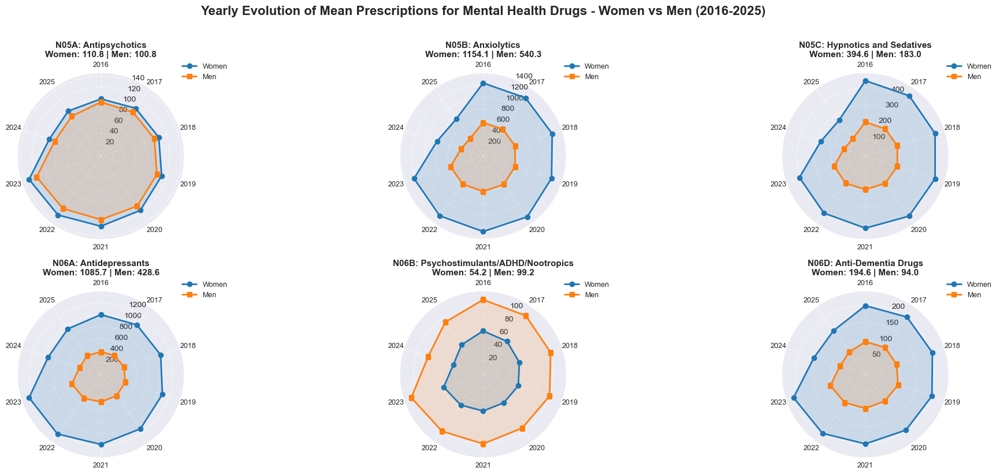


Yearly radar charts created for 6 mental health drug categories with sufficient data!
Excluded categories with insufficient data: {'N06C'}


In [50]:
# Create combined yearly evolution radar chart for all categories - Women vs Men
from math import pi

# Get colorblind-friendly colors
cb_colors = sns.color_palette("colorblind")

year_labels = [str(int(y)) for y in sorted(yearly_data_women['any'].unique())]
num_years = len(year_labels)

# Filter categories with at least 5 years of data for both women and men
valid_yearly_categories = []
for atc_code in yearly_data_women['ATC_Level3'].unique():
    cat_data_women = yearly_data_women[yearly_data_women['ATC_Level3'] == atc_code]
    cat_data_men = yearly_data_men[yearly_data_men['ATC_Level3'] == atc_code]
    if len(cat_data_women) >= 5 and len(cat_data_men) >= 5:
        valid_yearly_categories.append(atc_code)

# Create a figure with subplots for all valid drug categories
fig = plt.figure(figsize=(20, 12))

for idx, atc_code in enumerate(sorted(valid_yearly_categories)):
    # Filter data for this category - both women and men
    cat_data_women = yearly_data_women[yearly_data_women['ATC_Level3'] == atc_code].copy()
    cat_data_men = yearly_data_men[yearly_data_men['ATC_Level3'] == atc_code].copy()
    cat_name = cat_data_women['MH_Category'].iloc[0]
    
    # Prepare data for radar chart - Women
    years_women = cat_data_women['any'].values
    values_women = cat_data_women['nombre de receptes'].values
    
    # Prepare data for radar chart - Men
    years_men = cat_data_men['any'].values
    values_men = cat_data_men['nombre de receptes'].values
    
    # Number of variables
    num_vars = len(years_women)
    
    # Compute angle for each axis
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    values_women_list = list(values_women)
    values_men_list = list(values_men)
    angles += angles[:1]
    values_women_list += values_women_list[:1]
    values_men_list += values_men_list[:1]
    
    # Create subplot
    ax = plt.subplot(3, 3, idx + 1, projection='polar')
    
    # Draw the plots - Women in blue, Men in orange
    ax.plot(angles, values_women_list, 'o-', linewidth=2, color='#1f77b4', label='Women')
    ax.fill(angles, values_women_list, alpha=0.15, color='#1f77b4')
    
    ax.plot(angles, values_men_list, 's-', linewidth=2, color='#ff7f0e', label='Men')
    ax.fill(angles, values_men_list, alpha=0.15, color='#ff7f0e')
    
    # Fix axis to go in the right order and start at 12 o'clock
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)
    
    # Draw axis labels - year labels
    ax.set_xticks(angles[:-1])
    year_labels_cat = [str(int(y)) for y in years_women]
    ax.set_xticklabels(year_labels_cat, fontsize=9)
    
    # Add title with both means
    mean_women = np.mean(values_women)
    mean_men = np.mean(values_men)
    ax.set_title(f'{atc_code}: {cat_name}\nWomen: {mean_women:.1f} | Men: {mean_men:.1f}', 
                 fontsize=11, fontweight='bold', pad=20)
    
    # Add grid
    ax.grid(True, linestyle='--', alpha=0.7)
    
    # Set y-axis label
    max_val = max(max(values_women_list), max(values_men_list))
    ax.set_ylim(0, max_val * 1.1)
    
    # Add legend
    ax.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1), fontsize=9)

plt.suptitle(f'Yearly Evolution of Mean Prescriptions for Mental Health Drugs - Women vs Men (2016-2025)', 
             fontsize=16, fontweight='bold', y=0.98)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()

print(f"\nYearly radar charts created for {len(valid_yearly_categories)} mental health drug categories with sufficient data!")
if len(valid_yearly_categories) < len(yearly_data_women['ATC_Level3'].unique()):
    excluded = set(yearly_data_women['ATC_Level3'].unique()) - set(valid_yearly_categories)
    print(f"Excluded categories with insufficient data: {excluded}")

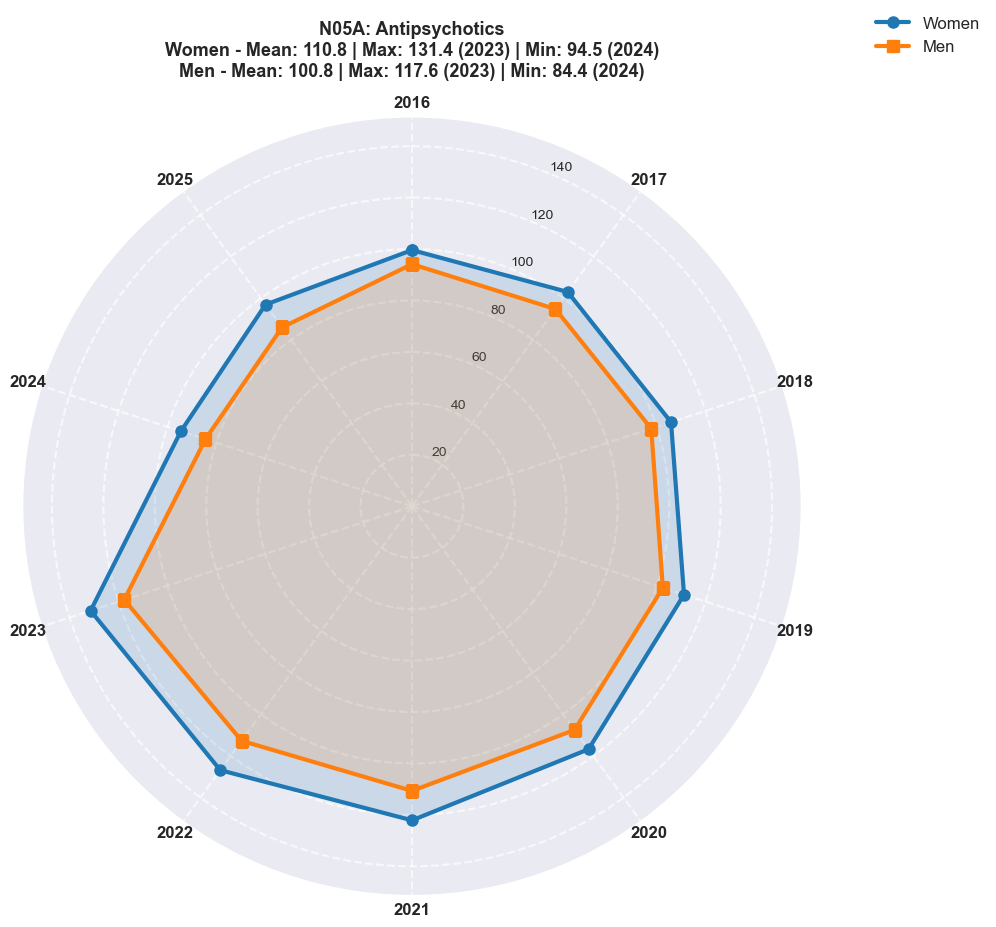


N05A - Antipsychotics:
  WOMEN:
    Mean yearly prescriptions: 110.82
    Max: 131.4 (2023)
    Min: 94.5 (2024)
    Range: 36.9
    Year-over-year growth rate: -2.71%
    Coefficient of variation: 11.11%
  MEN:
    Mean yearly prescriptions: 100.83
    Max: 117.6 (2023)
    Min: 84.4 (2024)
    Range: 33.2
    Year-over-year growth rate: -8.69%
    Coefficient of variation: 10.63%
  COMPARISON:
    Women/Men mean ratio: 1.10


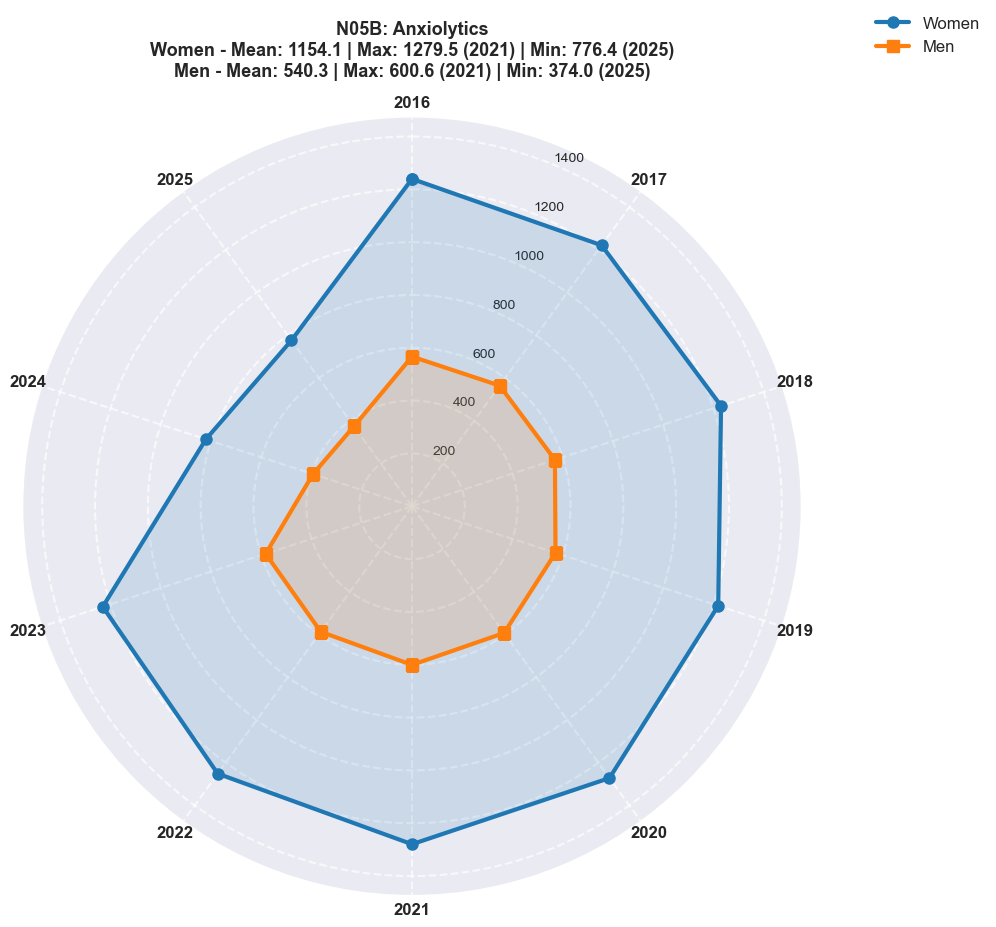


N05B - Anxiolytics:
  WOMEN:
    Mean yearly prescriptions: 1154.09
    Max: 1279.5 (2021)
    Min: 776.4 (2025)
    Range: 503.1
    Year-over-year growth rate: -37.35%
    Coefficient of variation: 15.52%
  MEN:
    Mean yearly prescriptions: 540.33
    Max: 600.6 (2021)
    Min: 374.0 (2025)
    Range: 226.6
    Year-over-year growth rate: -33.99%
    Coefficient of variation: 14.63%
  COMPARISON:
    Women/Men mean ratio: 2.14


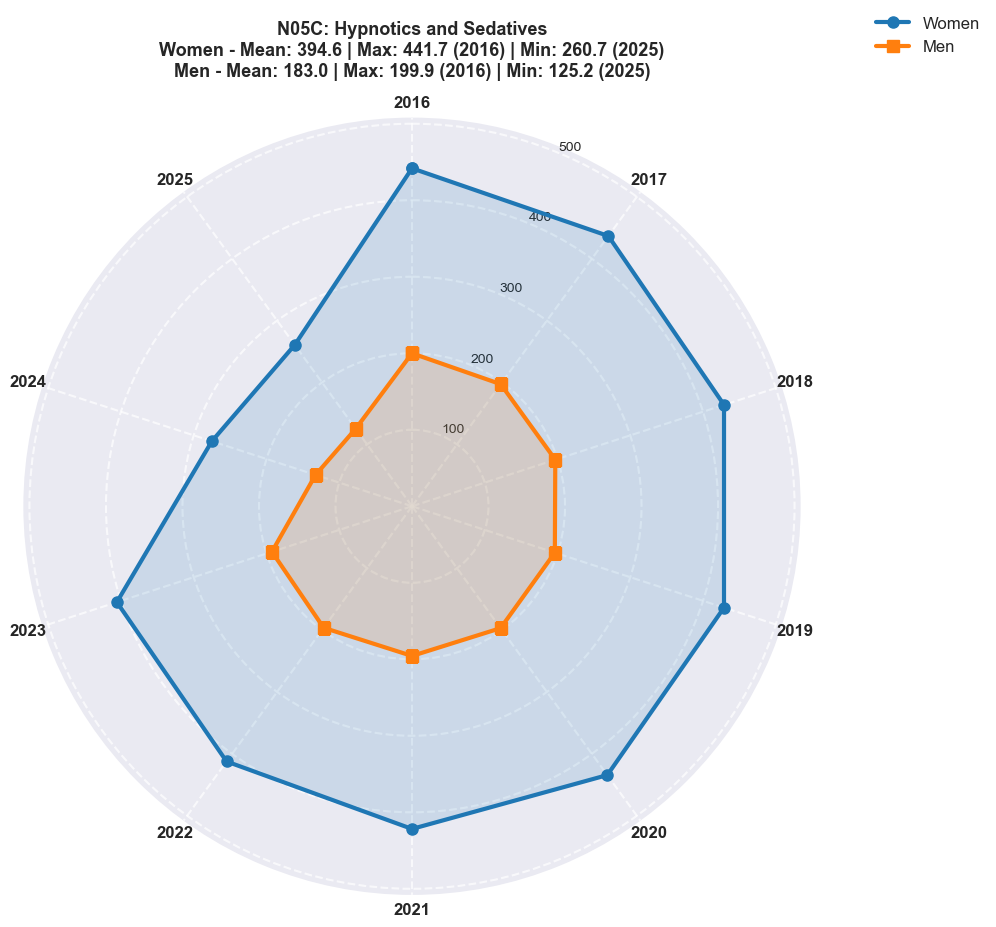


N05C - Hypnotics and Sedatives:
  WOMEN:
    Mean yearly prescriptions: 394.58
    Max: 441.7 (2016)
    Min: 260.7 (2025)
    Range: 181.0
    Year-over-year growth rate: -40.98%
    Coefficient of variation: 16.29%
  MEN:
    Mean yearly prescriptions: 182.97
    Max: 199.9 (2016)
    Min: 125.2 (2025)
    Range: 74.7
    Year-over-year growth rate: -37.36%
    Coefficient of variation: 14.83%
  COMPARISON:
    Women/Men mean ratio: 2.16


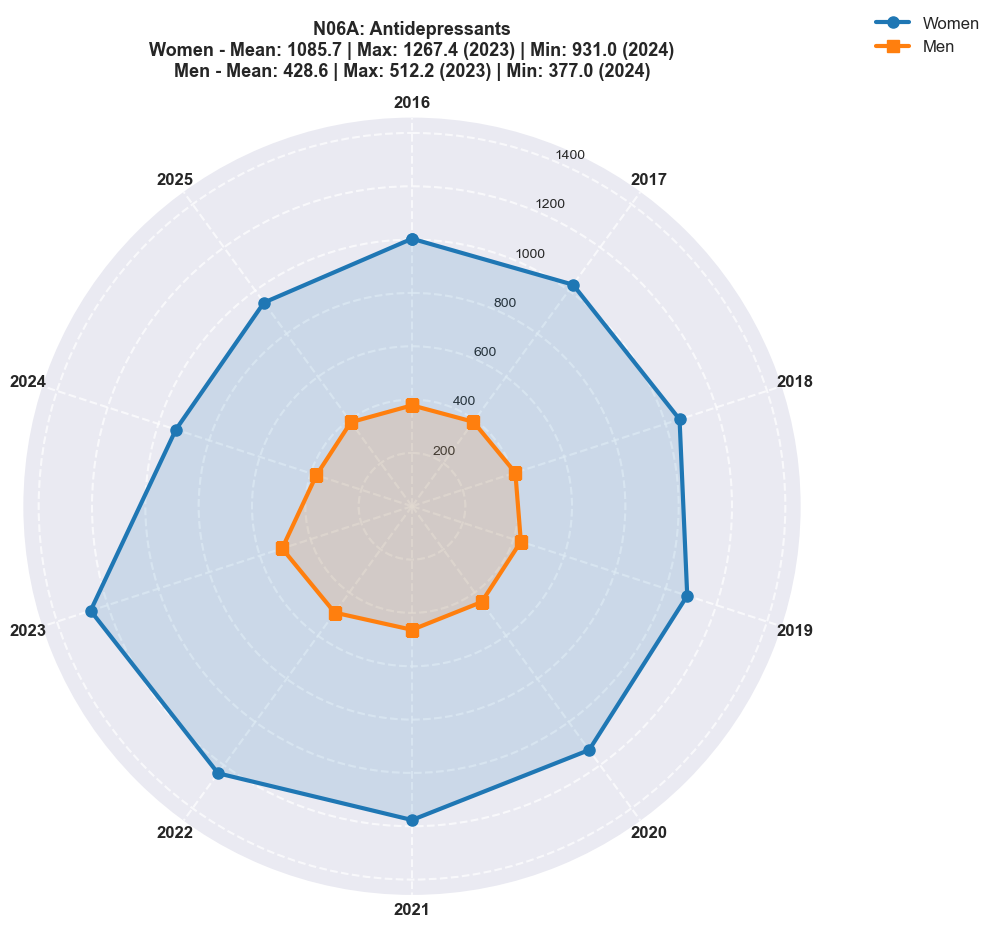


N06A - Antidepressants:
  WOMEN:
    Mean yearly prescriptions: 1085.74
    Max: 1267.4 (2023)
    Min: 931.0 (2024)
    Range: 336.4
    Year-over-year growth rate: -5.89%
    Coefficient of variation: 10.15%
  MEN:
    Mean yearly prescriptions: 428.60
    Max: 512.2 (2023)
    Min: 377.0 (2024)
    Range: 135.2
    Year-over-year growth rate: 3.00%
    Coefficient of variation: 10.71%
  COMPARISON:
    Women/Men mean ratio: 2.53


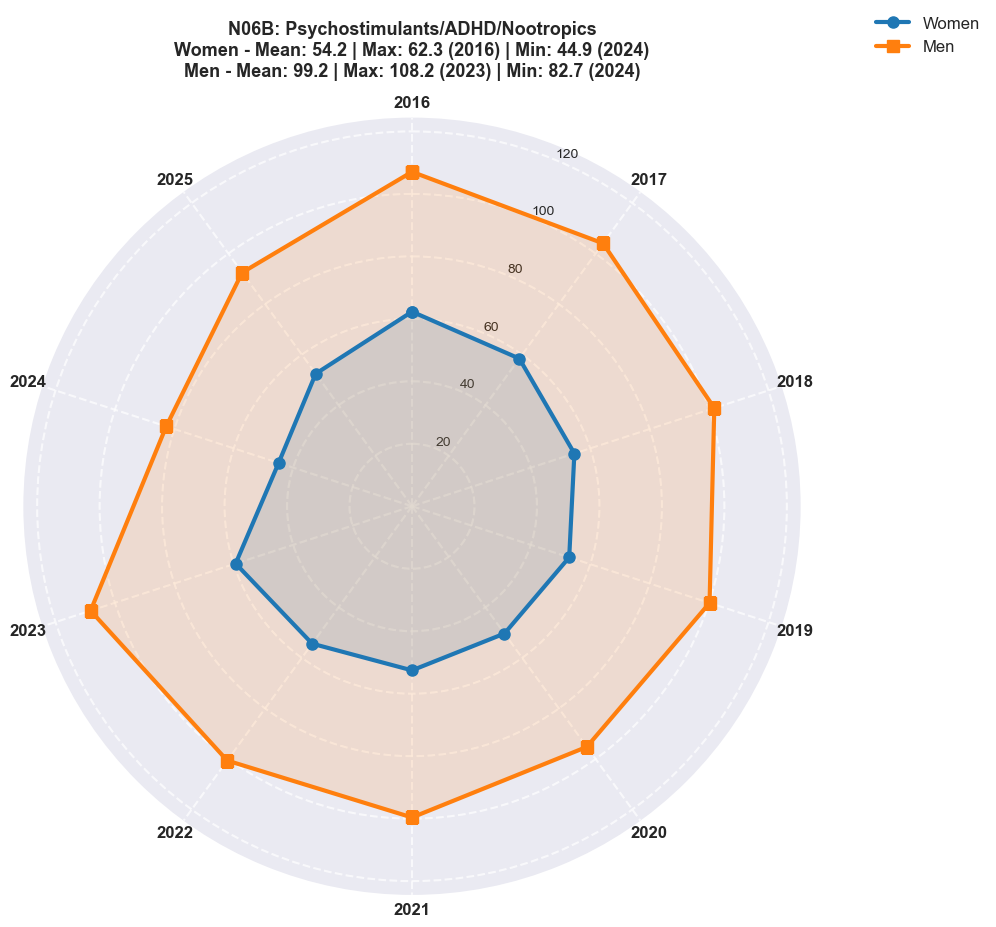


N06B - Psychostimulants/ADHD/Nootropics:
  WOMEN:
    Mean yearly prescriptions: 54.23
    Max: 62.3 (2016)
    Min: 44.9 (2024)
    Range: 17.4
    Year-over-year growth rate: -15.81%
    Coefficient of variation: 8.64%
  MEN:
    Mean yearly prescriptions: 99.19
    Max: 108.2 (2023)
    Min: 82.7 (2024)
    Range: 25.5
    Year-over-year growth rate: -13.61%
    Coefficient of variation: 7.18%
  COMPARISON:
    Women/Men mean ratio: 0.55


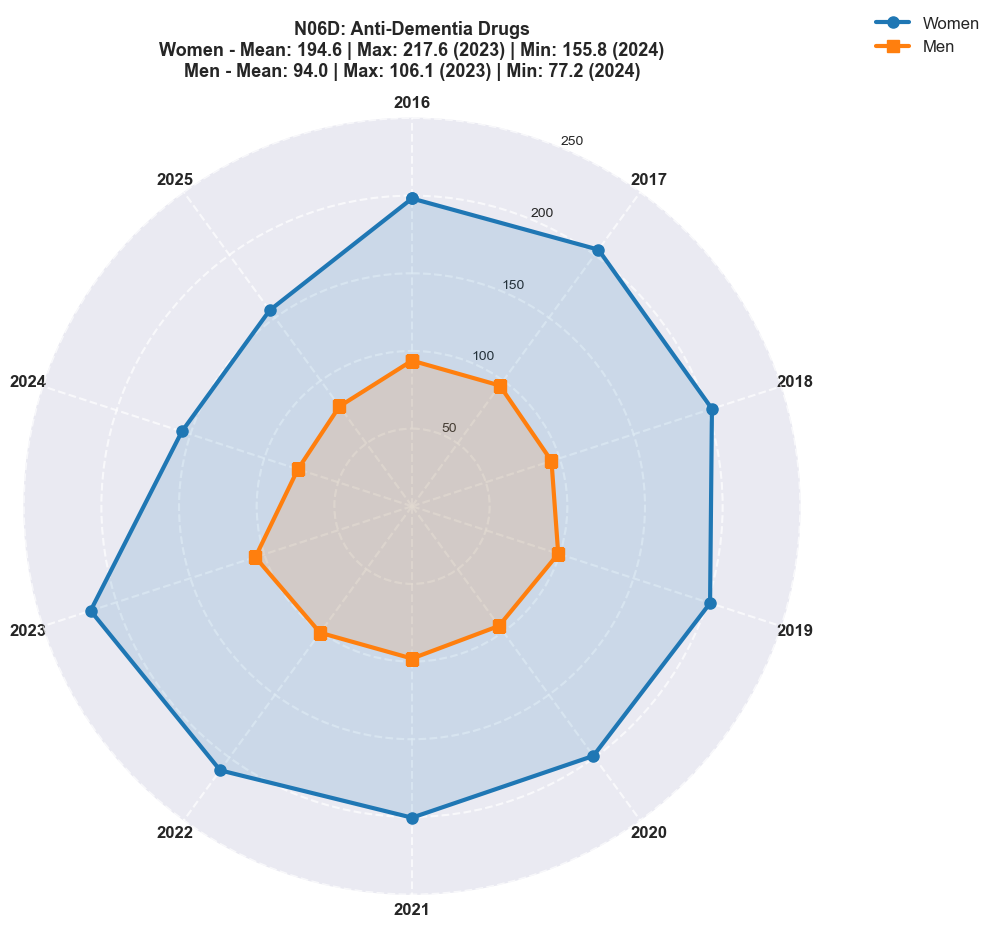


N06D - Anti-Dementia Drugs:
  WOMEN:
    Mean yearly prescriptions: 194.59
    Max: 217.6 (2023)
    Min: 155.8 (2024)
    Range: 61.8
    Year-over-year growth rate: -21.31%
    Coefficient of variation: 10.34%
  MEN:
    Mean yearly prescriptions: 94.00
    Max: 106.1 (2023)
    Min: 77.2 (2024)
    Range: 28.8
    Year-over-year growth rate: -15.23%
    Coefficient of variation: 9.09%
  COMPARISON:
    Women/Men mean ratio: 2.07


In [51]:
# Create individual larger yearly evolution radar charts for each drug category - Women vs Men
for atc_code in sorted(valid_yearly_categories):
    # Filter data for this category - both women and men
    cat_data_women = yearly_data_women[yearly_data_women['ATC_Level3'] == atc_code].copy()
    cat_data_men = yearly_data_men[yearly_data_men['ATC_Level3'] == atc_code].copy()
    cat_name = cat_data_women['MH_Category'].iloc[0]
    
    # Prepare data for radar chart - Women
    years_women = cat_data_women['any'].values
    values_women = cat_data_women['nombre de receptes'].values
    
    # Prepare data for radar chart - Men
    years_men = cat_data_men['any'].values
    values_men = cat_data_men['nombre de receptes'].values
    
    # Number of variables
    num_vars = len(years_women)
    
    # Compute angle for each axis
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    values_women_plot = list(values_women)
    values_men_plot = list(values_men)
    angles += angles[:1]
    values_women_plot += values_women_plot[:1]
    values_men_plot += values_men_plot[:1]
    
    # Create figure
    fig, ax = plt.subplots(figsize=(10, 10), subplot_kw=dict(projection='polar'))
    
    # Draw the plots - Women in blue, Men in orange
    ax.plot(angles, values_women_plot, 'o-', linewidth=3, color='#1f77b4', markersize=8, label='Women')
    ax.fill(angles, values_women_plot, alpha=0.15, color='#1f77b4')
    
    ax.plot(angles, values_men_plot, 's-', linewidth=3, color='#ff7f0e', markersize=8, label='Men')
    ax.fill(angles, values_men_plot, alpha=0.15, color='#ff7f0e')
    
    # Fix axis to go in the right order and start at 12 o'clock
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)
    
    # Draw axis labels - year labels
    ax.set_xticks(angles[:-1])
    year_labels_cat = [str(int(y)) for y in years_women]
    ax.set_xticklabels(year_labels_cat, fontsize=12, fontweight='bold')
    
    # Calculate statistics
    mean_women = np.mean(values_women)
    max_women = np.max(values_women)
    min_women = np.min(values_women)
    max_year_women = int(years_women[np.argmax(values_women)])
    min_year_women = int(years_women[np.argmin(values_women)])
    
    mean_men = np.mean(values_men)
    max_men = np.max(values_men)
    min_men = np.min(values_men)
    max_year_men = int(years_men[np.argmax(values_men)])
    min_year_men = int(years_men[np.argmin(values_men)])
    
    # Add title
    ax.set_title(f'{atc_code}: {cat_name}\n' + 
                 f'Women - Mean: {mean_women:.1f} | Max: {max_women:.1f} ({max_year_women}) | Min: {min_women:.1f} ({min_year_women})\n' +
                 f'Men - Mean: {mean_men:.1f} | Max: {max_men:.1f} ({max_year_men}) | Min: {min_men:.1f} ({min_year_men})', 
                 fontsize=13, fontweight='bold', pad=30)
    
    # Add grid
    ax.grid(True, linestyle='--', alpha=0.7, linewidth=1.5)
    
    # Set y-axis label and limits
    max_val = max(max_women, max_men)
    ax.set_ylim(0, max_val * 1.15)
    
    # Add legend
    ax.legend(loc='upper right', bbox_to_anchor=(1.25, 1.15), fontsize=12, framealpha=0.9)
    
    plt.tight_layout()
    plt.show()
    
    # Print statistics for this category
    print(f"\n{atc_code} - {cat_name}:")
    print(f"  WOMEN:")
    print(f"    Mean yearly prescriptions: {mean_women:.2f}")
    print(f"    Max: {max_women:.1f} ({max_year_women})")
    print(f"    Min: {min_women:.1f} ({min_year_women})")
    print(f"    Range: {max_women - min_women:.1f}")
    print(f"    Year-over-year growth rate: {((values_women[-1] - values_women[0]) / values_women[0] * 100):.2f}%")
    print(f"    Coefficient of variation: {(np.std(values_women) / mean_women * 100):.2f}%")
    print(f"  MEN:")
    print(f"    Mean yearly prescriptions: {mean_men:.2f}")
    print(f"    Max: {max_men:.1f} ({max_year_men})")
    print(f"    Min: {min_men:.1f} ({min_year_men})")
    print(f"    Range: {max_men - min_men:.1f}")
    print(f"    Year-over-year growth rate: {((values_men[-1] - values_men[0]) / values_men[0] * 100):.2f}%")
    print(f"    Coefficient of variation: {(np.std(values_men) / mean_men * 100):.2f}%")
    print(f"  COMPARISON:")
    print(f"    Women/Men mean ratio: {mean_women/mean_men:.2f}")

### Yearly Evolution by Age Interval

Radar charts showing yearly evolution (2016-2025) for each mental health drug category, stratified by age groups.

In [52]:
# Calculate yearly mean patient payment per prescription for each mental health drug category - separately for women and men
# Calculate per-prescription patient payment for each record
df_women_mh['patient_payment_per_rx'] = (df_women_mh['import íntegre'] - df_women_mh['import aportació CatSalut']) / df_women_mh['nombre de receptes']
df_men_mh['patient_payment_per_rx'] = (df_men_mh['import íntegre'] - df_men_mh['import aportació CatSalut']) / df_men_mh['nombre de receptes']

# THEN take the mean of the per-prescription values
yearly_payment_data_women = df_women_mh.groupby(['ATC_Level3', 'MH_Category', 'any']).agg({
    'patient_payment_per_rx': 'mean'
}).reset_index()
yearly_payment_data_women['sex'] = 'Women'

yearly_payment_data_men = df_men_mh.groupby(['ATC_Level3', 'MH_Category', 'any']).agg({
    'patient_payment_per_rx': 'mean'
}).reset_index()
yearly_payment_data_men['sex'] = 'Men'

# Filter for years 2016-2025
yearly_payment_data_women = yearly_payment_data_women[(yearly_payment_data_women['any'] >= 2016) & (yearly_payment_data_women['any'] <= 2025)]
yearly_payment_data_men = yearly_payment_data_men[(yearly_payment_data_men['any'] >= 2016) & (yearly_payment_data_men['any'] <= 2025)]

print(f"Yearly payment data shape - Women: {yearly_payment_data_women.shape}")
print(f"Yearly payment data shape - Men: {yearly_payment_data_men.shape}")
print(f"\nSample data (Women):")
print(yearly_payment_data_women.head(10))
print(f"\nSample data (Men):")
print(yearly_payment_data_men.head(10))

# Filter categories with sufficient data (at least 5 years) for both women and men
categories_women = yearly_payment_data_women['ATC_Level3'].unique()
categories_men = yearly_payment_data_men['ATC_Level3'].unique()
valid_payment_categories = []
for atc in categories_women:
    if atc in categories_men:
        if len(yearly_payment_data_women[yearly_payment_data_women['ATC_Level3'] == atc]) >= 5 and \
           len(yearly_payment_data_men[yearly_payment_data_men['ATC_Level3'] == atc]) >= 5:
            valid_payment_categories.append(atc)

print(f"\nValid categories with ≥5 years for both sexes: {valid_payment_categories}")

Yearly payment data shape - Women: (61, 5)
Yearly payment data shape - Men: (60, 5)

Sample data (Women):
  ATC_Level3     MH_Category   any  patient_payment_per_rx    sex
0       N05A  Antipsychotics  2016                0.801492  Women
1       N05A  Antipsychotics  2017                0.797097  Women
2       N05A  Antipsychotics  2018                0.803935  Women
3       N05A  Antipsychotics  2019                0.811938  Women
4       N05A  Antipsychotics  2020                0.855812  Women
5       N05A  Antipsychotics  2021                0.607454  Women
6       N05A  Antipsychotics  2022                0.602345  Women
7       N05A  Antipsychotics  2023                0.663541  Women
8       N05A  Antipsychotics  2024                0.674864  Women
9       N05A  Antipsychotics  2025                0.652439  Women

Sample data (Men):
  ATC_Level3     MH_Category   any  patient_payment_per_rx  sex
0       N05A  Antipsychotics  2016                0.834043  Men
1       N05A  Antips

### Patient Out-of-Pocket Cost - Yearly Evolution (2016-2025)

Radar charts showing the yearly evolution of the average amount paid per prescription by patients for each mental health drug category.

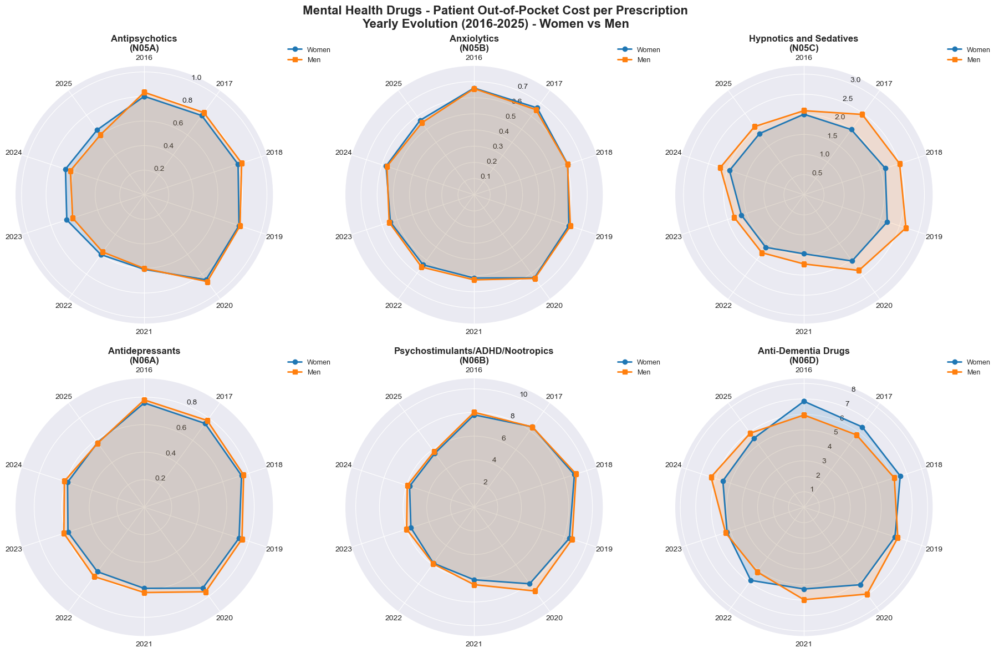


Displayed 6 categories with sufficient yearly data for both sexes


In [53]:
# Combined radar chart grid for patient payments - Yearly Evolution - Women vs Men
from math import pi
cb_colors = sns.color_palette("colorblind")

num_categories = len(valid_payment_categories)
cols = 3
rows = (num_categories + cols - 1) // cols

fig = plt.figure(figsize=(18, 6 * rows))
fig.suptitle('Mental Health Drugs - Patient Out-of-Pocket Cost per Prescription\nYearly Evolution (2016-2025) - Women vs Men', 
             fontsize=16, fontweight='bold')

for idx, atc_code in enumerate(valid_payment_categories):
    cat_data_women = yearly_payment_data_women[yearly_payment_data_women['ATC_Level3'] == atc_code].sort_values('any')
    cat_data_men = yearly_payment_data_men[yearly_payment_data_men['ATC_Level3'] == atc_code].sort_values('any')
    cat_name = cat_data_women['MH_Category'].iloc[0]
    
    # Prepare data - Women
    years_women = cat_data_women['any'].values
    values_women = cat_data_women['patient_payment_per_rx'].values
    num_vars = len(years_women)
    
    # Prepare data - Men
    years_men = cat_data_men['any'].values
    values_men = cat_data_men['patient_payment_per_rx'].values
    
    # Compute angles
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    values_women_list = list(values_women)
    values_men_list = list(values_men)
    values_women_list += values_women_list[:1]
    values_men_list += values_men_list[:1]
    angles += angles[:1]
    
    # Create subplot
    ax = plt.subplot(rows, cols, idx + 1, projection='polar')
    
    # Plot - Women in blue, Men in orange
    ax.plot(angles, values_women_list, 'o-', linewidth=2, color='#1f77b4', label='Women')
    ax.fill(angles, values_women_list, alpha=0.15, color='#1f77b4')
    
    ax.plot(angles, values_men_list, 's-', linewidth=2, color='#ff7f0e', label='Men')
    ax.fill(angles, values_men_list, alpha=0.15, color='#ff7f0e')
    
    # Configure
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels([str(int(y)) for y in years_women], size=10)
    max_val = max(max(values_women), max(values_men))
    ax.set_ylim(0, max_val * 1.2)
    ax.set_title(f'{cat_name}\n({atc_code})', size=12, fontweight='bold', pad=20)
    ax.grid(True)
    
    # Add legend
    ax.legend(loc='upper right', bbox_to_anchor=(1.25, 1.1), fontsize=9)

plt.tight_layout()
plt.show()

print(f"\nDisplayed {len(valid_payment_categories)} categories with sufficient yearly data for both sexes")

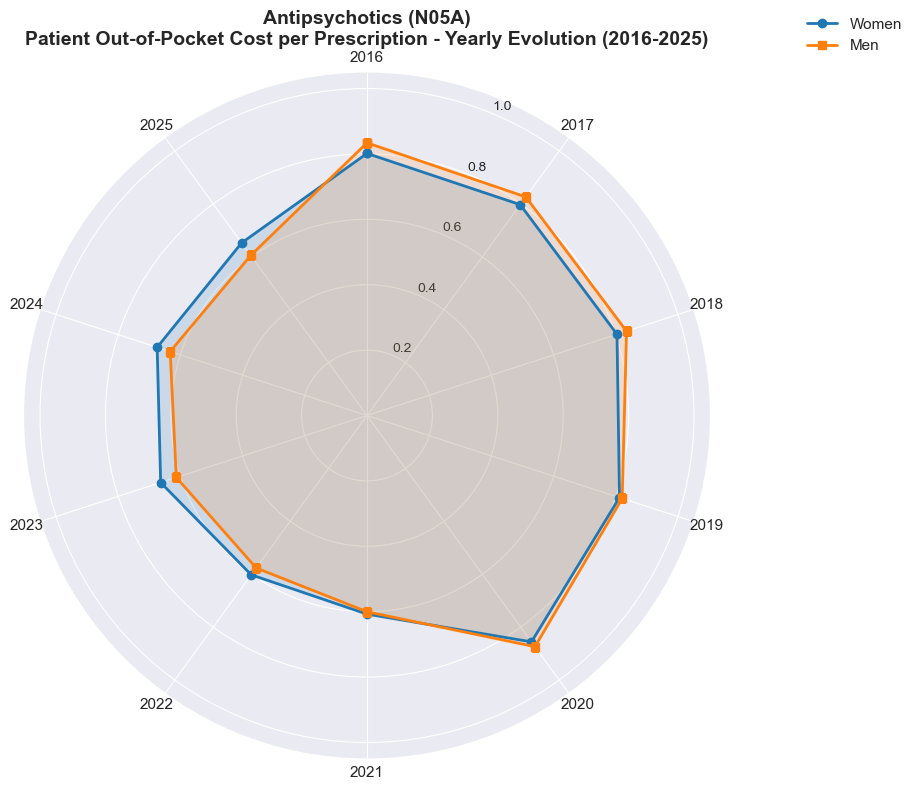


N05A - Antipsychotics:
  WOMEN:
    Mean patient payment: €0.73
    Max: €0.86 (2020)
    Min: €0.60 (2022)
    Range: €0.25
    Year-over-year change: -18.60%
    Coefficient of variation: 12.48%
  MEN:
    Mean patient payment: €0.72
    Max: €0.87 (2020)
    Min: €0.58 (2022)
    Range: €0.30
    Year-over-year change: -27.44%
    Coefficient of variation: 16.30%
  COMPARISON:
    Women/Men payment ratio: 1.01


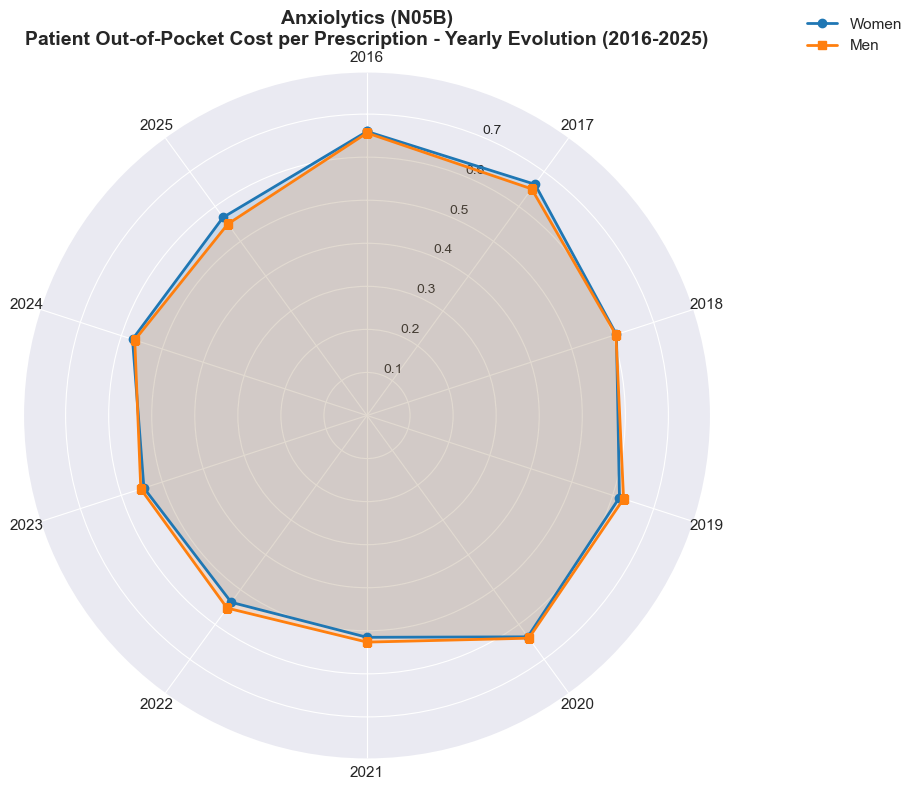


N05B - Anxiolytics:
  WOMEN:
    Mean patient payment: €0.59
    Max: €0.66 (2017)
    Min: €0.52 (2021)
    Range: €0.15
    Year-over-year change: -13.78%
    Coefficient of variation: 8.38%
  MEN:
    Mean patient payment: €0.59
    Max: €0.66 (2016)
    Min: €0.53 (2021)
    Range: €0.13
    Year-over-year change: -16.22%
    Coefficient of variation: 7.74%
  COMPARISON:
    Women/Men payment ratio: 1.00


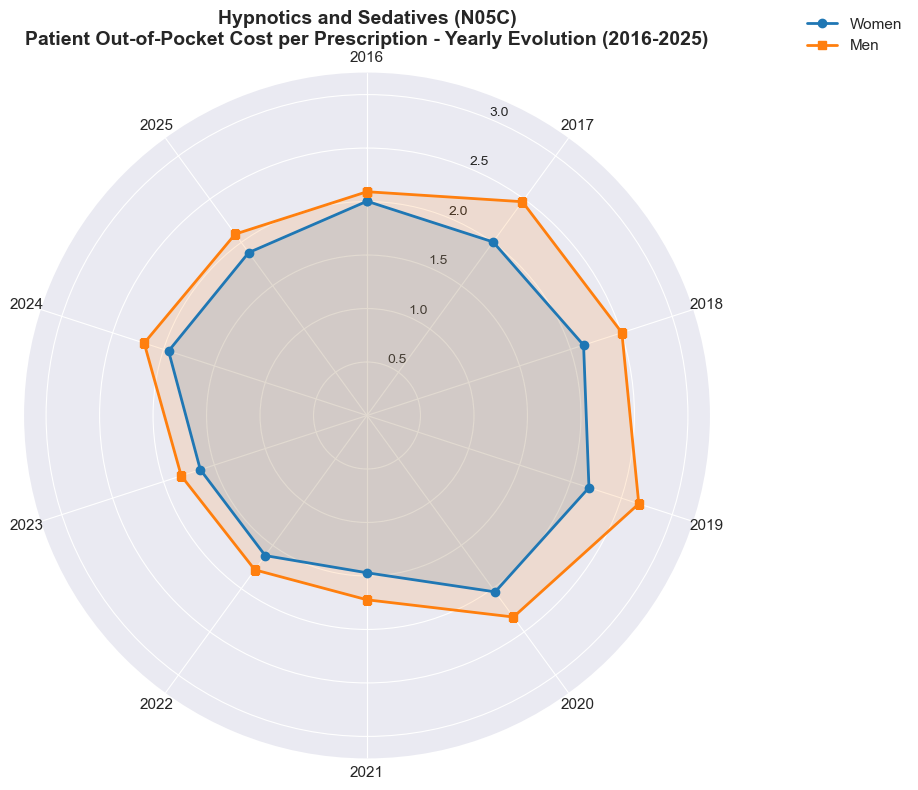


N05C - Hypnotics and Sedatives:
  WOMEN:
    Mean patient payment: €1.89
    Max: €2.18 (2019)
    Min: €1.47 (2021)
    Range: €0.71
    Year-over-year change: -6.04%
    Coefficient of variation: 11.90%
  MEN:
    Mean patient payment: €2.17
    Max: €2.67 (2019)
    Min: €1.72 (2021)
    Range: €0.95
    Year-over-year change: 0.20%
    Coefficient of variation: 14.28%
  COMPARISON:
    Women/Men payment ratio: 0.87


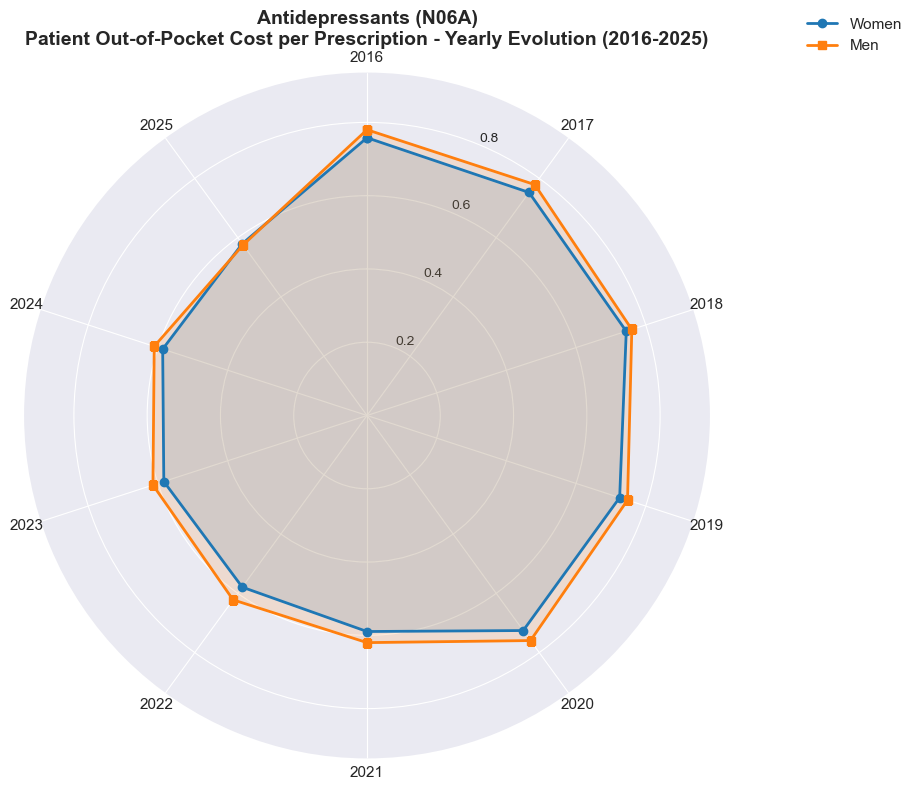


N06A - Antidepressants:
  WOMEN:
    Mean patient payment: €0.66
    Max: €0.76 (2016)
    Min: €0.58 (2022)
    Range: €0.18
    Year-over-year change: -23.57%
    Coefficient of variation: 11.99%
  MEN:
    Mean patient payment: €0.69
    Max: €0.78 (2016)
    Min: €0.58 (2025)
    Range: €0.20
    Year-over-year change: -26.23%
    Coefficient of variation: 11.61%
  COMPARISON:
    Women/Men payment ratio: 0.96


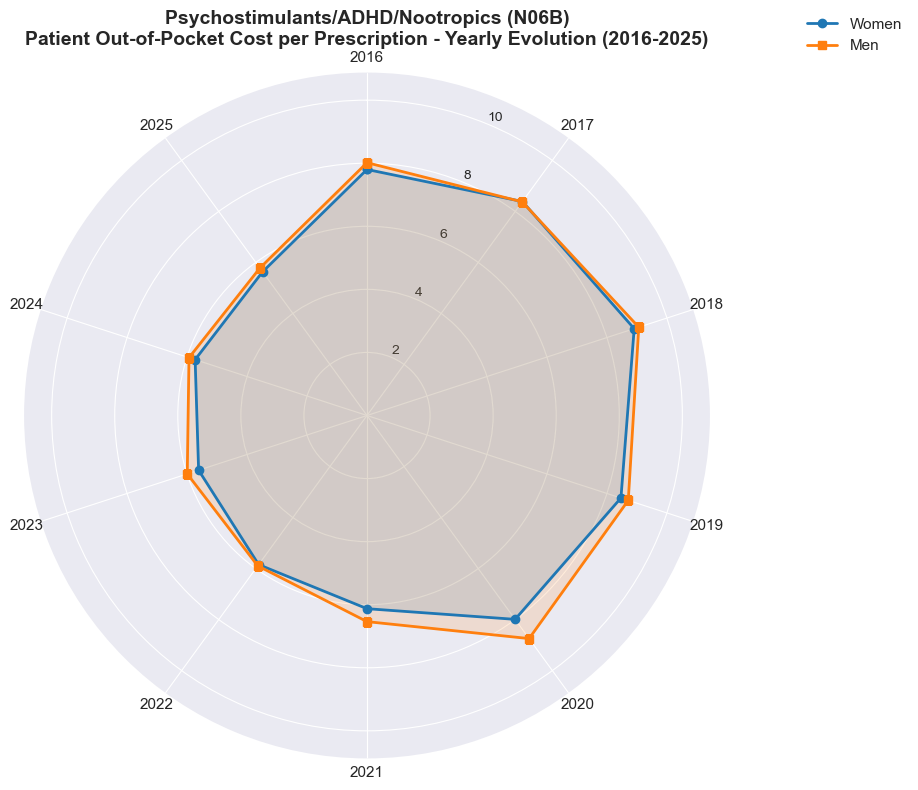


N06B - Psychostimulants/ADHD/Nootropics:
  WOMEN:
    Mean patient payment: €7.05
    Max: €8.91 (2018)
    Min: €5.61 (2023)
    Range: €3.29
    Year-over-year change: -27.80%
    Coefficient of variation: 18.39%
  MEN:
    Mean patient payment: €7.30
    Max: €9.06 (2018)
    Min: €5.78 (2025)
    Range: €3.28
    Year-over-year change: -27.91%
    Coefficient of variation: 18.00%
  COMPARISON:
    Women/Men payment ratio: 0.97


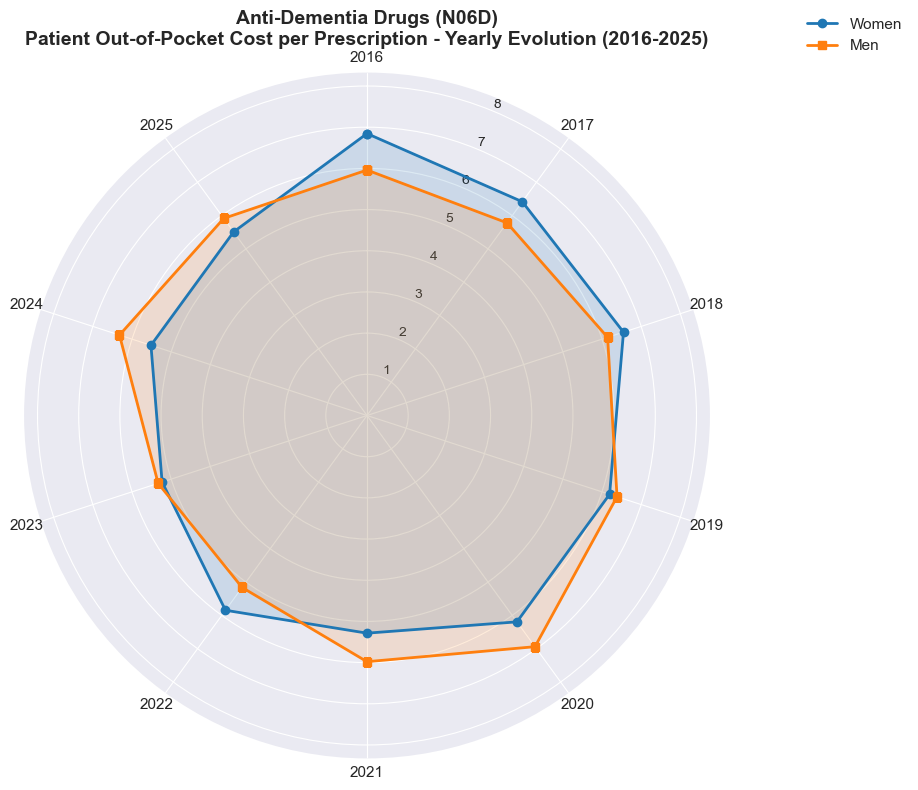


N06D - Anti-Dementia Drugs:
  WOMEN:
    Mean patient payment: €5.96
    Max: €6.85 (2016)
    Min: €5.23 (2023)
    Range: €1.61
    Year-over-year change: -19.51%
    Coefficient of variation: 8.95%
  MEN:
    Mean patient payment: €5.99
    Max: €6.94 (2020)
    Min: €5.16 (2022)
    Range: €1.78
    Year-over-year change: -0.74%
    Coefficient of variation: 8.10%
  COMPARISON:
    Women/Men payment ratio: 0.99


In [54]:
# Individual detailed radar charts for patient payment - Yearly Evolution - Women vs Men
for atc_code in valid_payment_categories:
    cat_data_women = yearly_payment_data_women[yearly_payment_data_women['ATC_Level3'] == atc_code].sort_values('any')
    cat_data_men = yearly_payment_data_men[yearly_payment_data_men['ATC_Level3'] == atc_code].sort_values('any')
    cat_name = cat_data_women['MH_Category'].iloc[0]
    
    # Prepare data - Women
    years_women = cat_data_women['any'].values
    values_women = cat_data_women['patient_payment_per_rx'].values
    num_vars = len(years_women)
    
    # Prepare data - Men
    years_men = cat_data_men['any'].values
    values_men = cat_data_men['patient_payment_per_rx'].values
    
    # Compute angles
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    values_women_plot = list(values_women) + [values_women[0]]
    values_men_plot = list(values_men) + [values_men[0]]
    angles += angles[:1]
    
    # Create figure
    fig = plt.figure(figsize=(10, 8))
    ax = plt.subplot(111, projection='polar')
    
    # Plot - Women in blue, Men in orange
    ax.plot(angles, values_women_plot, 'o-', linewidth=2, color='#1f77b4', label='Women')
    ax.fill(angles, values_women_plot, alpha=0.15, color='#1f77b4')
    
    ax.plot(angles, values_men_plot, 's-', linewidth=2, color='#ff7f0e', label='Men')
    ax.fill(angles, values_men_plot, alpha=0.15, color='#ff7f0e')
    
    # Configure
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)
    ax.set_xticks(angles[:-1])
    year_labels_cat = [str(int(y)) for y in years_women]
    ax.set_xticklabels(year_labels_cat, size=11)
    max_val = max(max(values_women), max(values_men))
    ax.set_ylim(0, max_val * 1.2)
    
    ax.set_title(f'{cat_name} ({atc_code})\nPatient Out-of-Pocket Cost per Prescription - Yearly Evolution (2016-2025)', 
                 size=14, fontweight='bold', pad=20)
    ax.grid(True)
    ax.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1), fontsize=11)
    
    plt.tight_layout()
    plt.show()
    
    # Print statistics for this category
    mean_women = np.mean(values_women)
    max_women = np.max(values_women)
    min_women = np.min(values_women)
    max_year_women = int(years_women[np.argmax(values_women)])
    min_year_women = int(years_women[np.argmin(values_women)])
    
    mean_men = np.mean(values_men)
    max_men = np.max(values_men)
    min_men = np.min(values_men)
    max_year_men = int(years_men[np.argmax(values_men)])
    min_year_men = int(years_men[np.argmin(values_men)])
    
    print(f"\n{atc_code} - {cat_name}:")
    print(f"  WOMEN:")
    print(f"    Mean patient payment: €{mean_women:.2f}")
    print(f"    Max: €{max_women:.2f} ({max_year_women})")
    print(f"    Min: €{min_women:.2f} ({min_year_women})")
    print(f"    Range: €{max_women - min_women:.2f}")
    print(f"    Year-over-year change: {((values_women[-1] - values_women[0]) / values_women[0] * 100):.2f}%")
    print(f"    Coefficient of variation: {(np.std(values_women) / mean_women * 100):.2f}%")
    print(f"  MEN:")
    print(f"    Mean patient payment: €{mean_men:.2f}")
    print(f"    Max: €{max_men:.2f} ({max_year_men})")
    print(f"    Min: €{min_men:.2f} ({min_year_men})")
    print(f"    Range: €{max_men - min_men:.2f}")
    print(f"    Year-over-year change: {((values_men[-1] - values_men[0]) / values_men[0] * 100):.2f}%")
    print(f"    Coefficient of variation: {(np.std(values_men) / mean_men * 100):.2f}%")
    print(f"  COMPARISON:")
    print(f"    Women/Men payment ratio: {mean_women/mean_men:.2f}")

In [55]:
# Calculate yearly mean government payment fraction for each mental health drug category - separately for women and men
# Government fraction = (government contribution / total cost) * 100
df_women_mh['gov_fraction'] = (df_women_mh['import aportació CatSalut'] / df_women_mh['import íntegre']) * 100
df_men_mh['gov_fraction'] = (df_men_mh['import aportació CatSalut'] / df_men_mh['import íntegre']) * 100

yearly_gov_fraction_data_women = df_women_mh.groupby(['ATC_Level3', 'MH_Category', 'any']).agg({
    'gov_fraction': 'mean'
}).reset_index()
yearly_gov_fraction_data_women['sex'] = 'Women'

yearly_gov_fraction_data_men = df_men_mh.groupby(['ATC_Level3', 'MH_Category', 'any']).agg({
    'gov_fraction': 'mean'
}).reset_index()
yearly_gov_fraction_data_men['sex'] = 'Men'

# Filter for years 2016-2025
yearly_gov_fraction_data_women = yearly_gov_fraction_data_women[(yearly_gov_fraction_data_women['any'] >= 2016) & (yearly_gov_fraction_data_women['any'] <= 2025)]
yearly_gov_fraction_data_men = yearly_gov_fraction_data_men[(yearly_gov_fraction_data_men['any'] >= 2016) & (yearly_gov_fraction_data_men['any'] <= 2025)]

print(f"Yearly government fraction data shape - Women: {yearly_gov_fraction_data_women.shape}")
print(f"Yearly government fraction data shape - Men: {yearly_gov_fraction_data_men.shape}")
print(f"\nSample data (Women):")
print(yearly_gov_fraction_data_women.head(10))
print(f"\nSample data (Men):")
print(yearly_gov_fraction_data_men.head(10))

# Filter categories with sufficient data (at least 5 years) for both women and men
categories_women = yearly_gov_fraction_data_women['ATC_Level3'].unique()
categories_men = yearly_gov_fraction_data_men['ATC_Level3'].unique()
valid_gov_categories = []
for atc in categories_women:
    if atc in categories_men:
        if len(yearly_gov_fraction_data_women[yearly_gov_fraction_data_women['ATC_Level3'] == atc]) >= 5 and \
           len(yearly_gov_fraction_data_men[yearly_gov_fraction_data_men['ATC_Level3'] == atc]) >= 5:
            valid_gov_categories.append(atc)

print(f"\nValid categories with ≥5 years for both sexes: {valid_gov_categories}")

Yearly government fraction data shape - Women: (61, 5)
Yearly government fraction data shape - Men: (60, 5)

Sample data (Women):
  ATC_Level3     MH_Category   any  gov_fraction    sex
0       N05A  Antipsychotics  2016     94.082412  Women
1       N05A  Antipsychotics  2017     94.116134  Women
2       N05A  Antipsychotics  2018     94.002413  Women
3       N05A  Antipsychotics  2019     93.998517  Women
4       N05A  Antipsychotics  2020     93.960508  Women
5       N05A  Antipsychotics  2021     96.129462  Women
6       N05A  Antipsychotics  2022     96.320202  Women
7       N05A  Antipsychotics  2023     96.191033  Women
8       N05A  Antipsychotics  2024     96.056007  Women
9       N05A  Antipsychotics  2025     96.055502  Women

Sample data (Men):
  ATC_Level3     MH_Category   any  gov_fraction  sex
0       N05A  Antipsychotics  2016     94.078993  Men
1       N05A  Antipsychotics  2017     94.046855  Men
2       N05A  Antipsychotics  2018     93.981633  Men
3       N05A  Anti

### Government Payment Fraction - Yearly Evolution (2016-2025)

Analysis of the percentage of prescription costs covered by CatSalut (government) over time.

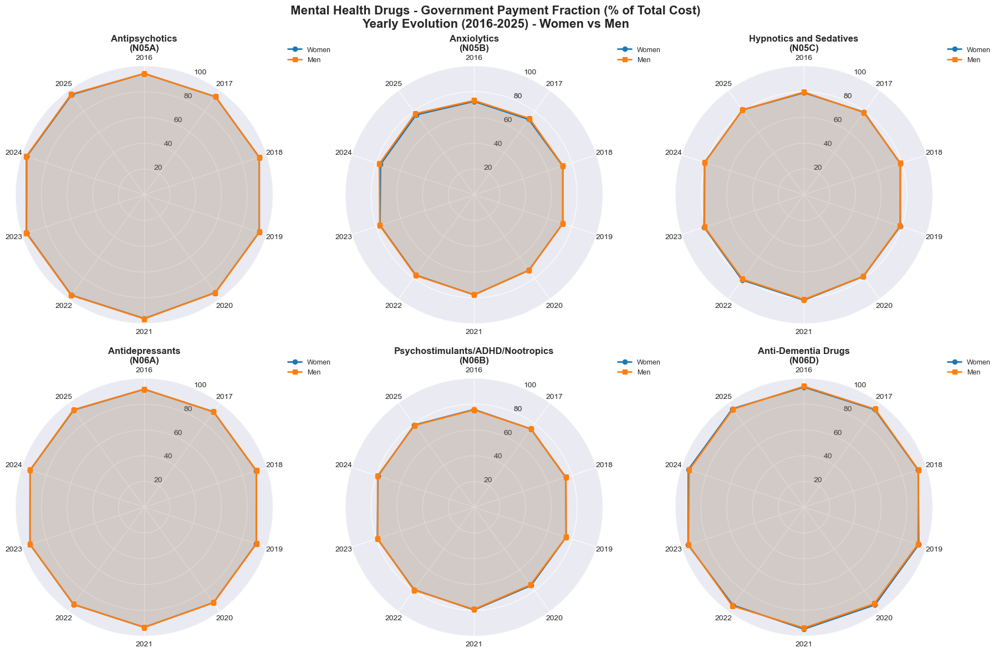


Displayed 6 categories with sufficient yearly data for both sexes


In [56]:
# Combined radar chart grid for government payment fraction - Women vs Men
import matplotlib.pyplot as plt
from math import pi
cb_colors = sns.color_palette("colorblind")

num_categories = len(valid_gov_categories)
cols = 3
rows = (num_categories + cols - 1) // cols

fig = plt.figure(figsize=(18, 6 * rows))
fig.suptitle('Mental Health Drugs - Government Payment Fraction (% of Total Cost)\nYearly Evolution (2016-2025) - Women vs Men', 
             fontsize=16, fontweight='bold')

for idx, atc_code in enumerate(valid_gov_categories):
    cat_data_women = yearly_gov_fraction_data_women[yearly_gov_fraction_data_women['ATC_Level3'] == atc_code].sort_values('any')
    cat_data_men = yearly_gov_fraction_data_men[yearly_gov_fraction_data_men['ATC_Level3'] == atc_code].sort_values('any')
    cat_name = cat_data_women['MH_Category'].iloc[0]
    
    # Prepare data - Women
    years_women = cat_data_women['any'].values
    values_women = cat_data_women['gov_fraction'].values
    num_vars = len(years_women)
    
    # Prepare data - Men
    years_men = cat_data_men['any'].values
    values_men = cat_data_men['gov_fraction'].values
    
    # Compute angles
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    values_women_list = list(values_women)
    values_men_list = list(values_men)
    values_women_list += values_women_list[:1]
    values_men_list += values_men_list[:1]
    angles += angles[:1]
    
    # Create subplot
    ax = plt.subplot(rows, cols, idx + 1, projection='polar')
    
    # Plot - Women in blue, Men in orange
    ax.plot(angles, values_women_list, 'o-', linewidth=2, color='#1f77b4', label='Women')
    ax.fill(angles, values_women_list, alpha=0.15, color='#1f77b4')
    
    ax.plot(angles, values_men_list, 's-', linewidth=2, color='#ff7f0e', label='Men')
    ax.fill(angles, values_men_list, alpha=0.15, color='#ff7f0e')
    
    # Configure
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels([str(int(y)) for y in years_women], size=10)
    ax.set_ylim(0, 100)  # Percentage scale from 0 to 100%
    ax.set_title(f'{cat_name}\n({atc_code})', size=12, fontweight='bold', pad=20)
    ax.grid(True)
    
    # Add legend
    ax.legend(loc='upper right', bbox_to_anchor=(1.25, 1.1), fontsize=9)

plt.tight_layout()
plt.show()

print(f"\nDisplayed {len(valid_gov_categories)} categories with sufficient yearly data for both sexes")

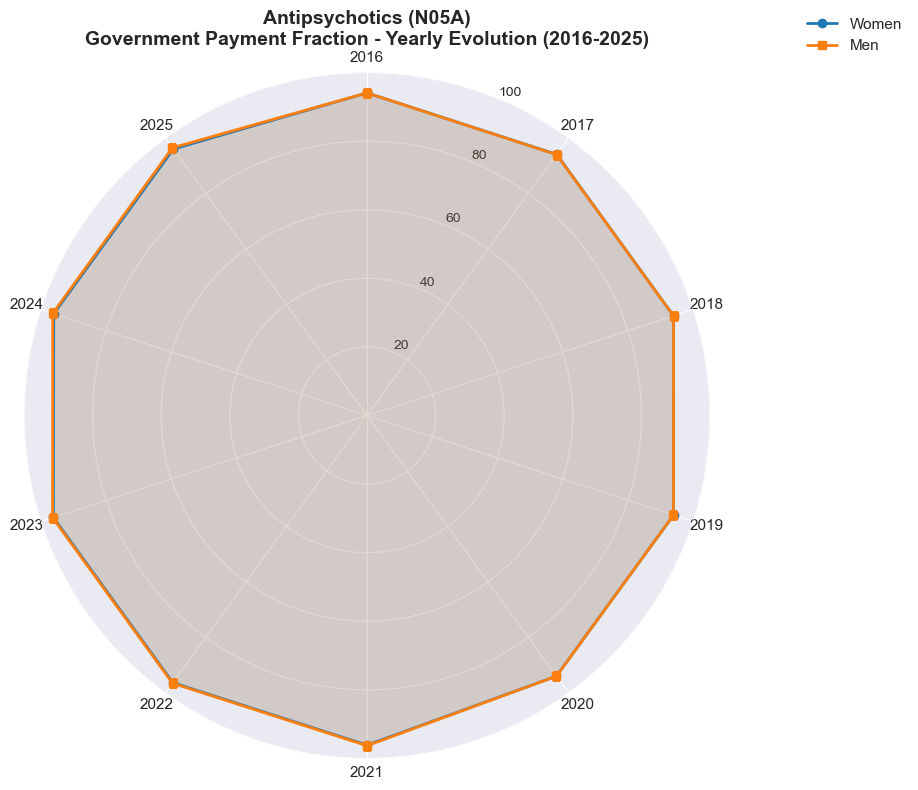


Antipsychotics (N05A) - Government Payment Statistics:
  WOMEN:
    Mean government fraction: 95.09%
    Max: 96.32% (2022)
    Min: 93.96% (2020)
    Range: 2.36 percentage points
    Year-over-year change: 1.97 percentage points
    Coefficient of variation: 1.12%
  MEN:
    Mean government fraction: 95.21%
    Max: 96.51% (2025)
    Min: 93.98% (2019)
    Range: 2.53 percentage points
    Year-over-year change: 2.43 percentage points
    Coefficient of variation: 1.26%
  COMPARISON:
    Women - Men difference: -0.12 percentage points


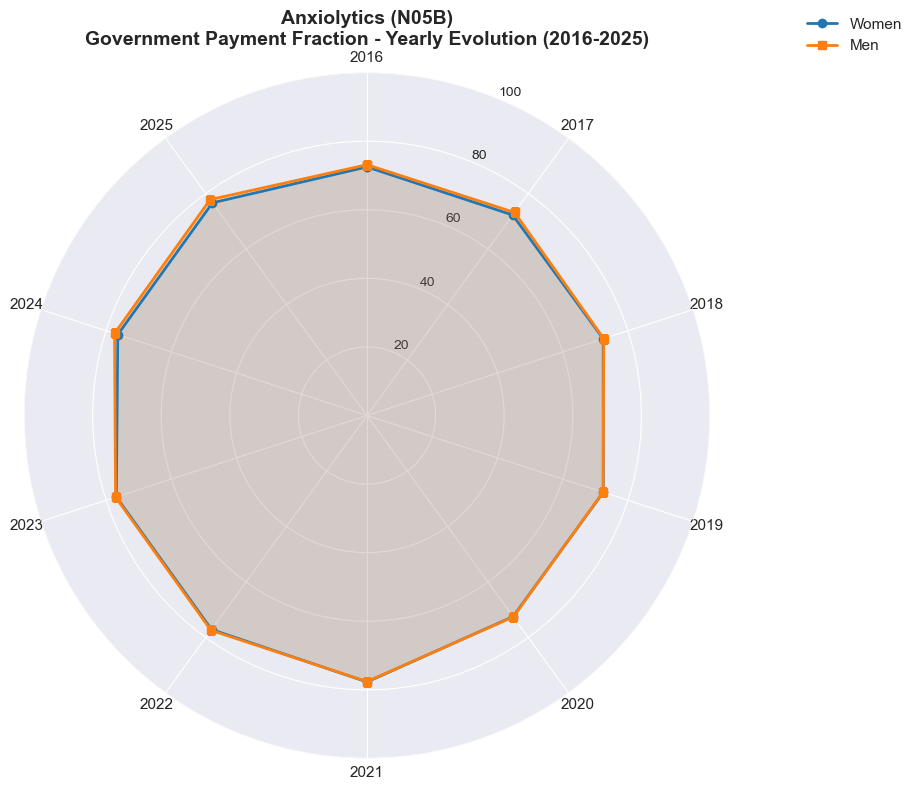


Anxiolytics (N05B) - Government Payment Statistics:
  WOMEN:
    Mean government fraction: 74.69%
    Max: 77.71% (2021)
    Min: 72.26% (2017)
    Range: 5.44 percentage points
    Year-over-year change: 4.19 percentage points
    Coefficient of variation: 3.07%
  MEN:
    Mean government fraction: 75.12%
    Max: 77.82% (2025)
    Min: 72.38% (2019)
    Range: 5.43 percentage points
    Year-over-year change: 4.68 percentage points
    Coefficient of variation: 3.15%
  COMPARISON:
    Women - Men difference: -0.43 percentage points


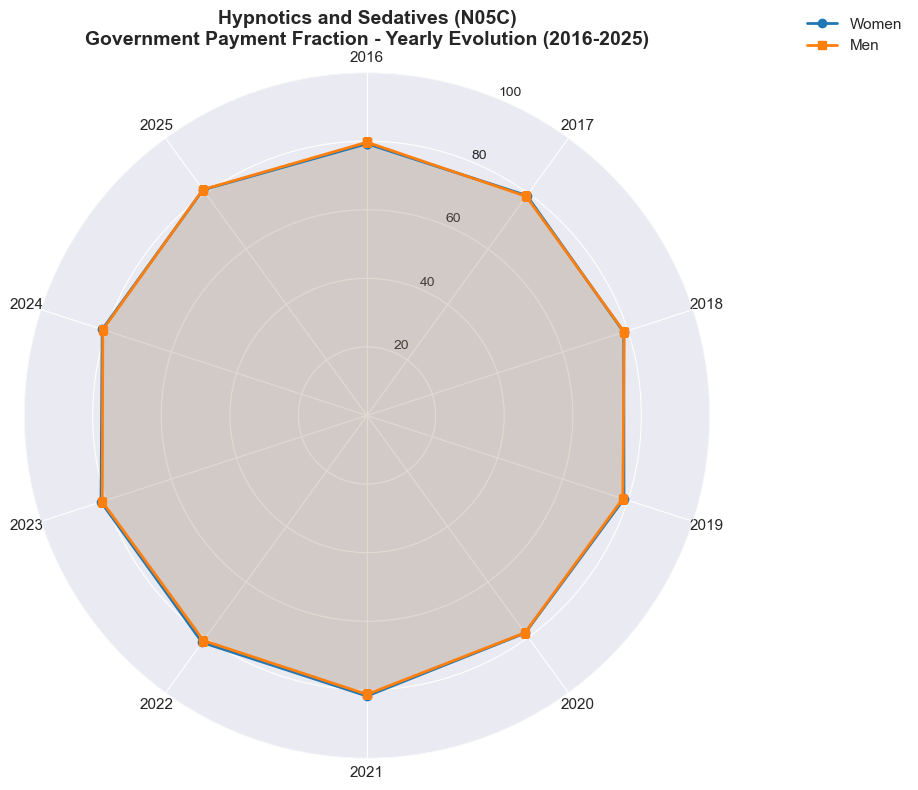


Hypnotics and Sedatives (N05C) - Government Payment Statistics:
  WOMEN:
    Mean government fraction: 80.22%
    Max: 81.81% (2021)
    Min: 78.43% (2020)
    Range: 3.38 percentage points
    Year-over-year change: 2.10 percentage points
    Coefficient of variation: 1.69%
  MEN:
    Mean government fraction: 80.04%
    Max: 81.43% (2025)
    Min: 78.32% (2020)
    Range: 3.11 percentage points
    Year-over-year change: 1.73 percentage points
    Coefficient of variation: 1.54%
  COMPARISON:
    Women - Men difference: 0.18 percentage points


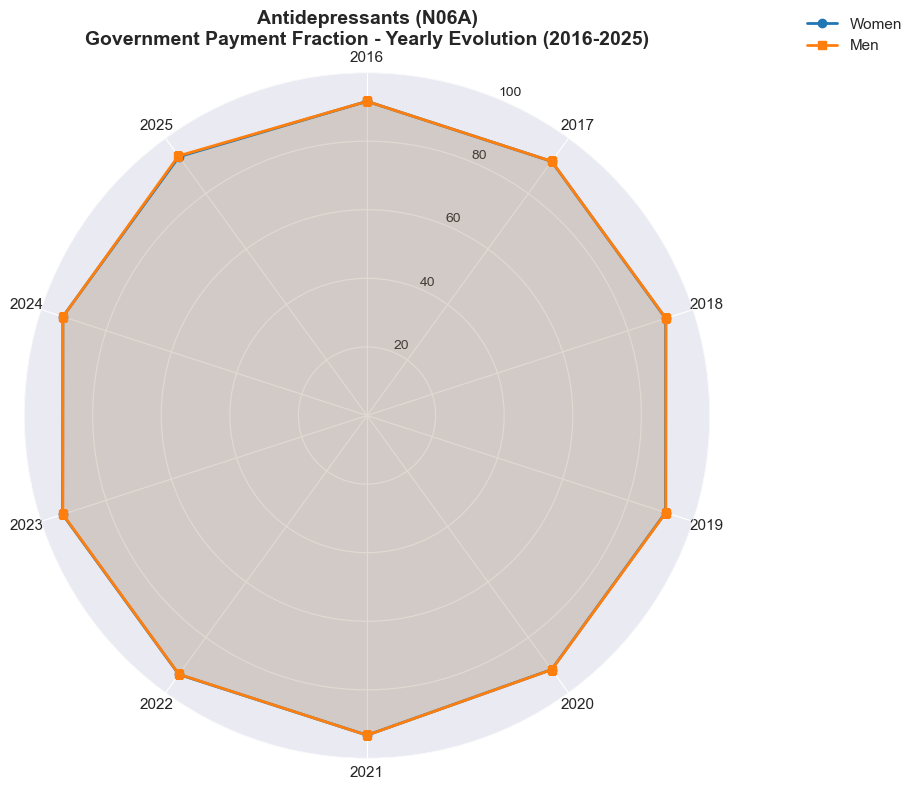


Antidepressants (N06A) - Government Payment Statistics:
  WOMEN:
    Mean government fraction: 92.44%
    Max: 93.35% (2022)
    Min: 91.55% (2019)
    Range: 1.81 percentage points
    Year-over-year change: 1.67 percentage points
    Coefficient of variation: 0.92%
  MEN:
    Mean government fraction: 92.47%
    Max: 93.55% (2025)
    Min: 91.61% (2020)
    Range: 1.94 percentage points
    Year-over-year change: 1.93 percentage points
    Coefficient of variation: 0.92%
  COMPARISON:
    Women - Men difference: -0.03 percentage points


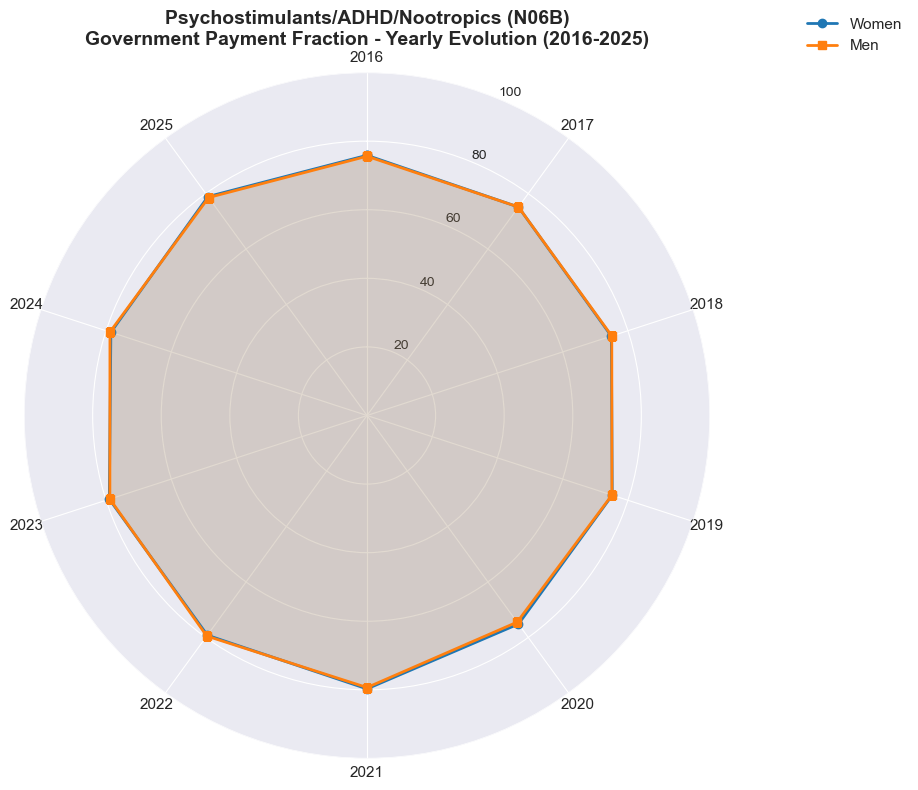


Psychostimulants/ADHD/Nootropics (N06B) - Government Payment Statistics:
  WOMEN:
    Mean government fraction: 77.17%
    Max: 79.72% (2021)
    Min: 74.92% (2018)
    Range: 4.80 percentage points
    Year-over-year change: 3.03 percentage points
    Coefficient of variation: 2.52%
  MEN:
    Mean government fraction: 77.04%
    Max: 79.50% (2022)
    Min: 74.48% (2020)
    Range: 5.02 percentage points
    Year-over-year change: 2.97 percentage points
    Coefficient of variation: 2.59%
  COMPARISON:
    Women - Men difference: 0.12 percentage points


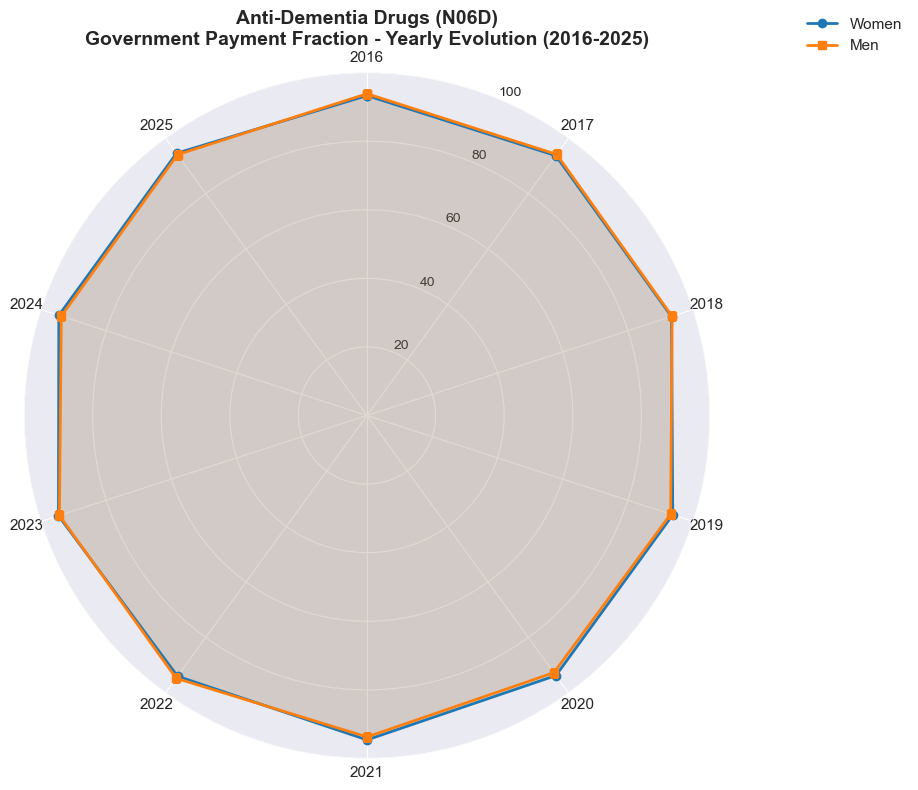


Anti-Dementia Drugs (N06D) - Government Payment Statistics:
  WOMEN:
    Mean government fraction: 94.00%
    Max: 94.60% (2023)
    Min: 93.29% (2016)
    Range: 1.31 percentage points
    Year-over-year change: 1.22 percentage points
    Coefficient of variation: 0.52%
  MEN:
    Mean government fraction: 93.78%
    Max: 94.71% (2022)
    Min: 92.70% (2020)
    Range: 2.01 percentage points
    Year-over-year change: 0.18 percentage points
    Coefficient of variation: 0.58%
  COMPARISON:
    Women - Men difference: 0.22 percentage points


In [57]:
# Individual detailed radar charts for government fraction - Yearly Evolution - Women vs Men
for atc_code in valid_gov_categories:
    cat_data_women = yearly_gov_fraction_data_women[yearly_gov_fraction_data_women['ATC_Level3'] == atc_code].sort_values('any')
    cat_data_men = yearly_gov_fraction_data_men[yearly_gov_fraction_data_men['ATC_Level3'] == atc_code].sort_values('any')
    cat_name = cat_data_women['MH_Category'].iloc[0]
    
    # Prepare data - Women
    years_women = cat_data_women['any'].values
    values_women = cat_data_women['gov_fraction'].values
    num_vars = len(years_women)
    
    # Prepare data - Men
    years_men = cat_data_men['any'].values
    values_men = cat_data_men['gov_fraction'].values
    
    # Compute angles
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    values_women_plot = list(values_women) + [values_women[0]]
    values_men_plot = list(values_men) + [values_men[0]]
    angles += angles[:1]
    
    # Create figure
    fig = plt.figure(figsize=(10, 8))
    ax = plt.subplot(111, projection='polar')
    
    # Plot - Women in blue, Men in orange
    ax.plot(angles, values_women_plot, 'o-', linewidth=2, color='#1f77b4', label='Women')
    ax.fill(angles, values_women_plot, alpha=0.15, color='#1f77b4')
    
    ax.plot(angles, values_men_plot, 's-', linewidth=2, color='#ff7f0e', label='Men')
    ax.fill(angles, values_men_plot, alpha=0.15, color='#ff7f0e')
    
    # Configure
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)
    ax.set_xticks(angles[:-1])
    year_labels_cat = [str(int(y)) for y in years_women]
    ax.set_xticklabels(year_labels_cat, size=11)
    ax.set_ylim(0, 100)  # Percentage scale from 0 to 100%
    
    ax.set_title(f'{cat_name} ({atc_code})\nGovernment Payment Fraction - Yearly Evolution (2016-2025)', 
                 size=14, fontweight='bold', pad=20)
    ax.grid(True)
    ax.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1), fontsize=11)
    
    plt.tight_layout()
    plt.show()
    
    # Calculate and display statistics
    mean_women = np.mean(values_women)
    max_women = np.max(values_women)
    min_women = np.min(values_women)
    max_year_women = int(years_women[np.argmax(values_women)])
    min_year_women = int(years_women[np.argmin(values_women)])
    
    mean_men = np.mean(values_men)
    max_men = np.max(values_men)
    min_men = np.min(values_men)
    max_year_men = int(years_men[np.argmax(values_men)])
    min_year_men = int(years_men[np.argmin(values_men)])
    
    print(f"\n{cat_name} ({atc_code}) - Government Payment Statistics:")
    print(f"  WOMEN:")
    print(f"    Mean government fraction: {mean_women:.2f}%")
    print(f"    Max: {max_women:.2f}% ({max_year_women})")
    print(f"    Min: {min_women:.2f}% ({min_year_women})")
    print(f"    Range: {max_women - min_women:.2f} percentage points")
    print(f"    Year-over-year change: {(values_women[-1] - values_women[0]):.2f} percentage points")
    print(f"    Coefficient of variation: {(np.std(values_women) / mean_women * 100):.2f}%")
    print(f"  MEN:")
    print(f"    Mean government fraction: {mean_men:.2f}%")
    print(f"    Max: {max_men:.2f}% ({max_year_men})")
    print(f"    Min: {min_men:.2f}% ({min_year_men})")
    print(f"    Range: {max_men - min_men:.2f} percentage points")
    print(f"    Year-over-year change: {(values_men[-1] - values_men[0]):.2f} percentage points")
    print(f"    Coefficient of variation: {(np.std(values_men) / mean_men * 100):.2f}%")
    print(f"  COMPARISON:")
    print(f"    Women - Men difference: {mean_women - mean_men:.2f} percentage points")

In [58]:
# Aggregate total prescriptions by drug category and year - separately for women and men
yearly_rx_by_category_women = df_women_mh.groupby(['ATC_Level3', 'MH_Category', 'any']).agg({
    'nombre de receptes': 'sum'
}).reset_index()
yearly_rx_by_category_women['sex'] = 'Women'

yearly_rx_by_category_men = df_men_mh.groupby(['ATC_Level3', 'MH_Category', 'any']).agg({
    'nombre de receptes': 'sum'
}).reset_index()
yearly_rx_by_category_men['sex'] = 'Men'

# Filter for years 2017-2025
yearly_rx_by_category_women = yearly_rx_by_category_women[(yearly_rx_by_category_women['any'] >= 2016) & (yearly_rx_by_category_women['any'] <= 2025)]
yearly_rx_by_category_men = yearly_rx_by_category_men[(yearly_rx_by_category_men['any'] >= 2016) & (yearly_rx_by_category_men['any'] <= 2025)]

print(f"Yearly prescription data shape - Women: {yearly_rx_by_category_women.shape}")
print(f"Yearly prescription data shape - Men: {yearly_rx_by_category_men.shape}")
print(f"\nAvailable years: {sorted(yearly_rx_by_category_women['any'].unique())}")
print(f"Drug categories (Women): {len(yearly_rx_by_category_women['ATC_Level3'].unique())}")
print(f"Drug categories (Men): {len(yearly_rx_by_category_men['ATC_Level3'].unique())}")
print(f"\nSample data (Women):")
print(yearly_rx_by_category_women.head(10))
print(f"\nSample data (Men):")
print(yearly_rx_by_category_men.head(10))

Yearly prescription data shape - Women: (61, 5)
Yearly prescription data shape - Men: (60, 5)

Available years: [2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023, 2024, 2025]
Drug categories (Women): 7
Drug categories (Men): 6

Sample data (Women):
  ATC_Level3     MH_Category   any  nombre de receptes    sex
0       N05A  Antipsychotics  2016             1166729  Women
1       N05A  Antipsychotics  2017             1209082  Women
2       N05A  Antipsychotics  2018             1253194  Women
3       N05A  Antipsychotics  2019             1300628  Women
4       N05A  Antipsychotics  2020             1350931  Women
5       N05A  Antipsychotics  2021             1422302  Women
6       N05A  Antipsychotics  2022             1487091  Women
7       N05A  Antipsychotics  2023             1544178  Women
8       N05A  Antipsychotics  2024             1632339  Women
9       N05A  Antipsychotics  2025             1257805  Women

Sample data (Men):
  ATC_Level3     MH_Category   any  nombre de recep

### Yearly Snapshot - Prescription Volume by Drug Category

Radar charts showing the number of prescriptions for each mental health drug category for women (all ages), one chart per year from 2016 to 2025.

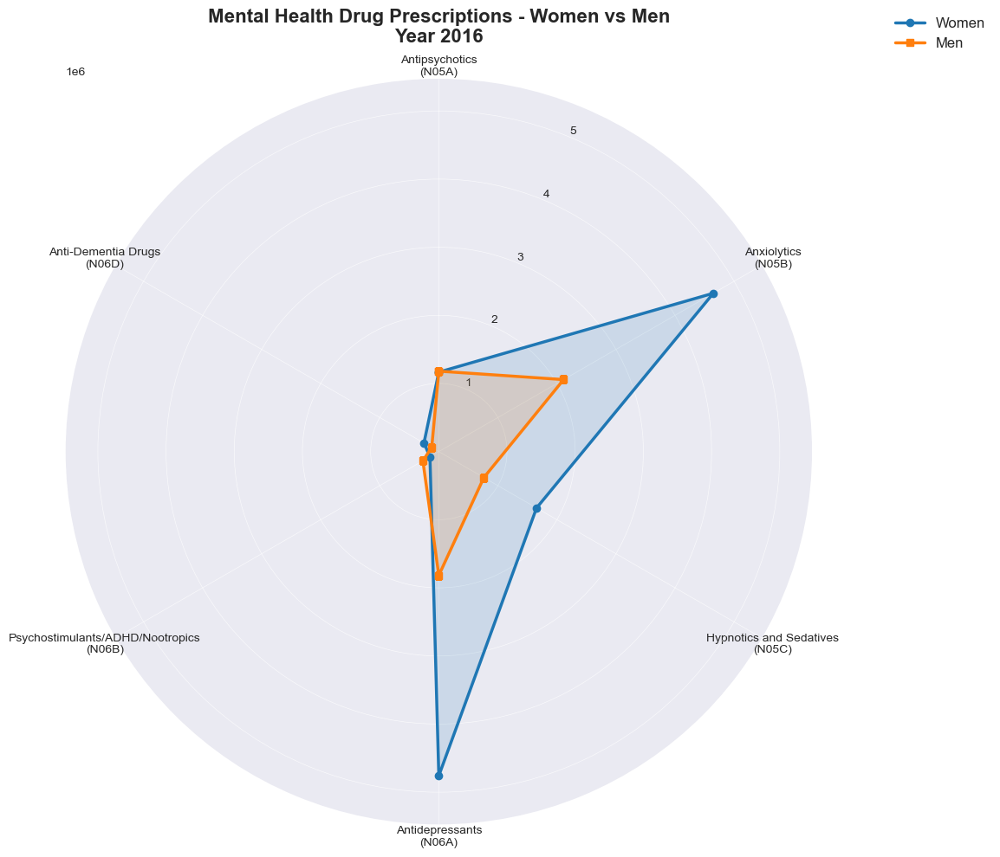


2016 Statistics:
  WOMEN:
    Total prescriptions: 12,631,681
    Highest: Antidepressants with 4,758,838 prescriptions (37.7%)
    Mean per category: 2,105,280
  MEN:
    Total prescriptions: 6,265,036
    Highest: Anxiolytics with 2,113,760 prescriptions (33.7%)
    Mean per category: 1,044,172
  COMPARISON:
    Women/Men total ratio: 2.02


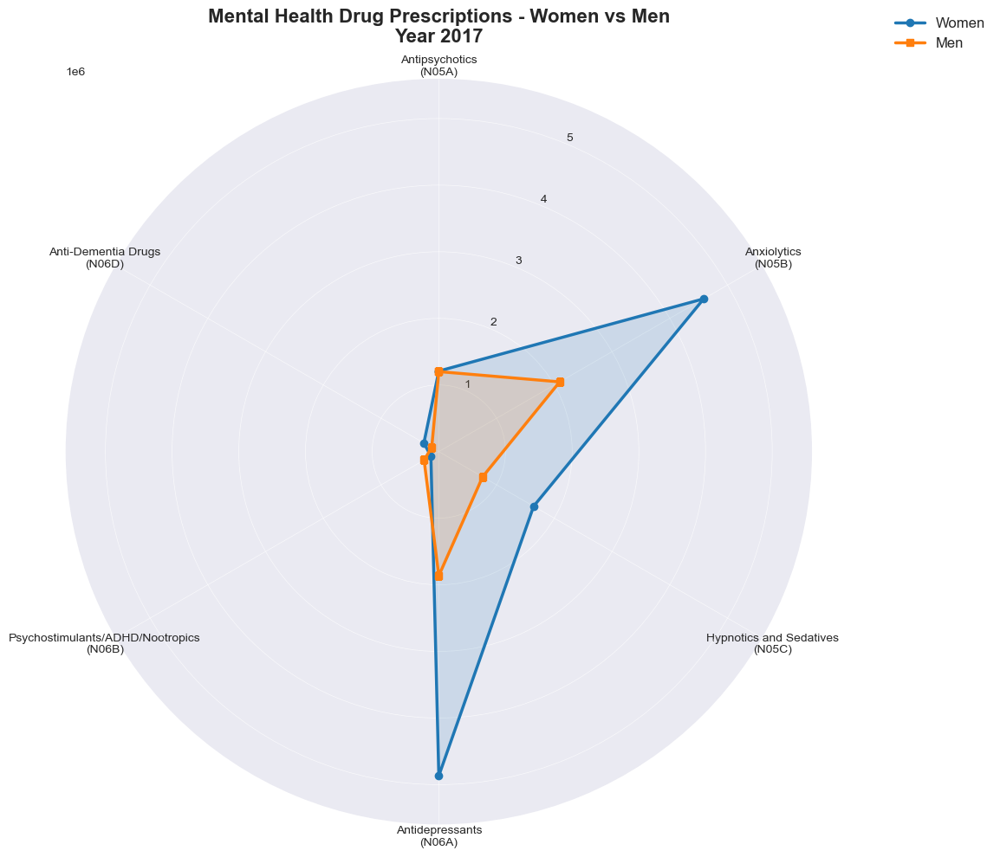


2017 Statistics:
  WOMEN:
    Total prescriptions: 12,700,712
    Highest: Antidepressants with 4,866,664 prescriptions (38.3%)
    Mean per category: 2,116,785
  MEN:
    Total prescriptions: 6,294,435
    Highest: Anxiolytics with 2,093,390 prescriptions (33.3%)
    Mean per category: 1,049,072
  COMPARISON:
    Women/Men total ratio: 2.02


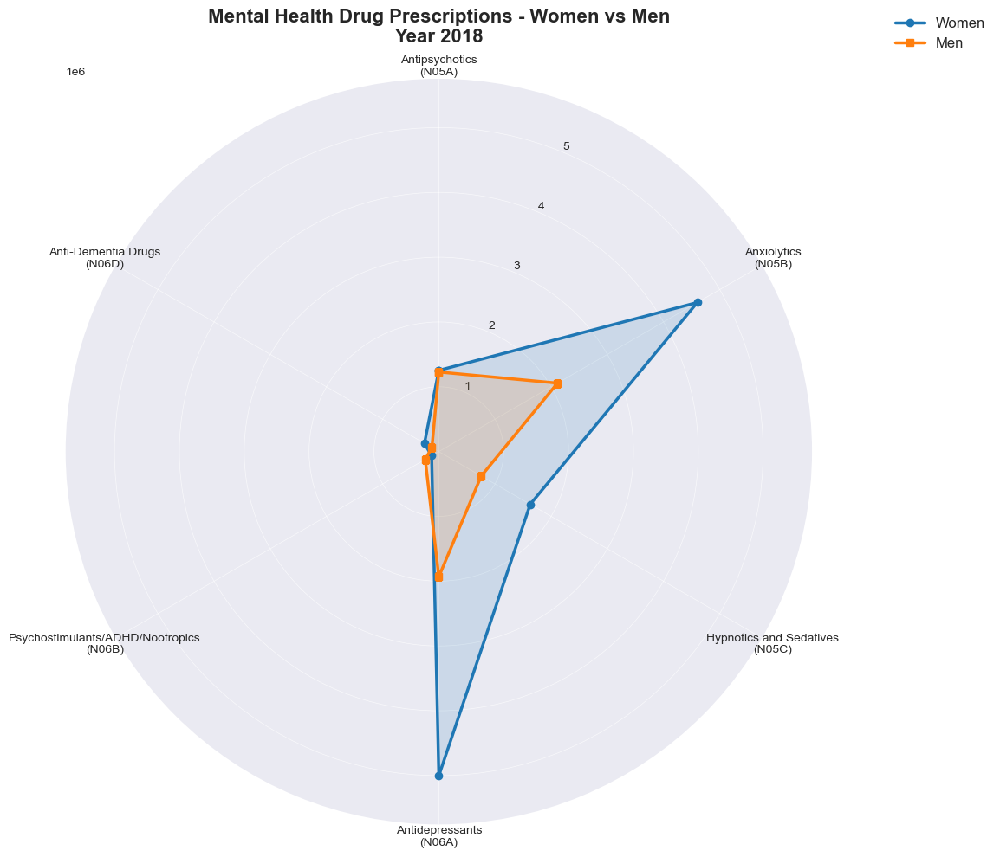


2018 Statistics:
  WOMEN:
    Total prescriptions: 12,866,572
    Highest: Antidepressants with 5,002,717 prescriptions (38.9%)
    Mean per category: 2,144,428
  MEN:
    Total prescriptions: 6,391,569
    Highest: Anxiolytics with 2,112,565 prescriptions (33.1%)
    Mean per category: 1,065,261
  COMPARISON:
    Women/Men total ratio: 2.01


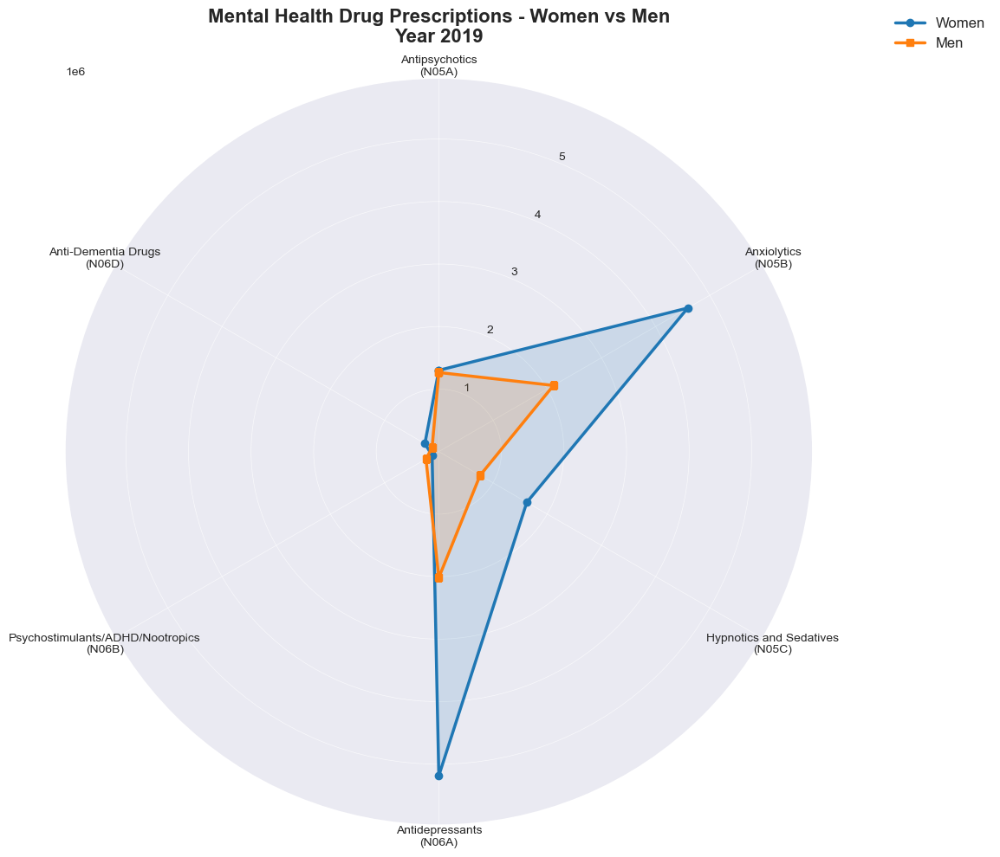


2019 Statistics:
  WOMEN:
    Total prescriptions: 13,084,222
    Highest: Antidepressants with 5,185,367 prescriptions (39.6%)
    Mean per category: 2,180,703
  MEN:
    Total prescriptions: 6,520,126
    Highest: Anxiolytics with 2,115,613 prescriptions (32.4%)
    Mean per category: 1,086,687
  COMPARISON:
    Women/Men total ratio: 2.01


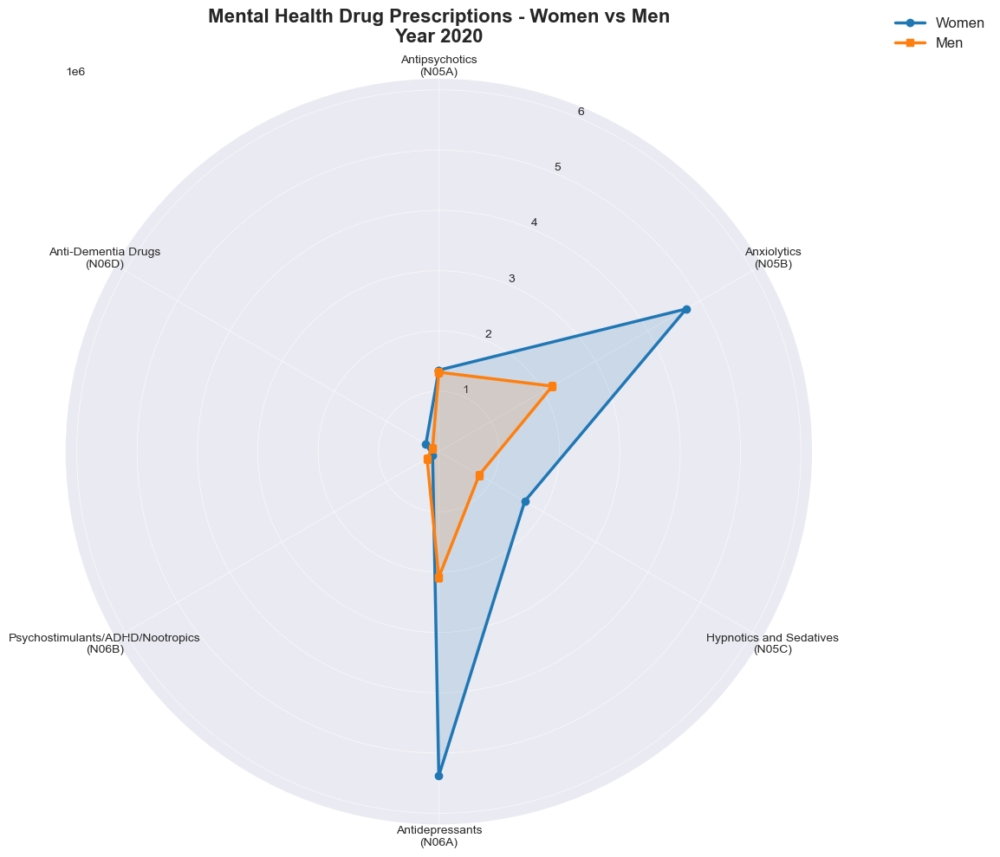


2020 Statistics:
  WOMEN:
    Total prescriptions: 13,473,208
    Highest: Antidepressants with 5,377,043 prescriptions (39.9%)
    Mean per category: 2,245,534
  MEN:
    Total prescriptions: 6,690,613
    Highest: Anxiolytics with 2,171,821 prescriptions (32.5%)
    Mean per category: 1,115,102
  COMPARISON:
    Women/Men total ratio: 2.01


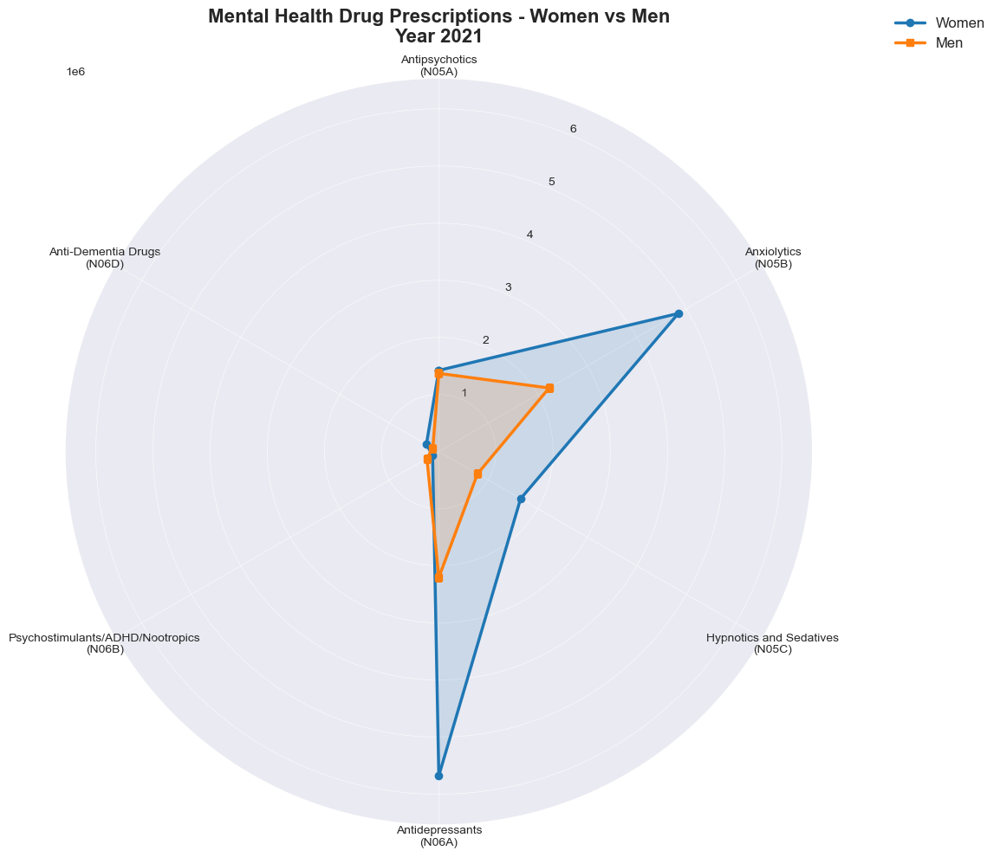


2021 Statistics:
  WOMEN:
    Total prescriptions: 13,963,266
    Highest: Antidepressants with 5,675,827 prescriptions (40.6%)
    Mean per category: 2,327,211
  MEN:
    Total prescriptions: 6,942,514
    Highest: Anxiolytics with 2,227,056 prescriptions (32.1%)
    Mean per category: 1,157,085
  COMPARISON:
    Women/Men total ratio: 2.01


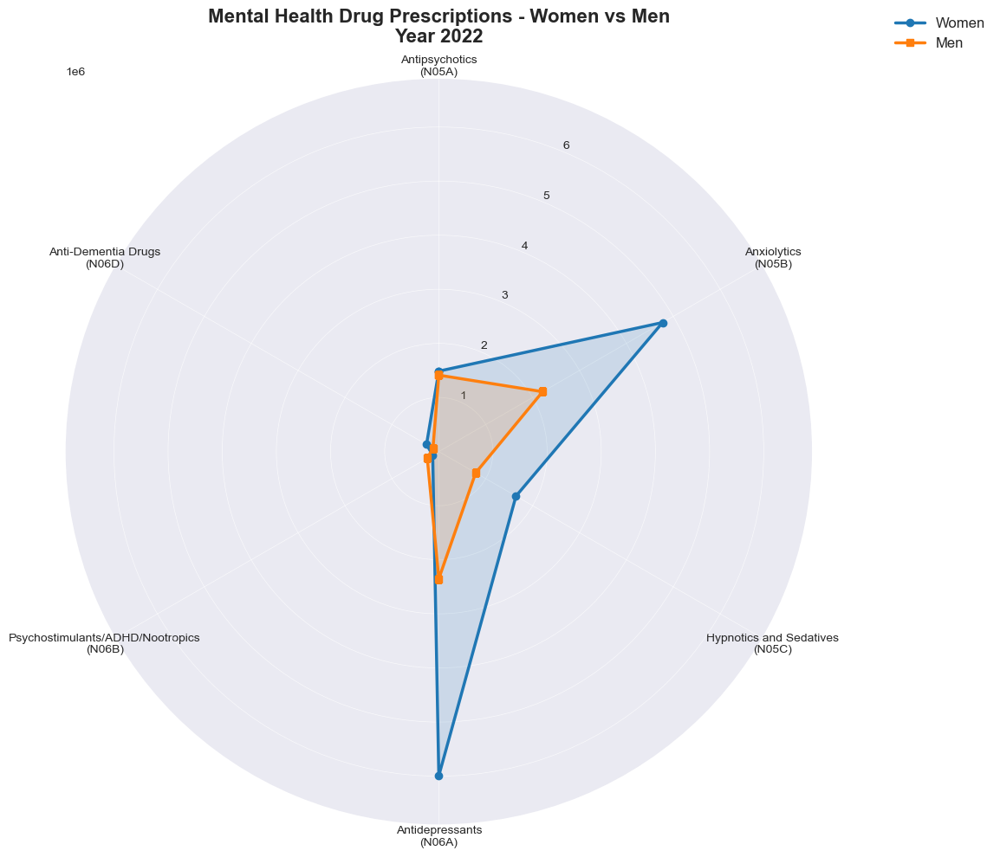


2022 Statistics:
  WOMEN:
    Total prescriptions: 14,290,851
    Highest: Antidepressants with 5,992,531 prescriptions (41.9%)
    Mean per category: 2,381,808
  MEN:
    Total prescriptions: 7,134,341
    Highest: Antidepressants with 2,350,221 prescriptions (32.9%)
    Mean per category: 1,189,056
  COMPARISON:
    Women/Men total ratio: 2.00


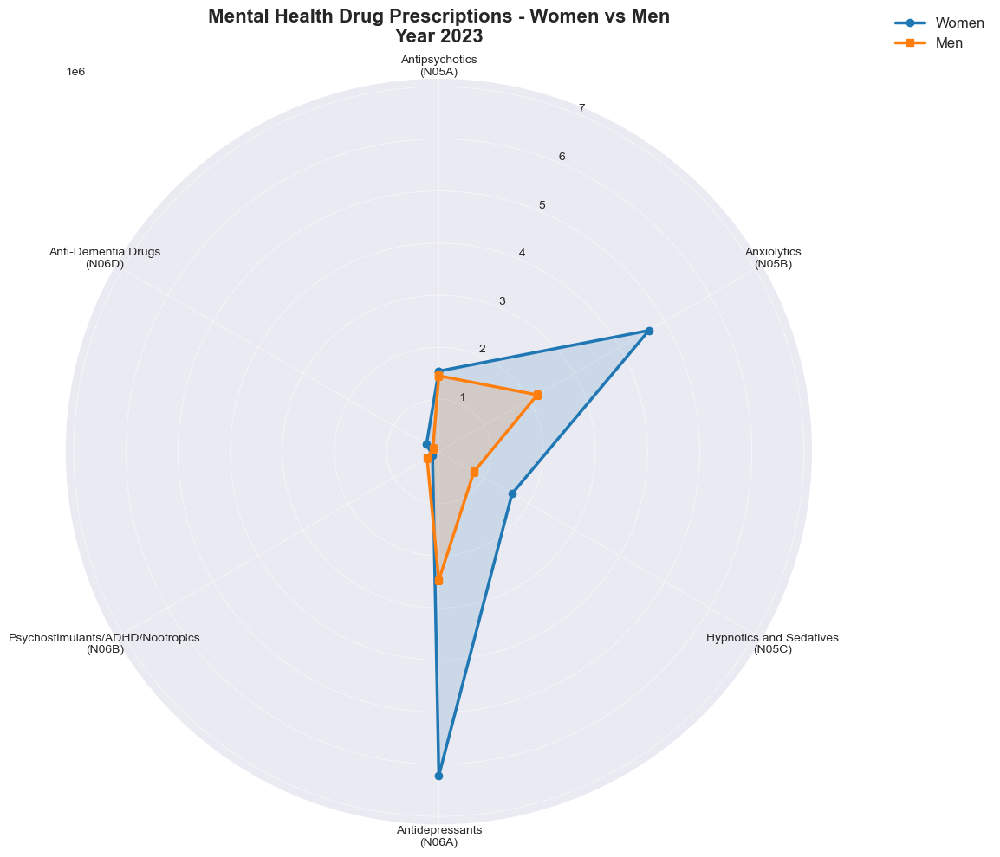


2023 Statistics:
  WOMEN:
    Total prescriptions: 14,444,105
    Highest: Antidepressants with 6,220,219 prescriptions (43.1%)
    Mean per category: 2,407,350
  MEN:
    Total prescriptions: 7,265,915
    Highest: Antidepressants with 2,467,893 prescriptions (34.0%)
    Mean per category: 1,210,985
  COMPARISON:
    Women/Men total ratio: 1.99


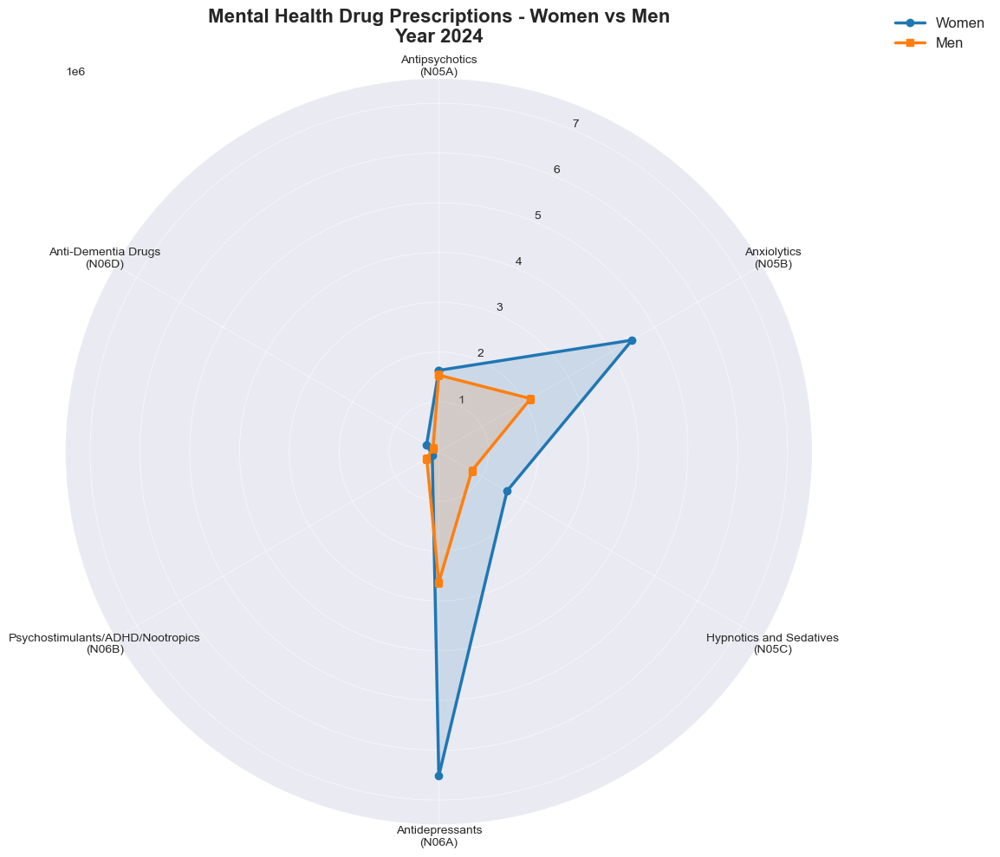


2024 Statistics:
  WOMEN:
    Total prescriptions: 14,641,036
    Highest: Antidepressants with 6,513,248 prescriptions (44.5%)
    Mean per category: 2,440,172
  MEN:
    Total prescriptions: 7,471,255
    Highest: Antidepressants with 2,625,387 prescriptions (35.1%)
    Mean per category: 1,245,209
  COMPARISON:
    Women/Men total ratio: 1.96


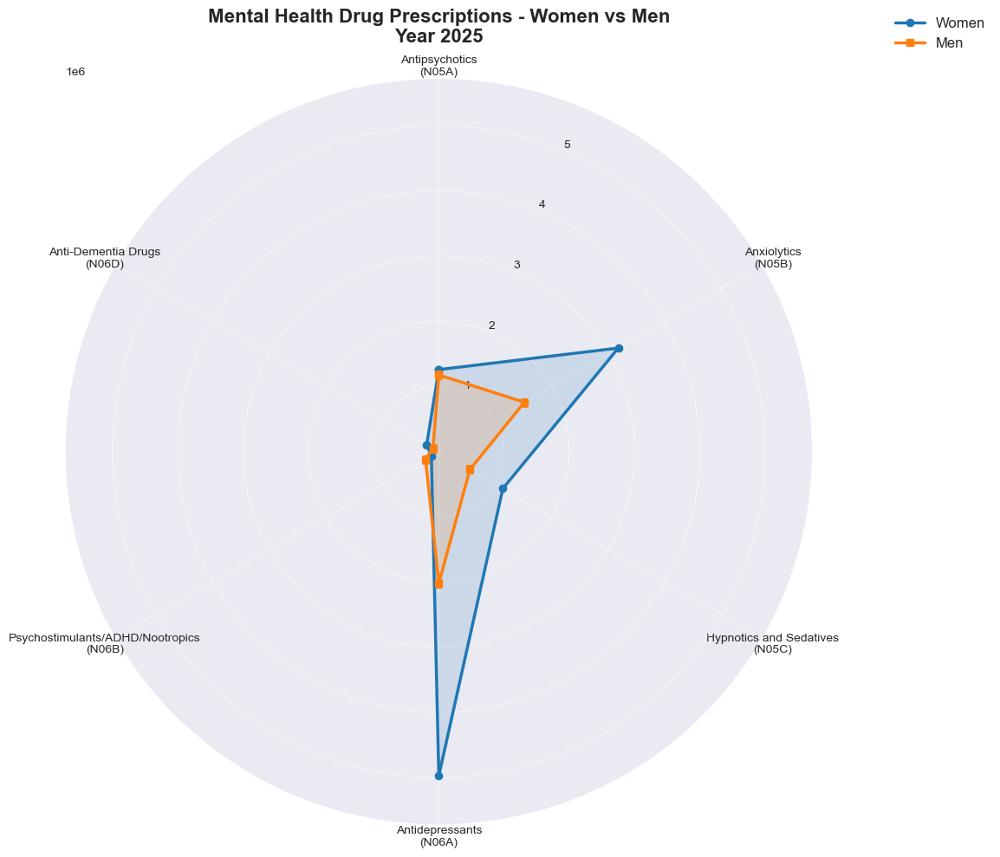


2025 Statistics:
  WOMEN:
    Total prescriptions: 10,887,775
    Highest: Antidepressants with 4,973,198 prescriptions (45.7%)
    Mean per category: 1,814,629
  MEN:
    Total prescriptions: 5,603,907
    Highest: Antidepressants with 2,023,063 prescriptions (36.1%)
    Mean per category: 933,984
  COMPARISON:
    Women/Men total ratio: 1.94


In [59]:
# Create individual radar charts for each year (2016-2025) - Women vs Men
import matplotlib.pyplot as plt
from math import pi
import numpy as np

years_to_plot = sorted(yearly_rx_by_category_women['any'].unique())

for year in years_to_plot:
    # Get data for this year - both women and men
    year_data_women = yearly_rx_by_category_women[yearly_rx_by_category_women['any'] == year].copy()
    year_data_men = yearly_rx_by_category_men[yearly_rx_by_category_men['any'] == year].copy()
    
    # Sort by ATC code for consistency
    year_data_women = year_data_women.sort_values('ATC_Level3')
    year_data_men = year_data_men.sort_values('ATC_Level3')
    
    # Exclude N06C (or any other drug code)
    year_data_women = year_data_women[year_data_women['ATC_Level3'] != 'N06C']
    year_data_men = year_data_men[year_data_men['ATC_Level3'] != 'N06C']
    
    # Extract categories and values
    categories_women = year_data_women['MH_Category'].values
    atc_codes_women = year_data_women['ATC_Level3'].values
    values_women = year_data_women['nombre de receptes'].values
    
    categories_men = year_data_men['MH_Category'].values
    atc_codes_men = year_data_men['ATC_Level3'].values
    values_men = year_data_men['nombre de receptes'].values
    
    num_vars = len(categories_women)
    
    # Compute angles for radar chart
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    values_women_plot = list(values_women) + [values_women[0]]
    values_men_plot = list(values_men) + [values_men[0]]
    angles += angles[:1]
    
    # Create figure
    fig = plt.figure(figsize=(12, 10))
    ax = plt.subplot(111, projection='polar')
    
    # Plot - Women in blue, Men in orange
    cb_colors = sns.color_palette("colorblind")
    ax.plot(angles, values_women_plot, 'o-', linewidth=2.5, color='#1f77b4', label='Women')
    ax.fill(angles, values_women_plot, alpha=0.15, color='#1f77b4')
    
    ax.plot(angles, values_men_plot, 's-', linewidth=2.5, color='#ff7f0e', label='Men')
    ax.fill(angles, values_men_plot, alpha=0.15, color='#ff7f0e')
    
    # Configure
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)
    ax.set_xticks(angles[:-1])
    
    # Create labels with both category name and ATC code
    labels = [f'{cat}\n({code})' for cat, code in zip(categories_women, atc_codes_women)]
    ax.set_xticklabels(labels, size=10)
    
    # Set y-axis limits
    max_val = max(max(values_women), max(values_men))
    ax.set_ylim(0, max_val * 1.15)
    
    ax.set_title(f'Mental Health Drug Prescriptions - Women vs Men\nYear {int(year)}', 
                 size=16, fontweight='bold', pad=30)
    ax.grid(True, linewidth=0.5, alpha=0.7)
    
    # Add legend
    ax.legend(loc='upper right', bbox_to_anchor=(1.25, 1.1), fontsize=12)
    
    plt.tight_layout()
    plt.show()
    
    # Print statistics for this year
    total_rx_women = values_women.sum()
    total_rx_men = values_men.sum()
    max_cat_women = categories_women[np.argmax(values_women)]
    max_val_women = values_women.max()
    max_cat_men = categories_men[np.argmax(values_men)]
    max_val_men = values_men.max()
    
    print(f"\n{int(year)} Statistics:")
    print(f"  WOMEN:")
    print(f"    Total prescriptions: {int(total_rx_women):,}")
    print(f"    Highest: {max_cat_women} with {int(max_val_women):,} prescriptions ({max_val_women/total_rx_women*100:.1f}%)")
    print(f"    Mean per category: {int(values_women.mean()):,}")
    print(f"  MEN:")
    print(f"    Total prescriptions: {int(total_rx_men):,}")
    print(f"    Highest: {max_cat_men} with {int(max_val_men):,} prescriptions ({max_val_men/total_rx_men*100:.1f}%)")
    print(f"    Mean per category: {int(values_men.mean()):,}")
    print(f"  COMPARISON:")
    print(f"    Women/Men total ratio: {total_rx_women/total_rx_men:.2f}")

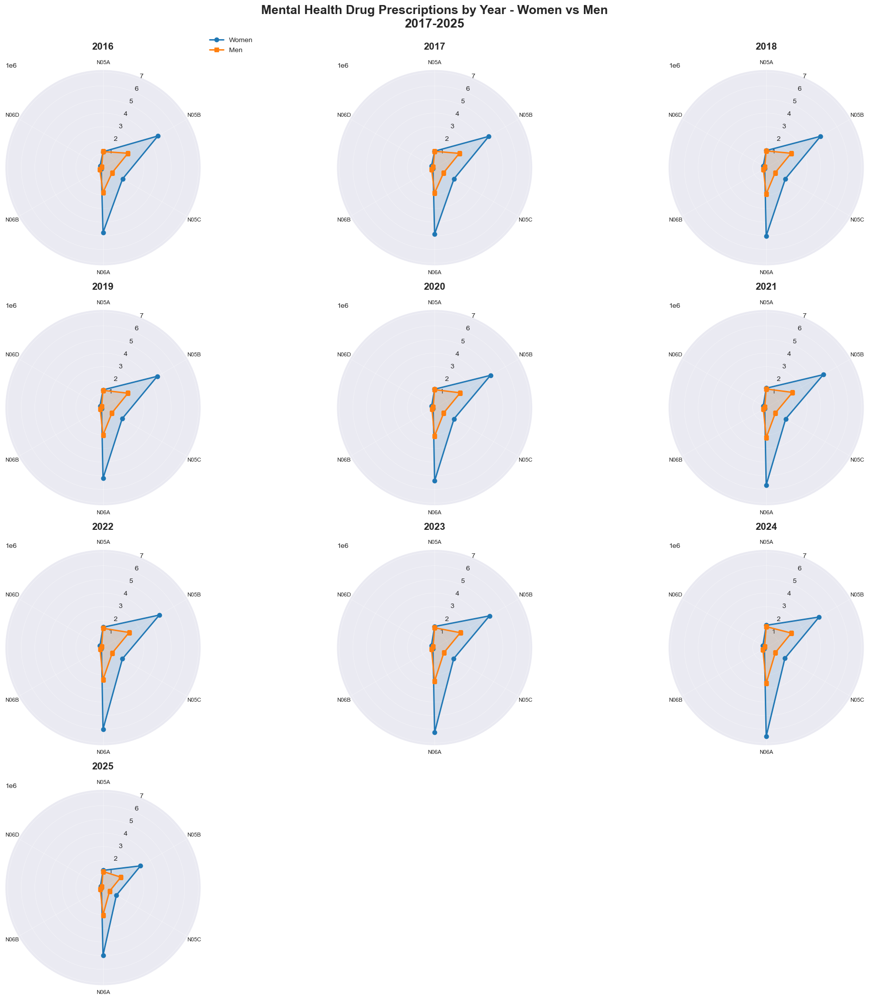


Displayed 10 years of prescription data comparing women and men


In [61]:
# Combined view: All years in a 3x3 grid - Women vs Men comparison
years_to_plot = sorted(yearly_rx_by_category_women['any'].unique())

fig = plt.figure(figsize=(20, 20))
fig.suptitle('Mental Health Drug Prescriptions by Year - Women vs Men\n2017-2025', 
             fontsize=18, fontweight='bold', y=0.995)

for idx, year in enumerate(years_to_plot):
    # Get data for this year - both women and men
    year_data_women = yearly_rx_by_category_women[yearly_rx_by_category_women['any'] == year].copy()
    year_data_men = yearly_rx_by_category_men[yearly_rx_by_category_men['any'] == year].copy()
    
    year_data_women = year_data_women.sort_values('ATC_Level3')
    year_data_men = year_data_men.sort_values('ATC_Level3')
    
    # Exclude N06C (or any other drug code)
    year_data_women = year_data_women[year_data_women['ATC_Level3'] != 'N06C']
    year_data_men = year_data_men[year_data_men['ATC_Level3'] != 'N06C']
    
    # Extract categories and values
    categories = year_data_women['MH_Category'].values
    atc_codes = year_data_women['ATC_Level3'].values
    values_women = year_data_women['nombre de receptes'].values
    values_men = year_data_men['nombre de receptes'].values
    num_vars = len(categories)
    
    # Compute angles
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    values_women_plot = list(values_women) + [values_women[0]]
    values_men_plot = list(values_men) + [values_men[0]]
    angles += angles[:1]
    
    # Create subplot
    ax = plt.subplot(4, 3, idx + 1, projection='polar')
    
    # Plot - Women in blue, Men in orange
    cb_colors = sns.color_palette("colorblind")
    ax.plot(angles, values_women_plot, 'o-', linewidth=2, color='#1f77b4', label='Women')
    ax.fill(angles, values_women_plot, alpha=0.15, color='#1f77b4')
    
    ax.plot(angles, values_men_plot, 's-', linewidth=2, color='#ff7f0e', label='Men')
    ax.fill(angles, values_men_plot, alpha=0.15, color='#ff7f0e')
    
    # Configure
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)
    ax.set_xticks(angles[:-1])
    
    # Shorter labels for grid view
    labels = [code for code in atc_codes]
    ax.set_xticklabels(labels, size=8)
    
    # Consistent scale across all subplots for comparison
    global_max_women = yearly_rx_by_category_women['nombre de receptes'].max()
    global_max_men = yearly_rx_by_category_men['nombre de receptes'].max()
    global_max = max(global_max_women, global_max_men)
    ax.set_ylim(0, global_max * 1.1)
    
    ax.set_title(f'{int(year)}', size=14, fontweight='bold', pad=15)
    ax.grid(True, linewidth=0.5, alpha=0.5)
    
    # Add legend only to first subplot
    if idx == 0:
        ax.legend(loc='upper right', bbox_to_anchor=(1.3, 1.2), fontsize=10)

plt.tight_layout()
plt.show()

print(f"\nDisplayed {len(years_to_plot)} years of prescription data comparing women and men")

In [63]:
# Summary: Compare total prescriptions across all mental health drug categories - Women vs Men (2016-2025)
print("="*80)
print("SUMMARY: Mental Health Drug Prescriptions - Women vs Men Comparison (2016-2025)")
print("="*80)

# Calculate totals by year for women and men
yearly_totals_women = yearly_rx_by_category_women.groupby('any')['nombre de receptes'].sum().sort_index()
yearly_totals_men = yearly_rx_by_category_men.groupby('any')['nombre de receptes'].sum().sort_index()

print("\nTotal Prescriptions by Year:")
print(f"{'Year':<10} {'Women':>15} {'Men':>15} {'W/M Ratio':>12} {'Difference':>15}")
print("-"*80)
for year in sorted(yearly_totals_women.index):
    women_total = yearly_totals_women[year]
    men_total = yearly_totals_men[year]
    ratio = women_total / men_total
    diff = women_total - men_total
    print(f"{int(year):<10} {int(women_total):>15,} {int(men_total):>15,} {ratio:>12.2f} {int(diff):>15,}")

# Overall statistics
total_women = yearly_totals_women.sum()
total_men = yearly_totals_men.sum()
overall_ratio = total_women / total_men

print("\n" + "="*80)
print("OVERALL STATISTICS (2016-2025):")
print(f"  Total prescriptions - Women: {int(total_women):,}")
print(f"  Total prescriptions - Men: {int(total_men):,}")
print(f"  Women/Men ratio: {overall_ratio:.2f}")
print(f"  Difference: {int(total_women - total_men):,} (Women > Men)" if total_women > total_men else f"  Difference: {int(total_men - total_women):,} (Men > Women)")

# Growth rates
women_growth = ((yearly_totals_women.iloc[-1] - yearly_totals_women.iloc[0]) / yearly_totals_women.iloc[0]) * 100
men_growth = ((yearly_totals_men.iloc[-1] - yearly_totals_men.iloc[0]) / yearly_totals_men.iloc[0]) * 100

print(f"\nGrowth from {int(yearly_totals_women.index[0])} to {int(yearly_totals_women.index[-1])}:")
print(f"  Women: {women_growth:.2f}%")
print(f"  Men: {men_growth:.2f}%")
print("="*80)

SUMMARY: Mental Health Drug Prescriptions - Women vs Men Comparison (2016-2025)

Total Prescriptions by Year:
Year                 Women             Men    W/M Ratio      Difference
--------------------------------------------------------------------------------
2016            12,631,681       6,265,036         2.02       6,366,645
2017            12,700,712       6,294,435         2.02       6,406,277
2018            12,866,572       6,391,569         2.01       6,475,003
2019            13,084,222       6,520,126         2.01       6,564,096
2020            13,473,209       6,690,613         2.01       6,782,596
2021            13,963,266       6,942,514         2.01       7,020,752
2022            14,290,851       7,134,341         2.00       7,156,510
2023            14,444,105       7,265,915         1.99       7,178,190
2024            14,641,036       7,471,255         1.96       7,169,781
2025            10,887,775       5,603,907         1.94       5,283,868

OVERALL STATISTI